# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = '/data'
!pip install matplotlib==2.0.2
# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

    100% |████████████████████████████████| 14.6MB 37kB/s  eta 0:00:01
  Found existing installation: matplotlib 2.1.0
    Uninstalling matplotlib-2.1.0:
      Successfully uninstalled matplotlib-2.1.0
You are using pip version 9.0.1, however version 19.0.3 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

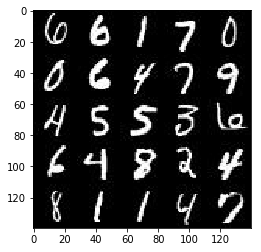

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

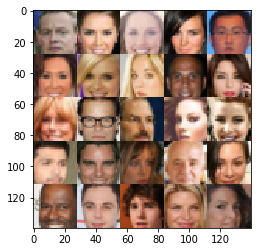

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.3.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    
    real_inputs = tf.placeholder(tf.float32,(None, image_width, image_height, image_channels), "input_real")
    
    z_inputs = tf.placeholder(tf.float32, (None, z_dim), "input_z")
    learning_rate = tf.placeholder(tf.float32, (), "lr")
    
    return real_inputs, z_inputs, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [7]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    alpha=0.2
    keep_prob=0.9
    
    with tf.variable_scope('discriminator', reuse=reuse):
        
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same', activation=None)
        relu1 = tf.maximum(alpha*x1, x1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same', activation=None)
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha*bn2, bn2)
        drop2 = tf.nn.dropout(relu2, keep_prob=keep_prob)

        x3 = tf.layers.conv2d(drop2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha*bn3, bn3)
        drop3 = tf.nn.dropout(relu3, keep_prob=keep_prob)

        flat = tf.reshape(drop3, (-1, 4*4*256))
    
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [8]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    alpha=0.2
    keep_prob=0.9
    
    with tf.variable_scope('generator', reuse = not is_train):
    
        x1 = tf.layers.dense(z, 7*7*512)
        x1 = tf.reshape(x1, (-1,7,7,512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha*x1, x1)
        x1 = tf.nn.dropout(x1, keep_prob=keep_prob)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same', activation=None)
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha*x2, x2)
        x2 = tf.nn.dropout(x2, keep_prob=keep_prob)
            
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha*x3, x3)
        
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 3, strides=1, padding='same', activation=None)
        out = tf.tanh(logits)

        return out



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [9]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    smooth = 0.1
    gen = generator(input_z, out_channel_dim, is_train=True)
    d_real, d_logits_real = discriminator(input_real, reuse=False)
    d_fake, d_logits_fake = discriminator(gen, reuse=True)
    
    d_labels_real = tf.ones_like(d_real) * (1 -smooth)
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=d_labels_real))
    
    d_labels_fake = tf.zeros_like(d_fake)
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=d_labels_fake))
    
    d_loss = d_loss_real + d_loss_fake
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_fake)))
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [10]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
        
    return d_train, g_train


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [11]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [12]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_train, g_train = model_opt(d_loss, g_loss, lr, beta1)

    saver = tf.train.Saver()
    samples,losses = [], []
    step = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                
                # TODO: Train Model
                step += 1
                batch_images *= 2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                _ = sess.run(d_train, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_train, feed_dict={input_real: batch_images, input_z: batch_z, lr:learning_rate})
                   
    
                if step % 10 == 0:
                    
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                   
                    losses.append((train_loss_d, train_loss_g))


                if step % 100 == 0:
                    show_generator_output(sess, 16, input_z, data_shape[3], data_image_mode)
                    

        saver.save(sess, './generator.ckpt')

                
    return losses

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.4589... Generator Loss: 3.0791
Epoch 1/2... Discriminator Loss: 3.6562... Generator Loss: 0.1055
Epoch 1/2... Discriminator Loss: 0.4903... Generator Loss: 2.2391
Epoch 1/2... Discriminator Loss: 0.3755... Generator Loss: 4.0719
Epoch 1/2... Discriminator Loss: 2.5995... Generator Loss: 7.8311
Epoch 1/2... Discriminator Loss: 1.7490... Generator Loss: 0.7598
Epoch 1/2... Discriminator Loss: 1.6112... Generator Loss: 1.3101
Epoch 1/2... Discriminator Loss: 1.5125... Generator Loss: 1.0278
Epoch 1/2... Discriminator Loss: 1.6311... Generator Loss: 1.2062
Epoch 1/2... Discriminator Loss: 1.5942... Generator Loss: 0.5896


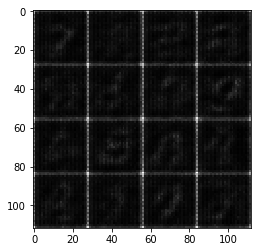

Epoch 1/2... Discriminator Loss: 1.5486... Generator Loss: 0.6620
Epoch 1/2... Discriminator Loss: 1.4170... Generator Loss: 0.6170
Epoch 1/2... Discriminator Loss: 1.5093... Generator Loss: 0.4515
Epoch 1/2... Discriminator Loss: 1.2986... Generator Loss: 0.7279
Epoch 1/2... Discriminator Loss: 1.1772... Generator Loss: 1.0397
Epoch 1/2... Discriminator Loss: 1.6214... Generator Loss: 0.4347
Epoch 1/2... Discriminator Loss: 1.7018... Generator Loss: 0.3536
Epoch 1/2... Discriminator Loss: 1.3305... Generator Loss: 0.5439
Epoch 1/2... Discriminator Loss: 1.1917... Generator Loss: 0.7466
Epoch 1/2... Discriminator Loss: 1.4561... Generator Loss: 1.1585


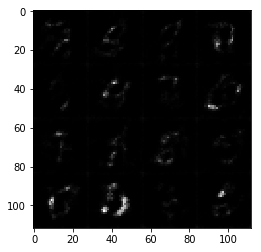

Epoch 1/2... Discriminator Loss: 1.1762... Generator Loss: 0.7876
Epoch 1/2... Discriminator Loss: 1.1060... Generator Loss: 1.1836
Epoch 1/2... Discriminator Loss: 1.1432... Generator Loss: 1.1996
Epoch 1/2... Discriminator Loss: 1.1565... Generator Loss: 1.2748
Epoch 1/2... Discriminator Loss: 1.3845... Generator Loss: 0.5268
Epoch 1/2... Discriminator Loss: 1.2524... Generator Loss: 0.7204
Epoch 1/2... Discriminator Loss: 1.0824... Generator Loss: 1.8964
Epoch 1/2... Discriminator Loss: 1.4552... Generator Loss: 0.5686
Epoch 1/2... Discriminator Loss: 1.1405... Generator Loss: 1.2759
Epoch 1/2... Discriminator Loss: 0.9027... Generator Loss: 1.1881


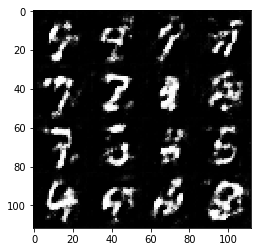

Epoch 1/2... Discriminator Loss: 1.3072... Generator Loss: 0.6446
Epoch 1/2... Discriminator Loss: 1.2327... Generator Loss: 0.7260
Epoch 1/2... Discriminator Loss: 0.9609... Generator Loss: 1.5453
Epoch 1/2... Discriminator Loss: 0.9678... Generator Loss: 1.6563
Epoch 1/2... Discriminator Loss: 0.9530... Generator Loss: 1.8966
Epoch 1/2... Discriminator Loss: 1.0779... Generator Loss: 2.1273
Epoch 1/2... Discriminator Loss: 1.2131... Generator Loss: 0.9302
Epoch 1/2... Discriminator Loss: 1.0316... Generator Loss: 1.4170
Epoch 1/2... Discriminator Loss: 1.3670... Generator Loss: 2.3509
Epoch 1/2... Discriminator Loss: 1.5721... Generator Loss: 2.5244


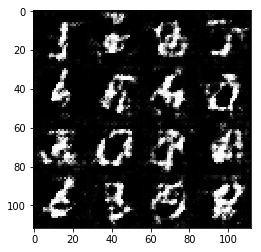

Epoch 1/2... Discriminator Loss: 1.0452... Generator Loss: 1.2294
Epoch 1/2... Discriminator Loss: 1.4036... Generator Loss: 0.6283
Epoch 1/2... Discriminator Loss: 1.5339... Generator Loss: 0.6138
Epoch 1/2... Discriminator Loss: 1.1993... Generator Loss: 1.4475
Epoch 1/2... Discriminator Loss: 1.3580... Generator Loss: 0.5904
Epoch 1/2... Discriminator Loss: 0.9244... Generator Loss: 1.0527
Epoch 1/2... Discriminator Loss: 1.4687... Generator Loss: 1.7435
Epoch 1/2... Discriminator Loss: 1.3057... Generator Loss: 0.7227
Epoch 1/2... Discriminator Loss: 1.2611... Generator Loss: 1.7567
Epoch 1/2... Discriminator Loss: 1.2748... Generator Loss: 0.6932


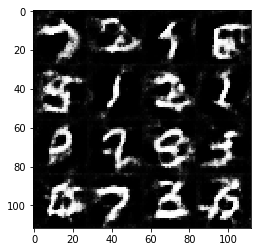

Epoch 1/2... Discriminator Loss: 1.1953... Generator Loss: 0.6274
Epoch 1/2... Discriminator Loss: 1.3751... Generator Loss: 0.5679
Epoch 1/2... Discriminator Loss: 1.2293... Generator Loss: 0.6650
Epoch 1/2... Discriminator Loss: 1.2680... Generator Loss: 0.8412
Epoch 1/2... Discriminator Loss: 1.1775... Generator Loss: 0.9353
Epoch 1/2... Discriminator Loss: 1.1457... Generator Loss: 0.7855
Epoch 1/2... Discriminator Loss: 1.6109... Generator Loss: 0.3830
Epoch 1/2... Discriminator Loss: 1.3284... Generator Loss: 1.6720
Epoch 1/2... Discriminator Loss: 1.1719... Generator Loss: 0.8852
Epoch 1/2... Discriminator Loss: 1.2203... Generator Loss: 0.6766


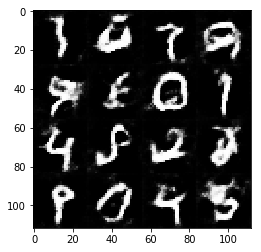

Epoch 1/2... Discriminator Loss: 1.2791... Generator Loss: 0.7605
Epoch 1/2... Discriminator Loss: 1.0434... Generator Loss: 0.7497
Epoch 1/2... Discriminator Loss: 1.1268... Generator Loss: 1.6295
Epoch 1/2... Discriminator Loss: 1.2237... Generator Loss: 1.2737
Epoch 1/2... Discriminator Loss: 1.4568... Generator Loss: 0.5377
Epoch 1/2... Discriminator Loss: 1.2260... Generator Loss: 0.6763
Epoch 1/2... Discriminator Loss: 1.1202... Generator Loss: 1.1415
Epoch 1/2... Discriminator Loss: 0.9990... Generator Loss: 1.5881
Epoch 1/2... Discriminator Loss: 1.2546... Generator Loss: 0.6413
Epoch 1/2... Discriminator Loss: 1.4642... Generator Loss: 1.7662


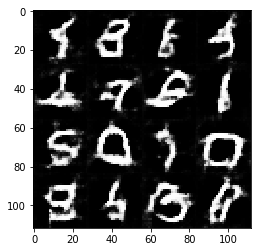

Epoch 1/2... Discriminator Loss: 1.2217... Generator Loss: 0.8560
Epoch 1/2... Discriminator Loss: 1.0619... Generator Loss: 1.3455
Epoch 1/2... Discriminator Loss: 1.2520... Generator Loss: 0.6379
Epoch 1/2... Discriminator Loss: 1.4300... Generator Loss: 0.6351
Epoch 1/2... Discriminator Loss: 1.5102... Generator Loss: 0.4605
Epoch 1/2... Discriminator Loss: 1.4193... Generator Loss: 0.7414
Epoch 1/2... Discriminator Loss: 1.1785... Generator Loss: 0.8451
Epoch 1/2... Discriminator Loss: 1.1123... Generator Loss: 0.6746
Epoch 1/2... Discriminator Loss: 1.2747... Generator Loss: 1.3608
Epoch 1/2... Discriminator Loss: 1.2106... Generator Loss: 0.6473


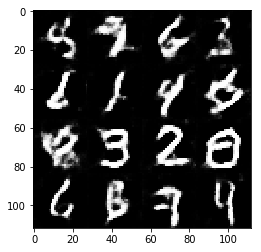

Epoch 1/2... Discriminator Loss: 1.1523... Generator Loss: 0.8246
Epoch 1/2... Discriminator Loss: 1.1595... Generator Loss: 0.7403
Epoch 1/2... Discriminator Loss: 0.9919... Generator Loss: 1.0213
Epoch 1/2... Discriminator Loss: 1.3117... Generator Loss: 0.7402
Epoch 1/2... Discriminator Loss: 1.1711... Generator Loss: 0.6687
Epoch 1/2... Discriminator Loss: 1.0706... Generator Loss: 0.8217
Epoch 1/2... Discriminator Loss: 1.3643... Generator Loss: 0.4871
Epoch 1/2... Discriminator Loss: 1.2884... Generator Loss: 0.7938
Epoch 1/2... Discriminator Loss: 1.4042... Generator Loss: 0.5652
Epoch 1/2... Discriminator Loss: 1.2322... Generator Loss: 0.7411


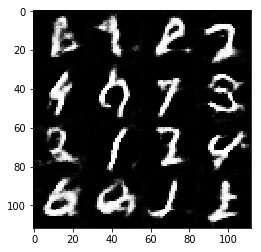

Epoch 1/2... Discriminator Loss: 1.3200... Generator Loss: 0.5931
Epoch 1/2... Discriminator Loss: 1.3675... Generator Loss: 1.8543
Epoch 1/2... Discriminator Loss: 1.5790... Generator Loss: 0.4940
Epoch 1/2... Discriminator Loss: 1.2196... Generator Loss: 0.9163
Epoch 1/2... Discriminator Loss: 1.3069... Generator Loss: 0.5428
Epoch 1/2... Discriminator Loss: 1.1942... Generator Loss: 0.9847
Epoch 1/2... Discriminator Loss: 1.0549... Generator Loss: 1.0057
Epoch 1/2... Discriminator Loss: 1.0867... Generator Loss: 0.9209
Epoch 1/2... Discriminator Loss: 1.1987... Generator Loss: 0.5913
Epoch 1/2... Discriminator Loss: 1.3014... Generator Loss: 0.6676


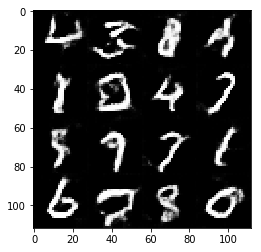

Epoch 1/2... Discriminator Loss: 1.0675... Generator Loss: 1.4505
Epoch 1/2... Discriminator Loss: 1.0268... Generator Loss: 0.8543
Epoch 1/2... Discriminator Loss: 1.2364... Generator Loss: 1.5168
Epoch 1/2... Discriminator Loss: 1.1950... Generator Loss: 1.0631
Epoch 1/2... Discriminator Loss: 1.0567... Generator Loss: 1.2329
Epoch 1/2... Discriminator Loss: 1.2437... Generator Loss: 0.8419
Epoch 1/2... Discriminator Loss: 1.2392... Generator Loss: 1.8574
Epoch 1/2... Discriminator Loss: 1.3918... Generator Loss: 0.6244
Epoch 1/2... Discriminator Loss: 1.1730... Generator Loss: 1.5993
Epoch 1/2... Discriminator Loss: 1.0652... Generator Loss: 1.1267


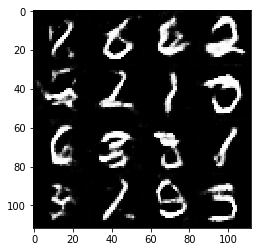

Epoch 1/2... Discriminator Loss: 1.4624... Generator Loss: 0.5940
Epoch 1/2... Discriminator Loss: 1.1187... Generator Loss: 0.8955
Epoch 1/2... Discriminator Loss: 1.4299... Generator Loss: 0.6003
Epoch 1/2... Discriminator Loss: 1.0681... Generator Loss: 1.2567
Epoch 1/2... Discriminator Loss: 0.9988... Generator Loss: 1.1396
Epoch 1/2... Discriminator Loss: 1.1393... Generator Loss: 1.0313
Epoch 1/2... Discriminator Loss: 1.0714... Generator Loss: 1.1040
Epoch 1/2... Discriminator Loss: 1.1662... Generator Loss: 1.4148
Epoch 1/2... Discriminator Loss: 1.0226... Generator Loss: 1.7430
Epoch 1/2... Discriminator Loss: 1.1929... Generator Loss: 0.6537


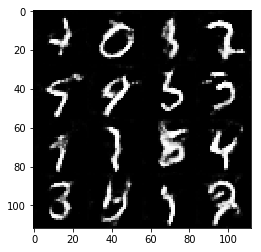

Epoch 1/2... Discriminator Loss: 1.1176... Generator Loss: 0.8152
Epoch 1/2... Discriminator Loss: 1.0868... Generator Loss: 1.0317
Epoch 1/2... Discriminator Loss: 1.3092... Generator Loss: 0.6265
Epoch 1/2... Discriminator Loss: 1.1613... Generator Loss: 0.9158
Epoch 1/2... Discriminator Loss: 0.9757... Generator Loss: 1.0818
Epoch 1/2... Discriminator Loss: 1.4326... Generator Loss: 0.4468
Epoch 1/2... Discriminator Loss: 1.0162... Generator Loss: 1.4689
Epoch 1/2... Discriminator Loss: 0.8920... Generator Loss: 1.6526
Epoch 1/2... Discriminator Loss: 1.0973... Generator Loss: 0.7943
Epoch 1/2... Discriminator Loss: 1.1705... Generator Loss: 1.8590


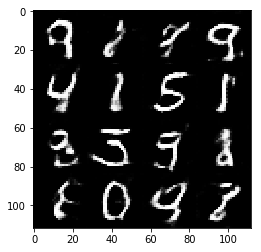

Epoch 1/2... Discriminator Loss: 1.2156... Generator Loss: 0.7986
Epoch 1/2... Discriminator Loss: 1.0027... Generator Loss: 0.9352
Epoch 1/2... Discriminator Loss: 1.2976... Generator Loss: 0.7022
Epoch 1/2... Discriminator Loss: 1.3090... Generator Loss: 0.5838
Epoch 1/2... Discriminator Loss: 1.5450... Generator Loss: 0.5794
Epoch 1/2... Discriminator Loss: 1.1655... Generator Loss: 0.7422
Epoch 1/2... Discriminator Loss: 0.9528... Generator Loss: 1.1753
Epoch 1/2... Discriminator Loss: 1.0062... Generator Loss: 1.2241
Epoch 1/2... Discriminator Loss: 1.5883... Generator Loss: 0.4917
Epoch 1/2... Discriminator Loss: 1.2194... Generator Loss: 0.8416


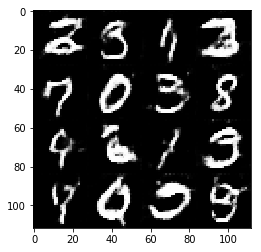

Epoch 1/2... Discriminator Loss: 1.1340... Generator Loss: 0.8620
Epoch 1/2... Discriminator Loss: 1.0038... Generator Loss: 1.1073
Epoch 1/2... Discriminator Loss: 0.9826... Generator Loss: 1.2764
Epoch 1/2... Discriminator Loss: 0.8609... Generator Loss: 1.3656
Epoch 1/2... Discriminator Loss: 2.0476... Generator Loss: 0.2615
Epoch 1/2... Discriminator Loss: 1.3447... Generator Loss: 0.5612
Epoch 1/2... Discriminator Loss: 1.0881... Generator Loss: 1.2092
Epoch 1/2... Discriminator Loss: 1.2464... Generator Loss: 0.6899
Epoch 1/2... Discriminator Loss: 1.0818... Generator Loss: 1.1486
Epoch 1/2... Discriminator Loss: 2.1683... Generator Loss: 0.2170


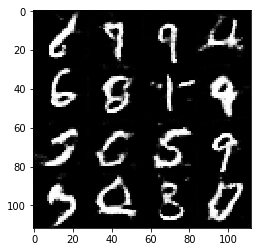

Epoch 1/2... Discriminator Loss: 1.0991... Generator Loss: 1.0157
Epoch 1/2... Discriminator Loss: 0.9757... Generator Loss: 0.8559
Epoch 1/2... Discriminator Loss: 1.2809... Generator Loss: 0.7369
Epoch 1/2... Discriminator Loss: 1.0544... Generator Loss: 1.3776
Epoch 1/2... Discriminator Loss: 1.2842... Generator Loss: 0.6797
Epoch 1/2... Discriminator Loss: 1.2467... Generator Loss: 0.6370
Epoch 1/2... Discriminator Loss: 1.0111... Generator Loss: 0.9743
Epoch 1/2... Discriminator Loss: 1.2599... Generator Loss: 0.6990
Epoch 1/2... Discriminator Loss: 1.0423... Generator Loss: 1.7652
Epoch 1/2... Discriminator Loss: 0.9623... Generator Loss: 1.0673


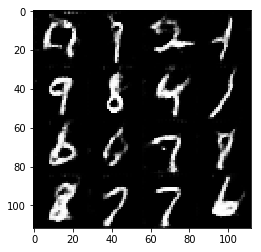

Epoch 1/2... Discriminator Loss: 1.2222... Generator Loss: 0.7290
Epoch 1/2... Discriminator Loss: 0.9452... Generator Loss: 1.2446
Epoch 1/2... Discriminator Loss: 1.5821... Generator Loss: 0.3599
Epoch 1/2... Discriminator Loss: 1.0648... Generator Loss: 0.8903
Epoch 1/2... Discriminator Loss: 0.8894... Generator Loss: 1.0857
Epoch 1/2... Discriminator Loss: 0.9624... Generator Loss: 1.2258
Epoch 1/2... Discriminator Loss: 1.8773... Generator Loss: 0.2867
Epoch 1/2... Discriminator Loss: 1.0089... Generator Loss: 1.4227
Epoch 1/2... Discriminator Loss: 0.9896... Generator Loss: 0.9048
Epoch 1/2... Discriminator Loss: 0.8899... Generator Loss: 1.2379


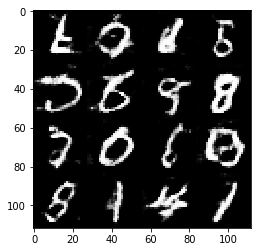

Epoch 1/2... Discriminator Loss: 1.0771... Generator Loss: 0.9123
Epoch 1/2... Discriminator Loss: 1.4944... Generator Loss: 0.5477
Epoch 1/2... Discriminator Loss: 1.2357... Generator Loss: 0.8526
Epoch 1/2... Discriminator Loss: 0.9419... Generator Loss: 1.3102
Epoch 1/2... Discriminator Loss: 1.0195... Generator Loss: 1.1656
Epoch 1/2... Discriminator Loss: 0.6457... Generator Loss: 1.5964
Epoch 1/2... Discriminator Loss: 1.2339... Generator Loss: 2.0289
Epoch 1/2... Discriminator Loss: 0.9586... Generator Loss: 1.0046
Epoch 1/2... Discriminator Loss: 0.9675... Generator Loss: 1.2207
Epoch 1/2... Discriminator Loss: 1.2214... Generator Loss: 0.8085


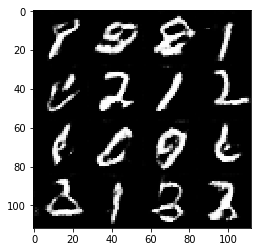

Epoch 1/2... Discriminator Loss: 1.2485... Generator Loss: 0.7296
Epoch 1/2... Discriminator Loss: 1.1082... Generator Loss: 1.4123
Epoch 1/2... Discriminator Loss: 1.1564... Generator Loss: 0.8607
Epoch 1/2... Discriminator Loss: 1.0311... Generator Loss: 1.1159
Epoch 1/2... Discriminator Loss: 1.9832... Generator Loss: 0.2945
Epoch 1/2... Discriminator Loss: 1.1733... Generator Loss: 0.8748
Epoch 1/2... Discriminator Loss: 1.0146... Generator Loss: 0.9125
Epoch 2/2... Discriminator Loss: 1.0422... Generator Loss: 1.0176
Epoch 2/2... Discriminator Loss: 1.1396... Generator Loss: 2.0397
Epoch 2/2... Discriminator Loss: 1.7225... Generator Loss: 0.3697


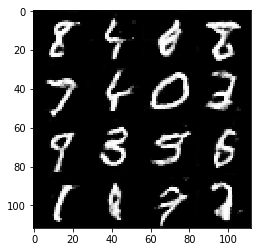

Epoch 2/2... Discriminator Loss: 0.9008... Generator Loss: 1.1606
Epoch 2/2... Discriminator Loss: 1.1324... Generator Loss: 1.3651
Epoch 2/2... Discriminator Loss: 1.0582... Generator Loss: 0.9353
Epoch 2/2... Discriminator Loss: 1.3288... Generator Loss: 1.7293
Epoch 2/2... Discriminator Loss: 0.9855... Generator Loss: 1.1391
Epoch 2/2... Discriminator Loss: 0.9186... Generator Loss: 1.3320
Epoch 2/2... Discriminator Loss: 1.0431... Generator Loss: 0.7885
Epoch 2/2... Discriminator Loss: 1.5220... Generator Loss: 0.4894
Epoch 2/2... Discriminator Loss: 1.0875... Generator Loss: 0.8381
Epoch 2/2... Discriminator Loss: 0.9031... Generator Loss: 1.1705


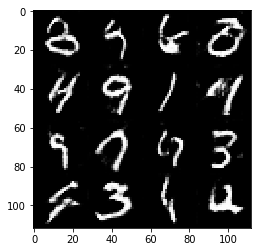

Epoch 2/2... Discriminator Loss: 1.2614... Generator Loss: 0.7897
Epoch 2/2... Discriminator Loss: 0.8732... Generator Loss: 1.3337
Epoch 2/2... Discriminator Loss: 1.1774... Generator Loss: 0.6937
Epoch 2/2... Discriminator Loss: 1.2051... Generator Loss: 0.6240
Epoch 2/2... Discriminator Loss: 1.2799... Generator Loss: 0.6802
Epoch 2/2... Discriminator Loss: 0.9510... Generator Loss: 1.2733
Epoch 2/2... Discriminator Loss: 1.2265... Generator Loss: 0.7139
Epoch 2/2... Discriminator Loss: 0.8848... Generator Loss: 1.2893
Epoch 2/2... Discriminator Loss: 0.9605... Generator Loss: 1.0381
Epoch 2/2... Discriminator Loss: 1.3163... Generator Loss: 0.6083


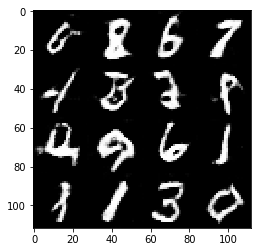

Epoch 2/2... Discriminator Loss: 1.0486... Generator Loss: 1.7553
Epoch 2/2... Discriminator Loss: 0.9699... Generator Loss: 0.9537
Epoch 2/2... Discriminator Loss: 1.1353... Generator Loss: 0.7689
Epoch 2/2... Discriminator Loss: 1.0665... Generator Loss: 0.8110
Epoch 2/2... Discriminator Loss: 0.9296... Generator Loss: 1.0787
Epoch 2/2... Discriminator Loss: 1.0641... Generator Loss: 1.8631
Epoch 2/2... Discriminator Loss: 1.1391... Generator Loss: 0.6193
Epoch 2/2... Discriminator Loss: 1.0327... Generator Loss: 1.0586
Epoch 2/2... Discriminator Loss: 0.9618... Generator Loss: 0.8537
Epoch 2/2... Discriminator Loss: 1.3370... Generator Loss: 0.6117


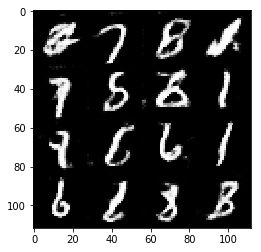

Epoch 2/2... Discriminator Loss: 0.9419... Generator Loss: 1.3609
Epoch 2/2... Discriminator Loss: 0.9223... Generator Loss: 1.5588
Epoch 2/2... Discriminator Loss: 0.9442... Generator Loss: 0.9408
Epoch 2/2... Discriminator Loss: 1.8378... Generator Loss: 3.0720
Epoch 2/2... Discriminator Loss: 1.1654... Generator Loss: 0.7524
Epoch 2/2... Discriminator Loss: 1.0580... Generator Loss: 0.9171
Epoch 2/2... Discriminator Loss: 0.8387... Generator Loss: 1.0745
Epoch 2/2... Discriminator Loss: 1.5390... Generator Loss: 0.3645
Epoch 2/2... Discriminator Loss: 0.9817... Generator Loss: 0.9026
Epoch 2/2... Discriminator Loss: 1.1409... Generator Loss: 0.8093


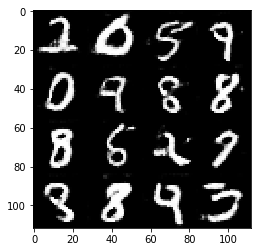

Epoch 2/2... Discriminator Loss: 0.9113... Generator Loss: 1.5462
Epoch 2/2... Discriminator Loss: 0.9937... Generator Loss: 1.0248
Epoch 2/2... Discriminator Loss: 1.0264... Generator Loss: 0.8379
Epoch 2/2... Discriminator Loss: 0.9484... Generator Loss: 1.2508
Epoch 2/2... Discriminator Loss: 1.0424... Generator Loss: 1.4171
Epoch 2/2... Discriminator Loss: 0.8604... Generator Loss: 1.2832
Epoch 2/2... Discriminator Loss: 2.5761... Generator Loss: 0.1610
Epoch 2/2... Discriminator Loss: 1.0064... Generator Loss: 0.9759
Epoch 2/2... Discriminator Loss: 1.0672... Generator Loss: 0.9947
Epoch 2/2... Discriminator Loss: 1.0642... Generator Loss: 1.3645


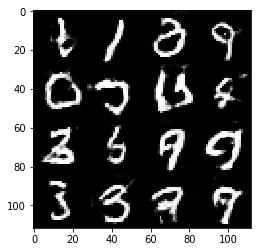

Epoch 2/2... Discriminator Loss: 1.0163... Generator Loss: 1.0336
Epoch 2/2... Discriminator Loss: 1.1012... Generator Loss: 1.1994
Epoch 2/2... Discriminator Loss: 0.9333... Generator Loss: 1.0438
Epoch 2/2... Discriminator Loss: 0.8569... Generator Loss: 1.1159
Epoch 2/2... Discriminator Loss: 0.9467... Generator Loss: 1.1190
Epoch 2/2... Discriminator Loss: 0.7627... Generator Loss: 1.5069
Epoch 2/2... Discriminator Loss: 1.0692... Generator Loss: 0.8369
Epoch 2/2... Discriminator Loss: 1.0390... Generator Loss: 0.8152
Epoch 2/2... Discriminator Loss: 1.4044... Generator Loss: 0.5038
Epoch 2/2... Discriminator Loss: 1.1815... Generator Loss: 0.8334


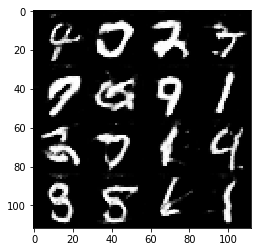

Epoch 2/2... Discriminator Loss: 0.8812... Generator Loss: 1.7994
Epoch 2/2... Discriminator Loss: 0.9685... Generator Loss: 1.1958
Epoch 2/2... Discriminator Loss: 1.0621... Generator Loss: 0.8053
Epoch 2/2... Discriminator Loss: 0.7716... Generator Loss: 1.3379
Epoch 2/2... Discriminator Loss: 0.9785... Generator Loss: 0.8873
Epoch 2/2... Discriminator Loss: 1.0450... Generator Loss: 1.0552
Epoch 2/2... Discriminator Loss: 1.4498... Generator Loss: 0.6865
Epoch 2/2... Discriminator Loss: 0.9205... Generator Loss: 1.1111
Epoch 2/2... Discriminator Loss: 1.0105... Generator Loss: 1.1734
Epoch 2/2... Discriminator Loss: 0.9750... Generator Loss: 1.0962


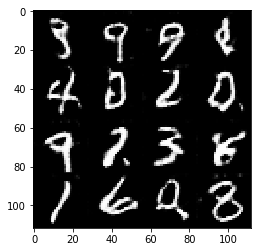

Epoch 2/2... Discriminator Loss: 0.9956... Generator Loss: 1.2288
Epoch 2/2... Discriminator Loss: 1.3747... Generator Loss: 0.6073
Epoch 2/2... Discriminator Loss: 1.1093... Generator Loss: 0.8444
Epoch 2/2... Discriminator Loss: 0.8516... Generator Loss: 1.3590
Epoch 2/2... Discriminator Loss: 1.2443... Generator Loss: 1.5578
Epoch 2/2... Discriminator Loss: 1.5569... Generator Loss: 0.5099
Epoch 2/2... Discriminator Loss: 0.8545... Generator Loss: 1.3771
Epoch 2/2... Discriminator Loss: 1.0975... Generator Loss: 0.8059
Epoch 2/2... Discriminator Loss: 0.7250... Generator Loss: 1.5655
Epoch 2/2... Discriminator Loss: 0.8783... Generator Loss: 1.1791


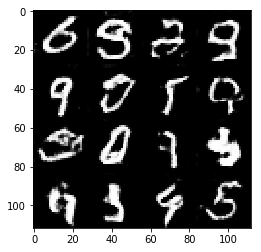

Epoch 2/2... Discriminator Loss: 0.7822... Generator Loss: 2.1091
Epoch 2/2... Discriminator Loss: 1.0810... Generator Loss: 0.9725
Epoch 2/2... Discriminator Loss: 1.2637... Generator Loss: 0.6123
Epoch 2/2... Discriminator Loss: 1.0276... Generator Loss: 0.8657
Epoch 2/2... Discriminator Loss: 0.7012... Generator Loss: 2.3370
Epoch 2/2... Discriminator Loss: 0.8859... Generator Loss: 1.1322
Epoch 2/2... Discriminator Loss: 1.1513... Generator Loss: 0.8319
Epoch 2/2... Discriminator Loss: 0.7528... Generator Loss: 1.4900
Epoch 2/2... Discriminator Loss: 1.3380... Generator Loss: 0.6363
Epoch 2/2... Discriminator Loss: 0.9946... Generator Loss: 1.8288


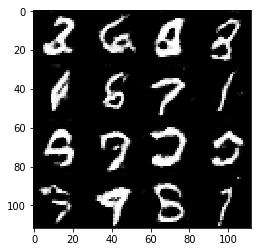

Epoch 2/2... Discriminator Loss: 1.1074... Generator Loss: 1.8707
Epoch 2/2... Discriminator Loss: 0.8398... Generator Loss: 1.7327
Epoch 2/2... Discriminator Loss: 0.8500... Generator Loss: 1.8709
Epoch 2/2... Discriminator Loss: 0.7138... Generator Loss: 1.5967
Epoch 2/2... Discriminator Loss: 0.9876... Generator Loss: 0.9807
Epoch 2/2... Discriminator Loss: 0.7663... Generator Loss: 1.5592
Epoch 2/2... Discriminator Loss: 1.1737... Generator Loss: 2.6911
Epoch 2/2... Discriminator Loss: 1.0005... Generator Loss: 0.9267
Epoch 2/2... Discriminator Loss: 1.2133... Generator Loss: 0.7207
Epoch 2/2... Discriminator Loss: 0.8185... Generator Loss: 1.1434


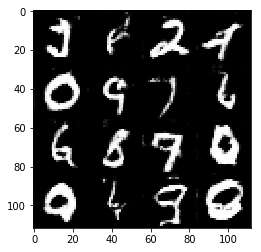

Epoch 2/2... Discriminator Loss: 1.4482... Generator Loss: 0.5142
Epoch 2/2... Discriminator Loss: 0.9713... Generator Loss: 1.3302
Epoch 2/2... Discriminator Loss: 0.9802... Generator Loss: 0.9410
Epoch 2/2... Discriminator Loss: 1.1591... Generator Loss: 0.8691
Epoch 2/2... Discriminator Loss: 1.0031... Generator Loss: 0.8541
Epoch 2/2... Discriminator Loss: 0.8469... Generator Loss: 1.0950
Epoch 2/2... Discriminator Loss: 1.1300... Generator Loss: 0.8317
Epoch 2/2... Discriminator Loss: 0.9378... Generator Loss: 0.8921
Epoch 2/2... Discriminator Loss: 0.7744... Generator Loss: 1.5016
Epoch 2/2... Discriminator Loss: 0.9084... Generator Loss: 1.0582


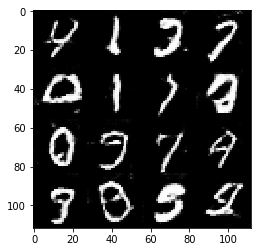

Epoch 2/2... Discriminator Loss: 0.8747... Generator Loss: 1.0120
Epoch 2/2... Discriminator Loss: 1.2847... Generator Loss: 0.5656
Epoch 2/2... Discriminator Loss: 0.9391... Generator Loss: 1.7389
Epoch 2/2... Discriminator Loss: 0.9520... Generator Loss: 1.0517
Epoch 2/2... Discriminator Loss: 0.9146... Generator Loss: 1.0495
Epoch 2/2... Discriminator Loss: 0.9684... Generator Loss: 0.9563
Epoch 2/2... Discriminator Loss: 0.7785... Generator Loss: 1.5914
Epoch 2/2... Discriminator Loss: 0.8975... Generator Loss: 1.1794
Epoch 2/2... Discriminator Loss: 0.7821... Generator Loss: 1.9291
Epoch 2/2... Discriminator Loss: 0.8253... Generator Loss: 1.4384


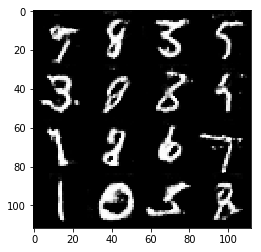

Epoch 2/2... Discriminator Loss: 0.8609... Generator Loss: 1.0951
Epoch 2/2... Discriminator Loss: 0.8054... Generator Loss: 1.2249
Epoch 2/2... Discriminator Loss: 0.7681... Generator Loss: 1.5014
Epoch 2/2... Discriminator Loss: 0.9440... Generator Loss: 1.0735
Epoch 2/2... Discriminator Loss: 0.8677... Generator Loss: 2.4476
Epoch 2/2... Discriminator Loss: 0.9083... Generator Loss: 1.8192
Epoch 2/2... Discriminator Loss: 0.8023... Generator Loss: 1.2844
Epoch 2/2... Discriminator Loss: 0.9048... Generator Loss: 1.1618
Epoch 2/2... Discriminator Loss: 0.9229... Generator Loss: 1.1618
Epoch 2/2... Discriminator Loss: 0.8622... Generator Loss: 1.6042


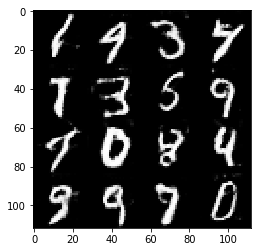

Epoch 2/2... Discriminator Loss: 1.0648... Generator Loss: 0.6121
Epoch 2/2... Discriminator Loss: 0.9477... Generator Loss: 2.5671
Epoch 2/2... Discriminator Loss: 0.9980... Generator Loss: 0.9201
Epoch 2/2... Discriminator Loss: 0.9399... Generator Loss: 1.0598
Epoch 2/2... Discriminator Loss: 1.0351... Generator Loss: 0.8658
Epoch 2/2... Discriminator Loss: 0.9037... Generator Loss: 2.2806
Epoch 2/2... Discriminator Loss: 1.1957... Generator Loss: 0.5680
Epoch 2/2... Discriminator Loss: 0.7948... Generator Loss: 1.1570
Epoch 2/2... Discriminator Loss: 0.7637... Generator Loss: 1.6288
Epoch 2/2... Discriminator Loss: 1.2918... Generator Loss: 0.6797


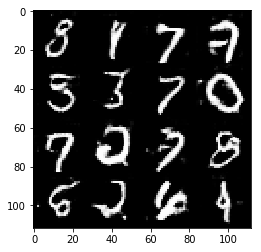

Epoch 2/2... Discriminator Loss: 0.7920... Generator Loss: 1.4982
Epoch 2/2... Discriminator Loss: 0.9253... Generator Loss: 1.0853
Epoch 2/2... Discriminator Loss: 1.1913... Generator Loss: 2.9509
Epoch 2/2... Discriminator Loss: 1.0762... Generator Loss: 0.8011
Epoch 2/2... Discriminator Loss: 0.7743... Generator Loss: 2.0687
Epoch 2/2... Discriminator Loss: 1.1866... Generator Loss: 0.7117
Epoch 2/2... Discriminator Loss: 0.9673... Generator Loss: 1.0760
Epoch 2/2... Discriminator Loss: 0.9639... Generator Loss: 1.1388
Epoch 2/2... Discriminator Loss: 1.0593... Generator Loss: 0.9208
Epoch 2/2... Discriminator Loss: 0.8249... Generator Loss: 1.7831


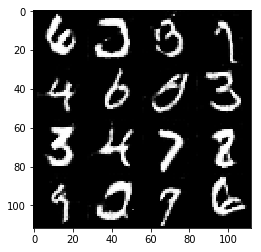

Epoch 2/2... Discriminator Loss: 0.9277... Generator Loss: 1.5189
Epoch 2/2... Discriminator Loss: 1.2295... Generator Loss: 0.6111
Epoch 2/2... Discriminator Loss: 0.8170... Generator Loss: 1.0779
Epoch 2/2... Discriminator Loss: 1.4584... Generator Loss: 3.0660
Epoch 2/2... Discriminator Loss: 0.7144... Generator Loss: 1.8447
Epoch 2/2... Discriminator Loss: 1.0603... Generator Loss: 0.9151
Epoch 2/2... Discriminator Loss: 0.9220... Generator Loss: 1.2840
Epoch 2/2... Discriminator Loss: 0.7206... Generator Loss: 1.5383
Epoch 2/2... Discriminator Loss: 0.8866... Generator Loss: 1.2909
Epoch 2/2... Discriminator Loss: 0.8814... Generator Loss: 1.1179


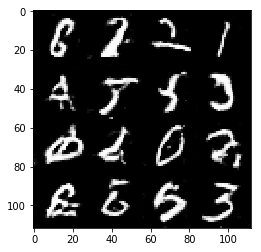

Epoch 2/2... Discriminator Loss: 1.0683... Generator Loss: 0.8588
Epoch 2/2... Discriminator Loss: 0.6944... Generator Loss: 1.6218
Epoch 2/2... Discriminator Loss: 0.6399... Generator Loss: 1.6740
Epoch 2/2... Discriminator Loss: 1.5506... Generator Loss: 2.7341
Epoch 2/2... Discriminator Loss: 0.9235... Generator Loss: 1.1095
Epoch 2/2... Discriminator Loss: 0.9671... Generator Loss: 1.2846
Epoch 2/2... Discriminator Loss: 0.7317... Generator Loss: 2.3035
Epoch 2/2... Discriminator Loss: 1.5650... Generator Loss: 2.8211
Epoch 2/2... Discriminator Loss: 0.7737... Generator Loss: 1.7901
Epoch 2/2... Discriminator Loss: 0.9344... Generator Loss: 0.9438


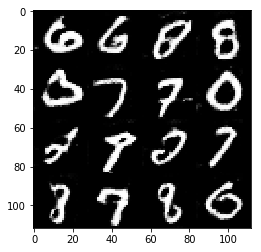

Epoch 2/2... Discriminator Loss: 1.4276... Generator Loss: 0.6397
Epoch 2/2... Discriminator Loss: 0.8301... Generator Loss: 1.1375
Epoch 2/2... Discriminator Loss: 1.0164... Generator Loss: 1.0157
Epoch 2/2... Discriminator Loss: 0.8597... Generator Loss: 1.2903
Epoch 2/2... Discriminator Loss: 0.6831... Generator Loss: 1.4766
Epoch 2/2... Discriminator Loss: 0.9058... Generator Loss: 1.1661
Epoch 2/2... Discriminator Loss: 0.9904... Generator Loss: 0.7526
Epoch 2/2... Discriminator Loss: 0.9189... Generator Loss: 1.9788
Epoch 2/2... Discriminator Loss: 0.7952... Generator Loss: 1.3222
Epoch 2/2... Discriminator Loss: 1.1404... Generator Loss: 0.6980


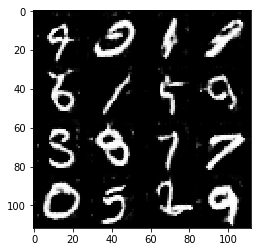

Epoch 2/2... Discriminator Loss: 0.6170... Generator Loss: 1.8728
Epoch 2/2... Discriminator Loss: 1.0043... Generator Loss: 2.0575
Epoch 2/2... Discriminator Loss: 0.7553... Generator Loss: 1.6352
Epoch 2/2... Discriminator Loss: 1.0037... Generator Loss: 0.8725
Epoch 2/2... Discriminator Loss: 1.3655... Generator Loss: 0.7743


In [13]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/2... Discriminator Loss: 1.3527... Generator Loss: 0.7441
Epoch 1/2... Discriminator Loss: 0.6500... Generator Loss: 1.7216
Epoch 1/2... Discriminator Loss: 0.6013... Generator Loss: 1.9100
Epoch 1/2... Discriminator Loss: 1.6283... Generator Loss: 0.5331
Epoch 1/2... Discriminator Loss: 0.9095... Generator Loss: 1.6827
Epoch 1/2... Discriminator Loss: 1.7799... Generator Loss: 0.3577
Epoch 1/2... Discriminator Loss: 1.8813... Generator Loss: 0.3464
Epoch 1/2... Discriminator Loss: 0.9581... Generator Loss: 0.9220
Epoch 1/2... Discriminator Loss: 0.8006... Generator Loss: 1.3042
Epoch 1/2... Discriminator Loss: 0.7002... Generator Loss: 2.4172


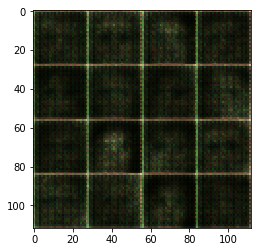

Epoch 1/2... Discriminator Loss: 1.0582... Generator Loss: 0.7849
Epoch 1/2... Discriminator Loss: 0.7550... Generator Loss: 1.4113
Epoch 1/2... Discriminator Loss: 0.8468... Generator Loss: 1.0669
Epoch 1/2... Discriminator Loss: 1.0375... Generator Loss: 0.9341
Epoch 1/2... Discriminator Loss: 1.8932... Generator Loss: 0.3409
Epoch 1/2... Discriminator Loss: 1.1923... Generator Loss: 2.6641
Epoch 1/2... Discriminator Loss: 0.6801... Generator Loss: 2.3187
Epoch 1/2... Discriminator Loss: 0.6967... Generator Loss: 1.8098
Epoch 1/2... Discriminator Loss: 1.5364... Generator Loss: 0.5643
Epoch 1/2... Discriminator Loss: 1.1817... Generator Loss: 0.6174


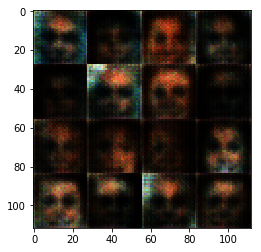

Epoch 1/2... Discriminator Loss: 0.7422... Generator Loss: 1.5077
Epoch 1/2... Discriminator Loss: 1.0543... Generator Loss: 2.8390
Epoch 1/2... Discriminator Loss: 1.1233... Generator Loss: 0.8370
Epoch 1/2... Discriminator Loss: 1.4078... Generator Loss: 0.6942
Epoch 1/2... Discriminator Loss: 1.9338... Generator Loss: 0.2998
Epoch 1/2... Discriminator Loss: 1.7293... Generator Loss: 0.3695
Epoch 1/2... Discriminator Loss: 0.8419... Generator Loss: 1.3718
Epoch 1/2... Discriminator Loss: 0.9122... Generator Loss: 1.0264
Epoch 1/2... Discriminator Loss: 0.5779... Generator Loss: 3.2783
Epoch 1/2... Discriminator Loss: 0.6318... Generator Loss: 2.4581


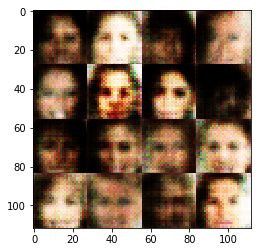

Epoch 1/2... Discriminator Loss: 2.1108... Generator Loss: 0.2441
Epoch 1/2... Discriminator Loss: 0.8792... Generator Loss: 1.2130
Epoch 1/2... Discriminator Loss: 1.1945... Generator Loss: 0.6938
Epoch 1/2... Discriminator Loss: 0.6835... Generator Loss: 1.5153
Epoch 1/2... Discriminator Loss: 1.4790... Generator Loss: 0.5202
Epoch 1/2... Discriminator Loss: 0.9241... Generator Loss: 3.5050
Epoch 1/2... Discriminator Loss: 0.8672... Generator Loss: 1.3024
Epoch 1/2... Discriminator Loss: 1.3641... Generator Loss: 0.6909
Epoch 1/2... Discriminator Loss: 1.2235... Generator Loss: 0.6543
Epoch 1/2... Discriminator Loss: 0.7534... Generator Loss: 3.3822


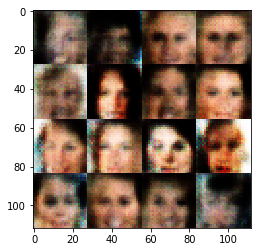

Epoch 1/2... Discriminator Loss: 0.5681... Generator Loss: 2.4238
Epoch 1/2... Discriminator Loss: 1.4127... Generator Loss: 0.4661
Epoch 1/2... Discriminator Loss: 0.6072... Generator Loss: 3.3215
Epoch 1/2... Discriminator Loss: 1.1318... Generator Loss: 0.8115
Epoch 1/2... Discriminator Loss: 1.4435... Generator Loss: 2.5940
Epoch 1/2... Discriminator Loss: 0.8799... Generator Loss: 1.5371
Epoch 1/2... Discriminator Loss: 1.2078... Generator Loss: 1.8321
Epoch 1/2... Discriminator Loss: 1.1727... Generator Loss: 0.7344
Epoch 1/2... Discriminator Loss: 1.1310... Generator Loss: 0.9048
Epoch 1/2... Discriminator Loss: 0.6761... Generator Loss: 1.6107


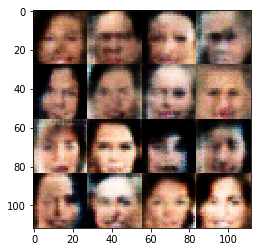

Epoch 1/2... Discriminator Loss: 1.8707... Generator Loss: 0.3352
Epoch 1/2... Discriminator Loss: 2.2066... Generator Loss: 0.1834
Epoch 1/2... Discriminator Loss: 1.5358... Generator Loss: 1.2983
Epoch 1/2... Discriminator Loss: 1.3072... Generator Loss: 0.5868
Epoch 1/2... Discriminator Loss: 0.5403... Generator Loss: 2.0968
Epoch 1/2... Discriminator Loss: 0.9884... Generator Loss: 3.1169
Epoch 1/2... Discriminator Loss: 0.7642... Generator Loss: 1.5506
Epoch 1/2... Discriminator Loss: 2.0217... Generator Loss: 1.4728
Epoch 1/2... Discriminator Loss: 1.0314... Generator Loss: 0.8396
Epoch 1/2... Discriminator Loss: 0.6029... Generator Loss: 1.8941


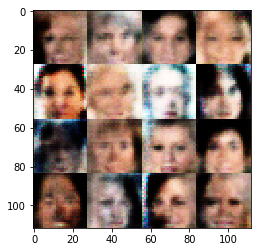

Epoch 1/2... Discriminator Loss: 1.3876... Generator Loss: 1.0618
Epoch 1/2... Discriminator Loss: 0.6830... Generator Loss: 1.9699
Epoch 1/2... Discriminator Loss: 1.0601... Generator Loss: 0.8208
Epoch 1/2... Discriminator Loss: 0.6464... Generator Loss: 1.8103
Epoch 1/2... Discriminator Loss: 0.8556... Generator Loss: 1.1541
Epoch 1/2... Discriminator Loss: 0.5606... Generator Loss: 3.2626
Epoch 1/2... Discriminator Loss: 0.8550... Generator Loss: 1.0614
Epoch 1/2... Discriminator Loss: 0.5503... Generator Loss: 2.1624
Epoch 1/2... Discriminator Loss: 1.6552... Generator Loss: 0.4897
Epoch 1/2... Discriminator Loss: 1.2896... Generator Loss: 1.1475


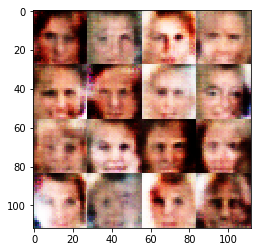

Epoch 1/2... Discriminator Loss: 1.2042... Generator Loss: 0.8219
Epoch 1/2... Discriminator Loss: 0.8898... Generator Loss: 1.2187
Epoch 1/2... Discriminator Loss: 1.1474... Generator Loss: 0.7876
Epoch 1/2... Discriminator Loss: 0.8711... Generator Loss: 0.9760
Epoch 1/2... Discriminator Loss: 1.0372... Generator Loss: 0.7997
Epoch 1/2... Discriminator Loss: 1.3380... Generator Loss: 1.0409
Epoch 1/2... Discriminator Loss: 0.4542... Generator Loss: 3.0485
Epoch 1/2... Discriminator Loss: 0.8223... Generator Loss: 1.1643
Epoch 1/2... Discriminator Loss: 3.9142... Generator Loss: 4.1490
Epoch 1/2... Discriminator Loss: 0.6943... Generator Loss: 2.8249


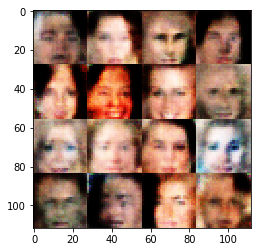

Epoch 1/2... Discriminator Loss: 0.8676... Generator Loss: 1.1661
Epoch 1/2... Discriminator Loss: 1.0039... Generator Loss: 0.9454
Epoch 1/2... Discriminator Loss: 1.8738... Generator Loss: 1.9135
Epoch 1/2... Discriminator Loss: 0.7178... Generator Loss: 2.8565
Epoch 1/2... Discriminator Loss: 1.1223... Generator Loss: 0.8676
Epoch 1/2... Discriminator Loss: 0.9367... Generator Loss: 1.1658
Epoch 1/2... Discriminator Loss: 1.1149... Generator Loss: 0.8353
Epoch 1/2... Discriminator Loss: 0.7906... Generator Loss: 1.1470
Epoch 1/2... Discriminator Loss: 1.7885... Generator Loss: 0.7965
Epoch 1/2... Discriminator Loss: 0.5699... Generator Loss: 2.3957


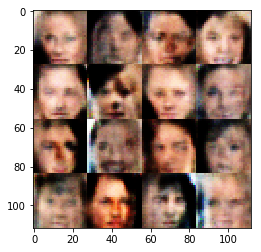

Epoch 1/2... Discriminator Loss: 0.9122... Generator Loss: 1.4699
Epoch 1/2... Discriminator Loss: 1.2174... Generator Loss: 0.6834
Epoch 1/2... Discriminator Loss: 0.9083... Generator Loss: 1.8147
Epoch 1/2... Discriminator Loss: 0.4475... Generator Loss: 3.3473
Epoch 1/2... Discriminator Loss: 0.6174... Generator Loss: 1.7621
Epoch 1/2... Discriminator Loss: 0.5506... Generator Loss: 1.7518
Epoch 1/2... Discriminator Loss: 0.5309... Generator Loss: 2.7193
Epoch 1/2... Discriminator Loss: 1.3450... Generator Loss: 0.9057
Epoch 1/2... Discriminator Loss: 0.8162... Generator Loss: 1.0980
Epoch 1/2... Discriminator Loss: 0.6956... Generator Loss: 1.5223


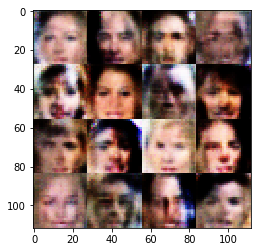

Epoch 1/2... Discriminator Loss: 0.7778... Generator Loss: 2.9936
Epoch 1/2... Discriminator Loss: 0.6490... Generator Loss: 1.5235
Epoch 1/2... Discriminator Loss: 1.8320... Generator Loss: 0.5365
Epoch 1/2... Discriminator Loss: 1.3063... Generator Loss: 0.7113
Epoch 1/2... Discriminator Loss: 0.8580... Generator Loss: 1.3583
Epoch 1/2... Discriminator Loss: 0.9127... Generator Loss: 2.4625
Epoch 1/2... Discriminator Loss: 0.7579... Generator Loss: 2.4637
Epoch 1/2... Discriminator Loss: 0.7816... Generator Loss: 1.1729
Epoch 1/2... Discriminator Loss: 1.1141... Generator Loss: 0.7805
Epoch 1/2... Discriminator Loss: 1.2258... Generator Loss: 1.3244


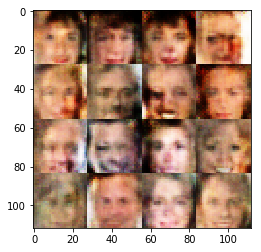

Epoch 1/2... Discriminator Loss: 1.2586... Generator Loss: 1.0932
Epoch 1/2... Discriminator Loss: 0.7256... Generator Loss: 2.5512
Epoch 1/2... Discriminator Loss: 2.7917... Generator Loss: 3.2339
Epoch 1/2... Discriminator Loss: 1.4239... Generator Loss: 0.7956
Epoch 1/2... Discriminator Loss: 0.9379... Generator Loss: 1.6206
Epoch 1/2... Discriminator Loss: 0.8163... Generator Loss: 1.6322
Epoch 1/2... Discriminator Loss: 0.8871... Generator Loss: 1.8763
Epoch 1/2... Discriminator Loss: 1.0022... Generator Loss: 0.8350
Epoch 1/2... Discriminator Loss: 0.8576... Generator Loss: 1.8305
Epoch 1/2... Discriminator Loss: 0.6961... Generator Loss: 1.5345


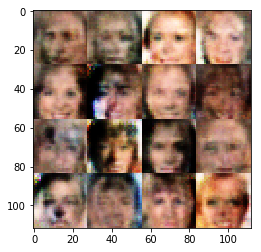

Epoch 1/2... Discriminator Loss: 1.0646... Generator Loss: 1.2620
Epoch 1/2... Discriminator Loss: 1.2078... Generator Loss: 0.7887
Epoch 1/2... Discriminator Loss: 0.4523... Generator Loss: 2.5544
Epoch 1/2... Discriminator Loss: 1.4935... Generator Loss: 0.6730
Epoch 1/2... Discriminator Loss: 1.3325... Generator Loss: 0.8341
Epoch 1/2... Discriminator Loss: 1.3791... Generator Loss: 0.7106
Epoch 1/2... Discriminator Loss: 0.6903... Generator Loss: 2.7142
Epoch 1/2... Discriminator Loss: 1.8315... Generator Loss: 3.1472
Epoch 1/2... Discriminator Loss: 1.2303... Generator Loss: 0.9513
Epoch 1/2... Discriminator Loss: 1.1425... Generator Loss: 0.9482


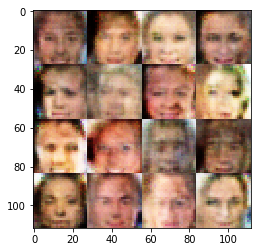

Epoch 1/2... Discriminator Loss: 1.4045... Generator Loss: 0.8142
Epoch 1/2... Discriminator Loss: 1.2191... Generator Loss: 0.8523
Epoch 1/2... Discriminator Loss: 1.2612... Generator Loss: 0.8353
Epoch 1/2... Discriminator Loss: 1.1164... Generator Loss: 0.9950
Epoch 1/2... Discriminator Loss: 1.3326... Generator Loss: 0.6942
Epoch 1/2... Discriminator Loss: 0.7025... Generator Loss: 1.3940
Epoch 1/2... Discriminator Loss: 0.6294... Generator Loss: 1.6274
Epoch 1/2... Discriminator Loss: 0.9757... Generator Loss: 1.5715
Epoch 1/2... Discriminator Loss: 0.4010... Generator Loss: 3.5497
Epoch 1/2... Discriminator Loss: 1.2359... Generator Loss: 0.6404


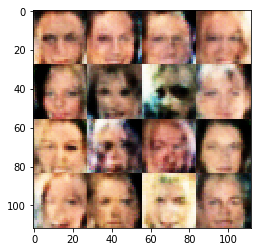

Epoch 1/2... Discriminator Loss: 1.1460... Generator Loss: 1.1685
Epoch 1/2... Discriminator Loss: 1.0527... Generator Loss: 1.3421
Epoch 1/2... Discriminator Loss: 0.9088... Generator Loss: 1.0115
Epoch 1/2... Discriminator Loss: 0.9857... Generator Loss: 1.5271
Epoch 1/2... Discriminator Loss: 0.7218... Generator Loss: 1.2244
Epoch 1/2... Discriminator Loss: 0.4946... Generator Loss: 3.4428
Epoch 1/2... Discriminator Loss: 0.8720... Generator Loss: 1.7329
Epoch 1/2... Discriminator Loss: 1.4810... Generator Loss: 2.1284
Epoch 1/2... Discriminator Loss: 1.4932... Generator Loss: 0.7021
Epoch 1/2... Discriminator Loss: 1.3265... Generator Loss: 0.8035


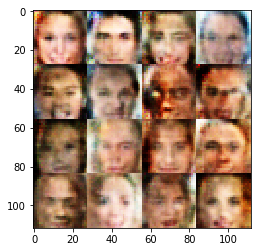

Epoch 1/2... Discriminator Loss: 1.2029... Generator Loss: 0.9449
Epoch 1/2... Discriminator Loss: 1.2377... Generator Loss: 1.1286
Epoch 1/2... Discriminator Loss: 1.3419... Generator Loss: 0.5854
Epoch 1/2... Discriminator Loss: 1.3550... Generator Loss: 0.5622
Epoch 1/2... Discriminator Loss: 0.8033... Generator Loss: 2.8566
Epoch 1/2... Discriminator Loss: 0.6737... Generator Loss: 1.7811
Epoch 1/2... Discriminator Loss: 1.1360... Generator Loss: 1.0740
Epoch 1/2... Discriminator Loss: 1.2917... Generator Loss: 0.7563
Epoch 1/2... Discriminator Loss: 1.1289... Generator Loss: 0.7440
Epoch 1/2... Discriminator Loss: 1.2448... Generator Loss: 2.4382


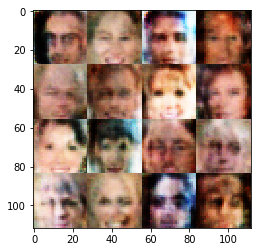

Epoch 1/2... Discriminator Loss: 0.8071... Generator Loss: 1.2417
Epoch 1/2... Discriminator Loss: 1.2073... Generator Loss: 0.9287
Epoch 1/2... Discriminator Loss: 1.0261... Generator Loss: 1.1638
Epoch 1/2... Discriminator Loss: 1.1770... Generator Loss: 2.9101
Epoch 1/2... Discriminator Loss: 0.5644... Generator Loss: 1.6608
Epoch 1/2... Discriminator Loss: 1.3907... Generator Loss: 1.6013
Epoch 1/2... Discriminator Loss: 1.3963... Generator Loss: 0.6562
Epoch 1/2... Discriminator Loss: 1.1556... Generator Loss: 0.9990
Epoch 1/2... Discriminator Loss: 1.3616... Generator Loss: 0.7014
Epoch 1/2... Discriminator Loss: 1.0400... Generator Loss: 2.3358


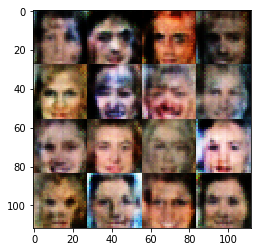

Epoch 1/2... Discriminator Loss: 1.2275... Generator Loss: 0.7314
Epoch 1/2... Discriminator Loss: 0.5857... Generator Loss: 1.9096
Epoch 1/2... Discriminator Loss: 1.2509... Generator Loss: 2.4017
Epoch 1/2... Discriminator Loss: 1.1972... Generator Loss: 4.4054
Epoch 1/2... Discriminator Loss: 1.2712... Generator Loss: 0.5304
Epoch 1/2... Discriminator Loss: 0.8413... Generator Loss: 1.4404
Epoch 1/2... Discriminator Loss: 1.1732... Generator Loss: 0.9778
Epoch 1/2... Discriminator Loss: 1.0617... Generator Loss: 0.7790
Epoch 1/2... Discriminator Loss: 0.7046... Generator Loss: 4.3457
Epoch 1/2... Discriminator Loss: 0.9749... Generator Loss: 3.9640


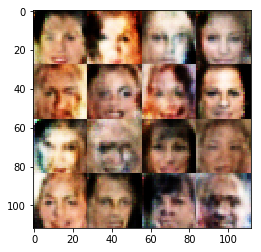

Epoch 1/2... Discriminator Loss: 1.0616... Generator Loss: 0.8033
Epoch 1/2... Discriminator Loss: 1.0091... Generator Loss: 1.5071
Epoch 1/2... Discriminator Loss: 0.5678... Generator Loss: 2.1523
Epoch 1/2... Discriminator Loss: 0.8608... Generator Loss: 0.9438
Epoch 1/2... Discriminator Loss: 1.1318... Generator Loss: 1.1308
Epoch 1/2... Discriminator Loss: 1.3339... Generator Loss: 0.7657
Epoch 1/2... Discriminator Loss: 1.3448... Generator Loss: 1.1145
Epoch 1/2... Discriminator Loss: 0.7857... Generator Loss: 1.3600
Epoch 1/2... Discriminator Loss: 1.1042... Generator Loss: 1.0452
Epoch 1/2... Discriminator Loss: 1.2342... Generator Loss: 0.6513


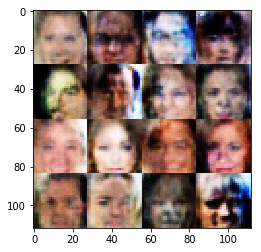

Epoch 1/2... Discriminator Loss: 1.9061... Generator Loss: 2.3779
Epoch 1/2... Discriminator Loss: 1.2178... Generator Loss: 3.4558
Epoch 1/2... Discriminator Loss: 1.2181... Generator Loss: 0.5825
Epoch 1/2... Discriminator Loss: 1.5598... Generator Loss: 0.4140
Epoch 1/2... Discriminator Loss: 1.1164... Generator Loss: 0.8566
Epoch 1/2... Discriminator Loss: 0.6821... Generator Loss: 1.5389
Epoch 1/2... Discriminator Loss: 0.4424... Generator Loss: 2.5982
Epoch 1/2... Discriminator Loss: 0.6341... Generator Loss: 2.2827
Epoch 1/2... Discriminator Loss: 1.1012... Generator Loss: 1.0279
Epoch 1/2... Discriminator Loss: 1.3100... Generator Loss: 0.5051


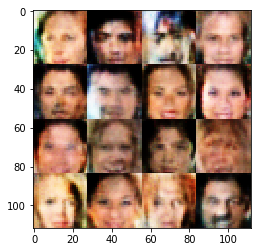

Epoch 1/2... Discriminator Loss: 0.8520... Generator Loss: 1.8729
Epoch 1/2... Discriminator Loss: 1.0658... Generator Loss: 2.2734
Epoch 1/2... Discriminator Loss: 1.2950... Generator Loss: 0.7587
Epoch 1/2... Discriminator Loss: 1.4148... Generator Loss: 0.5121
Epoch 1/2... Discriminator Loss: 0.7439... Generator Loss: 1.2416
Epoch 1/2... Discriminator Loss: 0.8253... Generator Loss: 1.1581
Epoch 1/2... Discriminator Loss: 1.3114... Generator Loss: 2.5617
Epoch 1/2... Discriminator Loss: 0.5753... Generator Loss: 1.6839
Epoch 1/2... Discriminator Loss: 0.5229... Generator Loss: 2.2332
Epoch 1/2... Discriminator Loss: 1.5306... Generator Loss: 0.4847


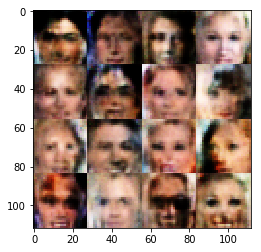

Epoch 1/2... Discriminator Loss: 0.8380... Generator Loss: 1.9667
Epoch 1/2... Discriminator Loss: 1.3826... Generator Loss: 3.1068
Epoch 1/2... Discriminator Loss: 0.5349... Generator Loss: 2.1467
Epoch 1/2... Discriminator Loss: 0.6192... Generator Loss: 1.7908
Epoch 1/2... Discriminator Loss: 0.9988... Generator Loss: 1.7338
Epoch 1/2... Discriminator Loss: 0.9179... Generator Loss: 2.0730
Epoch 1/2... Discriminator Loss: 0.9208... Generator Loss: 1.2010
Epoch 1/2... Discriminator Loss: 1.2365... Generator Loss: 1.5682
Epoch 1/2... Discriminator Loss: 1.2375... Generator Loss: 0.7003
Epoch 1/2... Discriminator Loss: 0.6237... Generator Loss: 1.9393


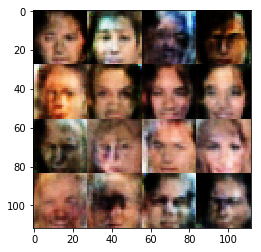

Epoch 1/2... Discriminator Loss: 0.6877... Generator Loss: 1.4415
Epoch 1/2... Discriminator Loss: 0.4057... Generator Loss: 3.4603
Epoch 1/2... Discriminator Loss: 0.5708... Generator Loss: 2.2479
Epoch 1/2... Discriminator Loss: 1.2476... Generator Loss: 0.6367
Epoch 1/2... Discriminator Loss: 0.8769... Generator Loss: 2.4431
Epoch 1/2... Discriminator Loss: 0.7614... Generator Loss: 1.4297
Epoch 1/2... Discriminator Loss: 1.3342... Generator Loss: 0.5650
Epoch 1/2... Discriminator Loss: 1.0354... Generator Loss: 0.8336
Epoch 1/2... Discriminator Loss: 0.5309... Generator Loss: 1.8054
Epoch 1/2... Discriminator Loss: 1.1129... Generator Loss: 0.9150


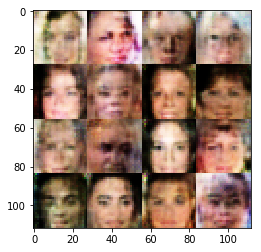

Epoch 1/2... Discriminator Loss: 0.7337... Generator Loss: 1.4886
Epoch 1/2... Discriminator Loss: 0.6476... Generator Loss: 3.1054
Epoch 1/2... Discriminator Loss: 0.4353... Generator Loss: 2.9918
Epoch 1/2... Discriminator Loss: 0.8631... Generator Loss: 2.3468
Epoch 1/2... Discriminator Loss: 0.4353... Generator Loss: 2.8674
Epoch 1/2... Discriminator Loss: 1.1296... Generator Loss: 0.9590
Epoch 1/2... Discriminator Loss: 1.3147... Generator Loss: 0.9382
Epoch 1/2... Discriminator Loss: 0.9802... Generator Loss: 2.0138
Epoch 1/2... Discriminator Loss: 0.9197... Generator Loss: 1.1539
Epoch 1/2... Discriminator Loss: 1.0117... Generator Loss: 0.7913


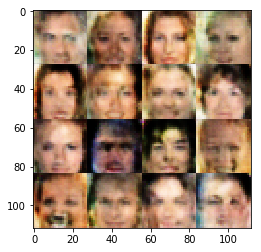

Epoch 1/2... Discriminator Loss: 1.7632... Generator Loss: 0.3619
Epoch 1/2... Discriminator Loss: 1.3039... Generator Loss: 0.6790
Epoch 1/2... Discriminator Loss: 0.7647... Generator Loss: 1.2480
Epoch 1/2... Discriminator Loss: 0.5950... Generator Loss: 1.9499
Epoch 1/2... Discriminator Loss: 0.6168... Generator Loss: 1.8552
Epoch 1/2... Discriminator Loss: 1.4569... Generator Loss: 0.5906
Epoch 1/2... Discriminator Loss: 0.9502... Generator Loss: 0.8008
Epoch 1/2... Discriminator Loss: 1.0776... Generator Loss: 0.8872
Epoch 1/2... Discriminator Loss: 0.5650... Generator Loss: 1.9055
Epoch 1/2... Discriminator Loss: 1.1497... Generator Loss: 2.0920


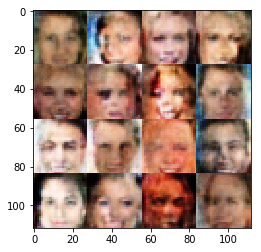

Epoch 1/2... Discriminator Loss: 0.6424... Generator Loss: 1.6117
Epoch 1/2... Discriminator Loss: 1.2344... Generator Loss: 1.2840
Epoch 1/2... Discriminator Loss: 1.0607... Generator Loss: 1.7234
Epoch 1/2... Discriminator Loss: 0.7913... Generator Loss: 2.1248
Epoch 1/2... Discriminator Loss: 0.8841... Generator Loss: 1.2728
Epoch 1/2... Discriminator Loss: 0.8788... Generator Loss: 3.5026
Epoch 1/2... Discriminator Loss: 0.8582... Generator Loss: 0.9620
Epoch 1/2... Discriminator Loss: 0.6319... Generator Loss: 1.8224
Epoch 1/2... Discriminator Loss: 0.9369... Generator Loss: 1.2365
Epoch 1/2... Discriminator Loss: 0.7210... Generator Loss: 2.9737


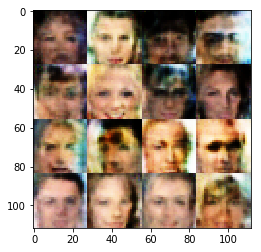

Epoch 1/2... Discriminator Loss: 0.7970... Generator Loss: 1.1979
Epoch 1/2... Discriminator Loss: 0.5156... Generator Loss: 2.6586
Epoch 1/2... Discriminator Loss: 1.9408... Generator Loss: 1.6482
Epoch 1/2... Discriminator Loss: 0.9812... Generator Loss: 0.9050
Epoch 1/2... Discriminator Loss: 0.9813... Generator Loss: 1.2004
Epoch 1/2... Discriminator Loss: 1.1116... Generator Loss: 1.2133
Epoch 1/2... Discriminator Loss: 0.5812... Generator Loss: 1.8297
Epoch 1/2... Discriminator Loss: 0.9998... Generator Loss: 1.1391
Epoch 1/2... Discriminator Loss: 1.0789... Generator Loss: 0.9928
Epoch 1/2... Discriminator Loss: 0.8457... Generator Loss: 1.1506


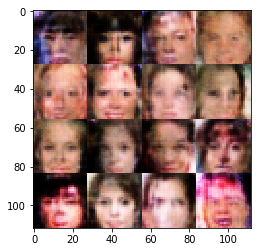

Epoch 1/2... Discriminator Loss: 0.7066... Generator Loss: 1.6224
Epoch 1/2... Discriminator Loss: 1.0584... Generator Loss: 2.6916
Epoch 1/2... Discriminator Loss: 1.4033... Generator Loss: 0.5443
Epoch 1/2... Discriminator Loss: 1.0051... Generator Loss: 0.8451
Epoch 1/2... Discriminator Loss: 0.6739... Generator Loss: 1.5587
Epoch 1/2... Discriminator Loss: 0.6091... Generator Loss: 1.4949
Epoch 1/2... Discriminator Loss: 1.1710... Generator Loss: 0.9034
Epoch 1/2... Discriminator Loss: 0.8674... Generator Loss: 1.0711
Epoch 1/2... Discriminator Loss: 0.7068... Generator Loss: 2.0793
Epoch 1/2... Discriminator Loss: 1.3662... Generator Loss: 1.9755


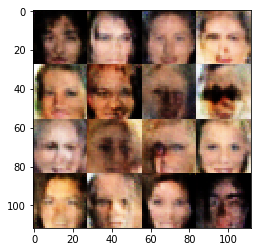

Epoch 1/2... Discriminator Loss: 0.5631... Generator Loss: 2.3913
Epoch 1/2... Discriminator Loss: 0.7283... Generator Loss: 2.3715
Epoch 1/2... Discriminator Loss: 0.4423... Generator Loss: 3.2729
Epoch 1/2... Discriminator Loss: 0.8024... Generator Loss: 1.2357
Epoch 1/2... Discriminator Loss: 0.8643... Generator Loss: 2.9944
Epoch 1/2... Discriminator Loss: 0.7946... Generator Loss: 1.6211
Epoch 1/2... Discriminator Loss: 0.7609... Generator Loss: 1.2473
Epoch 1/2... Discriminator Loss: 0.6436... Generator Loss: 1.6881
Epoch 1/2... Discriminator Loss: 0.6188... Generator Loss: 2.7487
Epoch 1/2... Discriminator Loss: 0.9420... Generator Loss: 1.1050


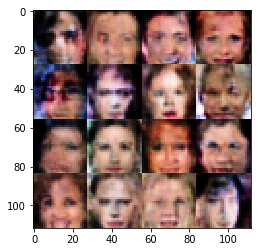

Epoch 1/2... Discriminator Loss: 0.5241... Generator Loss: 2.2233
Epoch 1/2... Discriminator Loss: 1.3005... Generator Loss: 3.0800
Epoch 1/2... Discriminator Loss: 0.5296... Generator Loss: 2.7246
Epoch 1/2... Discriminator Loss: 0.7437... Generator Loss: 2.2253
Epoch 1/2... Discriminator Loss: 0.8696... Generator Loss: 0.9618
Epoch 1/2... Discriminator Loss: 0.6960... Generator Loss: 1.2911
Epoch 1/2... Discriminator Loss: 0.7354... Generator Loss: 1.1554
Epoch 1/2... Discriminator Loss: 0.6052... Generator Loss: 1.6939
Epoch 1/2... Discriminator Loss: 1.0614... Generator Loss: 0.9296
Epoch 1/2... Discriminator Loss: 0.4746... Generator Loss: 2.4189


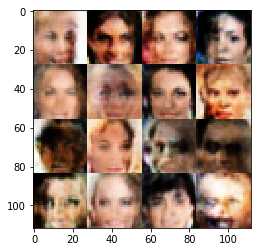

Epoch 1/2... Discriminator Loss: 0.5671... Generator Loss: 2.0742
Epoch 1/2... Discriminator Loss: 0.4237... Generator Loss: 3.0770
Epoch 1/2... Discriminator Loss: 0.8088... Generator Loss: 1.6535
Epoch 1/2... Discriminator Loss: 0.7315... Generator Loss: 2.0687
Epoch 1/2... Discriminator Loss: 0.9086... Generator Loss: 1.7312
Epoch 1/2... Discriminator Loss: 0.4755... Generator Loss: 2.5576
Epoch 1/2... Discriminator Loss: 0.7689... Generator Loss: 1.9223
Epoch 1/2... Discriminator Loss: 0.5468... Generator Loss: 2.0723
Epoch 1/2... Discriminator Loss: 0.9181... Generator Loss: 0.8823
Epoch 1/2... Discriminator Loss: 1.5201... Generator Loss: 0.6350


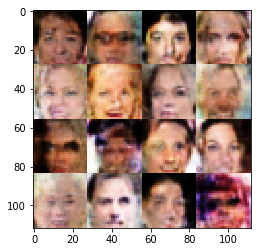

Epoch 1/2... Discriminator Loss: 0.5427... Generator Loss: 2.3718
Epoch 1/2... Discriminator Loss: 0.5721... Generator Loss: 3.5421
Epoch 1/2... Discriminator Loss: 1.1840... Generator Loss: 0.7306
Epoch 1/2... Discriminator Loss: 0.9771... Generator Loss: 1.3101
Epoch 1/2... Discriminator Loss: 0.8956... Generator Loss: 0.8738
Epoch 1/2... Discriminator Loss: 0.9148... Generator Loss: 1.3055
Epoch 1/2... Discriminator Loss: 1.1539... Generator Loss: 0.7889
Epoch 1/2... Discriminator Loss: 0.8293... Generator Loss: 1.5151
Epoch 1/2... Discriminator Loss: 0.4143... Generator Loss: 2.8754
Epoch 1/2... Discriminator Loss: 1.9614... Generator Loss: 0.2376


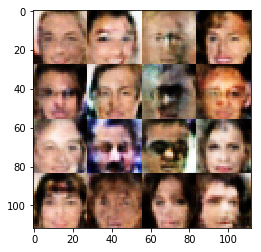

Epoch 1/2... Discriminator Loss: 0.7907... Generator Loss: 1.1561
Epoch 1/2... Discriminator Loss: 0.9816... Generator Loss: 2.1821
Epoch 1/2... Discriminator Loss: 0.9430... Generator Loss: 1.2024
Epoch 1/2... Discriminator Loss: 1.1505... Generator Loss: 0.8206
Epoch 1/2... Discriminator Loss: 0.6851... Generator Loss: 3.4145
Epoch 1/2... Discriminator Loss: 0.4984... Generator Loss: 2.4131
Epoch 1/2... Discriminator Loss: 0.7756... Generator Loss: 1.2244
Epoch 1/2... Discriminator Loss: 0.5229... Generator Loss: 2.6541
Epoch 1/2... Discriminator Loss: 2.0011... Generator Loss: 2.1035
Epoch 1/2... Discriminator Loss: 0.8020... Generator Loss: 2.2938


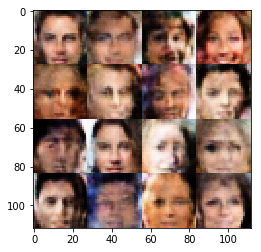

Epoch 1/2... Discriminator Loss: 0.6284... Generator Loss: 1.8702
Epoch 1/2... Discriminator Loss: 1.3560... Generator Loss: 0.5175
Epoch 1/2... Discriminator Loss: 0.4491... Generator Loss: 2.6752
Epoch 1/2... Discriminator Loss: 0.8530... Generator Loss: 1.1480
Epoch 1/2... Discriminator Loss: 0.3830... Generator Loss: 3.9687
Epoch 1/2... Discriminator Loss: 1.0395... Generator Loss: 0.8505
Epoch 1/2... Discriminator Loss: 0.4257... Generator Loss: 3.3583
Epoch 1/2... Discriminator Loss: 0.7286... Generator Loss: 1.1694
Epoch 1/2... Discriminator Loss: 1.2632... Generator Loss: 0.7376
Epoch 1/2... Discriminator Loss: 1.6677... Generator Loss: 2.6187


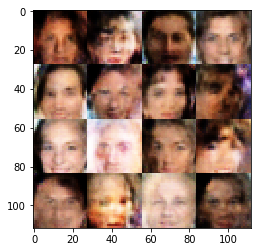

Epoch 1/2... Discriminator Loss: 0.8542... Generator Loss: 1.2698
Epoch 1/2... Discriminator Loss: 1.2319... Generator Loss: 0.7037
Epoch 1/2... Discriminator Loss: 0.4597... Generator Loss: 3.1633
Epoch 1/2... Discriminator Loss: 0.4341... Generator Loss: 3.5430
Epoch 1/2... Discriminator Loss: 0.6377... Generator Loss: 3.3154
Epoch 1/2... Discriminator Loss: 0.5680... Generator Loss: 2.3463
Epoch 1/2... Discriminator Loss: 1.1779... Generator Loss: 0.7442
Epoch 1/2... Discriminator Loss: 0.9887... Generator Loss: 1.1646
Epoch 1/2... Discriminator Loss: 0.4860... Generator Loss: 2.5926
Epoch 1/2... Discriminator Loss: 0.4940... Generator Loss: 2.4992


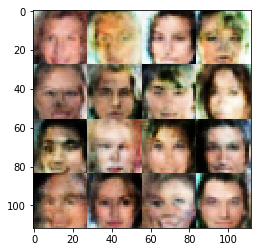

Epoch 1/2... Discriminator Loss: 0.8712... Generator Loss: 1.1248
Epoch 1/2... Discriminator Loss: 1.0553... Generator Loss: 1.3041
Epoch 1/2... Discriminator Loss: 0.6086... Generator Loss: 1.7870
Epoch 1/2... Discriminator Loss: 1.4003... Generator Loss: 0.5051
Epoch 1/2... Discriminator Loss: 0.8824... Generator Loss: 0.9941
Epoch 1/2... Discriminator Loss: 0.7653... Generator Loss: 1.6516
Epoch 1/2... Discriminator Loss: 0.6779... Generator Loss: 1.4295
Epoch 1/2... Discriminator Loss: 1.0961... Generator Loss: 1.4177
Epoch 1/2... Discriminator Loss: 1.0365... Generator Loss: 1.0178
Epoch 1/2... Discriminator Loss: 0.7911... Generator Loss: 2.4660


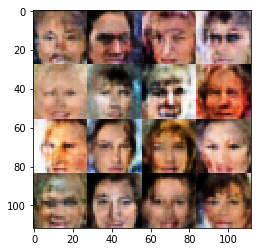

Epoch 1/2... Discriminator Loss: 0.5620... Generator Loss: 1.7274
Epoch 1/2... Discriminator Loss: 0.8868... Generator Loss: 1.0749
Epoch 1/2... Discriminator Loss: 2.0200... Generator Loss: 2.3420
Epoch 1/2... Discriminator Loss: 1.4791... Generator Loss: 1.7472
Epoch 1/2... Discriminator Loss: 0.6943... Generator Loss: 2.8012
Epoch 1/2... Discriminator Loss: 0.4999... Generator Loss: 2.2244
Epoch 1/2... Discriminator Loss: 0.8857... Generator Loss: 1.4016
Epoch 1/2... Discriminator Loss: 1.2238... Generator Loss: 0.5837
Epoch 1/2... Discriminator Loss: 0.9408... Generator Loss: 2.8501
Epoch 1/2... Discriminator Loss: 0.8397... Generator Loss: 1.4965


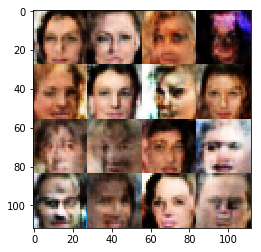

Epoch 1/2... Discriminator Loss: 1.2577... Generator Loss: 2.0443
Epoch 1/2... Discriminator Loss: 0.9875... Generator Loss: 1.0151
Epoch 1/2... Discriminator Loss: 0.9623... Generator Loss: 0.8744
Epoch 1/2... Discriminator Loss: 1.0752... Generator Loss: 0.9677
Epoch 1/2... Discriminator Loss: 0.8725... Generator Loss: 1.0475
Epoch 1/2... Discriminator Loss: 0.9304... Generator Loss: 2.8297
Epoch 1/2... Discriminator Loss: 1.2395... Generator Loss: 4.4281
Epoch 1/2... Discriminator Loss: 0.6058... Generator Loss: 3.9981
Epoch 1/2... Discriminator Loss: 0.8037... Generator Loss: 1.3724
Epoch 1/2... Discriminator Loss: 0.8041... Generator Loss: 1.3133


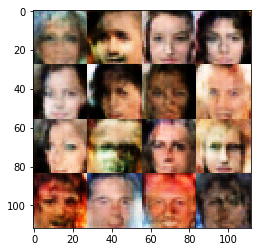

Epoch 1/2... Discriminator Loss: 1.1101... Generator Loss: 1.3346
Epoch 1/2... Discriminator Loss: 0.6484... Generator Loss: 1.8125
Epoch 1/2... Discriminator Loss: 0.7816... Generator Loss: 1.3156
Epoch 1/2... Discriminator Loss: 0.5000... Generator Loss: 2.2733
Epoch 1/2... Discriminator Loss: 1.6239... Generator Loss: 1.7267
Epoch 1/2... Discriminator Loss: 0.5202... Generator Loss: 2.4718
Epoch 1/2... Discriminator Loss: 1.0305... Generator Loss: 1.1251
Epoch 1/2... Discriminator Loss: 0.8691... Generator Loss: 1.1772
Epoch 1/2... Discriminator Loss: 1.2970... Generator Loss: 0.6028
Epoch 1/2... Discriminator Loss: 0.5977... Generator Loss: 2.8453


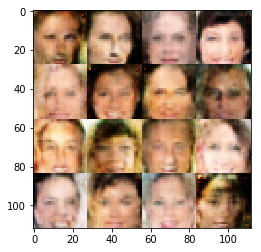

Epoch 1/2... Discriminator Loss: 0.4798... Generator Loss: 3.1950
Epoch 1/2... Discriminator Loss: 1.4363... Generator Loss: 2.2490
Epoch 1/2... Discriminator Loss: 1.1389... Generator Loss: 2.1995
Epoch 1/2... Discriminator Loss: 0.8744... Generator Loss: 3.6141
Epoch 1/2... Discriminator Loss: 0.6994... Generator Loss: 1.7828
Epoch 1/2... Discriminator Loss: 0.5980... Generator Loss: 1.7850
Epoch 1/2... Discriminator Loss: 0.7699... Generator Loss: 2.8137
Epoch 1/2... Discriminator Loss: 0.8556... Generator Loss: 2.0012
Epoch 1/2... Discriminator Loss: 1.6436... Generator Loss: 0.4088
Epoch 1/2... Discriminator Loss: 1.0386... Generator Loss: 0.8324


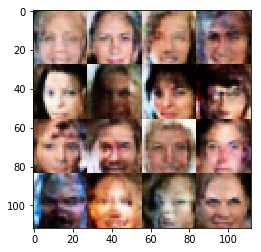

Epoch 1/2... Discriminator Loss: 1.2112... Generator Loss: 1.1532
Epoch 1/2... Discriminator Loss: 0.5021... Generator Loss: 3.9895
Epoch 1/2... Discriminator Loss: 0.4354... Generator Loss: 3.2238
Epoch 1/2... Discriminator Loss: 1.0942... Generator Loss: 2.4254
Epoch 1/2... Discriminator Loss: 0.8817... Generator Loss: 1.1102
Epoch 1/2... Discriminator Loss: 0.6655... Generator Loss: 1.4269
Epoch 1/2... Discriminator Loss: 0.8361... Generator Loss: 1.2549
Epoch 1/2... Discriminator Loss: 0.7008... Generator Loss: 2.7344
Epoch 1/2... Discriminator Loss: 0.8995... Generator Loss: 1.1604
Epoch 1/2... Discriminator Loss: 1.7145... Generator Loss: 0.3492


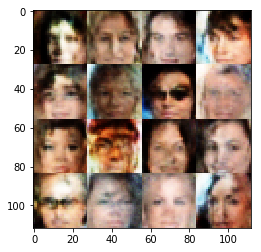

Epoch 1/2... Discriminator Loss: 0.6629... Generator Loss: 3.5056
Epoch 1/2... Discriminator Loss: 0.5082... Generator Loss: 2.2403
Epoch 1/2... Discriminator Loss: 0.9945... Generator Loss: 2.0645
Epoch 1/2... Discriminator Loss: 1.1544... Generator Loss: 1.2166
Epoch 1/2... Discriminator Loss: 1.0701... Generator Loss: 0.9452
Epoch 1/2... Discriminator Loss: 0.8294... Generator Loss: 1.8749
Epoch 1/2... Discriminator Loss: 1.0988... Generator Loss: 1.1907
Epoch 1/2... Discriminator Loss: 2.5849... Generator Loss: 3.1302
Epoch 1/2... Discriminator Loss: 0.5911... Generator Loss: 1.8477
Epoch 1/2... Discriminator Loss: 1.3983... Generator Loss: 1.3488


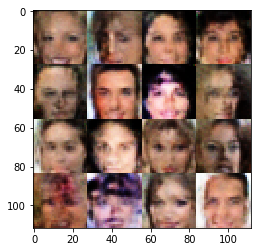

Epoch 1/2... Discriminator Loss: 0.8782... Generator Loss: 1.5192
Epoch 1/2... Discriminator Loss: 0.9945... Generator Loss: 0.9151
Epoch 1/2... Discriminator Loss: 1.1560... Generator Loss: 0.7605
Epoch 1/2... Discriminator Loss: 0.9375... Generator Loss: 1.1401
Epoch 1/2... Discriminator Loss: 0.7942... Generator Loss: 1.3569
Epoch 1/2... Discriminator Loss: 0.6948... Generator Loss: 1.6165
Epoch 1/2... Discriminator Loss: 0.7659... Generator Loss: 1.2552
Epoch 1/2... Discriminator Loss: 1.0419... Generator Loss: 0.9212
Epoch 1/2... Discriminator Loss: 0.5784... Generator Loss: 2.1350
Epoch 1/2... Discriminator Loss: 1.7145... Generator Loss: 2.2827


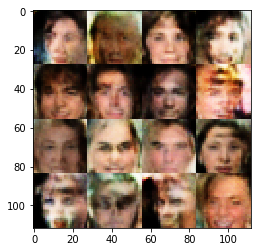

Epoch 1/2... Discriminator Loss: 0.8642... Generator Loss: 1.2504
Epoch 1/2... Discriminator Loss: 1.0885... Generator Loss: 0.9196
Epoch 1/2... Discriminator Loss: 0.5723... Generator Loss: 2.1000
Epoch 1/2... Discriminator Loss: 1.0183... Generator Loss: 1.2827
Epoch 1/2... Discriminator Loss: 0.9248... Generator Loss: 1.7011
Epoch 1/2... Discriminator Loss: 1.0973... Generator Loss: 1.1348
Epoch 1/2... Discriminator Loss: 1.0934... Generator Loss: 0.6957
Epoch 1/2... Discriminator Loss: 0.7547... Generator Loss: 1.9061
Epoch 1/2... Discriminator Loss: 0.6151... Generator Loss: 1.2421
Epoch 1/2... Discriminator Loss: 1.0633... Generator Loss: 0.7404


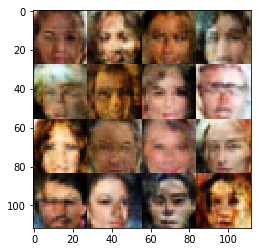

Epoch 1/2... Discriminator Loss: 0.5582... Generator Loss: 2.2618
Epoch 1/2... Discriminator Loss: 0.9870... Generator Loss: 0.8254
Epoch 1/2... Discriminator Loss: 1.2138... Generator Loss: 0.7218
Epoch 1/2... Discriminator Loss: 0.5964... Generator Loss: 3.3763
Epoch 1/2... Discriminator Loss: 1.2439... Generator Loss: 0.7237
Epoch 1/2... Discriminator Loss: 0.9368... Generator Loss: 1.6159
Epoch 1/2... Discriminator Loss: 0.5895... Generator Loss: 2.3324
Epoch 1/2... Discriminator Loss: 0.9735... Generator Loss: 1.5944
Epoch 1/2... Discriminator Loss: 0.9445... Generator Loss: 1.0015
Epoch 1/2... Discriminator Loss: 1.0745... Generator Loss: 0.9893


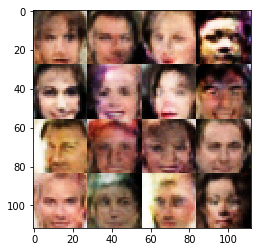

Epoch 1/2... Discriminator Loss: 1.1404... Generator Loss: 0.8540
Epoch 1/2... Discriminator Loss: 0.5413... Generator Loss: 1.9896
Epoch 1/2... Discriminator Loss: 0.8836... Generator Loss: 1.0677
Epoch 1/2... Discriminator Loss: 0.5069... Generator Loss: 2.8145
Epoch 1/2... Discriminator Loss: 1.3596... Generator Loss: 2.6568
Epoch 1/2... Discriminator Loss: 0.7234... Generator Loss: 1.5192
Epoch 1/2... Discriminator Loss: 1.1540... Generator Loss: 0.8085
Epoch 1/2... Discriminator Loss: 0.5785... Generator Loss: 3.1188
Epoch 1/2... Discriminator Loss: 0.4574... Generator Loss: 2.4915
Epoch 1/2... Discriminator Loss: 1.0048... Generator Loss: 1.0762


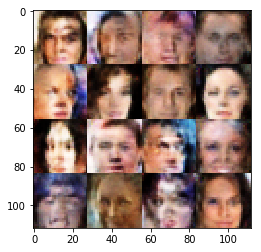

Epoch 1/2... Discriminator Loss: 0.6171... Generator Loss: 1.7430
Epoch 1/2... Discriminator Loss: 2.0513... Generator Loss: 2.1879
Epoch 1/2... Discriminator Loss: 0.5576... Generator Loss: 3.2329
Epoch 1/2... Discriminator Loss: 0.6172... Generator Loss: 1.8988
Epoch 1/2... Discriminator Loss: 1.1418... Generator Loss: 0.7253
Epoch 1/2... Discriminator Loss: 0.8981... Generator Loss: 1.1358
Epoch 1/2... Discriminator Loss: 1.7187... Generator Loss: 3.0843
Epoch 1/2... Discriminator Loss: 0.9568... Generator Loss: 1.0996
Epoch 1/2... Discriminator Loss: 0.6239... Generator Loss: 1.5687
Epoch 1/2... Discriminator Loss: 0.8770... Generator Loss: 2.0495


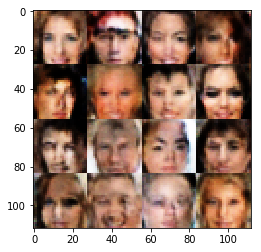

Epoch 1/2... Discriminator Loss: 0.7993... Generator Loss: 1.8512
Epoch 1/2... Discriminator Loss: 1.1287... Generator Loss: 2.3396
Epoch 1/2... Discriminator Loss: 1.1695... Generator Loss: 2.0689
Epoch 1/2... Discriminator Loss: 0.6693... Generator Loss: 1.7486
Epoch 1/2... Discriminator Loss: 0.5873... Generator Loss: 1.7931
Epoch 1/2... Discriminator Loss: 0.8587... Generator Loss: 2.1136
Epoch 1/2... Discriminator Loss: 2.1859... Generator Loss: 2.5048
Epoch 1/2... Discriminator Loss: 0.7945... Generator Loss: 1.0999
Epoch 1/2... Discriminator Loss: 0.9164... Generator Loss: 1.4388
Epoch 1/2... Discriminator Loss: 0.8483... Generator Loss: 1.1842


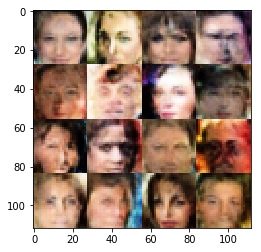

Epoch 1/2... Discriminator Loss: 1.7510... Generator Loss: 1.6232
Epoch 1/2... Discriminator Loss: 1.3588... Generator Loss: 0.6252
Epoch 1/2... Discriminator Loss: 0.7090... Generator Loss: 2.0220
Epoch 1/2... Discriminator Loss: 0.5089... Generator Loss: 2.4297
Epoch 1/2... Discriminator Loss: 0.8046... Generator Loss: 1.1860
Epoch 1/2... Discriminator Loss: 0.9794... Generator Loss: 1.0535
Epoch 1/2... Discriminator Loss: 0.7429... Generator Loss: 1.4529
Epoch 1/2... Discriminator Loss: 1.2141... Generator Loss: 0.7824
Epoch 1/2... Discriminator Loss: 0.7397... Generator Loss: 1.6258
Epoch 1/2... Discriminator Loss: 0.6636... Generator Loss: 1.5891


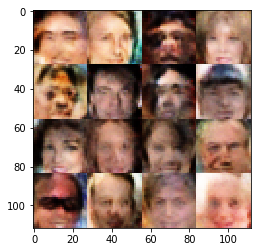

Epoch 1/2... Discriminator Loss: 0.8887... Generator Loss: 0.9877
Epoch 1/2... Discriminator Loss: 0.7567... Generator Loss: 2.2951
Epoch 1/2... Discriminator Loss: 1.2680... Generator Loss: 0.5689
Epoch 1/2... Discriminator Loss: 0.5304... Generator Loss: 2.0971
Epoch 1/2... Discriminator Loss: 0.4231... Generator Loss: 2.8818
Epoch 1/2... Discriminator Loss: 1.0150... Generator Loss: 1.0788
Epoch 1/2... Discriminator Loss: 1.1898... Generator Loss: 1.3808
Epoch 1/2... Discriminator Loss: 0.4864... Generator Loss: 2.3727
Epoch 1/2... Discriminator Loss: 0.7498... Generator Loss: 2.1834
Epoch 1/2... Discriminator Loss: 1.6945... Generator Loss: 0.4867


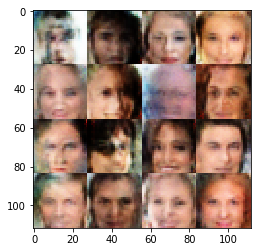

Epoch 1/2... Discriminator Loss: 0.6304... Generator Loss: 1.6521
Epoch 1/2... Discriminator Loss: 0.6144... Generator Loss: 1.8259
Epoch 1/2... Discriminator Loss: 0.6162... Generator Loss: 1.4973
Epoch 1/2... Discriminator Loss: 1.6411... Generator Loss: 3.2321
Epoch 1/2... Discriminator Loss: 1.1461... Generator Loss: 0.6364
Epoch 1/2... Discriminator Loss: 0.7841... Generator Loss: 1.0100
Epoch 1/2... Discriminator Loss: 0.6768... Generator Loss: 1.4805
Epoch 1/2... Discriminator Loss: 2.4511... Generator Loss: 0.1712
Epoch 1/2... Discriminator Loss: 0.6528... Generator Loss: 2.8398
Epoch 1/2... Discriminator Loss: 1.0401... Generator Loss: 0.7913


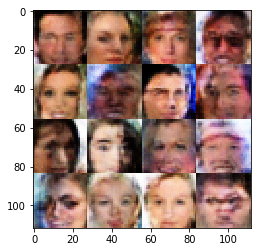

Epoch 1/2... Discriminator Loss: 0.5438... Generator Loss: 2.7657
Epoch 1/2... Discriminator Loss: 0.7011... Generator Loss: 2.0144
Epoch 1/2... Discriminator Loss: 0.6896... Generator Loss: 1.6575
Epoch 1/2... Discriminator Loss: 1.0775... Generator Loss: 0.9876
Epoch 1/2... Discriminator Loss: 1.0640... Generator Loss: 0.7378
Epoch 1/2... Discriminator Loss: 0.8949... Generator Loss: 1.6643
Epoch 1/2... Discriminator Loss: 0.9902... Generator Loss: 0.9777
Epoch 1/2... Discriminator Loss: 0.8915... Generator Loss: 1.1482
Epoch 1/2... Discriminator Loss: 1.6578... Generator Loss: 0.4210
Epoch 1/2... Discriminator Loss: 0.7697... Generator Loss: 2.1896


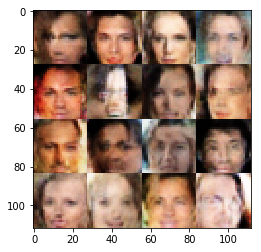

Epoch 1/2... Discriminator Loss: 0.6004... Generator Loss: 2.0043
Epoch 1/2... Discriminator Loss: 2.0094... Generator Loss: 2.8359
Epoch 1/2... Discriminator Loss: 1.3905... Generator Loss: 0.5007
Epoch 1/2... Discriminator Loss: 1.3344... Generator Loss: 0.5362
Epoch 1/2... Discriminator Loss: 0.6054... Generator Loss: 1.9554
Epoch 1/2... Discriminator Loss: 0.9757... Generator Loss: 0.9604
Epoch 1/2... Discriminator Loss: 0.4652... Generator Loss: 2.6243
Epoch 1/2... Discriminator Loss: 0.8669... Generator Loss: 2.0063
Epoch 1/2... Discriminator Loss: 0.6939... Generator Loss: 3.2205
Epoch 1/2... Discriminator Loss: 0.4750... Generator Loss: 2.6837


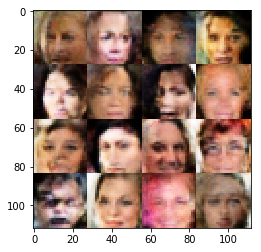

Epoch 1/2... Discriminator Loss: 1.5248... Generator Loss: 2.1809
Epoch 1/2... Discriminator Loss: 0.9046... Generator Loss: 1.0883
Epoch 1/2... Discriminator Loss: 0.5917... Generator Loss: 2.0918
Epoch 1/2... Discriminator Loss: 0.5299... Generator Loss: 2.1690
Epoch 1/2... Discriminator Loss: 0.6885... Generator Loss: 1.7693
Epoch 1/2... Discriminator Loss: 0.8430... Generator Loss: 0.9805
Epoch 1/2... Discriminator Loss: 1.1007... Generator Loss: 0.7879
Epoch 1/2... Discriminator Loss: 1.1472... Generator Loss: 1.1678
Epoch 1/2... Discriminator Loss: 0.7306... Generator Loss: 1.1719
Epoch 1/2... Discriminator Loss: 0.8726... Generator Loss: 0.9647


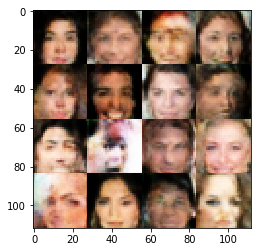

Epoch 1/2... Discriminator Loss: 1.4027... Generator Loss: 0.6356
Epoch 1/2... Discriminator Loss: 0.8810... Generator Loss: 1.0750
Epoch 1/2... Discriminator Loss: 0.7117... Generator Loss: 1.3663
Epoch 1/2... Discriminator Loss: 0.8597... Generator Loss: 1.6740
Epoch 1/2... Discriminator Loss: 0.8190... Generator Loss: 1.0863
Epoch 1/2... Discriminator Loss: 1.9713... Generator Loss: 2.7062
Epoch 1/2... Discriminator Loss: 0.7348... Generator Loss: 1.3457
Epoch 1/2... Discriminator Loss: 0.4831... Generator Loss: 2.2222
Epoch 1/2... Discriminator Loss: 0.7555... Generator Loss: 1.4367
Epoch 1/2... Discriminator Loss: 1.3526... Generator Loss: 2.9089


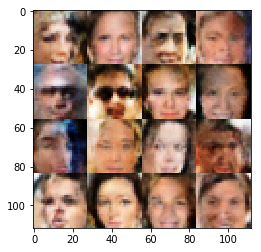

Epoch 1/2... Discriminator Loss: 0.5998... Generator Loss: 2.0988
Epoch 1/2... Discriminator Loss: 0.8183... Generator Loss: 1.0508
Epoch 1/2... Discriminator Loss: 0.5422... Generator Loss: 2.5638
Epoch 1/2... Discriminator Loss: 0.6941... Generator Loss: 2.0044
Epoch 1/2... Discriminator Loss: 0.9995... Generator Loss: 0.9725
Epoch 1/2... Discriminator Loss: 0.6153... Generator Loss: 1.9008
Epoch 1/2... Discriminator Loss: 0.6597... Generator Loss: 4.9897
Epoch 1/2... Discriminator Loss: 0.3851... Generator Loss: 3.7720
Epoch 1/2... Discriminator Loss: 0.5976... Generator Loss: 2.0771
Epoch 1/2... Discriminator Loss: 0.6967... Generator Loss: 1.6173


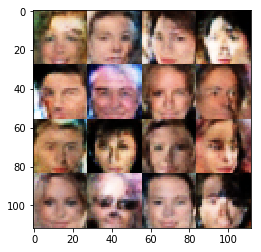

Epoch 1/2... Discriminator Loss: 0.8839... Generator Loss: 1.1144
Epoch 1/2... Discriminator Loss: 0.4888... Generator Loss: 2.4199
Epoch 1/2... Discriminator Loss: 0.9250... Generator Loss: 2.2001
Epoch 1/2... Discriminator Loss: 0.7588... Generator Loss: 1.7298
Epoch 1/2... Discriminator Loss: 0.4720... Generator Loss: 4.5656
Epoch 1/2... Discriminator Loss: 0.6504... Generator Loss: 1.7298
Epoch 1/2... Discriminator Loss: 1.1009... Generator Loss: 0.7878
Epoch 1/2... Discriminator Loss: 1.0972... Generator Loss: 0.7846
Epoch 1/2... Discriminator Loss: 0.7369... Generator Loss: 1.2330
Epoch 1/2... Discriminator Loss: 1.5458... Generator Loss: 0.3856


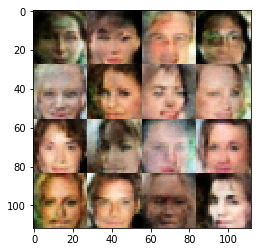

Epoch 1/2... Discriminator Loss: 0.7531... Generator Loss: 2.5703
Epoch 1/2... Discriminator Loss: 0.7755... Generator Loss: 2.7199
Epoch 1/2... Discriminator Loss: 0.5978... Generator Loss: 3.8417
Epoch 1/2... Discriminator Loss: 0.4450... Generator Loss: 3.0501
Epoch 1/2... Discriminator Loss: 1.2414... Generator Loss: 2.0686
Epoch 1/2... Discriminator Loss: 1.2580... Generator Loss: 0.6946
Epoch 1/2... Discriminator Loss: 0.5839... Generator Loss: 2.0646
Epoch 1/2... Discriminator Loss: 1.1243... Generator Loss: 0.7059
Epoch 1/2... Discriminator Loss: 0.5678... Generator Loss: 2.2163
Epoch 1/2... Discriminator Loss: 0.5885... Generator Loss: 1.9021


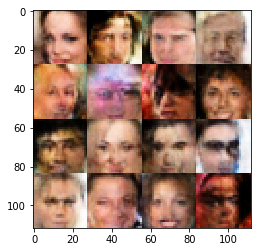

Epoch 1/2... Discriminator Loss: 0.5580... Generator Loss: 3.6624
Epoch 1/2... Discriminator Loss: 0.3732... Generator Loss: 4.0692
Epoch 1/2... Discriminator Loss: 0.8172... Generator Loss: 1.7116
Epoch 1/2... Discriminator Loss: 0.8408... Generator Loss: 1.1698
Epoch 1/2... Discriminator Loss: 0.8593... Generator Loss: 1.1391
Epoch 1/2... Discriminator Loss: 0.8725... Generator Loss: 1.5643
Epoch 1/2... Discriminator Loss: 0.6226... Generator Loss: 1.4826
Epoch 1/2... Discriminator Loss: 0.4972... Generator Loss: 2.0776
Epoch 1/2... Discriminator Loss: 0.4747... Generator Loss: 2.7719
Epoch 1/2... Discriminator Loss: 0.6851... Generator Loss: 1.7313


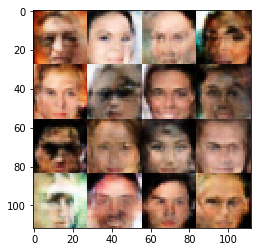

Epoch 1/2... Discriminator Loss: 0.4704... Generator Loss: 2.8424
Epoch 1/2... Discriminator Loss: 0.6111... Generator Loss: 2.5702
Epoch 1/2... Discriminator Loss: 1.1117... Generator Loss: 0.7599
Epoch 1/2... Discriminator Loss: 0.6537... Generator Loss: 4.5400
Epoch 1/2... Discriminator Loss: 0.4883... Generator Loss: 1.9696
Epoch 1/2... Discriminator Loss: 0.7103... Generator Loss: 1.2473
Epoch 1/2... Discriminator Loss: 1.0254... Generator Loss: 1.1216
Epoch 1/2... Discriminator Loss: 0.6260... Generator Loss: 4.7538
Epoch 1/2... Discriminator Loss: 0.6352... Generator Loss: 1.6809
Epoch 1/2... Discriminator Loss: 0.4616... Generator Loss: 2.4669


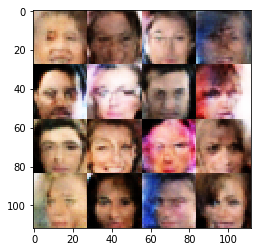

Epoch 1/2... Discriminator Loss: 0.4561... Generator Loss: 2.8498
Epoch 1/2... Discriminator Loss: 0.7405... Generator Loss: 1.5310
Epoch 1/2... Discriminator Loss: 0.7070... Generator Loss: 1.3026
Epoch 1/2... Discriminator Loss: 0.4120... Generator Loss: 3.4616
Epoch 1/2... Discriminator Loss: 0.5386... Generator Loss: 2.8725
Epoch 1/2... Discriminator Loss: 0.4437... Generator Loss: 3.4839
Epoch 1/2... Discriminator Loss: 0.8862... Generator Loss: 3.0924
Epoch 1/2... Discriminator Loss: 0.7027... Generator Loss: 1.5904
Epoch 1/2... Discriminator Loss: 0.6463... Generator Loss: 1.9545
Epoch 1/2... Discriminator Loss: 0.6336... Generator Loss: 1.5970


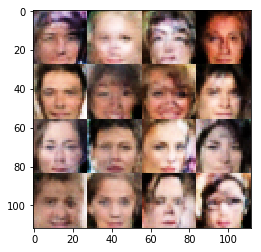

Epoch 1/2... Discriminator Loss: 0.9584... Generator Loss: 1.2450
Epoch 1/2... Discriminator Loss: 0.5250... Generator Loss: 2.9424
Epoch 1/2... Discriminator Loss: 1.4796... Generator Loss: 4.0652
Epoch 1/2... Discriminator Loss: 1.0327... Generator Loss: 0.6905
Epoch 1/2... Discriminator Loss: 1.7206... Generator Loss: 0.4270
Epoch 1/2... Discriminator Loss: 0.6042... Generator Loss: 2.8455
Epoch 1/2... Discriminator Loss: 0.5203... Generator Loss: 2.4573
Epoch 1/2... Discriminator Loss: 0.8464... Generator Loss: 1.2171
Epoch 1/2... Discriminator Loss: 0.6232... Generator Loss: 1.9468
Epoch 1/2... Discriminator Loss: 1.4430... Generator Loss: 0.5391


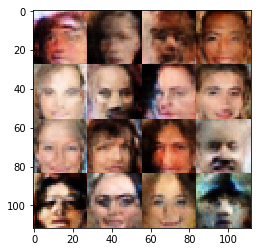

Epoch 1/2... Discriminator Loss: 0.6256... Generator Loss: 2.5377
Epoch 1/2... Discriminator Loss: 0.5099... Generator Loss: 1.6499
Epoch 1/2... Discriminator Loss: 1.0573... Generator Loss: 0.7417
Epoch 1/2... Discriminator Loss: 0.9732... Generator Loss: 0.9394
Epoch 1/2... Discriminator Loss: 0.7044... Generator Loss: 1.6824
Epoch 1/2... Discriminator Loss: 0.5609... Generator Loss: 2.4373
Epoch 1/2... Discriminator Loss: 0.5902... Generator Loss: 2.0714
Epoch 1/2... Discriminator Loss: 0.5655... Generator Loss: 1.9283
Epoch 1/2... Discriminator Loss: 0.5053... Generator Loss: 1.9369
Epoch 1/2... Discriminator Loss: 0.5085... Generator Loss: 2.2731


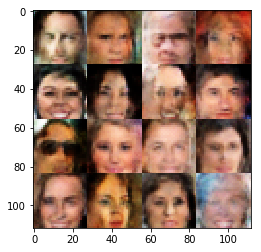

Epoch 1/2... Discriminator Loss: 0.7440... Generator Loss: 2.7836
Epoch 1/2... Discriminator Loss: 1.1157... Generator Loss: 1.0186
Epoch 1/2... Discriminator Loss: 0.5764... Generator Loss: 2.1436
Epoch 2/2... Discriminator Loss: 0.8415... Generator Loss: 3.1061
Epoch 2/2... Discriminator Loss: 2.0472... Generator Loss: 0.2970
Epoch 2/2... Discriminator Loss: 0.6449... Generator Loss: 1.9595
Epoch 2/2... Discriminator Loss: 0.6269... Generator Loss: 1.5456
Epoch 2/2... Discriminator Loss: 1.5907... Generator Loss: 0.3715
Epoch 2/2... Discriminator Loss: 0.5196... Generator Loss: 3.4478
Epoch 2/2... Discriminator Loss: 0.5102... Generator Loss: 2.4077


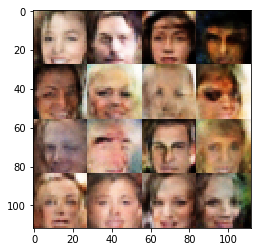

Epoch 2/2... Discriminator Loss: 0.5397... Generator Loss: 2.0052
Epoch 2/2... Discriminator Loss: 0.5170... Generator Loss: 2.2658
Epoch 2/2... Discriminator Loss: 1.0916... Generator Loss: 0.6018
Epoch 2/2... Discriminator Loss: 0.4126... Generator Loss: 3.1815
Epoch 2/2... Discriminator Loss: 0.4250... Generator Loss: 3.6214
Epoch 2/2... Discriminator Loss: 1.5757... Generator Loss: 2.6374
Epoch 2/2... Discriminator Loss: 0.9103... Generator Loss: 1.2087
Epoch 2/2... Discriminator Loss: 0.5678... Generator Loss: 3.5531
Epoch 2/2... Discriminator Loss: 1.8663... Generator Loss: 0.3370
Epoch 2/2... Discriminator Loss: 0.5340... Generator Loss: 2.4305


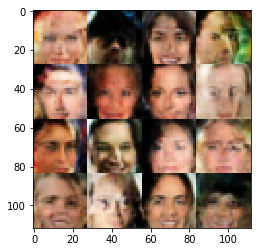

Epoch 2/2... Discriminator Loss: 0.5251... Generator Loss: 2.2994
Epoch 2/2... Discriminator Loss: 0.5056... Generator Loss: 2.7300
Epoch 2/2... Discriminator Loss: 0.9457... Generator Loss: 1.0214
Epoch 2/2... Discriminator Loss: 0.6866... Generator Loss: 1.5530
Epoch 2/2... Discriminator Loss: 0.5843... Generator Loss: 1.9806
Epoch 2/2... Discriminator Loss: 1.4011... Generator Loss: 2.9798
Epoch 2/2... Discriminator Loss: 0.6791... Generator Loss: 1.8108
Epoch 2/2... Discriminator Loss: 1.0538... Generator Loss: 0.8625
Epoch 2/2... Discriminator Loss: 1.0445... Generator Loss: 1.2099
Epoch 2/2... Discriminator Loss: 1.3863... Generator Loss: 1.7931


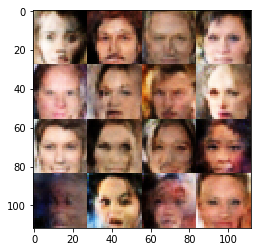

Epoch 2/2... Discriminator Loss: 0.6906... Generator Loss: 1.6408
Epoch 2/2... Discriminator Loss: 1.0991... Generator Loss: 0.8986
Epoch 2/2... Discriminator Loss: 0.4978... Generator Loss: 2.5614
Epoch 2/2... Discriminator Loss: 0.7978... Generator Loss: 1.1483
Epoch 2/2... Discriminator Loss: 0.5677... Generator Loss: 2.2232
Epoch 2/2... Discriminator Loss: 0.4613... Generator Loss: 3.2565
Epoch 2/2... Discriminator Loss: 0.5374... Generator Loss: 3.2781
Epoch 2/2... Discriminator Loss: 2.5869... Generator Loss: 3.2369
Epoch 2/2... Discriminator Loss: 0.7589... Generator Loss: 1.3082
Epoch 2/2... Discriminator Loss: 0.7374... Generator Loss: 1.9885


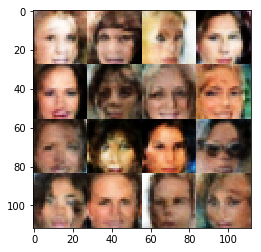

Epoch 2/2... Discriminator Loss: 0.9456... Generator Loss: 0.7094
Epoch 2/2... Discriminator Loss: 0.9249... Generator Loss: 0.9543
Epoch 2/2... Discriminator Loss: 1.4994... Generator Loss: 0.4261
Epoch 2/2... Discriminator Loss: 0.4513... Generator Loss: 4.6491
Epoch 2/2... Discriminator Loss: 1.4139... Generator Loss: 0.6413
Epoch 2/2... Discriminator Loss: 0.6954... Generator Loss: 1.9734
Epoch 2/2... Discriminator Loss: 0.4319... Generator Loss: 4.0783
Epoch 2/2... Discriminator Loss: 0.5257... Generator Loss: 2.5095
Epoch 2/2... Discriminator Loss: 1.1062... Generator Loss: 0.8135
Epoch 2/2... Discriminator Loss: 1.5387... Generator Loss: 0.4417


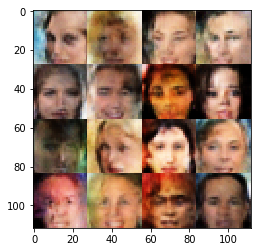

Epoch 2/2... Discriminator Loss: 0.8196... Generator Loss: 1.1718
Epoch 2/2... Discriminator Loss: 0.8113... Generator Loss: 1.2419
Epoch 2/2... Discriminator Loss: 0.7677... Generator Loss: 1.0704
Epoch 2/2... Discriminator Loss: 0.6055... Generator Loss: 1.9807
Epoch 2/2... Discriminator Loss: 0.8574... Generator Loss: 1.1793
Epoch 2/2... Discriminator Loss: 0.6443... Generator Loss: 2.5363
Epoch 2/2... Discriminator Loss: 0.8309... Generator Loss: 1.1825
Epoch 2/2... Discriminator Loss: 0.5603... Generator Loss: 2.2981
Epoch 2/2... Discriminator Loss: 1.1475... Generator Loss: 0.6972
Epoch 2/2... Discriminator Loss: 0.6742... Generator Loss: 1.5523


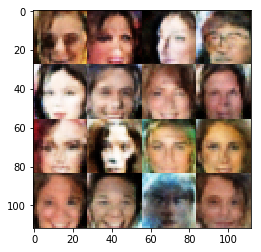

Epoch 2/2... Discriminator Loss: 0.7815... Generator Loss: 3.0067
Epoch 2/2... Discriminator Loss: 1.4957... Generator Loss: 0.4484
Epoch 2/2... Discriminator Loss: 1.3683... Generator Loss: 2.1658
Epoch 2/2... Discriminator Loss: 1.2725... Generator Loss: 0.4779
Epoch 2/2... Discriminator Loss: 0.3607... Generator Loss: 6.1714
Epoch 2/2... Discriminator Loss: 0.5195... Generator Loss: 2.9634
Epoch 2/2... Discriminator Loss: 1.8534... Generator Loss: 0.3019
Epoch 2/2... Discriminator Loss: 0.9859... Generator Loss: 0.9090
Epoch 2/2... Discriminator Loss: 0.4899... Generator Loss: 2.0125
Epoch 2/2... Discriminator Loss: 1.4401... Generator Loss: 0.4332


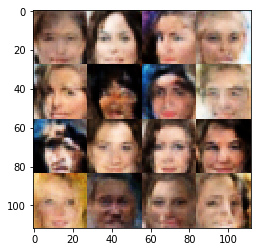

Epoch 2/2... Discriminator Loss: 0.6786... Generator Loss: 1.8722
Epoch 2/2... Discriminator Loss: 0.7114... Generator Loss: 3.6265
Epoch 2/2... Discriminator Loss: 0.5796... Generator Loss: 2.1522
Epoch 2/2... Discriminator Loss: 0.7592... Generator Loss: 1.7011
Epoch 2/2... Discriminator Loss: 0.9470... Generator Loss: 0.9581
Epoch 2/2... Discriminator Loss: 0.4163... Generator Loss: 3.7322
Epoch 2/2... Discriminator Loss: 1.4144... Generator Loss: 2.0290
Epoch 2/2... Discriminator Loss: 0.4014... Generator Loss: 2.9470
Epoch 2/2... Discriminator Loss: 0.4942... Generator Loss: 2.2969
Epoch 2/2... Discriminator Loss: 1.1185... Generator Loss: 0.9741


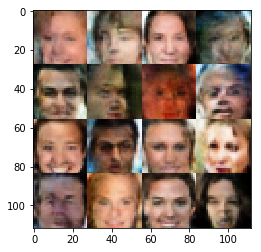

Epoch 2/2... Discriminator Loss: 0.5092... Generator Loss: 2.3334
Epoch 2/2... Discriminator Loss: 0.6230... Generator Loss: 1.4927
Epoch 2/2... Discriminator Loss: 1.5852... Generator Loss: 2.9647
Epoch 2/2... Discriminator Loss: 0.6859... Generator Loss: 1.7397
Epoch 2/2... Discriminator Loss: 0.7826... Generator Loss: 1.2409
Epoch 2/2... Discriminator Loss: 0.8273... Generator Loss: 1.3397
Epoch 2/2... Discriminator Loss: 0.9027... Generator Loss: 1.2303
Epoch 2/2... Discriminator Loss: 0.6646... Generator Loss: 1.6136
Epoch 2/2... Discriminator Loss: 0.4590... Generator Loss: 2.4252
Epoch 2/2... Discriminator Loss: 0.9993... Generator Loss: 0.8364


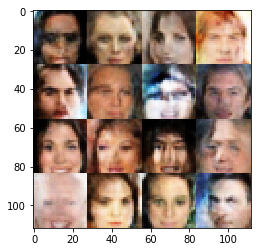

Epoch 2/2... Discriminator Loss: 0.7005... Generator Loss: 1.7618
Epoch 2/2... Discriminator Loss: 1.4382... Generator Loss: 0.5548
Epoch 2/2... Discriminator Loss: 0.7300... Generator Loss: 1.4976
Epoch 2/2... Discriminator Loss: 0.6030... Generator Loss: 2.0528
Epoch 2/2... Discriminator Loss: 0.6900... Generator Loss: 1.8529
Epoch 2/2... Discriminator Loss: 0.5385... Generator Loss: 2.1887
Epoch 2/2... Discriminator Loss: 0.7685... Generator Loss: 5.3190
Epoch 2/2... Discriminator Loss: 0.6715... Generator Loss: 2.2477
Epoch 2/2... Discriminator Loss: 0.6619... Generator Loss: 2.0803
Epoch 2/2... Discriminator Loss: 1.0632... Generator Loss: 0.7286


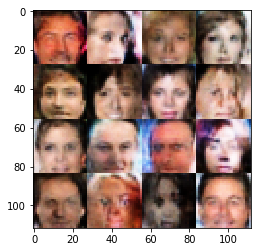

Epoch 2/2... Discriminator Loss: 1.6187... Generator Loss: 0.5100
Epoch 2/2... Discriminator Loss: 1.0646... Generator Loss: 1.1694
Epoch 2/2... Discriminator Loss: 0.5013... Generator Loss: 2.9031
Epoch 2/2... Discriminator Loss: 1.1722... Generator Loss: 0.8107
Epoch 2/2... Discriminator Loss: 0.4560... Generator Loss: 3.2874
Epoch 2/2... Discriminator Loss: 0.4586... Generator Loss: 4.2152
Epoch 2/2... Discriminator Loss: 0.4439... Generator Loss: 2.8660
Epoch 2/2... Discriminator Loss: 0.5856... Generator Loss: 2.0475
Epoch 2/2... Discriminator Loss: 0.9220... Generator Loss: 0.7672
Epoch 2/2... Discriminator Loss: 0.4249... Generator Loss: 3.2333


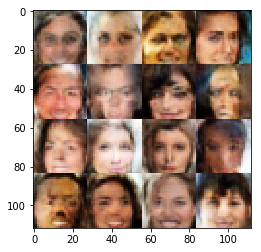

Epoch 2/2... Discriminator Loss: 0.7431... Generator Loss: 1.4154
Epoch 2/2... Discriminator Loss: 0.7439... Generator Loss: 1.2952
Epoch 2/2... Discriminator Loss: 0.5478... Generator Loss: 2.4250
Epoch 2/2... Discriminator Loss: 0.5094... Generator Loss: 2.5212
Epoch 2/2... Discriminator Loss: 0.4941... Generator Loss: 2.5087
Epoch 2/2... Discriminator Loss: 0.6186... Generator Loss: 2.1644
Epoch 2/2... Discriminator Loss: 1.5776... Generator Loss: 2.6540
Epoch 2/2... Discriminator Loss: 1.0570... Generator Loss: 2.2425
Epoch 2/2... Discriminator Loss: 0.7112... Generator Loss: 1.6106
Epoch 2/2... Discriminator Loss: 0.5309... Generator Loss: 2.2881


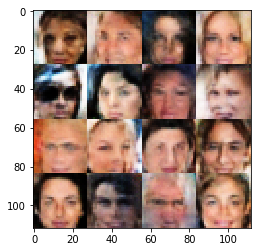

Epoch 2/2... Discriminator Loss: 1.1176... Generator Loss: 0.7537
Epoch 2/2... Discriminator Loss: 0.8233... Generator Loss: 1.5619
Epoch 2/2... Discriminator Loss: 0.6930... Generator Loss: 1.5344
Epoch 2/2... Discriminator Loss: 0.5768... Generator Loss: 1.9690
Epoch 2/2... Discriminator Loss: 1.0824... Generator Loss: 2.6010
Epoch 2/2... Discriminator Loss: 0.6084... Generator Loss: 1.8023
Epoch 2/2... Discriminator Loss: 0.5591... Generator Loss: 3.5388
Epoch 2/2... Discriminator Loss: 0.4917... Generator Loss: 2.3090
Epoch 2/2... Discriminator Loss: 0.6683... Generator Loss: 2.0163
Epoch 2/2... Discriminator Loss: 0.5870... Generator Loss: 1.9557


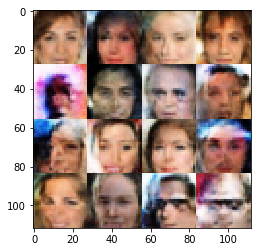

Epoch 2/2... Discriminator Loss: 0.7498... Generator Loss: 2.5092
Epoch 2/2... Discriminator Loss: 1.0721... Generator Loss: 3.4711
Epoch 2/2... Discriminator Loss: 0.6824... Generator Loss: 1.9345
Epoch 2/2... Discriminator Loss: 1.0662... Generator Loss: 0.9588
Epoch 2/2... Discriminator Loss: 1.0523... Generator Loss: 0.9347
Epoch 2/2... Discriminator Loss: 0.6284... Generator Loss: 1.5853
Epoch 2/2... Discriminator Loss: 0.7808... Generator Loss: 1.9874
Epoch 2/2... Discriminator Loss: 0.6757... Generator Loss: 1.6377
Epoch 2/2... Discriminator Loss: 0.5751... Generator Loss: 1.8751
Epoch 2/2... Discriminator Loss: 0.8062... Generator Loss: 1.2870


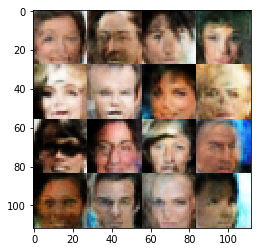

Epoch 2/2... Discriminator Loss: 0.6796... Generator Loss: 2.1359
Epoch 2/2... Discriminator Loss: 0.6757... Generator Loss: 1.7858
Epoch 2/2... Discriminator Loss: 0.4577... Generator Loss: 3.5708
Epoch 2/2... Discriminator Loss: 1.2944... Generator Loss: 1.3057
Epoch 2/2... Discriminator Loss: 0.6693... Generator Loss: 1.5661
Epoch 2/2... Discriminator Loss: 0.8497... Generator Loss: 1.3594
Epoch 2/2... Discriminator Loss: 0.5866... Generator Loss: 2.0718
Epoch 2/2... Discriminator Loss: 0.6089... Generator Loss: 1.5818
Epoch 2/2... Discriminator Loss: 1.3299... Generator Loss: 0.6633
Epoch 2/2... Discriminator Loss: 0.9275... Generator Loss: 0.9520


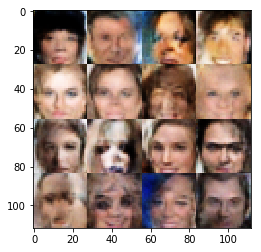

Epoch 2/2... Discriminator Loss: 0.6627... Generator Loss: 2.1381
Epoch 2/2... Discriminator Loss: 1.9131... Generator Loss: 0.3725
Epoch 2/2... Discriminator Loss: 1.0941... Generator Loss: 0.7873
Epoch 2/2... Discriminator Loss: 0.8304... Generator Loss: 1.2557
Epoch 2/2... Discriminator Loss: 0.6886... Generator Loss: 1.4184
Epoch 2/2... Discriminator Loss: 2.0219... Generator Loss: 0.3650
Epoch 2/2... Discriminator Loss: 0.7769... Generator Loss: 1.3805
Epoch 2/2... Discriminator Loss: 0.9150... Generator Loss: 1.1503
Epoch 2/2... Discriminator Loss: 0.8726... Generator Loss: 1.1339
Epoch 2/2... Discriminator Loss: 1.0312... Generator Loss: 0.9374


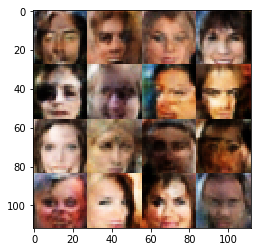

Epoch 2/2... Discriminator Loss: 0.6233... Generator Loss: 1.8096
Epoch 2/2... Discriminator Loss: 0.6209... Generator Loss: 1.9540
Epoch 2/2... Discriminator Loss: 1.1762... Generator Loss: 1.8835
Epoch 2/2... Discriminator Loss: 0.4505... Generator Loss: 3.3094
Epoch 2/2... Discriminator Loss: 0.7589... Generator Loss: 1.6660
Epoch 2/2... Discriminator Loss: 0.5560... Generator Loss: 2.1996
Epoch 2/2... Discriminator Loss: 1.1144... Generator Loss: 4.3391
Epoch 2/2... Discriminator Loss: 0.6389... Generator Loss: 2.1522
Epoch 2/2... Discriminator Loss: 0.6377... Generator Loss: 5.9002
Epoch 2/2... Discriminator Loss: 0.8684... Generator Loss: 1.5541


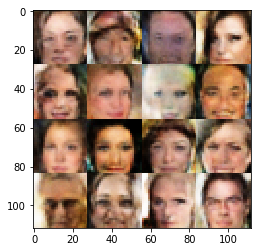

Epoch 2/2... Discriminator Loss: 0.8263... Generator Loss: 2.7666
Epoch 2/2... Discriminator Loss: 0.4711... Generator Loss: 2.7665
Epoch 2/2... Discriminator Loss: 1.2569... Generator Loss: 0.7340
Epoch 2/2... Discriminator Loss: 0.7882... Generator Loss: 2.3540
Epoch 2/2... Discriminator Loss: 0.5128... Generator Loss: 2.3813
Epoch 2/2... Discriminator Loss: 0.6486... Generator Loss: 1.6551
Epoch 2/2... Discriminator Loss: 1.0268... Generator Loss: 0.8153
Epoch 2/2... Discriminator Loss: 1.5602... Generator Loss: 0.5927
Epoch 2/2... Discriminator Loss: 0.8522... Generator Loss: 1.0426
Epoch 2/2... Discriminator Loss: 1.1991... Generator Loss: 2.3134


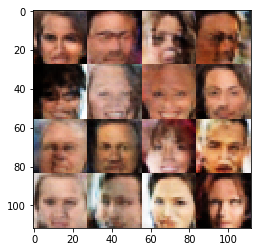

Epoch 2/2... Discriminator Loss: 0.7245... Generator Loss: 1.6771
Epoch 2/2... Discriminator Loss: 0.6955... Generator Loss: 1.7409
Epoch 2/2... Discriminator Loss: 0.9085... Generator Loss: 4.9200
Epoch 2/2... Discriminator Loss: 1.6108... Generator Loss: 0.3625
Epoch 2/2... Discriminator Loss: 0.8349... Generator Loss: 1.7557
Epoch 2/2... Discriminator Loss: 0.9339... Generator Loss: 1.0715
Epoch 2/2... Discriminator Loss: 0.5989... Generator Loss: 1.6252
Epoch 2/2... Discriminator Loss: 1.0441... Generator Loss: 2.4845
Epoch 2/2... Discriminator Loss: 0.7005... Generator Loss: 2.2004
Epoch 2/2... Discriminator Loss: 0.6935... Generator Loss: 1.4559


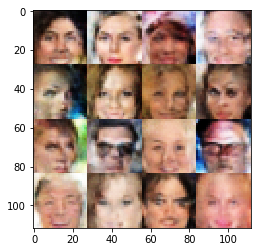

Epoch 2/2... Discriminator Loss: 1.0273... Generator Loss: 0.9605
Epoch 2/2... Discriminator Loss: 0.5853... Generator Loss: 1.7837
Epoch 2/2... Discriminator Loss: 0.7669... Generator Loss: 1.3343
Epoch 2/2... Discriminator Loss: 0.8801... Generator Loss: 1.0259
Epoch 2/2... Discriminator Loss: 1.0118... Generator Loss: 0.8958
Epoch 2/2... Discriminator Loss: 1.7679... Generator Loss: 0.4097
Epoch 2/2... Discriminator Loss: 0.5651... Generator Loss: 2.2700
Epoch 2/2... Discriminator Loss: 0.7253... Generator Loss: 3.4131
Epoch 2/2... Discriminator Loss: 0.7378... Generator Loss: 2.6738
Epoch 2/2... Discriminator Loss: 0.8755... Generator Loss: 1.5790


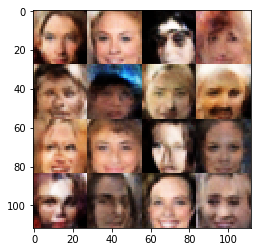

Epoch 2/2... Discriminator Loss: 0.5909... Generator Loss: 2.0713
Epoch 2/2... Discriminator Loss: 0.7147... Generator Loss: 1.3615
Epoch 2/2... Discriminator Loss: 0.7140... Generator Loss: 1.8783
Epoch 2/2... Discriminator Loss: 1.3096... Generator Loss: 0.7499
Epoch 2/2... Discriminator Loss: 0.7065... Generator Loss: 3.1684
Epoch 2/2... Discriminator Loss: 0.6449... Generator Loss: 1.9892
Epoch 2/2... Discriminator Loss: 0.5406... Generator Loss: 2.0467
Epoch 2/2... Discriminator Loss: 0.5937... Generator Loss: 2.0942
Epoch 2/2... Discriminator Loss: 0.8768... Generator Loss: 1.0852
Epoch 2/2... Discriminator Loss: 0.9479... Generator Loss: 1.0164


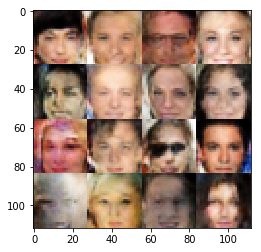

Epoch 2/2... Discriminator Loss: 0.8904... Generator Loss: 2.1571
Epoch 2/2... Discriminator Loss: 0.9949... Generator Loss: 0.9335
Epoch 2/2... Discriminator Loss: 1.3928... Generator Loss: 2.9535
Epoch 2/2... Discriminator Loss: 0.5666... Generator Loss: 2.7065
Epoch 2/2... Discriminator Loss: 0.4448... Generator Loss: 2.9915
Epoch 2/2... Discriminator Loss: 0.5460... Generator Loss: 1.9404
Epoch 2/2... Discriminator Loss: 0.8190... Generator Loss: 2.0962
Epoch 2/2... Discriminator Loss: 1.1702... Generator Loss: 0.7165
Epoch 2/2... Discriminator Loss: 0.5307... Generator Loss: 2.3002
Epoch 2/2... Discriminator Loss: 1.4349... Generator Loss: 0.6687


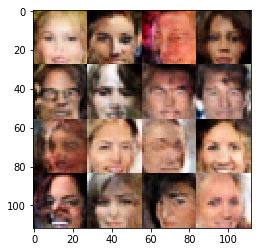

Epoch 2/2... Discriminator Loss: 0.7330... Generator Loss: 2.2648
Epoch 2/2... Discriminator Loss: 0.9098... Generator Loss: 1.1868
Epoch 2/2... Discriminator Loss: 0.5345... Generator Loss: 2.1611
Epoch 2/2... Discriminator Loss: 0.6465... Generator Loss: 1.6469
Epoch 2/2... Discriminator Loss: 0.6035... Generator Loss: 2.5893
Epoch 2/2... Discriminator Loss: 0.4973... Generator Loss: 2.1647
Epoch 2/2... Discriminator Loss: 0.7402... Generator Loss: 1.1734
Epoch 2/2... Discriminator Loss: 0.8436... Generator Loss: 1.2536
Epoch 2/2... Discriminator Loss: 0.8560... Generator Loss: 1.1896
Epoch 2/2... Discriminator Loss: 0.7452... Generator Loss: 1.6754


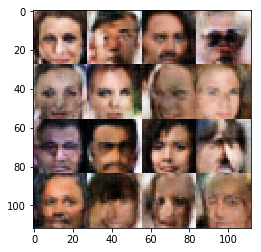

Epoch 2/2... Discriminator Loss: 1.2209... Generator Loss: 0.5467
Epoch 2/2... Discriminator Loss: 0.7008... Generator Loss: 1.3749
Epoch 2/2... Discriminator Loss: 0.6516... Generator Loss: 2.2942
Epoch 2/2... Discriminator Loss: 0.5834... Generator Loss: 2.1459
Epoch 2/2... Discriminator Loss: 0.7662... Generator Loss: 1.7924
Epoch 2/2... Discriminator Loss: 0.8996... Generator Loss: 0.9431
Epoch 2/2... Discriminator Loss: 0.5231... Generator Loss: 2.2620
Epoch 2/2... Discriminator Loss: 0.4785... Generator Loss: 2.3903
Epoch 2/2... Discriminator Loss: 0.7530... Generator Loss: 1.2595
Epoch 2/2... Discriminator Loss: 0.5634... Generator Loss: 2.3062


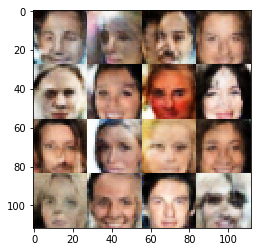

Epoch 2/2... Discriminator Loss: 0.4825... Generator Loss: 2.9879
Epoch 2/2... Discriminator Loss: 0.7417... Generator Loss: 1.4335
Epoch 2/2... Discriminator Loss: 0.4213... Generator Loss: 2.9495
Epoch 2/2... Discriminator Loss: 0.5010... Generator Loss: 2.1045
Epoch 2/2... Discriminator Loss: 1.2278... Generator Loss: 0.8025
Epoch 2/2... Discriminator Loss: 0.8834... Generator Loss: 1.0369
Epoch 2/2... Discriminator Loss: 0.4012... Generator Loss: 5.1690
Epoch 2/2... Discriminator Loss: 0.5607... Generator Loss: 2.8491
Epoch 2/2... Discriminator Loss: 0.8302... Generator Loss: 1.2343
Epoch 2/2... Discriminator Loss: 2.2215... Generator Loss: 3.3366


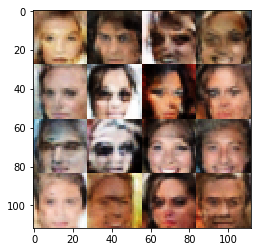

Epoch 2/2... Discriminator Loss: 0.7741... Generator Loss: 2.3793
Epoch 2/2... Discriminator Loss: 1.1673... Generator Loss: 2.5550
Epoch 2/2... Discriminator Loss: 1.2702... Generator Loss: 0.8639
Epoch 2/2... Discriminator Loss: 0.7150... Generator Loss: 2.9296
Epoch 2/2... Discriminator Loss: 1.3134... Generator Loss: 0.6871
Epoch 2/2... Discriminator Loss: 0.5331... Generator Loss: 2.5945
Epoch 2/2... Discriminator Loss: 0.6075... Generator Loss: 1.9439
Epoch 2/2... Discriminator Loss: 0.6837... Generator Loss: 1.7395
Epoch 2/2... Discriminator Loss: 0.4674... Generator Loss: 2.5406
Epoch 2/2... Discriminator Loss: 0.6444... Generator Loss: 1.5122


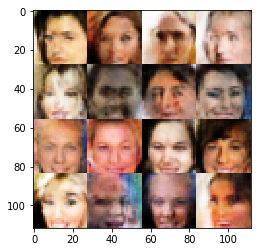

Epoch 2/2... Discriminator Loss: 1.7746... Generator Loss: 3.4127
Epoch 2/2... Discriminator Loss: 1.2197... Generator Loss: 0.7029
Epoch 2/2... Discriminator Loss: 0.8547... Generator Loss: 1.4259
Epoch 2/2... Discriminator Loss: 0.7870... Generator Loss: 2.1741
Epoch 2/2... Discriminator Loss: 0.5569... Generator Loss: 2.6369
Epoch 2/2... Discriminator Loss: 0.6748... Generator Loss: 1.3832
Epoch 2/2... Discriminator Loss: 1.6874... Generator Loss: 3.0345
Epoch 2/2... Discriminator Loss: 1.0652... Generator Loss: 0.8064
Epoch 2/2... Discriminator Loss: 1.5350... Generator Loss: 0.5036
Epoch 2/2... Discriminator Loss: 1.0621... Generator Loss: 2.9628


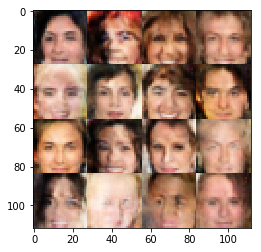

Epoch 2/2... Discriminator Loss: 0.9339... Generator Loss: 0.9151
Epoch 2/2... Discriminator Loss: 0.6416... Generator Loss: 1.7734
Epoch 2/2... Discriminator Loss: 1.5233... Generator Loss: 0.6359
Epoch 2/2... Discriminator Loss: 0.3833... Generator Loss: 4.4097
Epoch 2/2... Discriminator Loss: 0.9265... Generator Loss: 1.5163
Epoch 2/2... Discriminator Loss: 0.7222... Generator Loss: 2.0196
Epoch 2/2... Discriminator Loss: 0.7343... Generator Loss: 1.6561
Epoch 2/2... Discriminator Loss: 0.6124... Generator Loss: 1.8031
Epoch 2/2... Discriminator Loss: 0.6299... Generator Loss: 1.8440
Epoch 2/2... Discriminator Loss: 0.9780... Generator Loss: 2.0440


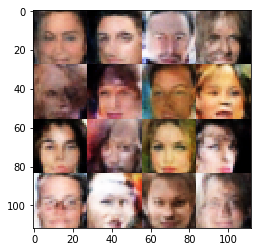

Epoch 2/2... Discriminator Loss: 0.6795... Generator Loss: 1.6590
Epoch 2/2... Discriminator Loss: 0.5803... Generator Loss: 1.6264
Epoch 2/2... Discriminator Loss: 1.6157... Generator Loss: 0.3311
Epoch 2/2... Discriminator Loss: 0.7410... Generator Loss: 1.5590
Epoch 2/2... Discriminator Loss: 0.8554... Generator Loss: 1.5718
Epoch 2/2... Discriminator Loss: 0.5424... Generator Loss: 2.9977
Epoch 2/2... Discriminator Loss: 0.9617... Generator Loss: 1.3946
Epoch 2/2... Discriminator Loss: 0.8987... Generator Loss: 1.1741
Epoch 2/2... Discriminator Loss: 0.8588... Generator Loss: 0.9816
Epoch 2/2... Discriminator Loss: 0.5982... Generator Loss: 2.0287


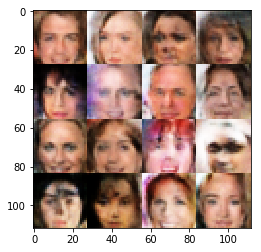

Epoch 2/2... Discriminator Loss: 0.6902... Generator Loss: 2.0220
Epoch 2/2... Discriminator Loss: 0.5721... Generator Loss: 1.9687
Epoch 2/2... Discriminator Loss: 0.6616... Generator Loss: 1.5748
Epoch 2/2... Discriminator Loss: 1.1401... Generator Loss: 0.6192
Epoch 2/2... Discriminator Loss: 0.6004... Generator Loss: 1.4833
Epoch 2/2... Discriminator Loss: 0.6108... Generator Loss: 1.7288
Epoch 2/2... Discriminator Loss: 0.9854... Generator Loss: 1.0120
Epoch 2/2... Discriminator Loss: 1.5461... Generator Loss: 0.4535
Epoch 2/2... Discriminator Loss: 0.6016... Generator Loss: 1.7040
Epoch 2/2... Discriminator Loss: 0.7330... Generator Loss: 1.9648


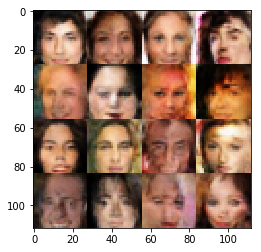

Epoch 2/2... Discriminator Loss: 0.6474... Generator Loss: 1.5533
Epoch 2/2... Discriminator Loss: 0.6143... Generator Loss: 1.5701
Epoch 2/2... Discriminator Loss: 0.5580... Generator Loss: 1.8732
Epoch 2/2... Discriminator Loss: 1.3253... Generator Loss: 0.5552
Epoch 2/2... Discriminator Loss: 0.6394... Generator Loss: 2.0482
Epoch 2/2... Discriminator Loss: 0.8337... Generator Loss: 1.2443
Epoch 2/2... Discriminator Loss: 1.8256... Generator Loss: 0.3435
Epoch 2/2... Discriminator Loss: 0.6535... Generator Loss: 1.6777
Epoch 2/2... Discriminator Loss: 0.9430... Generator Loss: 1.6977
Epoch 2/2... Discriminator Loss: 1.0164... Generator Loss: 0.8128


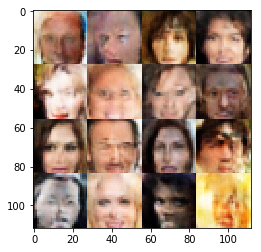

Epoch 2/2... Discriminator Loss: 0.7269... Generator Loss: 1.4348
Epoch 2/2... Discriminator Loss: 0.5977... Generator Loss: 2.6144
Epoch 2/2... Discriminator Loss: 0.9175... Generator Loss: 1.7069
Epoch 2/2... Discriminator Loss: 0.7251... Generator Loss: 1.4568
Epoch 2/2... Discriminator Loss: 0.8373... Generator Loss: 1.0287
Epoch 2/2... Discriminator Loss: 1.6376... Generator Loss: 0.3253
Epoch 2/2... Discriminator Loss: 0.6893... Generator Loss: 2.1389
Epoch 2/2... Discriminator Loss: 0.7627... Generator Loss: 1.4126
Epoch 2/2... Discriminator Loss: 0.5148... Generator Loss: 2.5234
Epoch 2/2... Discriminator Loss: 0.5590... Generator Loss: 3.1935


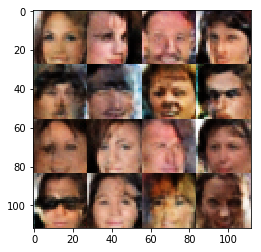

Epoch 2/2... Discriminator Loss: 0.8692... Generator Loss: 1.4611
Epoch 2/2... Discriminator Loss: 0.4325... Generator Loss: 3.1694
Epoch 2/2... Discriminator Loss: 0.8312... Generator Loss: 1.0245
Epoch 2/2... Discriminator Loss: 0.6306... Generator Loss: 2.1008
Epoch 2/2... Discriminator Loss: 1.2544... Generator Loss: 0.7044
Epoch 2/2... Discriminator Loss: 0.7070... Generator Loss: 2.3358
Epoch 2/2... Discriminator Loss: 0.4777... Generator Loss: 2.7064
Epoch 2/2... Discriminator Loss: 0.7038... Generator Loss: 2.2128
Epoch 2/2... Discriminator Loss: 0.7217... Generator Loss: 1.5611
Epoch 2/2... Discriminator Loss: 1.8586... Generator Loss: 0.4339


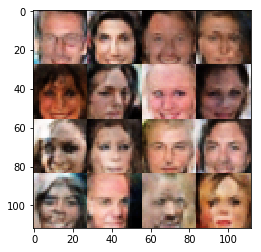

Epoch 2/2... Discriminator Loss: 0.8687... Generator Loss: 2.9833
Epoch 2/2... Discriminator Loss: 1.3505... Generator Loss: 0.7755
Epoch 2/2... Discriminator Loss: 0.5375... Generator Loss: 2.5993
Epoch 2/2... Discriminator Loss: 1.1247... Generator Loss: 0.8620
Epoch 2/2... Discriminator Loss: 0.6964... Generator Loss: 2.2982
Epoch 2/2... Discriminator Loss: 0.7878... Generator Loss: 2.5994
Epoch 2/2... Discriminator Loss: 0.5839... Generator Loss: 1.7425
Epoch 2/2... Discriminator Loss: 0.7889... Generator Loss: 1.3918
Epoch 2/2... Discriminator Loss: 0.6797... Generator Loss: 2.4053
Epoch 2/2... Discriminator Loss: 0.6121... Generator Loss: 1.9822


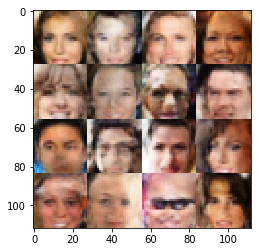

Epoch 2/2... Discriminator Loss: 1.1105... Generator Loss: 2.8136
Epoch 2/2... Discriminator Loss: 0.9061... Generator Loss: 1.3410
Epoch 2/2... Discriminator Loss: 1.4420... Generator Loss: 0.6383
Epoch 2/2... Discriminator Loss: 0.5973... Generator Loss: 1.8368
Epoch 2/2... Discriminator Loss: 0.9088... Generator Loss: 0.7252
Epoch 2/2... Discriminator Loss: 0.9671... Generator Loss: 1.7533
Epoch 2/2... Discriminator Loss: 0.6028... Generator Loss: 2.5609
Epoch 2/2... Discriminator Loss: 0.6525... Generator Loss: 2.0427
Epoch 2/2... Discriminator Loss: 1.1126... Generator Loss: 0.9512
Epoch 2/2... Discriminator Loss: 0.8262... Generator Loss: 1.2355


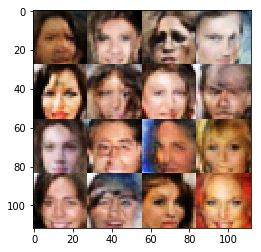

KeyboardInterrupt: 

In [14]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Epoch 1/2... Discriminator Loss: 2.0166... Generator Loss: 0.4364
Epoch 1/2... Discriminator Loss: 0.6982... Generator Loss: 2.5163
Epoch 1/2... Discriminator Loss: 1.0258... Generator Loss: 3.3628
Epoch 1/2... Discriminator Loss: 1.4318... Generator Loss: 0.6644
Epoch 1/2... Discriminator Loss: 1.0078... Generator Loss: 1.0512
Epoch 1/2... Discriminator Loss: 2.1052... Generator Loss: 0.2975
Epoch 1/2... Discriminator Loss: 2.4858... Generator Loss: 0.2171
Epoch 1/2... Discriminator Loss: 0.9404... Generator Loss: 0.9805
Epoch 1/2... Discriminator Loss: 2.0375... Generator Loss: 0.2768
Epoch 1/2... Discriminator Loss: 2.5688... Generator Loss: 0.1460


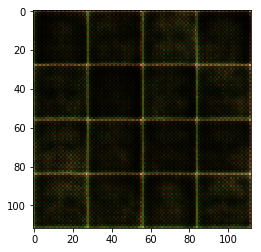

Epoch 1/2... Discriminator Loss: 1.3907... Generator Loss: 0.6475
Epoch 1/2... Discriminator Loss: 1.9533... Generator Loss: 0.3060
Epoch 1/2... Discriminator Loss: 3.3058... Generator Loss: 0.0757
Epoch 1/2... Discriminator Loss: 1.3437... Generator Loss: 0.6116
Epoch 1/2... Discriminator Loss: 1.2575... Generator Loss: 0.6956
Epoch 1/2... Discriminator Loss: 1.2362... Generator Loss: 0.6424
Epoch 1/2... Discriminator Loss: 1.4457... Generator Loss: 0.5040
Epoch 1/2... Discriminator Loss: 2.0462... Generator Loss: 0.2125
Epoch 1/2... Discriminator Loss: 0.7130... Generator Loss: 1.3616
Epoch 1/2... Discriminator Loss: 1.0360... Generator Loss: 1.8435


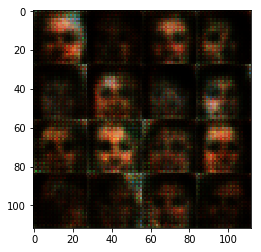

Epoch 1/2... Discriminator Loss: 1.1506... Generator Loss: 2.3218
Epoch 1/2... Discriminator Loss: 0.7845... Generator Loss: 2.5990
Epoch 1/2... Discriminator Loss: 0.8335... Generator Loss: 1.2121
Epoch 1/2... Discriminator Loss: 0.7308... Generator Loss: 2.5758
Epoch 1/2... Discriminator Loss: 1.0561... Generator Loss: 0.8768
Epoch 1/2... Discriminator Loss: 1.7047... Generator Loss: 0.3823
Epoch 1/2... Discriminator Loss: 1.1404... Generator Loss: 0.7683
Epoch 1/2... Discriminator Loss: 0.8467... Generator Loss: 1.2830
Epoch 1/2... Discriminator Loss: 0.7466... Generator Loss: 1.8383
Epoch 1/2... Discriminator Loss: 1.9800... Generator Loss: 2.5337


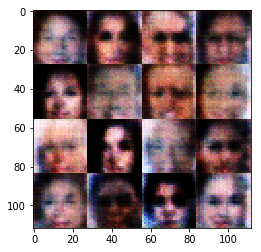

Epoch 1/2... Discriminator Loss: 1.5230... Generator Loss: 0.4040
Epoch 1/2... Discriminator Loss: 1.3611... Generator Loss: 0.5703
Epoch 1/2... Discriminator Loss: 0.9876... Generator Loss: 1.0249
Epoch 1/2... Discriminator Loss: 0.6078... Generator Loss: 1.9969
Epoch 1/2... Discriminator Loss: 0.8937... Generator Loss: 1.0951
Epoch 1/2... Discriminator Loss: 0.9791... Generator Loss: 0.8712
Epoch 1/2... Discriminator Loss: 1.2562... Generator Loss: 4.2067
Epoch 1/2... Discriminator Loss: 0.6960... Generator Loss: 1.8532
Epoch 1/2... Discriminator Loss: 1.6181... Generator Loss: 0.4195
Epoch 1/2... Discriminator Loss: 1.5603... Generator Loss: 2.4279


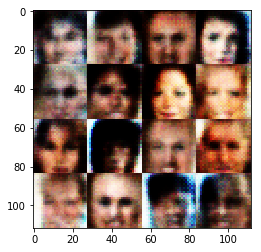

Epoch 1/2... Discriminator Loss: 1.5338... Generator Loss: 0.5969
Epoch 1/2... Discriminator Loss: 1.3944... Generator Loss: 0.5575
Epoch 1/2... Discriminator Loss: 0.8768... Generator Loss: 1.1876
Epoch 1/2... Discriminator Loss: 1.0844... Generator Loss: 2.5677
Epoch 1/2... Discriminator Loss: 0.9456... Generator Loss: 0.9317
Epoch 1/2... Discriminator Loss: 1.4883... Generator Loss: 0.5020
Epoch 1/2... Discriminator Loss: 1.4937... Generator Loss: 0.8233
Epoch 1/2... Discriminator Loss: 0.6907... Generator Loss: 2.8583
Epoch 1/2... Discriminator Loss: 1.1233... Generator Loss: 0.8716
Epoch 1/2... Discriminator Loss: 0.6715... Generator Loss: 3.7560


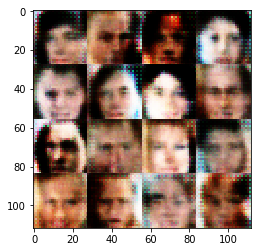

Epoch 1/2... Discriminator Loss: 0.9191... Generator Loss: 2.5438
Epoch 1/2... Discriminator Loss: 0.5599... Generator Loss: 1.9895
Epoch 1/2... Discriminator Loss: 0.8987... Generator Loss: 2.8158
Epoch 1/2... Discriminator Loss: 1.2453... Generator Loss: 3.0998
Epoch 1/2... Discriminator Loss: 1.7771... Generator Loss: 0.4040
Epoch 1/2... Discriminator Loss: 0.9524... Generator Loss: 1.4999
Epoch 1/2... Discriminator Loss: 0.9101... Generator Loss: 1.2865
Epoch 1/2... Discriminator Loss: 0.6155... Generator Loss: 1.8692
Epoch 1/2... Discriminator Loss: 1.5040... Generator Loss: 0.4508
Epoch 1/2... Discriminator Loss: 2.2970... Generator Loss: 2.1093


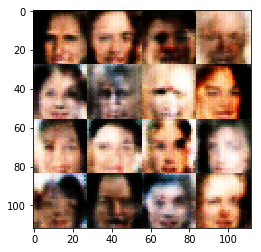

Epoch 1/2... Discriminator Loss: 0.8533... Generator Loss: 1.2951
Epoch 1/2... Discriminator Loss: 1.1270... Generator Loss: 0.7502
Epoch 1/2... Discriminator Loss: 0.6267... Generator Loss: 1.9266
Epoch 1/2... Discriminator Loss: 2.0158... Generator Loss: 2.6111
Epoch 1/2... Discriminator Loss: 1.2085... Generator Loss: 0.7033
Epoch 1/2... Discriminator Loss: 1.0323... Generator Loss: 0.8442
Epoch 1/2... Discriminator Loss: 0.6658... Generator Loss: 2.0810
Epoch 1/2... Discriminator Loss: 0.7957... Generator Loss: 1.3439
Epoch 1/2... Discriminator Loss: 1.3231... Generator Loss: 1.0977
Epoch 1/2... Discriminator Loss: 1.4054... Generator Loss: 1.8909


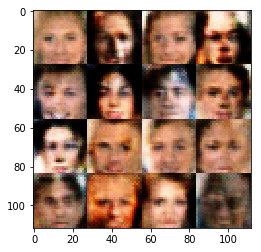

Epoch 1/2... Discriminator Loss: 1.2333... Generator Loss: 0.6270
Epoch 1/2... Discriminator Loss: 1.2128... Generator Loss: 1.2418
Epoch 1/2... Discriminator Loss: 1.1702... Generator Loss: 0.8703
Epoch 1/2... Discriminator Loss: 1.3768... Generator Loss: 0.5722
Epoch 1/2... Discriminator Loss: 2.2077... Generator Loss: 3.0143
Epoch 1/2... Discriminator Loss: 0.9767... Generator Loss: 2.0079
Epoch 1/2... Discriminator Loss: 1.4748... Generator Loss: 2.0647
Epoch 1/2... Discriminator Loss: 1.4977... Generator Loss: 2.0809
Epoch 1/2... Discriminator Loss: 0.4953... Generator Loss: 2.6955
Epoch 1/2... Discriminator Loss: 1.2281... Generator Loss: 1.2242


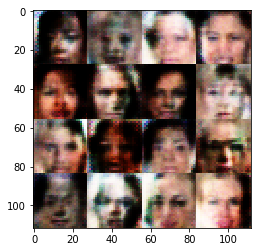

Epoch 1/2... Discriminator Loss: 2.2422... Generator Loss: 1.9472
Epoch 1/2... Discriminator Loss: 1.1504... Generator Loss: 1.2224
Epoch 1/2... Discriminator Loss: 0.5901... Generator Loss: 1.7237
Epoch 1/2... Discriminator Loss: 1.4138... Generator Loss: 1.3085
Epoch 1/2... Discriminator Loss: 0.7949... Generator Loss: 1.7070
Epoch 1/2... Discriminator Loss: 0.9467... Generator Loss: 2.4434
Epoch 1/2... Discriminator Loss: 1.3614... Generator Loss: 1.1842
Epoch 1/2... Discriminator Loss: 1.3289... Generator Loss: 0.5495
Epoch 1/2... Discriminator Loss: 1.0355... Generator Loss: 0.9564
Epoch 1/2... Discriminator Loss: 1.6397... Generator Loss: 0.3470


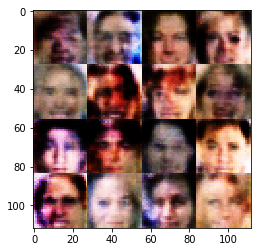

Epoch 1/2... Discriminator Loss: 0.7930... Generator Loss: 2.3506
Epoch 1/2... Discriminator Loss: 1.1628... Generator Loss: 0.7457
Epoch 1/2... Discriminator Loss: 1.5136... Generator Loss: 0.4051
Epoch 1/2... Discriminator Loss: 1.8665... Generator Loss: 2.2833
Epoch 1/2... Discriminator Loss: 1.1116... Generator Loss: 0.6957
Epoch 1/2... Discriminator Loss: 0.5456... Generator Loss: 2.6918
Epoch 1/2... Discriminator Loss: 1.3973... Generator Loss: 0.6848
Epoch 1/2... Discriminator Loss: 0.5441... Generator Loss: 2.1849
Epoch 1/2... Discriminator Loss: 1.1073... Generator Loss: 2.8256
Epoch 1/2... Discriminator Loss: 1.2364... Generator Loss: 3.2382


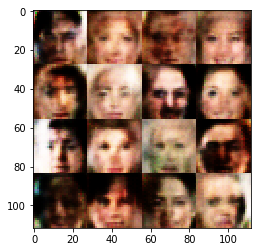

Epoch 1/2... Discriminator Loss: 1.1304... Generator Loss: 0.8700
Epoch 1/2... Discriminator Loss: 1.0330... Generator Loss: 1.1921
Epoch 1/2... Discriminator Loss: 0.8653... Generator Loss: 1.0611
Epoch 1/2... Discriminator Loss: 1.3785... Generator Loss: 0.5498
Epoch 1/2... Discriminator Loss: 1.7030... Generator Loss: 2.2907
Epoch 1/2... Discriminator Loss: 0.6332... Generator Loss: 2.3860
Epoch 1/2... Discriminator Loss: 0.8550... Generator Loss: 2.4931
Epoch 1/2... Discriminator Loss: 0.9069... Generator Loss: 1.0114
Epoch 1/2... Discriminator Loss: 1.3185... Generator Loss: 2.3482
Epoch 1/2... Discriminator Loss: 1.5708... Generator Loss: 0.4434


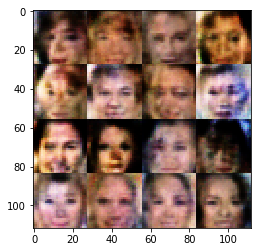

Epoch 1/2... Discriminator Loss: 0.6789... Generator Loss: 1.6864
Epoch 1/2... Discriminator Loss: 0.5446... Generator Loss: 2.0109
Epoch 1/2... Discriminator Loss: 1.2039... Generator Loss: 1.6615
Epoch 1/2... Discriminator Loss: 1.4804... Generator Loss: 1.2242
Epoch 1/2... Discriminator Loss: 1.5144... Generator Loss: 0.4987
Epoch 1/2... Discriminator Loss: 1.2828... Generator Loss: 1.0802
Epoch 1/2... Discriminator Loss: 0.9091... Generator Loss: 1.7380
Epoch 1/2... Discriminator Loss: 1.3097... Generator Loss: 1.6507
Epoch 1/2... Discriminator Loss: 0.5590... Generator Loss: 4.3077
Epoch 1/2... Discriminator Loss: 2.2948... Generator Loss: 2.7940


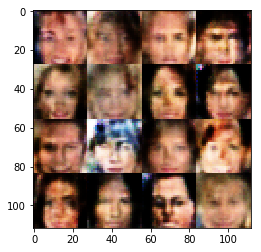

Epoch 1/2... Discriminator Loss: 0.8957... Generator Loss: 2.5799
Epoch 1/2... Discriminator Loss: 0.8474... Generator Loss: 1.0963
Epoch 1/2... Discriminator Loss: 1.2256... Generator Loss: 0.6800
Epoch 1/2... Discriminator Loss: 1.0820... Generator Loss: 0.6853
Epoch 1/2... Discriminator Loss: 0.9984... Generator Loss: 3.0790
Epoch 1/2... Discriminator Loss: 1.1494... Generator Loss: 0.9917
Epoch 1/2... Discriminator Loss: 0.6412... Generator Loss: 1.6511
Epoch 1/2... Discriminator Loss: 0.7538... Generator Loss: 1.4387
Epoch 1/2... Discriminator Loss: 2.3748... Generator Loss: 0.1685
Epoch 1/2... Discriminator Loss: 0.9689... Generator Loss: 2.5614


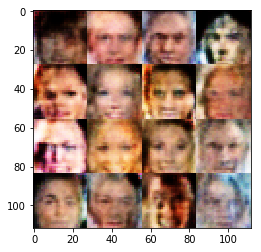

Epoch 1/2... Discriminator Loss: 1.2910... Generator Loss: 0.5423
Epoch 1/2... Discriminator Loss: 1.8227... Generator Loss: 0.3258
Epoch 1/2... Discriminator Loss: 1.2282... Generator Loss: 1.2042
Epoch 1/2... Discriminator Loss: 1.2650... Generator Loss: 1.4899
Epoch 1/2... Discriminator Loss: 0.8006... Generator Loss: 1.9331
Epoch 1/2... Discriminator Loss: 1.4260... Generator Loss: 0.4995
Epoch 1/2... Discriminator Loss: 1.2407... Generator Loss: 0.9638
Epoch 1/2... Discriminator Loss: 1.3817... Generator Loss: 2.1724
Epoch 1/2... Discriminator Loss: 0.6894... Generator Loss: 1.3961
Epoch 1/2... Discriminator Loss: 0.9808... Generator Loss: 1.8168


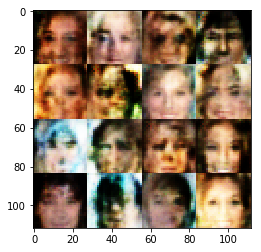

Epoch 1/2... Discriminator Loss: 0.6375... Generator Loss: 1.8791
Epoch 1/2... Discriminator Loss: 1.0683... Generator Loss: 1.2417
Epoch 1/2... Discriminator Loss: 0.8346... Generator Loss: 1.7501
Epoch 1/2... Discriminator Loss: 0.7407... Generator Loss: 1.5275
Epoch 1/2... Discriminator Loss: 0.9942... Generator Loss: 1.7147
Epoch 1/2... Discriminator Loss: 0.9551... Generator Loss: 0.9987
Epoch 1/2... Discriminator Loss: 1.0250... Generator Loss: 1.1975
Epoch 1/2... Discriminator Loss: 1.0232... Generator Loss: 1.9987
Epoch 1/2... Discriminator Loss: 1.9606... Generator Loss: 2.3334
Epoch 1/2... Discriminator Loss: 0.8657... Generator Loss: 3.3906


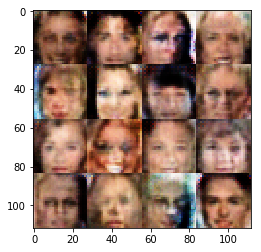

Epoch 1/2... Discriminator Loss: 1.1166... Generator Loss: 1.0789
Epoch 1/2... Discriminator Loss: 1.1767... Generator Loss: 0.7797
Epoch 1/2... Discriminator Loss: 1.2621... Generator Loss: 0.5944
Epoch 1/2... Discriminator Loss: 1.2212... Generator Loss: 0.6085
Epoch 1/2... Discriminator Loss: 1.0648... Generator Loss: 1.2449
Epoch 1/2... Discriminator Loss: 1.0747... Generator Loss: 0.6837
Epoch 1/2... Discriminator Loss: 1.2560... Generator Loss: 1.8304
Epoch 1/2... Discriminator Loss: 0.5164... Generator Loss: 2.4737
Epoch 1/2... Discriminator Loss: 0.5830... Generator Loss: 3.4942
Epoch 1/2... Discriminator Loss: 1.4704... Generator Loss: 1.0820


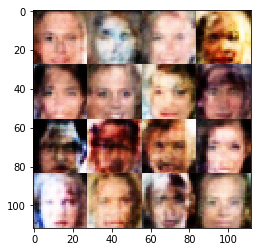

Epoch 1/2... Discriminator Loss: 1.4766... Generator Loss: 0.6279
Epoch 1/2... Discriminator Loss: 1.2767... Generator Loss: 0.5925
Epoch 1/2... Discriminator Loss: 1.2926... Generator Loss: 1.6537
Epoch 1/2... Discriminator Loss: 1.1670... Generator Loss: 1.8967
Epoch 1/2... Discriminator Loss: 0.8220... Generator Loss: 2.0633
Epoch 1/2... Discriminator Loss: 0.8505... Generator Loss: 1.1203
Epoch 1/2... Discriminator Loss: 1.2484... Generator Loss: 0.6362
Epoch 1/2... Discriminator Loss: 0.6149... Generator Loss: 1.6651
Epoch 1/2... Discriminator Loss: 1.2309... Generator Loss: 0.9142
Epoch 1/2... Discriminator Loss: 1.0002... Generator Loss: 1.1623


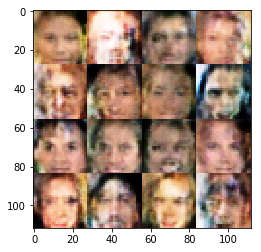

Epoch 1/2... Discriminator Loss: 1.1586... Generator Loss: 0.7111
Epoch 1/2... Discriminator Loss: 1.1649... Generator Loss: 1.9216
Epoch 1/2... Discriminator Loss: 0.6362... Generator Loss: 1.7467
Epoch 1/2... Discriminator Loss: 0.8993... Generator Loss: 1.5631
Epoch 1/2... Discriminator Loss: 0.9810... Generator Loss: 1.0485
Epoch 1/2... Discriminator Loss: 1.3970... Generator Loss: 2.1719
Epoch 1/2... Discriminator Loss: 1.2771... Generator Loss: 1.5404
Epoch 1/2... Discriminator Loss: 0.9584... Generator Loss: 0.8706
Epoch 1/2... Discriminator Loss: 0.5783... Generator Loss: 1.8843
Epoch 1/2... Discriminator Loss: 0.9754... Generator Loss: 1.0378


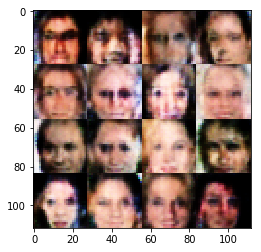

Epoch 1/2... Discriminator Loss: 0.7736... Generator Loss: 3.2728
Epoch 1/2... Discriminator Loss: 1.3296... Generator Loss: 0.6197
Epoch 1/2... Discriminator Loss: 1.0389... Generator Loss: 0.8426
Epoch 1/2... Discriminator Loss: 0.7211... Generator Loss: 2.5134
Epoch 1/2... Discriminator Loss: 0.5651... Generator Loss: 2.0107
Epoch 1/2... Discriminator Loss: 0.6897... Generator Loss: 1.4146
Epoch 1/2... Discriminator Loss: 0.8015... Generator Loss: 1.3760
Epoch 1/2... Discriminator Loss: 1.5220... Generator Loss: 1.6187
Epoch 1/2... Discriminator Loss: 0.9744... Generator Loss: 1.4743
Epoch 1/2... Discriminator Loss: 1.1729... Generator Loss: 1.3301


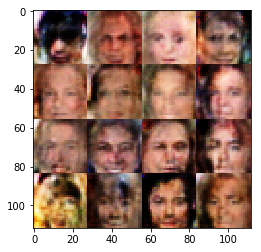

Epoch 1/2... Discriminator Loss: 1.1403... Generator Loss: 0.8568
Epoch 1/2... Discriminator Loss: 0.5998... Generator Loss: 1.6846
Epoch 1/2... Discriminator Loss: 1.0768... Generator Loss: 0.9145
Epoch 1/2... Discriminator Loss: 1.1223... Generator Loss: 0.8598
Epoch 1/2... Discriminator Loss: 1.4313... Generator Loss: 0.7257
Epoch 1/2... Discriminator Loss: 0.9232... Generator Loss: 0.9926
Epoch 1/2... Discriminator Loss: 1.1705... Generator Loss: 0.6201
Epoch 1/2... Discriminator Loss: 0.6682... Generator Loss: 1.6121
Epoch 1/2... Discriminator Loss: 0.5456... Generator Loss: 1.9147
Epoch 1/2... Discriminator Loss: 1.6067... Generator Loss: 0.3757


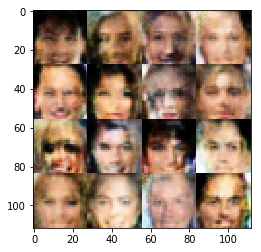

Epoch 1/2... Discriminator Loss: 0.6702... Generator Loss: 1.9518
Epoch 1/2... Discriminator Loss: 0.8361... Generator Loss: 1.7592
Epoch 1/2... Discriminator Loss: 0.5177... Generator Loss: 2.2895
Epoch 1/2... Discriminator Loss: 1.4579... Generator Loss: 0.4296
Epoch 1/2... Discriminator Loss: 1.5572... Generator Loss: 0.6501
Epoch 1/2... Discriminator Loss: 1.0974... Generator Loss: 0.7896
Epoch 1/2... Discriminator Loss: 1.0335... Generator Loss: 1.0793
Epoch 1/2... Discriminator Loss: 2.8177... Generator Loss: 2.6732
Epoch 1/2... Discriminator Loss: 1.4442... Generator Loss: 0.5865
Epoch 1/2... Discriminator Loss: 0.8960... Generator Loss: 1.2506


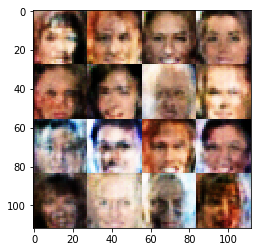

Epoch 1/2... Discriminator Loss: 0.6539... Generator Loss: 2.5382
Epoch 1/2... Discriminator Loss: 1.9884... Generator Loss: 2.6036
Epoch 1/2... Discriminator Loss: 1.1635... Generator Loss: 0.7838
Epoch 1/2... Discriminator Loss: 1.0513... Generator Loss: 0.7886
Epoch 1/2... Discriminator Loss: 2.1574... Generator Loss: 3.2122
Epoch 1/2... Discriminator Loss: 0.7310... Generator Loss: 1.5769
Epoch 1/2... Discriminator Loss: 2.0372... Generator Loss: 2.5969
Epoch 1/2... Discriminator Loss: 0.9876... Generator Loss: 3.9290
Epoch 1/2... Discriminator Loss: 0.8495... Generator Loss: 1.1168
Epoch 1/2... Discriminator Loss: 0.8224... Generator Loss: 4.2704


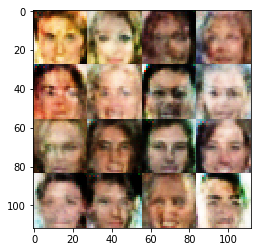

Epoch 1/2... Discriminator Loss: 0.9675... Generator Loss: 0.9482
Epoch 1/2... Discriminator Loss: 1.4404... Generator Loss: 2.3228
Epoch 1/2... Discriminator Loss: 0.8324... Generator Loss: 1.5085
Epoch 1/2... Discriminator Loss: 0.9111... Generator Loss: 1.1698
Epoch 1/2... Discriminator Loss: 0.6391... Generator Loss: 2.2020
Epoch 1/2... Discriminator Loss: 1.1664... Generator Loss: 2.0167
Epoch 1/2... Discriminator Loss: 1.1188... Generator Loss: 0.8025
Epoch 1/2... Discriminator Loss: 0.7268... Generator Loss: 1.4866
Epoch 1/2... Discriminator Loss: 1.3679... Generator Loss: 0.5645
Epoch 1/2... Discriminator Loss: 1.2394... Generator Loss: 0.5635


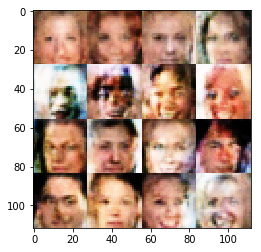

Epoch 1/2... Discriminator Loss: 0.6799... Generator Loss: 1.4449
Epoch 1/2... Discriminator Loss: 1.5007... Generator Loss: 2.1238
Epoch 1/2... Discriminator Loss: 0.5549... Generator Loss: 2.3520
Epoch 1/2... Discriminator Loss: 0.6015... Generator Loss: 1.9862
Epoch 1/2... Discriminator Loss: 0.5391... Generator Loss: 3.6891
Epoch 1/2... Discriminator Loss: 0.9577... Generator Loss: 1.3596
Epoch 1/2... Discriminator Loss: 1.2700... Generator Loss: 0.5776
Epoch 1/2... Discriminator Loss: 1.3442... Generator Loss: 1.8204
Epoch 1/2... Discriminator Loss: 1.0294... Generator Loss: 1.4710
Epoch 1/2... Discriminator Loss: 0.9463... Generator Loss: 2.1032


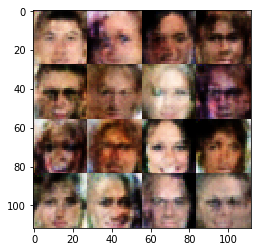

Epoch 1/2... Discriminator Loss: 0.9333... Generator Loss: 0.9697
Epoch 1/2... Discriminator Loss: 1.3797... Generator Loss: 1.3115
Epoch 1/2... Discriminator Loss: 0.5460... Generator Loss: 2.5962
Epoch 1/2... Discriminator Loss: 1.1775... Generator Loss: 0.7491
Epoch 1/2... Discriminator Loss: 1.3075... Generator Loss: 0.6983
Epoch 1/2... Discriminator Loss: 1.6459... Generator Loss: 2.2575
Epoch 1/2... Discriminator Loss: 0.7796... Generator Loss: 1.2851
Epoch 1/2... Discriminator Loss: 0.6958... Generator Loss: 1.3043
Epoch 1/2... Discriminator Loss: 0.7398... Generator Loss: 1.3586
Epoch 1/2... Discriminator Loss: 1.7812... Generator Loss: 4.4459


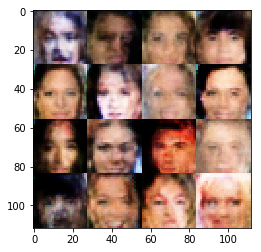

Epoch 1/2... Discriminator Loss: 0.5936... Generator Loss: 1.7027
Epoch 1/2... Discriminator Loss: 0.7078... Generator Loss: 1.1343
Epoch 1/2... Discriminator Loss: 0.6062... Generator Loss: 1.7103
Epoch 1/2... Discriminator Loss: 1.1347... Generator Loss: 1.9532
Epoch 1/2... Discriminator Loss: 1.0493... Generator Loss: 2.6291
Epoch 1/2... Discriminator Loss: 1.1353... Generator Loss: 0.7219
Epoch 1/2... Discriminator Loss: 1.1932... Generator Loss: 0.7252
Epoch 1/2... Discriminator Loss: 0.9559... Generator Loss: 0.8627
Epoch 1/2... Discriminator Loss: 0.7844... Generator Loss: 1.7588
Epoch 1/2... Discriminator Loss: 0.8335... Generator Loss: 0.9968


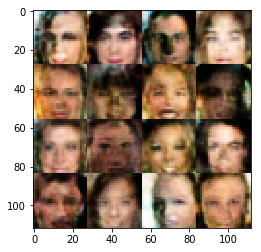

Epoch 1/2... Discriminator Loss: 0.6234... Generator Loss: 1.6261
Epoch 1/2... Discriminator Loss: 0.6892... Generator Loss: 1.8842
Epoch 1/2... Discriminator Loss: 1.4846... Generator Loss: 0.4622
Epoch 1/2... Discriminator Loss: 1.1804... Generator Loss: 0.7210
Epoch 1/2... Discriminator Loss: 0.8326... Generator Loss: 1.3430
Epoch 1/2... Discriminator Loss: 0.6634... Generator Loss: 1.4574
Epoch 1/2... Discriminator Loss: 1.0573... Generator Loss: 0.7492
Epoch 1/2... Discriminator Loss: 0.7835... Generator Loss: 1.1489
Epoch 1/2... Discriminator Loss: 1.2554... Generator Loss: 0.6151
Epoch 1/2... Discriminator Loss: 0.9473... Generator Loss: 1.4142


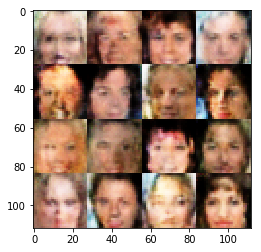

Epoch 1/2... Discriminator Loss: 0.8326... Generator Loss: 0.8683
Epoch 1/2... Discriminator Loss: 0.7143... Generator Loss: 1.5959
Epoch 1/2... Discriminator Loss: 0.4831... Generator Loss: 2.5796
Epoch 1/2... Discriminator Loss: 0.9913... Generator Loss: 0.9164
Epoch 1/2... Discriminator Loss: 1.8150... Generator Loss: 0.3131
Epoch 1/2... Discriminator Loss: 1.5464... Generator Loss: 0.4583
Epoch 1/2... Discriminator Loss: 0.5700... Generator Loss: 2.3144
Epoch 1/2... Discriminator Loss: 0.5761... Generator Loss: 1.7996
Epoch 1/2... Discriminator Loss: 1.1445... Generator Loss: 1.3302
Epoch 1/2... Discriminator Loss: 0.6179... Generator Loss: 1.5918


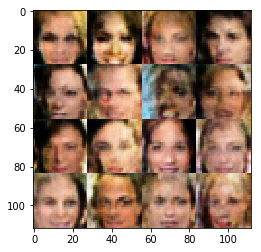

Epoch 1/2... Discriminator Loss: 1.1531... Generator Loss: 1.2899
Epoch 1/2... Discriminator Loss: 0.7282... Generator Loss: 1.5130
Epoch 1/2... Discriminator Loss: 1.7588... Generator Loss: 0.3166
Epoch 1/2... Discriminator Loss: 1.0585... Generator Loss: 0.6743
Epoch 1/2... Discriminator Loss: 0.7528... Generator Loss: 1.3081
Epoch 1/2... Discriminator Loss: 1.1034... Generator Loss: 0.6150
Epoch 1/2... Discriminator Loss: 1.4689... Generator Loss: 0.4041
Epoch 1/2... Discriminator Loss: 0.6504... Generator Loss: 2.8917
Epoch 1/2... Discriminator Loss: 1.2351... Generator Loss: 0.6480
Epoch 1/2... Discriminator Loss: 0.7576... Generator Loss: 1.9128


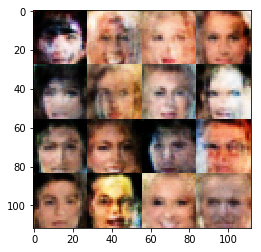

Epoch 1/2... Discriminator Loss: 0.4776... Generator Loss: 3.0713
Epoch 1/2... Discriminator Loss: 0.5147... Generator Loss: 3.6652
Epoch 1/2... Discriminator Loss: 0.6037... Generator Loss: 1.7054
Epoch 1/2... Discriminator Loss: 0.9207... Generator Loss: 1.6222
Epoch 1/2... Discriminator Loss: 1.2377... Generator Loss: 1.9456
Epoch 1/2... Discriminator Loss: 0.7775... Generator Loss: 2.1855
Epoch 1/2... Discriminator Loss: 0.7168... Generator Loss: 1.2689
Epoch 1/2... Discriminator Loss: 0.8523... Generator Loss: 0.9522
Epoch 1/2... Discriminator Loss: 0.9611... Generator Loss: 0.8465
Epoch 1/2... Discriminator Loss: 0.9811... Generator Loss: 0.7746


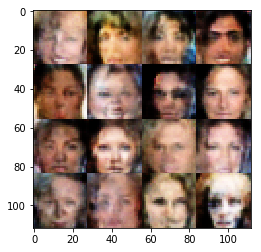

Epoch 1/2... Discriminator Loss: 1.8206... Generator Loss: 2.3881
Epoch 1/2... Discriminator Loss: 1.0885... Generator Loss: 1.6961
Epoch 1/2... Discriminator Loss: 0.4549... Generator Loss: 2.7968
Epoch 1/2... Discriminator Loss: 1.1328... Generator Loss: 2.6490
Epoch 1/2... Discriminator Loss: 1.1453... Generator Loss: 0.7262
Epoch 1/2... Discriminator Loss: 0.5773... Generator Loss: 1.9214
Epoch 1/2... Discriminator Loss: 0.5760... Generator Loss: 2.6538
Epoch 1/2... Discriminator Loss: 0.7522... Generator Loss: 1.8883
Epoch 1/2... Discriminator Loss: 0.8661... Generator Loss: 1.1288
Epoch 1/2... Discriminator Loss: 1.0192... Generator Loss: 1.5608


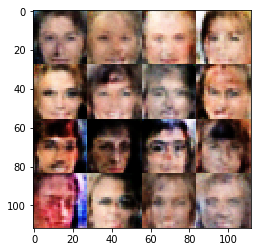

Epoch 1/2... Discriminator Loss: 0.9001... Generator Loss: 0.9624
Epoch 1/2... Discriminator Loss: 0.6168... Generator Loss: 1.8313
Epoch 1/2... Discriminator Loss: 0.7166... Generator Loss: 1.6258
Epoch 1/2... Discriminator Loss: 0.4206... Generator Loss: 3.0180
Epoch 1/2... Discriminator Loss: 0.6768... Generator Loss: 1.9194
Epoch 1/2... Discriminator Loss: 1.7861... Generator Loss: 2.6085
Epoch 1/2... Discriminator Loss: 0.9895... Generator Loss: 1.4372
Epoch 1/2... Discriminator Loss: 0.4379... Generator Loss: 2.7149
Epoch 1/2... Discriminator Loss: 0.7163... Generator Loss: 1.3188
Epoch 1/2... Discriminator Loss: 1.2411... Generator Loss: 0.7939


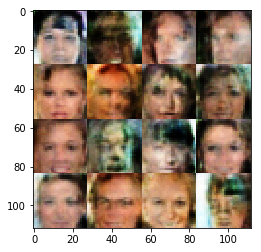

Epoch 1/2... Discriminator Loss: 0.9834... Generator Loss: 0.8459
Epoch 1/2... Discriminator Loss: 0.9354... Generator Loss: 1.6113
Epoch 1/2... Discriminator Loss: 0.5102... Generator Loss: 2.3613
Epoch 1/2... Discriminator Loss: 1.6688... Generator Loss: 2.6417
Epoch 1/2... Discriminator Loss: 0.5704... Generator Loss: 1.9012
Epoch 1/2... Discriminator Loss: 1.2502... Generator Loss: 0.6852
Epoch 1/2... Discriminator Loss: 0.5913... Generator Loss: 2.6542
Epoch 1/2... Discriminator Loss: 1.6542... Generator Loss: 1.9983
Epoch 1/2... Discriminator Loss: 0.6099... Generator Loss: 2.3503
Epoch 1/2... Discriminator Loss: 1.5469... Generator Loss: 0.4625


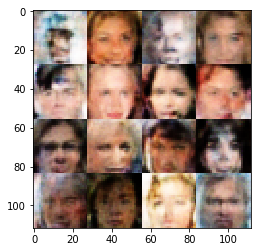

Epoch 1/2... Discriminator Loss: 0.9267... Generator Loss: 0.9294
Epoch 1/2... Discriminator Loss: 1.1655... Generator Loss: 0.9370
Epoch 1/2... Discriminator Loss: 0.9680... Generator Loss: 0.8172
Epoch 1/2... Discriminator Loss: 0.6779... Generator Loss: 1.8884
Epoch 1/2... Discriminator Loss: 0.8171... Generator Loss: 1.3283
Epoch 1/2... Discriminator Loss: 0.5968... Generator Loss: 2.0028
Epoch 1/2... Discriminator Loss: 0.7048... Generator Loss: 1.7587
Epoch 1/2... Discriminator Loss: 0.7085... Generator Loss: 1.5660
Epoch 1/2... Discriminator Loss: 0.6775... Generator Loss: 2.3176
Epoch 1/2... Discriminator Loss: 1.0815... Generator Loss: 2.9762


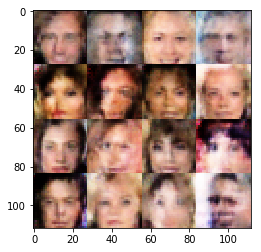

Epoch 1/2... Discriminator Loss: 2.8352... Generator Loss: 3.6623
Epoch 1/2... Discriminator Loss: 1.1151... Generator Loss: 0.7694
Epoch 1/2... Discriminator Loss: 1.1660... Generator Loss: 0.6718
Epoch 1/2... Discriminator Loss: 0.9572... Generator Loss: 0.9541
Epoch 1/2... Discriminator Loss: 0.5925... Generator Loss: 1.9373
Epoch 1/2... Discriminator Loss: 0.7487... Generator Loss: 1.1818
Epoch 1/2... Discriminator Loss: 0.8728... Generator Loss: 1.1450
Epoch 1/2... Discriminator Loss: 1.7532... Generator Loss: 2.5143
Epoch 1/2... Discriminator Loss: 0.4872... Generator Loss: 2.5905
Epoch 1/2... Discriminator Loss: 0.9952... Generator Loss: 0.8348


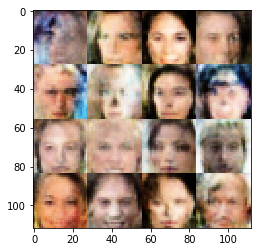

Epoch 1/2... Discriminator Loss: 1.2004... Generator Loss: 0.5760
Epoch 1/2... Discriminator Loss: 1.1338... Generator Loss: 0.6123
Epoch 1/2... Discriminator Loss: 0.5119... Generator Loss: 2.3863
Epoch 1/2... Discriminator Loss: 0.4331... Generator Loss: 2.9328
Epoch 1/2... Discriminator Loss: 0.9005... Generator Loss: 1.1222
Epoch 1/2... Discriminator Loss: 1.6567... Generator Loss: 1.7661
Epoch 1/2... Discriminator Loss: 0.4351... Generator Loss: 3.7008
Epoch 1/2... Discriminator Loss: 0.8952... Generator Loss: 0.9209
Epoch 1/2... Discriminator Loss: 0.7687... Generator Loss: 2.3215
Epoch 1/2... Discriminator Loss: 0.7944... Generator Loss: 1.1977


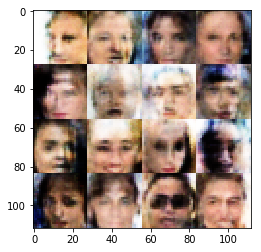

Epoch 1/2... Discriminator Loss: 0.5026... Generator Loss: 3.4039
Epoch 1/2... Discriminator Loss: 0.8202... Generator Loss: 1.1098
Epoch 1/2... Discriminator Loss: 0.8331... Generator Loss: 1.9135
Epoch 1/2... Discriminator Loss: 0.9350... Generator Loss: 2.0773
Epoch 1/2... Discriminator Loss: 0.8975... Generator Loss: 1.3698
Epoch 1/2... Discriminator Loss: 1.0403... Generator Loss: 0.8427
Epoch 1/2... Discriminator Loss: 1.6952... Generator Loss: 2.4630
Epoch 1/2... Discriminator Loss: 1.3349... Generator Loss: 1.2021
Epoch 1/2... Discriminator Loss: 1.9843... Generator Loss: 2.0569
Epoch 1/2... Discriminator Loss: 1.0624... Generator Loss: 1.6243


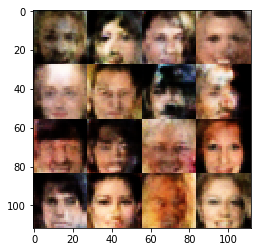

Epoch 1/2... Discriminator Loss: 1.0522... Generator Loss: 1.7000
Epoch 1/2... Discriminator Loss: 0.7360... Generator Loss: 1.1181
Epoch 1/2... Discriminator Loss: 1.4611... Generator Loss: 2.0865
Epoch 1/2... Discriminator Loss: 0.6964... Generator Loss: 1.8761
Epoch 1/2... Discriminator Loss: 0.8484... Generator Loss: 1.3718
Epoch 1/2... Discriminator Loss: 1.3325... Generator Loss: 0.4190
Epoch 1/2... Discriminator Loss: 0.8183... Generator Loss: 1.1016
Epoch 1/2... Discriminator Loss: 0.5406... Generator Loss: 2.3510
Epoch 1/2... Discriminator Loss: 0.7074... Generator Loss: 2.3969
Epoch 1/2... Discriminator Loss: 0.8190... Generator Loss: 1.3876


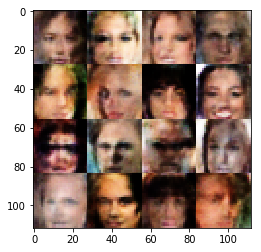

Epoch 1/2... Discriminator Loss: 0.4453... Generator Loss: 2.5808
Epoch 1/2... Discriminator Loss: 0.5704... Generator Loss: 2.1142
Epoch 1/2... Discriminator Loss: 0.6427... Generator Loss: 1.9269
Epoch 1/2... Discriminator Loss: 1.3044... Generator Loss: 0.6160
Epoch 1/2... Discriminator Loss: 0.8550... Generator Loss: 1.5483
Epoch 1/2... Discriminator Loss: 1.0175... Generator Loss: 0.7135
Epoch 1/2... Discriminator Loss: 1.1247... Generator Loss: 1.8915
Epoch 1/2... Discriminator Loss: 0.5965... Generator Loss: 3.0301
Epoch 1/2... Discriminator Loss: 0.6184... Generator Loss: 1.8340
Epoch 1/2... Discriminator Loss: 1.1439... Generator Loss: 0.7450


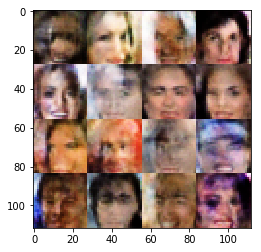

Epoch 1/2... Discriminator Loss: 2.6154... Generator Loss: 2.8001
Epoch 1/2... Discriminator Loss: 1.3252... Generator Loss: 1.2241
Epoch 1/2... Discriminator Loss: 0.9064... Generator Loss: 1.2610
Epoch 1/2... Discriminator Loss: 0.5962... Generator Loss: 2.8211
Epoch 1/2... Discriminator Loss: 0.8685... Generator Loss: 1.2930
Epoch 1/2... Discriminator Loss: 1.0687... Generator Loss: 0.8195
Epoch 1/2... Discriminator Loss: 1.1115... Generator Loss: 0.8216
Epoch 1/2... Discriminator Loss: 0.6383... Generator Loss: 3.0731
Epoch 1/2... Discriminator Loss: 0.5924... Generator Loss: 2.4325
Epoch 1/2... Discriminator Loss: 0.6515... Generator Loss: 1.9305


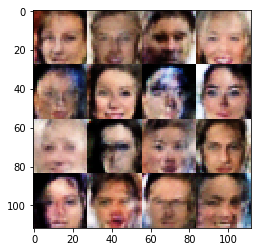

Epoch 1/2... Discriminator Loss: 0.6381... Generator Loss: 2.1665
Epoch 1/2... Discriminator Loss: 2.8056... Generator Loss: 3.6974
Epoch 1/2... Discriminator Loss: 0.5665... Generator Loss: 2.0754
Epoch 1/2... Discriminator Loss: 0.6750... Generator Loss: 1.3757
Epoch 1/2... Discriminator Loss: 0.7361... Generator Loss: 2.5787
Epoch 1/2... Discriminator Loss: 0.8694... Generator Loss: 2.2332
Epoch 1/2... Discriminator Loss: 1.2738... Generator Loss: 0.5739
Epoch 1/2... Discriminator Loss: 0.6531... Generator Loss: 2.2724
Epoch 1/2... Discriminator Loss: 0.9893... Generator Loss: 3.0883
Epoch 1/2... Discriminator Loss: 0.6214... Generator Loss: 2.6141


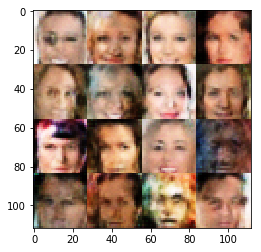

Epoch 1/2... Discriminator Loss: 0.5376... Generator Loss: 3.3582
Epoch 1/2... Discriminator Loss: 0.5111... Generator Loss: 2.1082
Epoch 1/2... Discriminator Loss: 1.3406... Generator Loss: 0.4845
Epoch 1/2... Discriminator Loss: 0.9127... Generator Loss: 4.5944
Epoch 1/2... Discriminator Loss: 1.5741... Generator Loss: 0.4043
Epoch 1/2... Discriminator Loss: 0.6813... Generator Loss: 1.4176
Epoch 1/2... Discriminator Loss: 0.9438... Generator Loss: 1.5639
Epoch 1/2... Discriminator Loss: 0.7807... Generator Loss: 1.4312
Epoch 1/2... Discriminator Loss: 0.3794... Generator Loss: 4.2604
Epoch 1/2... Discriminator Loss: 1.4869... Generator Loss: 2.8289


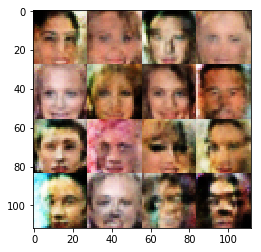

Epoch 1/2... Discriminator Loss: 0.5627... Generator Loss: 2.6021
Epoch 1/2... Discriminator Loss: 0.7573... Generator Loss: 1.3814
Epoch 1/2... Discriminator Loss: 0.7423... Generator Loss: 1.8454
Epoch 1/2... Discriminator Loss: 0.8566... Generator Loss: 0.9374
Epoch 1/2... Discriminator Loss: 0.4876... Generator Loss: 2.5887
Epoch 1/2... Discriminator Loss: 0.6214... Generator Loss: 1.7902
Epoch 1/2... Discriminator Loss: 1.0727... Generator Loss: 1.1345
Epoch 1/2... Discriminator Loss: 0.9513... Generator Loss: 0.9152
Epoch 1/2... Discriminator Loss: 0.6092... Generator Loss: 1.7590
Epoch 1/2... Discriminator Loss: 1.2030... Generator Loss: 0.7739


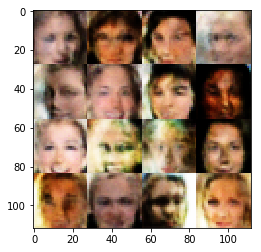

Epoch 1/2... Discriminator Loss: 1.2455... Generator Loss: 1.3465
Epoch 1/2... Discriminator Loss: 0.9743... Generator Loss: 1.4970
Epoch 1/2... Discriminator Loss: 0.6885... Generator Loss: 1.2582
Epoch 1/2... Discriminator Loss: 0.7508... Generator Loss: 2.6963
Epoch 1/2... Discriminator Loss: 1.2658... Generator Loss: 0.6152
Epoch 1/2... Discriminator Loss: 1.0737... Generator Loss: 0.8601
Epoch 1/2... Discriminator Loss: 1.1541... Generator Loss: 1.0451
Epoch 1/2... Discriminator Loss: 1.2014... Generator Loss: 0.6768
Epoch 1/2... Discriminator Loss: 1.0553... Generator Loss: 0.9381
Epoch 1/2... Discriminator Loss: 1.1943... Generator Loss: 0.7350


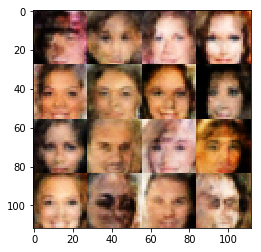

Epoch 1/2... Discriminator Loss: 1.0893... Generator Loss: 1.1464
Epoch 1/2... Discriminator Loss: 1.0468... Generator Loss: 1.3687
Epoch 1/2... Discriminator Loss: 1.3164... Generator Loss: 0.5581
Epoch 1/2... Discriminator Loss: 0.8210... Generator Loss: 1.2233
Epoch 1/2... Discriminator Loss: 0.9879... Generator Loss: 0.8420
Epoch 1/2... Discriminator Loss: 1.0091... Generator Loss: 0.9280
Epoch 1/2... Discriminator Loss: 0.4574... Generator Loss: 2.6294
Epoch 1/2... Discriminator Loss: 1.2122... Generator Loss: 1.6567
Epoch 1/2... Discriminator Loss: 1.1071... Generator Loss: 2.7348
Epoch 1/2... Discriminator Loss: 1.3034... Generator Loss: 0.7893


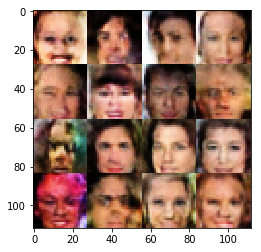

Epoch 1/2... Discriminator Loss: 0.6097... Generator Loss: 1.7638
Epoch 1/2... Discriminator Loss: 0.8875... Generator Loss: 3.5516
Epoch 1/2... Discriminator Loss: 1.1035... Generator Loss: 0.6437
Epoch 1/2... Discriminator Loss: 0.7574... Generator Loss: 1.5132
Epoch 1/2... Discriminator Loss: 0.5609... Generator Loss: 2.0882
Epoch 1/2... Discriminator Loss: 0.8384... Generator Loss: 1.1998
Epoch 1/2... Discriminator Loss: 1.2450... Generator Loss: 0.6884
Epoch 1/2... Discriminator Loss: 1.1995... Generator Loss: 0.7291
Epoch 1/2... Discriminator Loss: 0.6072... Generator Loss: 1.6629
Epoch 1/2... Discriminator Loss: 0.7512... Generator Loss: 1.4851


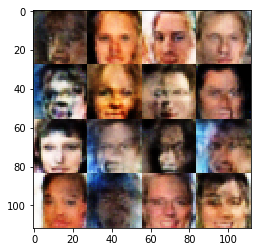

Epoch 1/2... Discriminator Loss: 0.7853... Generator Loss: 3.0637
Epoch 1/2... Discriminator Loss: 0.8893... Generator Loss: 0.9530
Epoch 1/2... Discriminator Loss: 0.6284... Generator Loss: 1.9379
Epoch 1/2... Discriminator Loss: 0.7913... Generator Loss: 1.1758
Epoch 1/2... Discriminator Loss: 0.5714... Generator Loss: 1.9830
Epoch 1/2... Discriminator Loss: 1.2321... Generator Loss: 0.6064
Epoch 1/2... Discriminator Loss: 1.0869... Generator Loss: 1.7887
Epoch 1/2... Discriminator Loss: 1.2739... Generator Loss: 1.6927
Epoch 1/2... Discriminator Loss: 0.8824... Generator Loss: 1.0932
Epoch 1/2... Discriminator Loss: 1.6425... Generator Loss: 0.3732


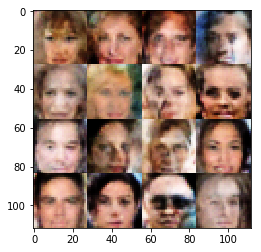

Epoch 1/2... Discriminator Loss: 1.2622... Generator Loss: 0.6451
Epoch 1/2... Discriminator Loss: 0.4674... Generator Loss: 2.1896
Epoch 1/2... Discriminator Loss: 2.0742... Generator Loss: 2.3708
Epoch 1/2... Discriminator Loss: 0.7992... Generator Loss: 1.2390
Epoch 1/2... Discriminator Loss: 1.4148... Generator Loss: 0.5608
Epoch 1/2... Discriminator Loss: 1.0680... Generator Loss: 0.7032
Epoch 1/2... Discriminator Loss: 0.5192... Generator Loss: 2.5775
Epoch 1/2... Discriminator Loss: 0.9256... Generator Loss: 0.9906
Epoch 1/2... Discriminator Loss: 1.1529... Generator Loss: 0.7273
Epoch 1/2... Discriminator Loss: 0.8232... Generator Loss: 1.0360


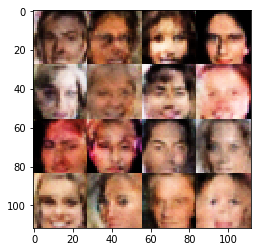

Epoch 1/2... Discriminator Loss: 1.3818... Generator Loss: 0.5744
Epoch 1/2... Discriminator Loss: 1.2510... Generator Loss: 0.6007
Epoch 1/2... Discriminator Loss: 0.9234... Generator Loss: 1.3112
Epoch 1/2... Discriminator Loss: 0.9460... Generator Loss: 1.0757
Epoch 1/2... Discriminator Loss: 1.1864... Generator Loss: 0.6891
Epoch 1/2... Discriminator Loss: 1.0230... Generator Loss: 2.0994
Epoch 1/2... Discriminator Loss: 0.7651... Generator Loss: 1.6126
Epoch 1/2... Discriminator Loss: 1.3671... Generator Loss: 2.0374
Epoch 1/2... Discriminator Loss: 0.7005... Generator Loss: 1.2443
Epoch 1/2... Discriminator Loss: 1.3040... Generator Loss: 0.6471


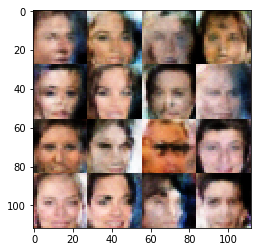

Epoch 1/2... Discriminator Loss: 0.7470... Generator Loss: 1.3265
Epoch 1/2... Discriminator Loss: 0.5595... Generator Loss: 2.1172
Epoch 1/2... Discriminator Loss: 0.6764... Generator Loss: 2.4072
Epoch 1/2... Discriminator Loss: 0.9511... Generator Loss: 0.9461
Epoch 1/2... Discriminator Loss: 0.9252... Generator Loss: 1.0663
Epoch 1/2... Discriminator Loss: 2.0381... Generator Loss: 3.3256
Epoch 1/2... Discriminator Loss: 0.5936... Generator Loss: 2.6734
Epoch 1/2... Discriminator Loss: 0.5475... Generator Loss: 1.6927
Epoch 1/2... Discriminator Loss: 0.5362... Generator Loss: 2.4341
Epoch 1/2... Discriminator Loss: 0.6757... Generator Loss: 1.4081


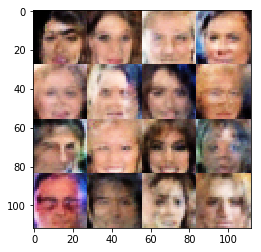

Epoch 1/2... Discriminator Loss: 1.4223... Generator Loss: 0.6227
Epoch 1/2... Discriminator Loss: 0.7652... Generator Loss: 1.2864
Epoch 1/2... Discriminator Loss: 1.0082... Generator Loss: 1.1621
Epoch 1/2... Discriminator Loss: 1.1547... Generator Loss: 0.7297
Epoch 1/2... Discriminator Loss: 0.6502... Generator Loss: 1.8152
Epoch 1/2... Discriminator Loss: 0.5023... Generator Loss: 2.5609
Epoch 1/2... Discriminator Loss: 1.0148... Generator Loss: 1.8367
Epoch 1/2... Discriminator Loss: 1.1347... Generator Loss: 1.3424
Epoch 1/2... Discriminator Loss: 0.8789... Generator Loss: 0.9218
Epoch 1/2... Discriminator Loss: 1.0990... Generator Loss: 0.9327


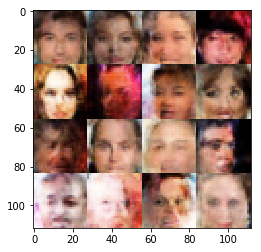

Epoch 1/2... Discriminator Loss: 1.0515... Generator Loss: 1.7964
Epoch 1/2... Discriminator Loss: 0.5858... Generator Loss: 1.5312
Epoch 1/2... Discriminator Loss: 0.7427... Generator Loss: 1.5800
Epoch 1/2... Discriminator Loss: 1.1132... Generator Loss: 0.7021
Epoch 1/2... Discriminator Loss: 1.5055... Generator Loss: 2.0583
Epoch 1/2... Discriminator Loss: 1.7000... Generator Loss: 2.2948
Epoch 1/2... Discriminator Loss: 1.2364... Generator Loss: 0.8740
Epoch 1/2... Discriminator Loss: 0.5981... Generator Loss: 2.8518
Epoch 1/2... Discriminator Loss: 1.2619... Generator Loss: 1.1488
Epoch 1/2... Discriminator Loss: 1.4431... Generator Loss: 0.4586


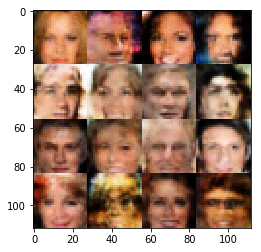

Epoch 1/2... Discriminator Loss: 0.9175... Generator Loss: 0.9507
Epoch 1/2... Discriminator Loss: 1.5490... Generator Loss: 1.8226
Epoch 1/2... Discriminator Loss: 0.9533... Generator Loss: 1.0633
Epoch 1/2... Discriminator Loss: 0.9753... Generator Loss: 0.7303
Epoch 1/2... Discriminator Loss: 0.9138... Generator Loss: 1.4639
Epoch 1/2... Discriminator Loss: 1.3168... Generator Loss: 0.6079
Epoch 1/2... Discriminator Loss: 0.7850... Generator Loss: 1.1363
Epoch 1/2... Discriminator Loss: 0.5515... Generator Loss: 1.9669
Epoch 1/2... Discriminator Loss: 0.5040... Generator Loss: 2.1544
Epoch 1/2... Discriminator Loss: 0.5749... Generator Loss: 2.4059


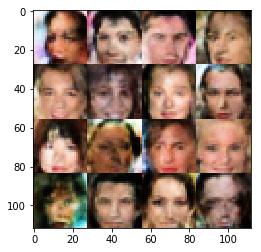

Epoch 1/2... Discriminator Loss: 1.0518... Generator Loss: 0.7401
Epoch 1/2... Discriminator Loss: 0.8948... Generator Loss: 2.6122
Epoch 1/2... Discriminator Loss: 0.9457... Generator Loss: 1.9104
Epoch 1/2... Discriminator Loss: 0.7910... Generator Loss: 1.6267
Epoch 1/2... Discriminator Loss: 1.4629... Generator Loss: 2.0475
Epoch 1/2... Discriminator Loss: 0.5162... Generator Loss: 2.0473
Epoch 1/2... Discriminator Loss: 1.2514... Generator Loss: 1.3687
Epoch 1/2... Discriminator Loss: 1.0352... Generator Loss: 1.1864
Epoch 1/2... Discriminator Loss: 1.4837... Generator Loss: 0.5264
Epoch 1/2... Discriminator Loss: 1.5081... Generator Loss: 0.3646


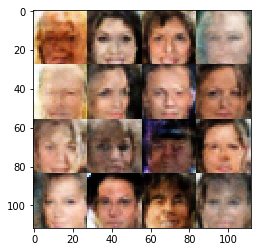

Epoch 1/2... Discriminator Loss: 0.8097... Generator Loss: 1.1040
Epoch 1/2... Discriminator Loss: 0.7082... Generator Loss: 1.2641
Epoch 1/2... Discriminator Loss: 0.7319... Generator Loss: 1.3773
Epoch 1/2... Discriminator Loss: 0.9148... Generator Loss: 1.1191
Epoch 1/2... Discriminator Loss: 1.3647... Generator Loss: 0.5885
Epoch 1/2... Discriminator Loss: 1.3571... Generator Loss: 0.5322
Epoch 1/2... Discriminator Loss: 0.6446... Generator Loss: 1.9157
Epoch 1/2... Discriminator Loss: 0.8953... Generator Loss: 0.9797
Epoch 1/2... Discriminator Loss: 0.9532... Generator Loss: 1.0215
Epoch 1/2... Discriminator Loss: 1.0486... Generator Loss: 1.3596


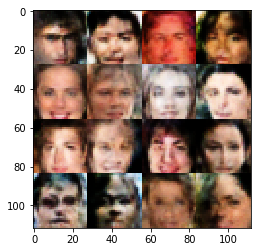

Epoch 1/2... Discriminator Loss: 1.4267... Generator Loss: 0.4352
Epoch 1/2... Discriminator Loss: 1.6540... Generator Loss: 0.3707
Epoch 1/2... Discriminator Loss: 0.5086... Generator Loss: 2.2762
Epoch 1/2... Discriminator Loss: 1.3905... Generator Loss: 1.6372
Epoch 1/2... Discriminator Loss: 1.2536... Generator Loss: 0.7145
Epoch 1/2... Discriminator Loss: 0.7225... Generator Loss: 1.6687
Epoch 1/2... Discriminator Loss: 1.3931... Generator Loss: 0.5115
Epoch 1/2... Discriminator Loss: 0.5357... Generator Loss: 2.6041
Epoch 1/2... Discriminator Loss: 0.5577... Generator Loss: 2.5893
Epoch 1/2... Discriminator Loss: 0.4974... Generator Loss: 2.7901


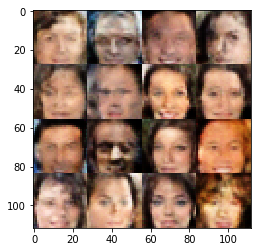

Epoch 1/2... Discriminator Loss: 0.9303... Generator Loss: 1.4226
Epoch 1/2... Discriminator Loss: 1.3690... Generator Loss: 1.9343
Epoch 1/2... Discriminator Loss: 0.9537... Generator Loss: 0.8547
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 1.6355
Epoch 1/2... Discriminator Loss: 0.8677... Generator Loss: 1.1123
Epoch 1/2... Discriminator Loss: 0.4979... Generator Loss: 4.1926
Epoch 1/2... Discriminator Loss: 0.7908... Generator Loss: 1.1928
Epoch 1/2... Discriminator Loss: 1.1278... Generator Loss: 0.8660
Epoch 1/2... Discriminator Loss: 0.7989... Generator Loss: 1.2147
Epoch 1/2... Discriminator Loss: 1.1179... Generator Loss: 1.1066


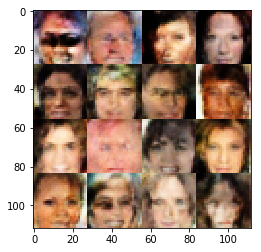

Epoch 1/2... Discriminator Loss: 0.7396... Generator Loss: 1.8806
Epoch 1/2... Discriminator Loss: 1.6258... Generator Loss: 1.7413
Epoch 1/2... Discriminator Loss: 0.6609... Generator Loss: 2.3127
Epoch 1/2... Discriminator Loss: 0.9801... Generator Loss: 0.9401
Epoch 1/2... Discriminator Loss: 0.7405... Generator Loss: 1.9370
Epoch 1/2... Discriminator Loss: 1.3934... Generator Loss: 0.5395
Epoch 1/2... Discriminator Loss: 0.9334... Generator Loss: 0.9267
Epoch 1/2... Discriminator Loss: 1.4405... Generator Loss: 0.5746
Epoch 1/2... Discriminator Loss: 0.5885... Generator Loss: 2.2614
Epoch 1/2... Discriminator Loss: 0.7678... Generator Loss: 1.2494


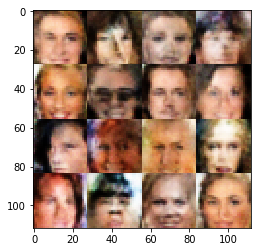

Epoch 1/2... Discriminator Loss: 1.2339... Generator Loss: 0.6465
Epoch 1/2... Discriminator Loss: 0.9128... Generator Loss: 1.1168
Epoch 1/2... Discriminator Loss: 1.3264... Generator Loss: 0.8289
Epoch 1/2... Discriminator Loss: 1.1947... Generator Loss: 0.6532
Epoch 1/2... Discriminator Loss: 0.9962... Generator Loss: 1.0854
Epoch 1/2... Discriminator Loss: 0.5415... Generator Loss: 1.8713
Epoch 1/2... Discriminator Loss: 1.0737... Generator Loss: 2.4238
Epoch 1/2... Discriminator Loss: 1.2127... Generator Loss: 0.6490
Epoch 1/2... Discriminator Loss: 0.7023... Generator Loss: 1.2844
Epoch 1/2... Discriminator Loss: 1.0235... Generator Loss: 1.1347


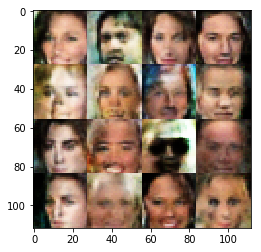

Epoch 1/2... Discriminator Loss: 1.5310... Generator Loss: 0.5082
Epoch 1/2... Discriminator Loss: 0.6898... Generator Loss: 1.2347
Epoch 1/2... Discriminator Loss: 1.1603... Generator Loss: 0.6643
Epoch 1/2... Discriminator Loss: 1.4475... Generator Loss: 0.4876
Epoch 1/2... Discriminator Loss: 0.7319... Generator Loss: 1.5756
Epoch 1/2... Discriminator Loss: 1.5881... Generator Loss: 0.3656
Epoch 1/2... Discriminator Loss: 1.2764... Generator Loss: 1.6983
Epoch 1/2... Discriminator Loss: 1.5829... Generator Loss: 0.4825
Epoch 1/2... Discriminator Loss: 0.4790... Generator Loss: 2.6511
Epoch 1/2... Discriminator Loss: 0.8672... Generator Loss: 1.7082


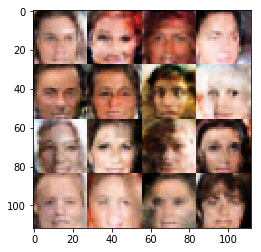

Epoch 1/2... Discriminator Loss: 1.5282... Generator Loss: 0.4073
Epoch 1/2... Discriminator Loss: 0.5541... Generator Loss: 1.8005
Epoch 1/2... Discriminator Loss: 1.4648... Generator Loss: 0.5169
Epoch 1/2... Discriminator Loss: 0.9449... Generator Loss: 1.0445
Epoch 1/2... Discriminator Loss: 1.2006... Generator Loss: 0.7638
Epoch 1/2... Discriminator Loss: 0.7152... Generator Loss: 1.5117
Epoch 1/2... Discriminator Loss: 0.7865... Generator Loss: 1.1723
Epoch 1/2... Discriminator Loss: 0.9729... Generator Loss: 0.9011
Epoch 1/2... Discriminator Loss: 0.6884... Generator Loss: 1.6358
Epoch 1/2... Discriminator Loss: 0.7883... Generator Loss: 1.1929


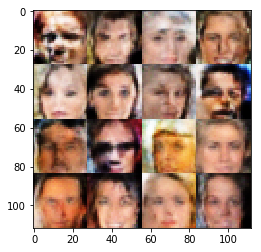

Epoch 1/2... Discriminator Loss: 1.1359... Generator Loss: 0.7566
Epoch 1/2... Discriminator Loss: 0.8603... Generator Loss: 1.0240
Epoch 1/2... Discriminator Loss: 0.7893... Generator Loss: 1.3239
Epoch 1/2... Discriminator Loss: 1.5601... Generator Loss: 0.3859
Epoch 1/2... Discriminator Loss: 0.9923... Generator Loss: 1.0241
Epoch 1/2... Discriminator Loss: 1.2820... Generator Loss: 1.0881
Epoch 1/2... Discriminator Loss: 1.1221... Generator Loss: 0.7462
Epoch 1/2... Discriminator Loss: 0.6058... Generator Loss: 1.6066
Epoch 1/2... Discriminator Loss: 1.0316... Generator Loss: 0.6691
Epoch 1/2... Discriminator Loss: 0.7784... Generator Loss: 1.0501


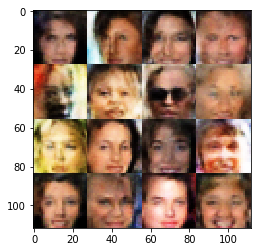

Epoch 1/2... Discriminator Loss: 0.7009... Generator Loss: 2.6066
Epoch 1/2... Discriminator Loss: 1.0343... Generator Loss: 0.9518
Epoch 1/2... Discriminator Loss: 1.1971... Generator Loss: 0.9187
Epoch 1/2... Discriminator Loss: 0.8161... Generator Loss: 2.4979
Epoch 1/2... Discriminator Loss: 0.7652... Generator Loss: 1.8662
Epoch 1/2... Discriminator Loss: 1.1796... Generator Loss: 0.7587
Epoch 1/2... Discriminator Loss: 0.9064... Generator Loss: 1.0025
Epoch 1/2... Discriminator Loss: 0.7952... Generator Loss: 1.4129
Epoch 1/2... Discriminator Loss: 0.9328... Generator Loss: 1.1911
Epoch 1/2... Discriminator Loss: 1.1419... Generator Loss: 0.9166


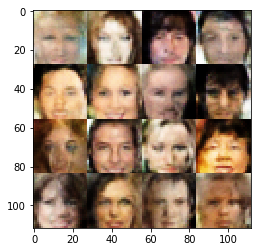

Epoch 1/2... Discriminator Loss: 0.8264... Generator Loss: 1.9940
Epoch 1/2... Discriminator Loss: 1.1585... Generator Loss: 1.1576
Epoch 1/2... Discriminator Loss: 0.5679... Generator Loss: 2.0832
Epoch 2/2... Discriminator Loss: 1.3960... Generator Loss: 0.4964
Epoch 2/2... Discriminator Loss: 1.4939... Generator Loss: 0.4944
Epoch 2/2... Discriminator Loss: 0.8476... Generator Loss: 1.2565
Epoch 2/2... Discriminator Loss: 0.9182... Generator Loss: 1.0889
Epoch 2/2... Discriminator Loss: 0.8495... Generator Loss: 0.9598
Epoch 2/2... Discriminator Loss: 1.1264... Generator Loss: 1.6455
Epoch 2/2... Discriminator Loss: 0.8021... Generator Loss: 1.1018


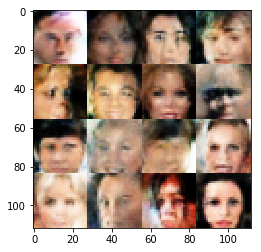

Epoch 2/2... Discriminator Loss: 0.4381... Generator Loss: 3.1953
Epoch 2/2... Discriminator Loss: 0.9153... Generator Loss: 1.0112
Epoch 2/2... Discriminator Loss: 0.8471... Generator Loss: 1.7293
Epoch 2/2... Discriminator Loss: 1.1006... Generator Loss: 0.8015
Epoch 2/2... Discriminator Loss: 1.0820... Generator Loss: 2.4263
Epoch 2/2... Discriminator Loss: 0.5090... Generator Loss: 1.9352
Epoch 2/2... Discriminator Loss: 1.7218... Generator Loss: 0.3635
Epoch 2/2... Discriminator Loss: 0.6564... Generator Loss: 1.6172
Epoch 2/2... Discriminator Loss: 1.3978... Generator Loss: 0.4492
Epoch 2/2... Discriminator Loss: 0.7215... Generator Loss: 1.3016


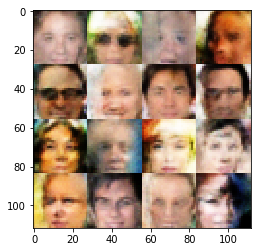

Epoch 2/2... Discriminator Loss: 0.7562... Generator Loss: 1.2729
Epoch 2/2... Discriminator Loss: 0.5934... Generator Loss: 1.8162
Epoch 2/2... Discriminator Loss: 0.8971... Generator Loss: 2.4886
Epoch 2/2... Discriminator Loss: 1.2160... Generator Loss: 1.3949
Epoch 2/2... Discriminator Loss: 0.7029... Generator Loss: 1.3863
Epoch 2/2... Discriminator Loss: 1.1647... Generator Loss: 2.0503
Epoch 2/2... Discriminator Loss: 1.1228... Generator Loss: 1.2099
Epoch 2/2... Discriminator Loss: 0.9503... Generator Loss: 1.0367
Epoch 2/2... Discriminator Loss: 0.9945... Generator Loss: 1.0565
Epoch 2/2... Discriminator Loss: 0.7832... Generator Loss: 1.1742


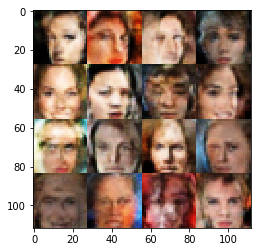

Epoch 2/2... Discriminator Loss: 0.5530... Generator Loss: 2.3660
Epoch 2/2... Discriminator Loss: 0.9365... Generator Loss: 1.1996
Epoch 2/2... Discriminator Loss: 0.7440... Generator Loss: 1.9216
Epoch 2/2... Discriminator Loss: 1.2003... Generator Loss: 0.8127
Epoch 2/2... Discriminator Loss: 0.7923... Generator Loss: 1.1844
Epoch 2/2... Discriminator Loss: 1.2432... Generator Loss: 1.4715
Epoch 2/2... Discriminator Loss: 1.0670... Generator Loss: 0.9602
Epoch 2/2... Discriminator Loss: 1.6226... Generator Loss: 2.3196
Epoch 2/2... Discriminator Loss: 0.8681... Generator Loss: 1.1702
Epoch 2/2... Discriminator Loss: 1.9596... Generator Loss: 1.9991


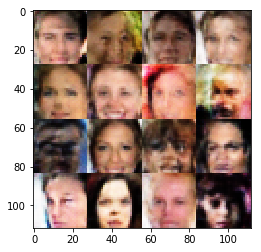

Epoch 2/2... Discriminator Loss: 1.2860... Generator Loss: 0.6760
Epoch 2/2... Discriminator Loss: 1.0835... Generator Loss: 0.7782
Epoch 2/2... Discriminator Loss: 1.2574... Generator Loss: 0.6791
Epoch 2/2... Discriminator Loss: 1.1085... Generator Loss: 1.5737
Epoch 2/2... Discriminator Loss: 1.3263... Generator Loss: 0.5519
Epoch 2/2... Discriminator Loss: 0.9241... Generator Loss: 1.0987
Epoch 2/2... Discriminator Loss: 1.7788... Generator Loss: 0.3750
Epoch 2/2... Discriminator Loss: 0.8660... Generator Loss: 1.0445
Epoch 2/2... Discriminator Loss: 1.1906... Generator Loss: 0.7596
Epoch 2/2... Discriminator Loss: 1.2481... Generator Loss: 0.5895


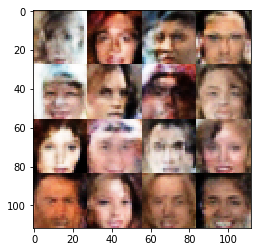

Epoch 2/2... Discriminator Loss: 0.9586... Generator Loss: 0.8607
Epoch 2/2... Discriminator Loss: 1.4369... Generator Loss: 0.4189
Epoch 2/2... Discriminator Loss: 1.4075... Generator Loss: 0.5549
Epoch 2/2... Discriminator Loss: 0.8088... Generator Loss: 2.5252
Epoch 2/2... Discriminator Loss: 1.3434... Generator Loss: 0.5896
Epoch 2/2... Discriminator Loss: 0.7534... Generator Loss: 1.7654
Epoch 2/2... Discriminator Loss: 1.1201... Generator Loss: 1.2762
Epoch 2/2... Discriminator Loss: 0.7163... Generator Loss: 1.2432
Epoch 2/2... Discriminator Loss: 1.3604... Generator Loss: 0.5891
Epoch 2/2... Discriminator Loss: 0.7148... Generator Loss: 2.8759


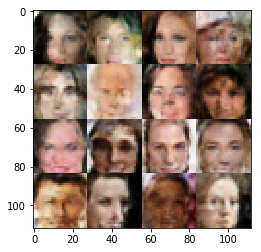

Epoch 2/2... Discriminator Loss: 0.8491... Generator Loss: 0.9220
Epoch 2/2... Discriminator Loss: 1.4512... Generator Loss: 0.4870
Epoch 2/2... Discriminator Loss: 0.9749... Generator Loss: 0.7998
Epoch 2/2... Discriminator Loss: 1.5305... Generator Loss: 0.5190
Epoch 2/2... Discriminator Loss: 1.3204... Generator Loss: 0.5601
Epoch 2/2... Discriminator Loss: 0.5689... Generator Loss: 2.0413
Epoch 2/2... Discriminator Loss: 0.4013... Generator Loss: 3.0270
Epoch 2/2... Discriminator Loss: 0.4073... Generator Loss: 2.9843
Epoch 2/2... Discriminator Loss: 0.4530... Generator Loss: 2.3924
Epoch 2/2... Discriminator Loss: 0.5405... Generator Loss: 1.9252


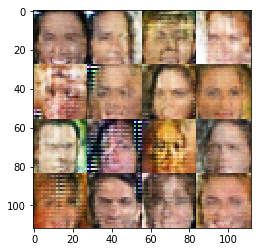

Epoch 2/2... Discriminator Loss: 0.4110... Generator Loss: 3.1299
Epoch 2/2... Discriminator Loss: 0.3696... Generator Loss: 4.9236
Epoch 2/2... Discriminator Loss: 1.8381... Generator Loss: 0.2998
Epoch 2/2... Discriminator Loss: 0.3955... Generator Loss: 3.8851
Epoch 2/2... Discriminator Loss: 0.7156... Generator Loss: 1.1735
Epoch 2/2... Discriminator Loss: 0.3975... Generator Loss: 3.7059
Epoch 2/2... Discriminator Loss: 0.4977... Generator Loss: 2.1780
Epoch 2/2... Discriminator Loss: 0.5065... Generator Loss: 2.2988
Epoch 2/2... Discriminator Loss: 0.5276... Generator Loss: 2.3666
Epoch 2/2... Discriminator Loss: 1.2425... Generator Loss: 0.6192


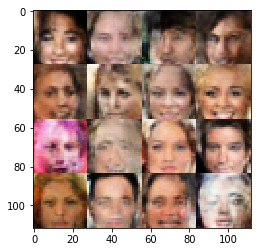

Epoch 2/2... Discriminator Loss: 1.1474... Generator Loss: 1.4877
Epoch 2/2... Discriminator Loss: 0.8754... Generator Loss: 1.3917
Epoch 2/2... Discriminator Loss: 0.8922... Generator Loss: 2.2277
Epoch 2/2... Discriminator Loss: 0.7857... Generator Loss: 1.4259
Epoch 2/2... Discriminator Loss: 0.8454... Generator Loss: 1.0901
Epoch 2/2... Discriminator Loss: 1.1037... Generator Loss: 1.0153
Epoch 2/2... Discriminator Loss: 1.0512... Generator Loss: 1.4182
Epoch 2/2... Discriminator Loss: 0.8195... Generator Loss: 1.1351
Epoch 2/2... Discriminator Loss: 1.2602... Generator Loss: 1.1646
Epoch 2/2... Discriminator Loss: 1.4103... Generator Loss: 0.4160


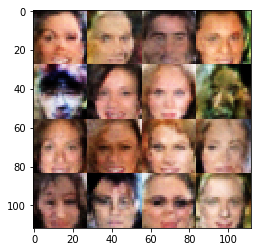

Epoch 2/2... Discriminator Loss: 0.9943... Generator Loss: 0.7444
Epoch 2/2... Discriminator Loss: 0.8390... Generator Loss: 0.9018
Epoch 2/2... Discriminator Loss: 0.9824... Generator Loss: 1.2382


KeyboardInterrupt: 

In [15]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.1


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Epoch 1/2... Discriminator Loss: 1.7179... Generator Loss: 26.4269
Epoch 1/2... Discriminator Loss: 0.9482... Generator Loss: 4.0883
Epoch 1/2... Discriminator Loss: 1.0483... Generator Loss: 1.3689
Epoch 1/2... Discriminator Loss: 2.6138... Generator Loss: 0.1459
Epoch 1/2... Discriminator Loss: 3.1652... Generator Loss: 0.0748
Epoch 1/2... Discriminator Loss: 1.7501... Generator Loss: 0.4773
Epoch 1/2... Discriminator Loss: 3.3167... Generator Loss: 0.0693
Epoch 1/2... Discriminator Loss: 0.5805... Generator Loss: 2.9984
Epoch 1/2... Discriminator Loss: 0.9405... Generator Loss: 2.3544
Epoch 1/2... Discriminator Loss: 1.5017... Generator Loss: 3.0239


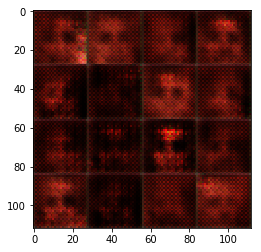

Epoch 1/2... Discriminator Loss: 2.4269... Generator Loss: 0.2024
Epoch 1/2... Discriminator Loss: 1.0705... Generator Loss: 0.9655
Epoch 1/2... Discriminator Loss: 2.1408... Generator Loss: 0.2527
Epoch 1/2... Discriminator Loss: 0.8613... Generator Loss: 1.5097
Epoch 1/2... Discriminator Loss: 1.2212... Generator Loss: 1.1845
Epoch 1/2... Discriminator Loss: 1.4923... Generator Loss: 2.1164
Epoch 1/2... Discriminator Loss: 1.3272... Generator Loss: 0.7777
Epoch 1/2... Discriminator Loss: 1.1602... Generator Loss: 0.8632
Epoch 1/2... Discriminator Loss: 1.5221... Generator Loss: 0.4658
Epoch 1/2... Discriminator Loss: 1.5327... Generator Loss: 0.9846


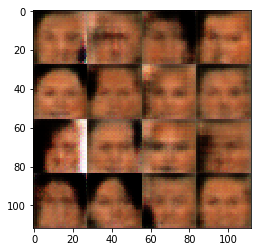

Epoch 1/2... Discriminator Loss: 1.0118... Generator Loss: 0.9811
Epoch 1/2... Discriminator Loss: 1.6099... Generator Loss: 0.7824
Epoch 1/2... Discriminator Loss: 2.6191... Generator Loss: 0.1110
Epoch 1/2... Discriminator Loss: 1.4571... Generator Loss: 0.7620
Epoch 1/2... Discriminator Loss: 1.4411... Generator Loss: 0.7429
Epoch 1/2... Discriminator Loss: 1.2356... Generator Loss: 1.5294
Epoch 1/2... Discriminator Loss: 1.6053... Generator Loss: 0.4331
Epoch 1/2... Discriminator Loss: 1.3044... Generator Loss: 0.9896
Epoch 1/2... Discriminator Loss: 2.5426... Generator Loss: 0.1547
Epoch 1/2... Discriminator Loss: 1.5777... Generator Loss: 0.8271


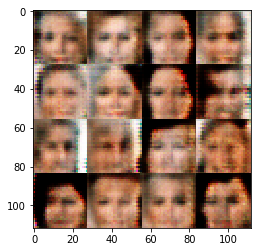

Epoch 1/2... Discriminator Loss: 1.3850... Generator Loss: 0.8445
Epoch 1/2... Discriminator Loss: 1.2311... Generator Loss: 0.8114
Epoch 1/2... Discriminator Loss: 1.4686... Generator Loss: 1.0981
Epoch 1/2... Discriminator Loss: 1.3555... Generator Loss: 0.9314
Epoch 1/2... Discriminator Loss: 1.5281... Generator Loss: 0.5026
Epoch 1/2... Discriminator Loss: 1.0037... Generator Loss: 0.8586
Epoch 1/2... Discriminator Loss: 1.6165... Generator Loss: 0.6323
Epoch 1/2... Discriminator Loss: 1.4235... Generator Loss: 0.6514
Epoch 1/2... Discriminator Loss: 1.2969... Generator Loss: 0.7998
Epoch 1/2... Discriminator Loss: 1.3335... Generator Loss: 0.9500


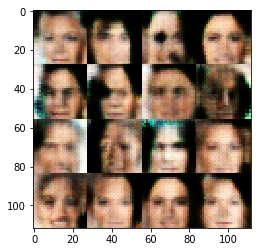

Epoch 1/2... Discriminator Loss: 1.2750... Generator Loss: 0.7721
Epoch 1/2... Discriminator Loss: 1.4433... Generator Loss: 0.5790
Epoch 1/2... Discriminator Loss: 1.5728... Generator Loss: 0.4872
Epoch 1/2... Discriminator Loss: 1.6497... Generator Loss: 0.4639
Epoch 1/2... Discriminator Loss: 1.1213... Generator Loss: 0.9014
Epoch 1/2... Discriminator Loss: 1.4079... Generator Loss: 0.6961
Epoch 1/2... Discriminator Loss: 1.2629... Generator Loss: 0.8848
Epoch 1/2... Discriminator Loss: 1.2094... Generator Loss: 1.1568
Epoch 1/2... Discriminator Loss: 1.3540... Generator Loss: 0.8882
Epoch 1/2... Discriminator Loss: 1.4936... Generator Loss: 1.0978


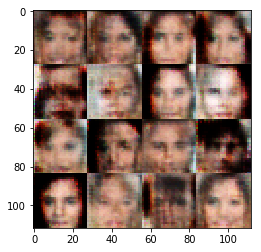

Epoch 1/2... Discriminator Loss: 1.4912... Generator Loss: 0.6236
Epoch 1/2... Discriminator Loss: 1.4861... Generator Loss: 0.5427
Epoch 1/2... Discriminator Loss: 1.3876... Generator Loss: 1.1897
Epoch 1/2... Discriminator Loss: 1.5223... Generator Loss: 0.6986
Epoch 1/2... Discriminator Loss: 1.1881... Generator Loss: 1.0448
Epoch 1/2... Discriminator Loss: 2.1608... Generator Loss: 2.2534
Epoch 1/2... Discriminator Loss: 1.4331... Generator Loss: 0.9134
Epoch 1/2... Discriminator Loss: 1.7085... Generator Loss: 1.4877
Epoch 1/2... Discriminator Loss: 1.2545... Generator Loss: 0.8572
Epoch 1/2... Discriminator Loss: 1.3980... Generator Loss: 0.7508


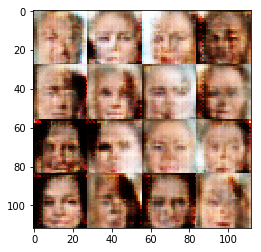

Epoch 1/2... Discriminator Loss: 1.3159... Generator Loss: 0.5197
Epoch 1/2... Discriminator Loss: 1.3346... Generator Loss: 0.6377
Epoch 1/2... Discriminator Loss: 1.3013... Generator Loss: 0.6229
Epoch 1/2... Discriminator Loss: 1.4351... Generator Loss: 0.8761
Epoch 1/2... Discriminator Loss: 1.5480... Generator Loss: 0.4092
Epoch 1/2... Discriminator Loss: 1.1904... Generator Loss: 0.7526
Epoch 1/2... Discriminator Loss: 1.5130... Generator Loss: 0.6242
Epoch 1/2... Discriminator Loss: 1.2769... Generator Loss: 0.9752
Epoch 1/2... Discriminator Loss: 1.3304... Generator Loss: 0.9878
Epoch 1/2... Discriminator Loss: 1.4335... Generator Loss: 0.5215


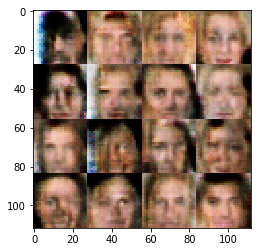

Epoch 1/2... Discriminator Loss: 1.2633... Generator Loss: 0.7538
Epoch 1/2... Discriminator Loss: 1.1123... Generator Loss: 0.8638
Epoch 1/2... Discriminator Loss: 1.1216... Generator Loss: 1.2804
Epoch 1/2... Discriminator Loss: 1.4464... Generator Loss: 0.9294
Epoch 1/2... Discriminator Loss: 1.4414... Generator Loss: 1.3500
Epoch 1/2... Discriminator Loss: 1.3563... Generator Loss: 0.6279
Epoch 1/2... Discriminator Loss: 1.3439... Generator Loss: 0.8668
Epoch 1/2... Discriminator Loss: 1.0186... Generator Loss: 1.1933
Epoch 1/2... Discriminator Loss: 1.3569... Generator Loss: 0.8958
Epoch 1/2... Discriminator Loss: 1.4364... Generator Loss: 0.7126


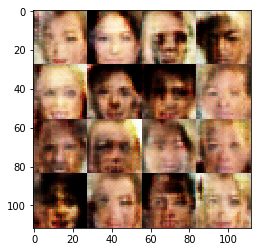

Epoch 1/2... Discriminator Loss: 1.2944... Generator Loss: 0.9423
Epoch 1/2... Discriminator Loss: 1.3559... Generator Loss: 0.6481
Epoch 1/2... Discriminator Loss: 1.5721... Generator Loss: 0.5008
Epoch 1/2... Discriminator Loss: 0.8045... Generator Loss: 1.0043
Epoch 1/2... Discriminator Loss: 1.2762... Generator Loss: 1.3375
Epoch 1/2... Discriminator Loss: 1.4631... Generator Loss: 0.7320
Epoch 1/2... Discriminator Loss: 1.2009... Generator Loss: 0.9841
Epoch 1/2... Discriminator Loss: 1.3610... Generator Loss: 0.6881
Epoch 1/2... Discriminator Loss: 1.3655... Generator Loss: 0.8642
Epoch 1/2... Discriminator Loss: 1.4923... Generator Loss: 0.8685


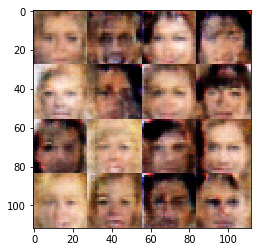

Epoch 1/2... Discriminator Loss: 1.2658... Generator Loss: 0.8729
Epoch 1/2... Discriminator Loss: 1.2643... Generator Loss: 0.6846
Epoch 1/2... Discriminator Loss: 1.0116... Generator Loss: 0.8599
Epoch 1/2... Discriminator Loss: 1.3315... Generator Loss: 0.8003
Epoch 1/2... Discriminator Loss: 1.2836... Generator Loss: 0.5822
Epoch 1/2... Discriminator Loss: 1.4052... Generator Loss: 0.9255
Epoch 1/2... Discriminator Loss: 1.3386... Generator Loss: 0.8951
Epoch 1/2... Discriminator Loss: 1.2997... Generator Loss: 1.4690
Epoch 1/2... Discriminator Loss: 1.4955... Generator Loss: 0.7367
Epoch 1/2... Discriminator Loss: 1.3541... Generator Loss: 1.0692


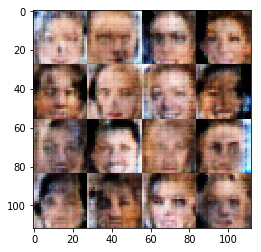

Epoch 1/2... Discriminator Loss: 1.5306... Generator Loss: 0.6940
Epoch 1/2... Discriminator Loss: 1.4188... Generator Loss: 0.7934
Epoch 1/2... Discriminator Loss: 1.2491... Generator Loss: 0.7118
Epoch 1/2... Discriminator Loss: 1.4177... Generator Loss: 0.6819
Epoch 1/2... Discriminator Loss: 1.3592... Generator Loss: 0.8521
Epoch 1/2... Discriminator Loss: 1.4699... Generator Loss: 0.7334
Epoch 1/2... Discriminator Loss: 1.3373... Generator Loss: 0.6923
Epoch 1/2... Discriminator Loss: 1.3459... Generator Loss: 0.8872
Epoch 1/2... Discriminator Loss: 1.9190... Generator Loss: 1.4599
Epoch 1/2... Discriminator Loss: 1.4282... Generator Loss: 0.8876


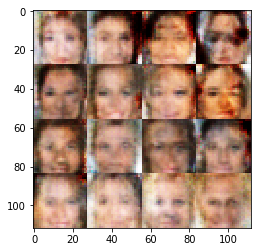

Epoch 1/2... Discriminator Loss: 1.4507... Generator Loss: 0.4870
Epoch 1/2... Discriminator Loss: 1.3698... Generator Loss: 0.7397
Epoch 1/2... Discriminator Loss: 1.4693... Generator Loss: 0.5857
Epoch 1/2... Discriminator Loss: 1.3798... Generator Loss: 0.8920
Epoch 1/2... Discriminator Loss: 1.4875... Generator Loss: 0.5875
Epoch 1/2... Discriminator Loss: 1.4352... Generator Loss: 0.7171
Epoch 1/2... Discriminator Loss: 1.4760... Generator Loss: 0.8305
Epoch 1/2... Discriminator Loss: 1.7749... Generator Loss: 0.3547
Epoch 1/2... Discriminator Loss: 1.6146... Generator Loss: 1.5258
Epoch 1/2... Discriminator Loss: 1.5060... Generator Loss: 0.6582


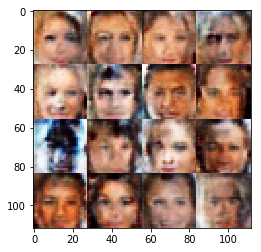

Epoch 1/2... Discriminator Loss: 1.3429... Generator Loss: 0.6468
Epoch 1/2... Discriminator Loss: 1.4291... Generator Loss: 0.7580
Epoch 1/2... Discriminator Loss: 1.2461... Generator Loss: 1.2369
Epoch 1/2... Discriminator Loss: 1.3948... Generator Loss: 0.6154
Epoch 1/2... Discriminator Loss: 1.4636... Generator Loss: 0.7024
Epoch 1/2... Discriminator Loss: 1.3889... Generator Loss: 0.7372
Epoch 1/2... Discriminator Loss: 1.5104... Generator Loss: 0.6290
Epoch 1/2... Discriminator Loss: 1.4207... Generator Loss: 0.7624
Epoch 1/2... Discriminator Loss: 1.4014... Generator Loss: 0.7234
Epoch 1/2... Discriminator Loss: 1.3073... Generator Loss: 1.0107


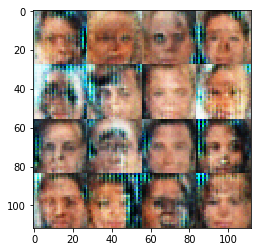

Epoch 1/2... Discriminator Loss: 1.4817... Generator Loss: 0.7464
Epoch 1/2... Discriminator Loss: 1.3499... Generator Loss: 0.7771
Epoch 1/2... Discriminator Loss: 1.2524... Generator Loss: 0.6121
Epoch 1/2... Discriminator Loss: 1.3893... Generator Loss: 0.8403
Epoch 1/2... Discriminator Loss: 1.3101... Generator Loss: 0.8813
Epoch 1/2... Discriminator Loss: 1.3798... Generator Loss: 0.6509
Epoch 1/2... Discriminator Loss: 1.3786... Generator Loss: 0.6161
Epoch 1/2... Discriminator Loss: 1.3676... Generator Loss: 0.8161
Epoch 1/2... Discriminator Loss: 1.4076... Generator Loss: 0.6723
Epoch 1/2... Discriminator Loss: 1.3450... Generator Loss: 0.6274


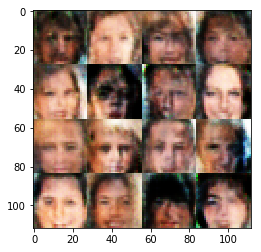

Epoch 1/2... Discriminator Loss: 2.0081... Generator Loss: 0.2263
Epoch 1/2... Discriminator Loss: 1.4821... Generator Loss: 0.7497
Epoch 1/2... Discriminator Loss: 1.4999... Generator Loss: 0.7294
Epoch 1/2... Discriminator Loss: 1.3678... Generator Loss: 0.6135
Epoch 1/2... Discriminator Loss: 1.1118... Generator Loss: 0.7105
Epoch 1/2... Discriminator Loss: 1.4231... Generator Loss: 0.8516
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 0.7126
Epoch 1/2... Discriminator Loss: 1.3784... Generator Loss: 0.9035
Epoch 1/2... Discriminator Loss: 1.3146... Generator Loss: 0.7525
Epoch 1/2... Discriminator Loss: 1.4008... Generator Loss: 0.8422


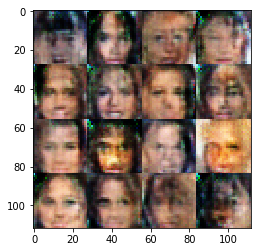

Epoch 1/2... Discriminator Loss: 1.3354... Generator Loss: 0.8021
Epoch 1/2... Discriminator Loss: 1.3024... Generator Loss: 0.8551
Epoch 1/2... Discriminator Loss: 1.4217... Generator Loss: 0.8071
Epoch 1/2... Discriminator Loss: 1.3230... Generator Loss: 0.6786
Epoch 1/2... Discriminator Loss: 1.4886... Generator Loss: 0.5887
Epoch 1/2... Discriminator Loss: 1.4105... Generator Loss: 0.5666
Epoch 1/2... Discriminator Loss: 1.2290... Generator Loss: 0.9880
Epoch 1/2... Discriminator Loss: 1.4888... Generator Loss: 0.4505
Epoch 1/2... Discriminator Loss: 1.3590... Generator Loss: 0.5898
Epoch 1/2... Discriminator Loss: 1.4147... Generator Loss: 0.7589


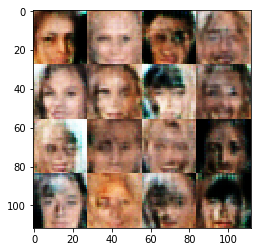

Epoch 1/2... Discriminator Loss: 1.3246... Generator Loss: 0.9977
Epoch 1/2... Discriminator Loss: 1.4133... Generator Loss: 1.0527
Epoch 1/2... Discriminator Loss: 1.4177... Generator Loss: 0.9738
Epoch 1/2... Discriminator Loss: 1.5432... Generator Loss: 1.0183
Epoch 1/2... Discriminator Loss: 1.3545... Generator Loss: 0.7878
Epoch 1/2... Discriminator Loss: 1.3384... Generator Loss: 0.8651
Epoch 1/2... Discriminator Loss: 1.4368... Generator Loss: 0.6409
Epoch 1/2... Discriminator Loss: 1.3997... Generator Loss: 0.7509
Epoch 1/2... Discriminator Loss: 1.2795... Generator Loss: 0.7677
Epoch 1/2... Discriminator Loss: 1.3656... Generator Loss: 0.7993


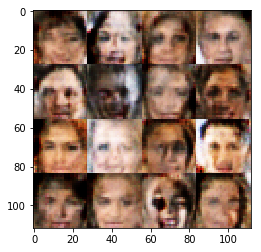

Epoch 1/2... Discriminator Loss: 1.2415... Generator Loss: 1.0587
Epoch 1/2... Discriminator Loss: 1.2792... Generator Loss: 0.9345
Epoch 1/2... Discriminator Loss: 1.3963... Generator Loss: 0.7237
Epoch 1/2... Discriminator Loss: 1.4159... Generator Loss: 0.7491
Epoch 1/2... Discriminator Loss: 1.4496... Generator Loss: 0.9064
Epoch 1/2... Discriminator Loss: 1.4389... Generator Loss: 0.8746
Epoch 1/2... Discriminator Loss: 1.3189... Generator Loss: 0.7891
Epoch 1/2... Discriminator Loss: 1.4226... Generator Loss: 0.9176
Epoch 1/2... Discriminator Loss: 1.2742... Generator Loss: 0.8705
Epoch 1/2... Discriminator Loss: 1.2992... Generator Loss: 0.6625


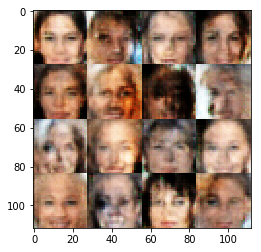

Epoch 1/2... Discriminator Loss: 1.4119... Generator Loss: 1.0366
Epoch 1/2... Discriminator Loss: 1.4047... Generator Loss: 0.7753
Epoch 1/2... Discriminator Loss: 1.3575... Generator Loss: 0.6294
Epoch 1/2... Discriminator Loss: 1.5905... Generator Loss: 1.4452
Epoch 1/2... Discriminator Loss: 1.3970... Generator Loss: 0.7998
Epoch 1/2... Discriminator Loss: 1.4083... Generator Loss: 0.6696
Epoch 1/2... Discriminator Loss: 1.3250... Generator Loss: 0.7547
Epoch 1/2... Discriminator Loss: 1.4005... Generator Loss: 0.6811
Epoch 1/2... Discriminator Loss: 1.3611... Generator Loss: 1.1417
Epoch 1/2... Discriminator Loss: 1.4270... Generator Loss: 0.9293


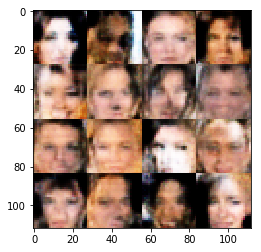

Epoch 1/2... Discriminator Loss: 1.2725... Generator Loss: 0.8470
Epoch 1/2... Discriminator Loss: 1.3834... Generator Loss: 0.6354
Epoch 1/2... Discriminator Loss: 1.3790... Generator Loss: 0.7132
Epoch 1/2... Discriminator Loss: 1.4828... Generator Loss: 0.5456
Epoch 1/2... Discriminator Loss: 1.5191... Generator Loss: 1.2349
Epoch 1/2... Discriminator Loss: 1.3052... Generator Loss: 0.7035
Epoch 1/2... Discriminator Loss: 1.2767... Generator Loss: 0.8026
Epoch 1/2... Discriminator Loss: 1.4007... Generator Loss: 0.8115
Epoch 1/2... Discriminator Loss: 1.2696... Generator Loss: 0.8584
Epoch 1/2... Discriminator Loss: 1.4630... Generator Loss: 0.6517


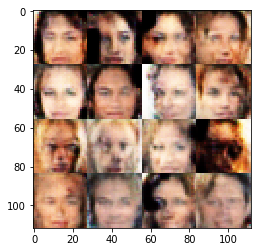

Epoch 1/2... Discriminator Loss: 1.4204... Generator Loss: 0.7599
Epoch 1/2... Discriminator Loss: 1.3243... Generator Loss: 0.7961
Epoch 1/2... Discriminator Loss: 1.3355... Generator Loss: 0.7806
Epoch 1/2... Discriminator Loss: 1.3739... Generator Loss: 0.8279
Epoch 1/2... Discriminator Loss: 1.4780... Generator Loss: 1.2277
Epoch 1/2... Discriminator Loss: 1.3429... Generator Loss: 1.2293
Epoch 1/2... Discriminator Loss: 1.4407... Generator Loss: 0.4861
Epoch 1/2... Discriminator Loss: 1.3972... Generator Loss: 0.9521
Epoch 1/2... Discriminator Loss: 1.4701... Generator Loss: 0.5492
Epoch 1/2... Discriminator Loss: 1.2992... Generator Loss: 0.8723


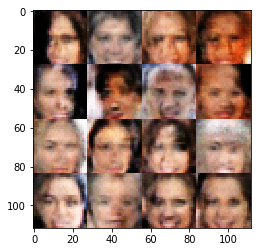

Epoch 1/2... Discriminator Loss: 1.3686... Generator Loss: 0.8359
Epoch 1/2... Discriminator Loss: 1.4636... Generator Loss: 1.0045
Epoch 1/2... Discriminator Loss: 1.5901... Generator Loss: 0.4297
Epoch 1/2... Discriminator Loss: 1.2782... Generator Loss: 0.9489
Epoch 1/2... Discriminator Loss: 1.3958... Generator Loss: 0.8578
Epoch 1/2... Discriminator Loss: 1.4471... Generator Loss: 0.8767
Epoch 1/2... Discriminator Loss: 1.4953... Generator Loss: 1.2162
Epoch 1/2... Discriminator Loss: 1.2735... Generator Loss: 0.8571
Epoch 1/2... Discriminator Loss: 1.4148... Generator Loss: 0.7394
Epoch 1/2... Discriminator Loss: 1.3593... Generator Loss: 0.9217


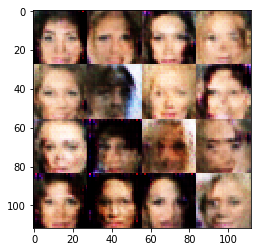

Epoch 1/2... Discriminator Loss: 1.3663... Generator Loss: 0.8125
Epoch 1/2... Discriminator Loss: 1.4656... Generator Loss: 0.6453
Epoch 1/2... Discriminator Loss: 1.3773... Generator Loss: 0.9061
Epoch 1/2... Discriminator Loss: 1.3954... Generator Loss: 0.8585
Epoch 1/2... Discriminator Loss: 1.3959... Generator Loss: 0.7083
Epoch 1/2... Discriminator Loss: 1.3909... Generator Loss: 0.7741
Epoch 1/2... Discriminator Loss: 1.3751... Generator Loss: 0.8228
Epoch 1/2... Discriminator Loss: 1.4175... Generator Loss: 0.6218
Epoch 1/2... Discriminator Loss: 1.3708... Generator Loss: 0.7499
Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.6663


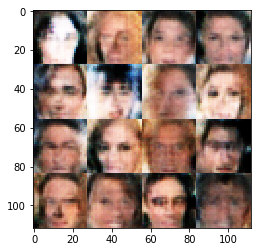

Epoch 1/2... Discriminator Loss: 1.3895... Generator Loss: 0.7679
Epoch 1/2... Discriminator Loss: 1.4138... Generator Loss: 0.7619
Epoch 1/2... Discriminator Loss: 1.4077... Generator Loss: 0.7208
Epoch 1/2... Discriminator Loss: 1.4626... Generator Loss: 0.5938
Epoch 1/2... Discriminator Loss: 1.3473... Generator Loss: 0.7042
Epoch 1/2... Discriminator Loss: 1.4147... Generator Loss: 0.7235
Epoch 1/2... Discriminator Loss: 1.3490... Generator Loss: 0.7020
Epoch 1/2... Discriminator Loss: 1.3669... Generator Loss: 0.9731
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 0.7343
Epoch 1/2... Discriminator Loss: 1.3416... Generator Loss: 0.5744


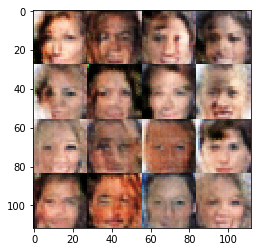

Epoch 1/2... Discriminator Loss: 1.4420... Generator Loss: 0.8777
Epoch 1/2... Discriminator Loss: 1.3571... Generator Loss: 0.6857
Epoch 1/2... Discriminator Loss: 1.2954... Generator Loss: 0.8217
Epoch 1/2... Discriminator Loss: 1.3376... Generator Loss: 1.0416
Epoch 1/2... Discriminator Loss: 1.3698... Generator Loss: 0.7015
Epoch 1/2... Discriminator Loss: 1.4230... Generator Loss: 0.5006
Epoch 1/2... Discriminator Loss: 1.3227... Generator Loss: 0.6873
Epoch 1/2... Discriminator Loss: 1.3931... Generator Loss: 0.7451
Epoch 1/2... Discriminator Loss: 1.4394... Generator Loss: 0.5527
Epoch 1/2... Discriminator Loss: 1.3940... Generator Loss: 1.1458


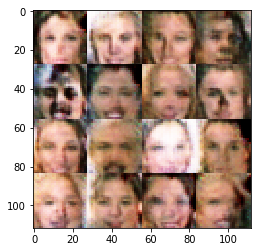

Epoch 1/2... Discriminator Loss: 1.4212... Generator Loss: 0.6972
Epoch 1/2... Discriminator Loss: 1.3990... Generator Loss: 1.0760
Epoch 1/2... Discriminator Loss: 1.2645... Generator Loss: 0.6630
Epoch 1/2... Discriminator Loss: 1.4415... Generator Loss: 0.6508
Epoch 1/2... Discriminator Loss: 1.3730... Generator Loss: 0.7976
Epoch 1/2... Discriminator Loss: 1.3789... Generator Loss: 0.6801
Epoch 1/2... Discriminator Loss: 1.3735... Generator Loss: 0.7685
Epoch 1/2... Discriminator Loss: 1.4229... Generator Loss: 0.7525
Epoch 1/2... Discriminator Loss: 1.2442... Generator Loss: 0.7961
Epoch 1/2... Discriminator Loss: 1.3864... Generator Loss: 0.7196


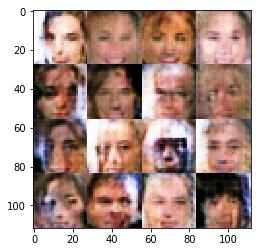

Epoch 1/2... Discriminator Loss: 1.3946... Generator Loss: 0.7592
Epoch 1/2... Discriminator Loss: 1.4236... Generator Loss: 0.6736
Epoch 1/2... Discriminator Loss: 1.4677... Generator Loss: 0.7301
Epoch 1/2... Discriminator Loss: 1.2840... Generator Loss: 0.8897
Epoch 1/2... Discriminator Loss: 1.3653... Generator Loss: 0.6656
Epoch 1/2... Discriminator Loss: 1.3706... Generator Loss: 0.7704
Epoch 1/2... Discriminator Loss: 1.4095... Generator Loss: 0.7837
Epoch 1/2... Discriminator Loss: 1.3299... Generator Loss: 0.8105
Epoch 1/2... Discriminator Loss: 1.3752... Generator Loss: 0.8021
Epoch 1/2... Discriminator Loss: 1.3732... Generator Loss: 0.6575


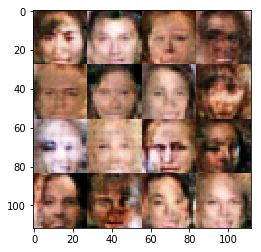

Epoch 1/2... Discriminator Loss: 1.2931... Generator Loss: 1.0192
Epoch 1/2... Discriminator Loss: 1.4023... Generator Loss: 0.7834
Epoch 1/2... Discriminator Loss: 1.4072... Generator Loss: 0.6965
Epoch 1/2... Discriminator Loss: 1.3705... Generator Loss: 0.8365
Epoch 1/2... Discriminator Loss: 1.4014... Generator Loss: 0.7806
Epoch 1/2... Discriminator Loss: 1.4007... Generator Loss: 0.7512
Epoch 1/2... Discriminator Loss: 1.4313... Generator Loss: 0.6470
Epoch 1/2... Discriminator Loss: 1.3574... Generator Loss: 0.7913
Epoch 1/2... Discriminator Loss: 1.3671... Generator Loss: 0.7905
Epoch 1/2... Discriminator Loss: 1.3220... Generator Loss: 0.6291


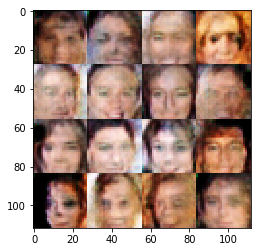

Epoch 1/2... Discriminator Loss: 1.3560... Generator Loss: 0.7284
Epoch 1/2... Discriminator Loss: 1.3549... Generator Loss: 0.7017
Epoch 1/2... Discriminator Loss: 1.1614... Generator Loss: 0.8293
Epoch 1/2... Discriminator Loss: 1.3876... Generator Loss: 0.7816
Epoch 1/2... Discriminator Loss: 1.3585... Generator Loss: 0.7399
Epoch 1/2... Discriminator Loss: 1.3524... Generator Loss: 0.6652
Epoch 1/2... Discriminator Loss: 1.2157... Generator Loss: 0.7924
Epoch 1/2... Discriminator Loss: 1.3698... Generator Loss: 0.8122
Epoch 1/2... Discriminator Loss: 1.3314... Generator Loss: 0.9024
Epoch 1/2... Discriminator Loss: 1.4278... Generator Loss: 1.0616


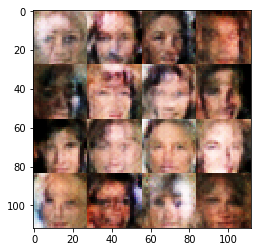

Epoch 1/2... Discriminator Loss: 1.3540... Generator Loss: 0.9526
Epoch 1/2... Discriminator Loss: 1.3684... Generator Loss: 0.8136
Epoch 1/2... Discriminator Loss: 1.3782... Generator Loss: 0.8223
Epoch 1/2... Discriminator Loss: 1.4073... Generator Loss: 0.5869
Epoch 1/2... Discriminator Loss: 1.3415... Generator Loss: 0.9328
Epoch 1/2... Discriminator Loss: 1.3727... Generator Loss: 0.7104
Epoch 1/2... Discriminator Loss: 1.4213... Generator Loss: 0.8172
Epoch 1/2... Discriminator Loss: 1.3124... Generator Loss: 0.7714
Epoch 1/2... Discriminator Loss: 1.3846... Generator Loss: 0.7312
Epoch 1/2... Discriminator Loss: 1.3481... Generator Loss: 0.8843


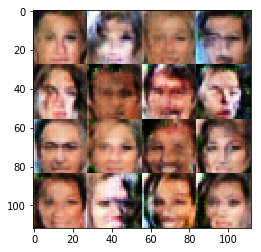

Epoch 1/2... Discriminator Loss: 1.4024... Generator Loss: 0.7960
Epoch 1/2... Discriminator Loss: 1.3340... Generator Loss: 0.7834
Epoch 1/2... Discriminator Loss: 1.3974... Generator Loss: 0.7928
Epoch 1/2... Discriminator Loss: 1.2714... Generator Loss: 0.7319
Epoch 1/2... Discriminator Loss: 1.3366... Generator Loss: 0.8339
Epoch 1/2... Discriminator Loss: 1.3341... Generator Loss: 0.8725
Epoch 1/2... Discriminator Loss: 1.3599... Generator Loss: 0.8712
Epoch 1/2... Discriminator Loss: 1.4589... Generator Loss: 0.5453
Epoch 1/2... Discriminator Loss: 1.4113... Generator Loss: 0.7155
Epoch 1/2... Discriminator Loss: 1.3775... Generator Loss: 0.7800


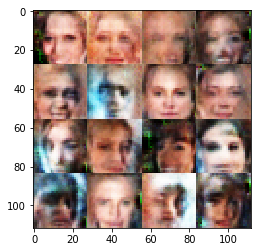

Epoch 1/2... Discriminator Loss: 1.3649... Generator Loss: 0.8412
Epoch 1/2... Discriminator Loss: 1.2947... Generator Loss: 0.6917
Epoch 1/2... Discriminator Loss: 1.3730... Generator Loss: 0.7811
Epoch 1/2... Discriminator Loss: 1.3793... Generator Loss: 0.7275
Epoch 1/2... Discriminator Loss: 1.4129... Generator Loss: 0.7231
Epoch 1/2... Discriminator Loss: 1.5091... Generator Loss: 1.0295
Epoch 1/2... Discriminator Loss: 1.3682... Generator Loss: 0.7368
Epoch 1/2... Discriminator Loss: 1.3503... Generator Loss: 0.8103
Epoch 1/2... Discriminator Loss: 1.3159... Generator Loss: 0.8351
Epoch 1/2... Discriminator Loss: 1.3570... Generator Loss: 0.8489


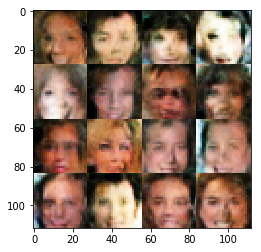

Epoch 1/2... Discriminator Loss: 1.4874... Generator Loss: 0.5117
Epoch 1/2... Discriminator Loss: 1.2137... Generator Loss: 0.9526
Epoch 1/2... Discriminator Loss: 1.4114... Generator Loss: 0.7562
Epoch 1/2... Discriminator Loss: 1.3021... Generator Loss: 0.7203
Epoch 1/2... Discriminator Loss: 1.3338... Generator Loss: 0.8749
Epoch 1/2... Discriminator Loss: 1.3657... Generator Loss: 0.8749
Epoch 1/2... Discriminator Loss: 1.2982... Generator Loss: 0.7509
Epoch 1/2... Discriminator Loss: 1.3422... Generator Loss: 0.7763
Epoch 1/2... Discriminator Loss: 1.4348... Generator Loss: 0.7929
Epoch 1/2... Discriminator Loss: 1.4148... Generator Loss: 0.9829


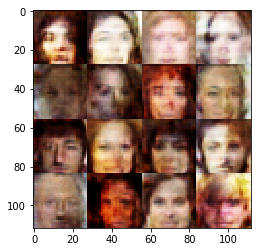

Epoch 1/2... Discriminator Loss: 1.4298... Generator Loss: 0.7228
Epoch 1/2... Discriminator Loss: 1.4462... Generator Loss: 0.8032
Epoch 1/2... Discriminator Loss: 1.4160... Generator Loss: 0.6773
Epoch 1/2... Discriminator Loss: 1.3563... Generator Loss: 0.7574
Epoch 1/2... Discriminator Loss: 1.3899... Generator Loss: 0.6533
Epoch 1/2... Discriminator Loss: 1.3922... Generator Loss: 0.7806
Epoch 1/2... Discriminator Loss: 1.3186... Generator Loss: 0.7503
Epoch 1/2... Discriminator Loss: 1.3747... Generator Loss: 0.8058
Epoch 1/2... Discriminator Loss: 1.3510... Generator Loss: 0.7959
Epoch 1/2... Discriminator Loss: 1.3219... Generator Loss: 0.8210


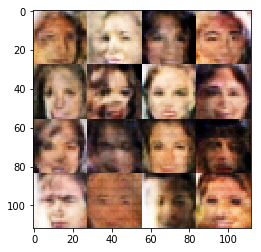

Epoch 1/2... Discriminator Loss: 1.2594... Generator Loss: 0.8807
Epoch 1/2... Discriminator Loss: 1.4094... Generator Loss: 0.8073
Epoch 1/2... Discriminator Loss: 1.3666... Generator Loss: 0.9767
Epoch 1/2... Discriminator Loss: 1.3730... Generator Loss: 0.7045
Epoch 1/2... Discriminator Loss: 1.3951... Generator Loss: 0.7962
Epoch 1/2... Discriminator Loss: 1.4310... Generator Loss: 0.7731
Epoch 1/2... Discriminator Loss: 1.3768... Generator Loss: 0.7754
Epoch 1/2... Discriminator Loss: 1.3264... Generator Loss: 0.8225
Epoch 1/2... Discriminator Loss: 1.3950... Generator Loss: 0.7163
Epoch 1/2... Discriminator Loss: 1.4717... Generator Loss: 0.5800


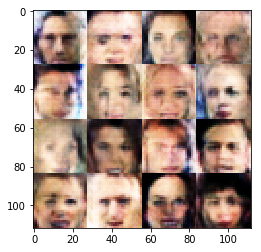

Epoch 1/2... Discriminator Loss: 1.3365... Generator Loss: 0.8779
Epoch 1/2... Discriminator Loss: 1.3308... Generator Loss: 0.7570
Epoch 1/2... Discriminator Loss: 1.3449... Generator Loss: 0.8201
Epoch 1/2... Discriminator Loss: 1.3217... Generator Loss: 0.7029
Epoch 1/2... Discriminator Loss: 1.4049... Generator Loss: 0.7313
Epoch 1/2... Discriminator Loss: 1.3802... Generator Loss: 0.7087
Epoch 1/2... Discriminator Loss: 1.3910... Generator Loss: 0.7947
Epoch 1/2... Discriminator Loss: 1.3434... Generator Loss: 0.7620
Epoch 1/2... Discriminator Loss: 1.3829... Generator Loss: 0.9854
Epoch 1/2... Discriminator Loss: 1.3914... Generator Loss: 0.6768


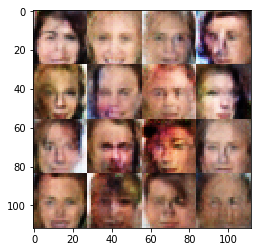

Epoch 1/2... Discriminator Loss: 1.4039... Generator Loss: 0.7669
Epoch 1/2... Discriminator Loss: 1.3904... Generator Loss: 0.7988
Epoch 1/2... Discriminator Loss: 1.3646... Generator Loss: 0.8509
Epoch 1/2... Discriminator Loss: 1.4147... Generator Loss: 0.8696
Epoch 1/2... Discriminator Loss: 1.3721... Generator Loss: 0.8270
Epoch 1/2... Discriminator Loss: 1.4151... Generator Loss: 0.7083
Epoch 1/2... Discriminator Loss: 1.3780... Generator Loss: 0.7259
Epoch 1/2... Discriminator Loss: 1.3380... Generator Loss: 0.8858
Epoch 1/2... Discriminator Loss: 1.3995... Generator Loss: 0.7116
Epoch 1/2... Discriminator Loss: 1.3422... Generator Loss: 0.7458


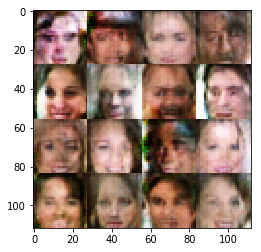

Epoch 1/2... Discriminator Loss: 1.3672... Generator Loss: 0.7441
Epoch 1/2... Discriminator Loss: 1.3507... Generator Loss: 0.8409
Epoch 1/2... Discriminator Loss: 1.3182... Generator Loss: 0.8398
Epoch 1/2... Discriminator Loss: 1.3413... Generator Loss: 0.8531
Epoch 1/2... Discriminator Loss: 1.3470... Generator Loss: 0.7868
Epoch 1/2... Discriminator Loss: 1.3185... Generator Loss: 0.7678
Epoch 1/2... Discriminator Loss: 1.3993... Generator Loss: 0.8492
Epoch 1/2... Discriminator Loss: 1.3498... Generator Loss: 0.7841
Epoch 1/2... Discriminator Loss: 1.3950... Generator Loss: 0.7283
Epoch 1/2... Discriminator Loss: 1.4056... Generator Loss: 0.7876


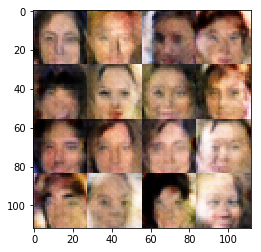

Epoch 1/2... Discriminator Loss: 1.3750... Generator Loss: 0.7567
Epoch 1/2... Discriminator Loss: 1.3584... Generator Loss: 0.7081
Epoch 1/2... Discriminator Loss: 1.4452... Generator Loss: 0.7249
Epoch 1/2... Discriminator Loss: 1.4526... Generator Loss: 0.6931
Epoch 1/2... Discriminator Loss: 1.3796... Generator Loss: 0.8927
Epoch 1/2... Discriminator Loss: 1.4043... Generator Loss: 0.8411
Epoch 1/2... Discriminator Loss: 1.3090... Generator Loss: 0.8046
Epoch 1/2... Discriminator Loss: 1.3019... Generator Loss: 0.7077
Epoch 1/2... Discriminator Loss: 1.4589... Generator Loss: 0.7330
Epoch 1/2... Discriminator Loss: 1.3848... Generator Loss: 0.7089


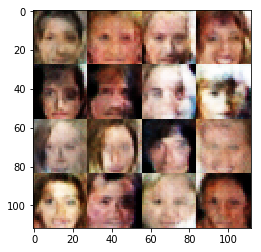

Epoch 1/2... Discriminator Loss: 1.3538... Generator Loss: 0.8674
Epoch 1/2... Discriminator Loss: 1.2649... Generator Loss: 0.8459
Epoch 1/2... Discriminator Loss: 1.3325... Generator Loss: 0.8540
Epoch 1/2... Discriminator Loss: 1.3569... Generator Loss: 0.7700
Epoch 1/2... Discriminator Loss: 1.3239... Generator Loss: 0.7920
Epoch 1/2... Discriminator Loss: 1.3975... Generator Loss: 0.7695
Epoch 1/2... Discriminator Loss: 1.3704... Generator Loss: 0.7545
Epoch 1/2... Discriminator Loss: 1.3104... Generator Loss: 0.7321
Epoch 1/2... Discriminator Loss: 1.4271... Generator Loss: 0.7230
Epoch 1/2... Discriminator Loss: 1.3326... Generator Loss: 0.7554


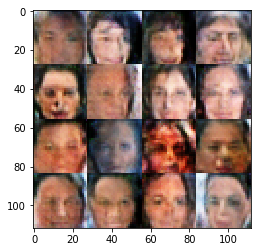

Epoch 1/2... Discriminator Loss: 1.3899... Generator Loss: 0.7930
Epoch 1/2... Discriminator Loss: 1.3782... Generator Loss: 0.8024
Epoch 1/2... Discriminator Loss: 1.3363... Generator Loss: 0.7107
Epoch 1/2... Discriminator Loss: 1.3228... Generator Loss: 0.7888
Epoch 1/2... Discriminator Loss: 1.3634... Generator Loss: 0.7190
Epoch 1/2... Discriminator Loss: 1.3162... Generator Loss: 0.8105
Epoch 1/2... Discriminator Loss: 1.4014... Generator Loss: 0.7580
Epoch 1/2... Discriminator Loss: 1.3441... Generator Loss: 0.8184
Epoch 1/2... Discriminator Loss: 1.4215... Generator Loss: 0.6831
Epoch 1/2... Discriminator Loss: 1.3196... Generator Loss: 0.8783


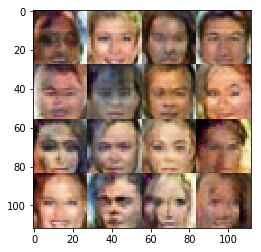

Epoch 1/2... Discriminator Loss: 1.3178... Generator Loss: 0.7247
Epoch 1/2... Discriminator Loss: 1.3387... Generator Loss: 0.7202
Epoch 1/2... Discriminator Loss: 1.3182... Generator Loss: 0.7244
Epoch 1/2... Discriminator Loss: 1.3465... Generator Loss: 0.8119
Epoch 1/2... Discriminator Loss: 1.3603... Generator Loss: 0.7403
Epoch 1/2... Discriminator Loss: 1.3265... Generator Loss: 0.7804
Epoch 1/2... Discriminator Loss: 1.3543... Generator Loss: 0.8092
Epoch 1/2... Discriminator Loss: 1.2946... Generator Loss: 0.8194
Epoch 1/2... Discriminator Loss: 1.3441... Generator Loss: 0.7816
Epoch 1/2... Discriminator Loss: 1.3623... Generator Loss: 0.7428


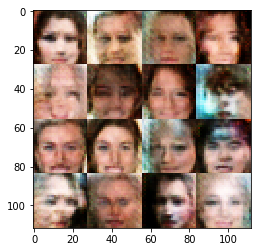

Epoch 1/2... Discriminator Loss: 1.3658... Generator Loss: 0.8363
Epoch 1/2... Discriminator Loss: 1.3394... Generator Loss: 0.7492
Epoch 1/2... Discriminator Loss: 1.3697... Generator Loss: 0.8720
Epoch 1/2... Discriminator Loss: 1.3721... Generator Loss: 0.6717
Epoch 1/2... Discriminator Loss: 1.3719... Generator Loss: 0.7268
Epoch 1/2... Discriminator Loss: 1.3368... Generator Loss: 0.7349
Epoch 1/2... Discriminator Loss: 1.4405... Generator Loss: 0.6244
Epoch 1/2... Discriminator Loss: 1.3491... Generator Loss: 0.8136
Epoch 1/2... Discriminator Loss: 1.3621... Generator Loss: 0.7373
Epoch 1/2... Discriminator Loss: 1.3641... Generator Loss: 0.8432


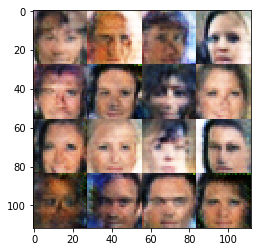

Epoch 1/2... Discriminator Loss: 1.3127... Generator Loss: 0.8689
Epoch 1/2... Discriminator Loss: 1.3298... Generator Loss: 0.7481
Epoch 1/2... Discriminator Loss: 1.4190... Generator Loss: 0.6534
Epoch 1/2... Discriminator Loss: 1.3821... Generator Loss: 0.7194
Epoch 1/2... Discriminator Loss: 1.3945... Generator Loss: 0.7143
Epoch 1/2... Discriminator Loss: 1.3881... Generator Loss: 0.7488
Epoch 1/2... Discriminator Loss: 1.3623... Generator Loss: 0.7003
Epoch 1/2... Discriminator Loss: 1.2986... Generator Loss: 0.7714
Epoch 1/2... Discriminator Loss: 1.4157... Generator Loss: 0.6372
Epoch 1/2... Discriminator Loss: 1.3253... Generator Loss: 0.7190


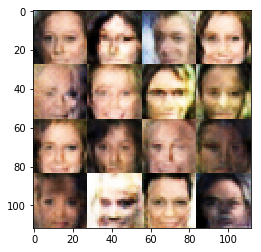

Epoch 1/2... Discriminator Loss: 1.2701... Generator Loss: 0.7750
Epoch 1/2... Discriminator Loss: 1.3578... Generator Loss: 0.9557
Epoch 1/2... Discriminator Loss: 1.3984... Generator Loss: 0.6487
Epoch 1/2... Discriminator Loss: 1.3164... Generator Loss: 0.9031
Epoch 1/2... Discriminator Loss: 1.3598... Generator Loss: 0.8164
Epoch 1/2... Discriminator Loss: 1.3990... Generator Loss: 0.7499
Epoch 1/2... Discriminator Loss: 1.3467... Generator Loss: 0.8546
Epoch 1/2... Discriminator Loss: 1.3214... Generator Loss: 0.7936
Epoch 1/2... Discriminator Loss: 1.3661... Generator Loss: 0.8470
Epoch 1/2... Discriminator Loss: 1.4487... Generator Loss: 0.6936


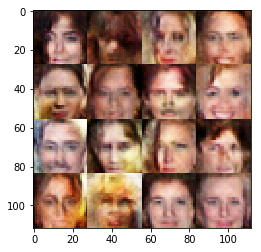

Epoch 1/2... Discriminator Loss: 1.3168... Generator Loss: 0.8416
Epoch 1/2... Discriminator Loss: 1.3627... Generator Loss: 0.8105
Epoch 1/2... Discriminator Loss: 1.3769... Generator Loss: 0.6989
Epoch 1/2... Discriminator Loss: 1.3334... Generator Loss: 0.8775
Epoch 1/2... Discriminator Loss: 1.3236... Generator Loss: 0.8156
Epoch 1/2... Discriminator Loss: 1.3525... Generator Loss: 0.7910
Epoch 1/2... Discriminator Loss: 1.4215... Generator Loss: 0.7445
Epoch 1/2... Discriminator Loss: 1.3724... Generator Loss: 0.8881
Epoch 1/2... Discriminator Loss: 1.4640... Generator Loss: 0.7671
Epoch 1/2... Discriminator Loss: 1.4174... Generator Loss: 0.7217


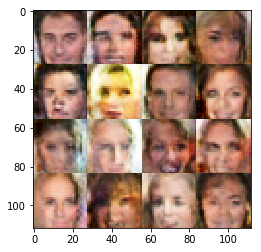

Epoch 1/2... Discriminator Loss: 1.3198... Generator Loss: 0.7932
Epoch 1/2... Discriminator Loss: 1.3827... Generator Loss: 0.7487
Epoch 1/2... Discriminator Loss: 1.3912... Generator Loss: 0.6371
Epoch 1/2... Discriminator Loss: 1.4099... Generator Loss: 0.7564
Epoch 1/2... Discriminator Loss: 1.3690... Generator Loss: 0.7931
Epoch 1/2... Discriminator Loss: 1.3537... Generator Loss: 0.7545
Epoch 1/2... Discriminator Loss: 1.3921... Generator Loss: 0.7483
Epoch 1/2... Discriminator Loss: 1.3723... Generator Loss: 0.7423
Epoch 1/2... Discriminator Loss: 1.3447... Generator Loss: 0.7456
Epoch 1/2... Discriminator Loss: 1.3692... Generator Loss: 0.7537


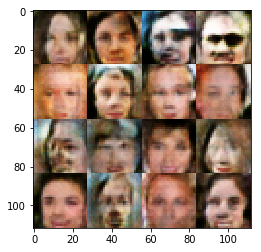

Epoch 1/2... Discriminator Loss: 1.3599... Generator Loss: 0.7272
Epoch 1/2... Discriminator Loss: 1.3706... Generator Loss: 0.8597
Epoch 1/2... Discriminator Loss: 1.3258... Generator Loss: 0.7715
Epoch 1/2... Discriminator Loss: 1.3432... Generator Loss: 0.8219
Epoch 1/2... Discriminator Loss: 1.3723... Generator Loss: 0.7886
Epoch 1/2... Discriminator Loss: 1.3307... Generator Loss: 0.7742
Epoch 1/2... Discriminator Loss: 1.3688... Generator Loss: 0.8216
Epoch 1/2... Discriminator Loss: 1.3438... Generator Loss: 0.6714
Epoch 1/2... Discriminator Loss: 1.3898... Generator Loss: 0.7209
Epoch 1/2... Discriminator Loss: 1.3788... Generator Loss: 0.6667


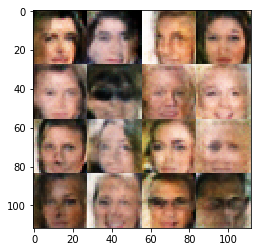

Epoch 1/2... Discriminator Loss: 1.3737... Generator Loss: 0.7799
Epoch 1/2... Discriminator Loss: 1.3378... Generator Loss: 0.6955
Epoch 1/2... Discriminator Loss: 1.4613... Generator Loss: 0.6573
Epoch 1/2... Discriminator Loss: 1.3983... Generator Loss: 0.8070
Epoch 1/2... Discriminator Loss: 1.4117... Generator Loss: 0.6135
Epoch 1/2... Discriminator Loss: 1.4309... Generator Loss: 0.8003
Epoch 1/2... Discriminator Loss: 1.4260... Generator Loss: 0.6929
Epoch 1/2... Discriminator Loss: 1.3405... Generator Loss: 0.7231
Epoch 1/2... Discriminator Loss: 1.4269... Generator Loss: 0.7960
Epoch 1/2... Discriminator Loss: 1.3535... Generator Loss: 0.7900


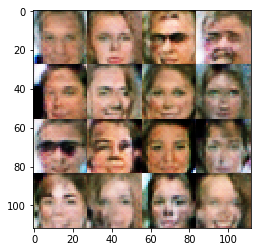

Epoch 1/2... Discriminator Loss: 1.4002... Generator Loss: 0.7926
Epoch 1/2... Discriminator Loss: 1.4186... Generator Loss: 0.6843
Epoch 1/2... Discriminator Loss: 1.2875... Generator Loss: 0.7937
Epoch 1/2... Discriminator Loss: 1.3444... Generator Loss: 0.8281
Epoch 1/2... Discriminator Loss: 1.3325... Generator Loss: 0.7217
Epoch 1/2... Discriminator Loss: 1.4171... Generator Loss: 0.7807
Epoch 1/2... Discriminator Loss: 1.3474... Generator Loss: 0.8460
Epoch 1/2... Discriminator Loss: 1.3699... Generator Loss: 0.6967
Epoch 1/2... Discriminator Loss: 1.3656... Generator Loss: 0.7875
Epoch 1/2... Discriminator Loss: 1.3426... Generator Loss: 0.7354


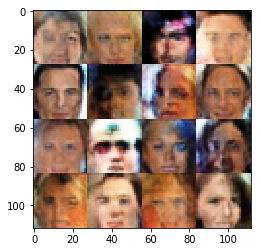

Epoch 1/2... Discriminator Loss: 1.3708... Generator Loss: 0.7995
Epoch 1/2... Discriminator Loss: 1.2894... Generator Loss: 0.8950
Epoch 1/2... Discriminator Loss: 1.3531... Generator Loss: 0.7363
Epoch 1/2... Discriminator Loss: 1.3131... Generator Loss: 0.8614
Epoch 1/2... Discriminator Loss: 1.3931... Generator Loss: 0.7791
Epoch 1/2... Discriminator Loss: 1.3165... Generator Loss: 1.0621
Epoch 1/2... Discriminator Loss: 1.3370... Generator Loss: 0.8273
Epoch 1/2... Discriminator Loss: 1.4515... Generator Loss: 0.7174
Epoch 1/2... Discriminator Loss: 1.3989... Generator Loss: 0.7932
Epoch 1/2... Discriminator Loss: 1.3241... Generator Loss: 0.8070


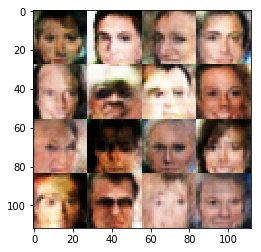

Epoch 1/2... Discriminator Loss: 1.3987... Generator Loss: 0.8755
Epoch 1/2... Discriminator Loss: 1.3742... Generator Loss: 0.8146
Epoch 1/2... Discriminator Loss: 1.3547... Generator Loss: 0.7582
Epoch 1/2... Discriminator Loss: 1.3990... Generator Loss: 0.6890
Epoch 1/2... Discriminator Loss: 1.3448... Generator Loss: 0.7530
Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.7698
Epoch 1/2... Discriminator Loss: 1.3538... Generator Loss: 0.8385
Epoch 1/2... Discriminator Loss: 1.3874... Generator Loss: 0.8090
Epoch 1/2... Discriminator Loss: 1.3707... Generator Loss: 0.7583
Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.6913


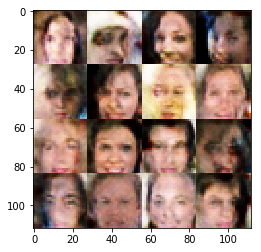

Epoch 1/2... Discriminator Loss: 1.3974... Generator Loss: 0.8233
Epoch 1/2... Discriminator Loss: 1.3214... Generator Loss: 0.7495
Epoch 1/2... Discriminator Loss: 1.3683... Generator Loss: 0.6810
Epoch 1/2... Discriminator Loss: 1.3453... Generator Loss: 0.7569
Epoch 1/2... Discriminator Loss: 1.3818... Generator Loss: 0.8435
Epoch 1/2... Discriminator Loss: 1.3209... Generator Loss: 0.8373
Epoch 1/2... Discriminator Loss: 1.3742... Generator Loss: 0.7556
Epoch 1/2... Discriminator Loss: 1.2793... Generator Loss: 0.9104
Epoch 1/2... Discriminator Loss: 1.3608... Generator Loss: 0.7927
Epoch 1/2... Discriminator Loss: 1.2463... Generator Loss: 0.9192


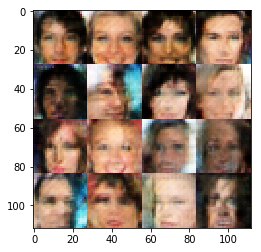

Epoch 1/2... Discriminator Loss: 1.3375... Generator Loss: 0.8371
Epoch 1/2... Discriminator Loss: 1.3487... Generator Loss: 0.7334
Epoch 1/2... Discriminator Loss: 1.3023... Generator Loss: 0.7254
Epoch 1/2... Discriminator Loss: 1.3575... Generator Loss: 0.7860
Epoch 1/2... Discriminator Loss: 1.3019... Generator Loss: 0.7087
Epoch 1/2... Discriminator Loss: 1.3223... Generator Loss: 0.7462
Epoch 1/2... Discriminator Loss: 1.3664... Generator Loss: 0.7362
Epoch 1/2... Discriminator Loss: 1.3958... Generator Loss: 0.7113
Epoch 1/2... Discriminator Loss: 1.3506... Generator Loss: 0.7977
Epoch 1/2... Discriminator Loss: 1.3580... Generator Loss: 0.7508


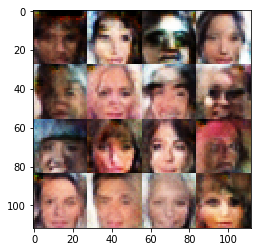

Epoch 1/2... Discriminator Loss: 1.3190... Generator Loss: 0.8483
Epoch 1/2... Discriminator Loss: 1.3879... Generator Loss: 0.7910
Epoch 1/2... Discriminator Loss: 1.3491... Generator Loss: 0.6496
Epoch 1/2... Discriminator Loss: 1.3692... Generator Loss: 0.8069
Epoch 1/2... Discriminator Loss: 1.3903... Generator Loss: 0.8003
Epoch 1/2... Discriminator Loss: 1.4209... Generator Loss: 0.6053
Epoch 1/2... Discriminator Loss: 1.4129... Generator Loss: 0.7832
Epoch 1/2... Discriminator Loss: 1.3879... Generator Loss: 0.7054
Epoch 1/2... Discriminator Loss: 1.4157... Generator Loss: 0.7651
Epoch 1/2... Discriminator Loss: 1.3835... Generator Loss: 0.7350


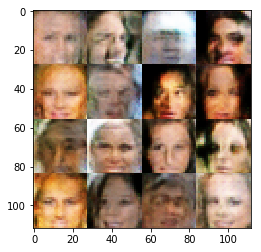

Epoch 1/2... Discriminator Loss: 1.3316... Generator Loss: 0.7680
Epoch 1/2... Discriminator Loss: 1.3375... Generator Loss: 0.7400
Epoch 1/2... Discriminator Loss: 1.3743... Generator Loss: 0.8120
Epoch 1/2... Discriminator Loss: 1.3369... Generator Loss: 0.7877
Epoch 1/2... Discriminator Loss: 1.4083... Generator Loss: 0.8340
Epoch 1/2... Discriminator Loss: 1.4095... Generator Loss: 0.8735
Epoch 1/2... Discriminator Loss: 1.3689... Generator Loss: 0.7349
Epoch 1/2... Discriminator Loss: 1.3235... Generator Loss: 0.7238
Epoch 1/2... Discriminator Loss: 1.3286... Generator Loss: 0.7904
Epoch 1/2... Discriminator Loss: 1.3266... Generator Loss: 0.8469


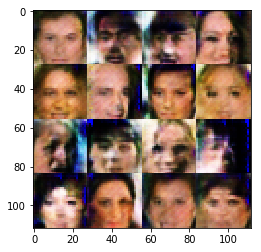

Epoch 1/2... Discriminator Loss: 1.3752... Generator Loss: 0.7424
Epoch 1/2... Discriminator Loss: 1.3681... Generator Loss: 0.8178
Epoch 1/2... Discriminator Loss: 1.3942... Generator Loss: 0.7962
Epoch 1/2... Discriminator Loss: 1.3726... Generator Loss: 0.7916
Epoch 1/2... Discriminator Loss: 1.3561... Generator Loss: 0.7571
Epoch 1/2... Discriminator Loss: 1.3903... Generator Loss: 0.7524
Epoch 1/2... Discriminator Loss: 1.3247... Generator Loss: 0.7299
Epoch 1/2... Discriminator Loss: 1.3834... Generator Loss: 0.7875
Epoch 1/2... Discriminator Loss: 1.4005... Generator Loss: 0.7511
Epoch 1/2... Discriminator Loss: 1.3733... Generator Loss: 0.7559


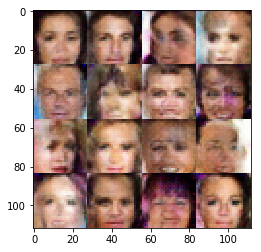

Epoch 1/2... Discriminator Loss: 1.3409... Generator Loss: 0.8122
Epoch 1/2... Discriminator Loss: 1.3720... Generator Loss: 0.8571
Epoch 1/2... Discriminator Loss: 1.3896... Generator Loss: 0.7992
Epoch 1/2... Discriminator Loss: 1.3374... Generator Loss: 0.8332
Epoch 1/2... Discriminator Loss: 1.3384... Generator Loss: 0.7474
Epoch 1/2... Discriminator Loss: 1.4002... Generator Loss: 0.7839
Epoch 1/2... Discriminator Loss: 1.3684... Generator Loss: 0.7171
Epoch 1/2... Discriminator Loss: 1.3328... Generator Loss: 0.9392
Epoch 1/2... Discriminator Loss: 1.3340... Generator Loss: 0.7814
Epoch 1/2... Discriminator Loss: 1.3344... Generator Loss: 0.7659


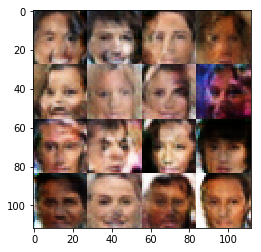

Epoch 1/2... Discriminator Loss: 1.4155... Generator Loss: 0.7268
Epoch 1/2... Discriminator Loss: 1.3193... Generator Loss: 0.8270
Epoch 1/2... Discriminator Loss: 1.3431... Generator Loss: 0.8110
Epoch 1/2... Discriminator Loss: 1.3486... Generator Loss: 0.7736
Epoch 1/2... Discriminator Loss: 1.3768... Generator Loss: 0.7367
Epoch 1/2... Discriminator Loss: 1.3951... Generator Loss: 0.8005
Epoch 1/2... Discriminator Loss: 1.4012... Generator Loss: 0.7350
Epoch 1/2... Discriminator Loss: 1.4071... Generator Loss: 0.7979
Epoch 1/2... Discriminator Loss: 1.3626... Generator Loss: 0.8052
Epoch 1/2... Discriminator Loss: 1.3784... Generator Loss: 0.7078


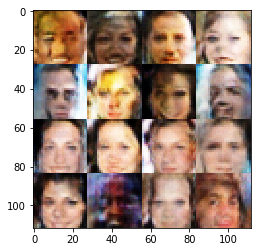

Epoch 1/2... Discriminator Loss: 1.3532... Generator Loss: 0.8979
Epoch 1/2... Discriminator Loss: 1.4009... Generator Loss: 0.7386
Epoch 1/2... Discriminator Loss: 1.3632... Generator Loss: 0.7401
Epoch 1/2... Discriminator Loss: 1.4016... Generator Loss: 0.8259
Epoch 1/2... Discriminator Loss: 1.3345... Generator Loss: 0.7969
Epoch 1/2... Discriminator Loss: 1.3803... Generator Loss: 0.7594
Epoch 1/2... Discriminator Loss: 1.3917... Generator Loss: 0.7593
Epoch 1/2... Discriminator Loss: 1.3745... Generator Loss: 0.7258
Epoch 1/2... Discriminator Loss: 1.3474... Generator Loss: 0.7700
Epoch 1/2... Discriminator Loss: 1.3167... Generator Loss: 0.8023


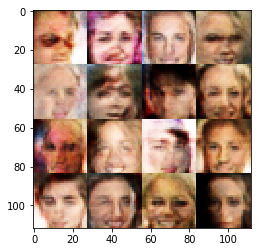

Epoch 1/2... Discriminator Loss: 1.3985... Generator Loss: 0.7774
Epoch 1/2... Discriminator Loss: 1.3859... Generator Loss: 0.8057
Epoch 1/2... Discriminator Loss: 1.3922... Generator Loss: 0.7809
Epoch 1/2... Discriminator Loss: 1.3946... Generator Loss: 0.7515
Epoch 1/2... Discriminator Loss: 1.3557... Generator Loss: 0.8105
Epoch 1/2... Discriminator Loss: 1.3578... Generator Loss: 0.7053
Epoch 1/2... Discriminator Loss: 1.3871... Generator Loss: 0.8577
Epoch 1/2... Discriminator Loss: 1.3224... Generator Loss: 0.7923
Epoch 1/2... Discriminator Loss: 1.3675... Generator Loss: 0.8390
Epoch 1/2... Discriminator Loss: 1.3665... Generator Loss: 0.7331


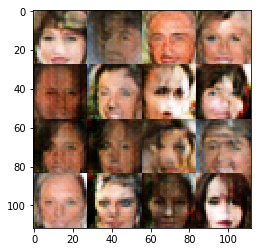

Epoch 1/2... Discriminator Loss: 1.3890... Generator Loss: 0.7573
Epoch 1/2... Discriminator Loss: 1.3469... Generator Loss: 0.7708
Epoch 1/2... Discriminator Loss: 1.4092... Generator Loss: 0.7743
Epoch 1/2... Discriminator Loss: 1.3454... Generator Loss: 0.7463
Epoch 1/2... Discriminator Loss: 1.3957... Generator Loss: 0.7931
Epoch 1/2... Discriminator Loss: 1.4804... Generator Loss: 0.8100
Epoch 1/2... Discriminator Loss: 1.3787... Generator Loss: 0.8650
Epoch 1/2... Discriminator Loss: 1.2932... Generator Loss: 0.8307
Epoch 1/2... Discriminator Loss: 1.3066... Generator Loss: 0.7959
Epoch 1/2... Discriminator Loss: 1.2772... Generator Loss: 0.8261


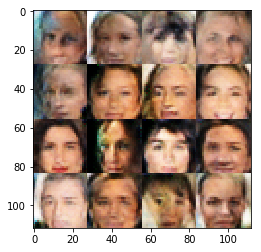

Epoch 1/2... Discriminator Loss: 1.3288... Generator Loss: 0.8062
Epoch 1/2... Discriminator Loss: 1.3595... Generator Loss: 0.7162
Epoch 1/2... Discriminator Loss: 1.3846... Generator Loss: 0.7403
Epoch 1/2... Discriminator Loss: 1.3789... Generator Loss: 0.7818
Epoch 1/2... Discriminator Loss: 1.3600... Generator Loss: 0.8179
Epoch 1/2... Discriminator Loss: 1.3761... Generator Loss: 0.7040
Epoch 1/2... Discriminator Loss: 1.3616... Generator Loss: 0.7994
Epoch 1/2... Discriminator Loss: 1.3316... Generator Loss: 0.7607
Epoch 1/2... Discriminator Loss: 1.4001... Generator Loss: 0.8819
Epoch 1/2... Discriminator Loss: 1.3222... Generator Loss: 0.8276


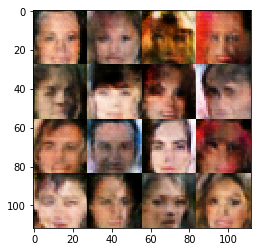

Epoch 1/2... Discriminator Loss: 1.3854... Generator Loss: 0.7287
Epoch 1/2... Discriminator Loss: 1.3840... Generator Loss: 0.7023
Epoch 1/2... Discriminator Loss: 1.2944... Generator Loss: 0.7385
Epoch 2/2... Discriminator Loss: 1.3679... Generator Loss: 0.7866
Epoch 2/2... Discriminator Loss: 1.4056... Generator Loss: 0.7220
Epoch 2/2... Discriminator Loss: 1.3523... Generator Loss: 0.7797
Epoch 2/2... Discriminator Loss: 1.4021... Generator Loss: 0.8145
Epoch 2/2... Discriminator Loss: 1.3505... Generator Loss: 0.7787
Epoch 2/2... Discriminator Loss: 1.3355... Generator Loss: 0.8264
Epoch 2/2... Discriminator Loss: 1.3985... Generator Loss: 0.7608


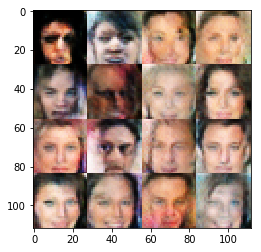

Epoch 2/2... Discriminator Loss: 1.3369... Generator Loss: 0.7759
Epoch 2/2... Discriminator Loss: 1.3927... Generator Loss: 0.7351
Epoch 2/2... Discriminator Loss: 1.4020... Generator Loss: 0.7579
Epoch 2/2... Discriminator Loss: 1.3704... Generator Loss: 0.8049
Epoch 2/2... Discriminator Loss: 1.3897... Generator Loss: 0.7480
Epoch 2/2... Discriminator Loss: 1.3920... Generator Loss: 0.7250
Epoch 2/2... Discriminator Loss: 1.3870... Generator Loss: 0.7500
Epoch 2/2... Discriminator Loss: 1.3336... Generator Loss: 0.7723
Epoch 2/2... Discriminator Loss: 1.3356... Generator Loss: 0.7704
Epoch 2/2... Discriminator Loss: 1.3449... Generator Loss: 0.7804


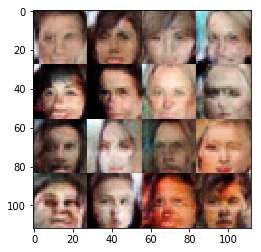

Epoch 2/2... Discriminator Loss: 1.3282... Generator Loss: 0.8397
Epoch 2/2... Discriminator Loss: 1.3420... Generator Loss: 0.7192
Epoch 2/2... Discriminator Loss: 1.3894... Generator Loss: 0.8043
Epoch 2/2... Discriminator Loss: 1.3575... Generator Loss: 0.7673
Epoch 2/2... Discriminator Loss: 1.3438... Generator Loss: 0.8189
Epoch 2/2... Discriminator Loss: 1.3896... Generator Loss: 0.8513
Epoch 2/2... Discriminator Loss: 1.3609... Generator Loss: 0.7804
Epoch 2/2... Discriminator Loss: 1.3870... Generator Loss: 0.8090
Epoch 2/2... Discriminator Loss: 1.3788... Generator Loss: 0.8394
Epoch 2/2... Discriminator Loss: 1.3639... Generator Loss: 0.7686


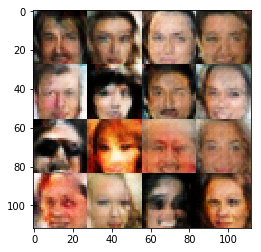

Epoch 2/2... Discriminator Loss: 1.3868... Generator Loss: 0.8308
Epoch 2/2... Discriminator Loss: 1.3981... Generator Loss: 0.8047
Epoch 2/2... Discriminator Loss: 1.3549... Generator Loss: 0.8277
Epoch 2/2... Discriminator Loss: 1.2951... Generator Loss: 0.7691
Epoch 2/2... Discriminator Loss: 1.3695... Generator Loss: 0.7875
Epoch 2/2... Discriminator Loss: 1.3492... Generator Loss: 0.7425
Epoch 2/2... Discriminator Loss: 1.4200... Generator Loss: 0.7604
Epoch 2/2... Discriminator Loss: 1.3509... Generator Loss: 0.8110
Epoch 2/2... Discriminator Loss: 1.4138... Generator Loss: 0.7872
Epoch 2/2... Discriminator Loss: 1.3783... Generator Loss: 0.8331


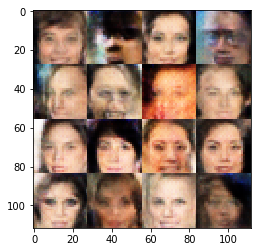

Epoch 2/2... Discriminator Loss: 1.3837... Generator Loss: 0.7504
Epoch 2/2... Discriminator Loss: 1.3804... Generator Loss: 0.7474
Epoch 2/2... Discriminator Loss: 1.3601... Generator Loss: 0.7863
Epoch 2/2... Discriminator Loss: 1.3450... Generator Loss: 0.8392
Epoch 2/2... Discriminator Loss: 1.3433... Generator Loss: 0.7872
Epoch 2/2... Discriminator Loss: 1.3803... Generator Loss: 0.7685
Epoch 2/2... Discriminator Loss: 1.3825... Generator Loss: 0.7778
Epoch 2/2... Discriminator Loss: 1.3214... Generator Loss: 0.7225
Epoch 2/2... Discriminator Loss: 1.3696... Generator Loss: 0.7927
Epoch 2/2... Discriminator Loss: 1.3445... Generator Loss: 0.7430


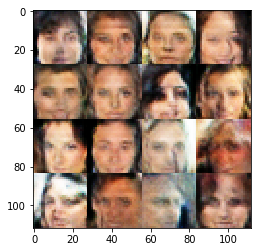

Epoch 2/2... Discriminator Loss: 1.3988... Generator Loss: 0.7890
Epoch 2/2... Discriminator Loss: 1.3992... Generator Loss: 0.7475
Epoch 2/2... Discriminator Loss: 1.3935... Generator Loss: 0.7485
Epoch 2/2... Discriminator Loss: 1.3970... Generator Loss: 0.8076
Epoch 2/2... Discriminator Loss: 1.4054... Generator Loss: 0.7481
Epoch 2/2... Discriminator Loss: 1.3799... Generator Loss: 0.7555
Epoch 2/2... Discriminator Loss: 1.4017... Generator Loss: 0.7957
Epoch 2/2... Discriminator Loss: 1.3813... Generator Loss: 0.7543
Epoch 2/2... Discriminator Loss: 1.3670... Generator Loss: 0.7364
Epoch 2/2... Discriminator Loss: 1.3981... Generator Loss: 0.7149


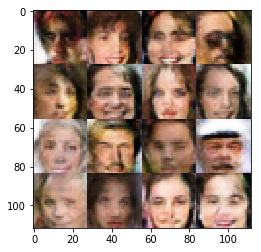

Epoch 2/2... Discriminator Loss: 1.2975... Generator Loss: 0.8077
Epoch 2/2... Discriminator Loss: 1.3695... Generator Loss: 0.7780
Epoch 2/2... Discriminator Loss: 1.3739... Generator Loss: 0.7191


KeyboardInterrupt: 

In [16]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Epoch 1/2... Discriminator Loss: 0.5675... Generator Loss: 15.5801
Epoch 1/2... Discriminator Loss: 2.7110... Generator Loss: 5.0374
Epoch 1/2... Discriminator Loss: 4.8705... Generator Loss: 0.0644
Epoch 1/2... Discriminator Loss: 1.4928... Generator Loss: 2.3555
Epoch 1/2... Discriminator Loss: 2.3351... Generator Loss: 2.7077
Epoch 1/2... Discriminator Loss: 1.8462... Generator Loss: 2.7871
Epoch 1/2... Discriminator Loss: 0.9796... Generator Loss: 1.7096
Epoch 1/2... Discriminator Loss: 1.0846... Generator Loss: 2.5849
Epoch 1/2... Discriminator Loss: 2.9050... Generator Loss: 0.1248
Epoch 1/2... Discriminator Loss: 0.8685... Generator Loss: 1.0832


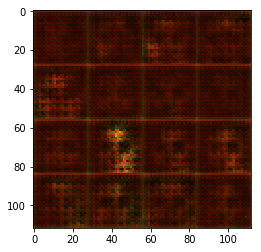

Epoch 1/2... Discriminator Loss: 0.5902... Generator Loss: 1.6195
Epoch 1/2... Discriminator Loss: 0.6895... Generator Loss: 2.1254
Epoch 1/2... Discriminator Loss: 0.7149... Generator Loss: 1.5473
Epoch 1/2... Discriminator Loss: 1.6361... Generator Loss: 2.1591
Epoch 1/2... Discriminator Loss: 1.6564... Generator Loss: 0.3892
Epoch 1/2... Discriminator Loss: 1.3357... Generator Loss: 0.6730
Epoch 1/2... Discriminator Loss: 1.0974... Generator Loss: 1.8277
Epoch 1/2... Discriminator Loss: 1.8530... Generator Loss: 0.5033
Epoch 1/2... Discriminator Loss: 1.2391... Generator Loss: 0.8451
Epoch 1/2... Discriminator Loss: 1.6802... Generator Loss: 0.5640


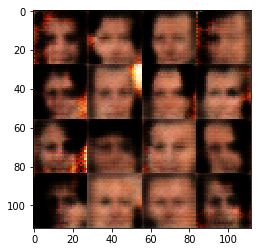

Epoch 1/2... Discriminator Loss: 0.6223... Generator Loss: 1.5565
Epoch 1/2... Discriminator Loss: 2.3627... Generator Loss: 0.3045
Epoch 1/2... Discriminator Loss: 1.3455... Generator Loss: 0.8911
Epoch 1/2... Discriminator Loss: 1.5775... Generator Loss: 0.6267
Epoch 1/2... Discriminator Loss: 1.3449... Generator Loss: 1.8045
Epoch 1/2... Discriminator Loss: 0.9559... Generator Loss: 0.9568
Epoch 1/2... Discriminator Loss: 1.3221... Generator Loss: 0.8378
Epoch 1/2... Discriminator Loss: 1.5676... Generator Loss: 0.6504
Epoch 1/2... Discriminator Loss: 1.4271... Generator Loss: 1.2653
Epoch 1/2... Discriminator Loss: 1.5670... Generator Loss: 0.9777


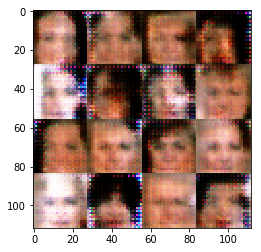

Epoch 1/2... Discriminator Loss: 1.7322... Generator Loss: 0.5342
Epoch 1/2... Discriminator Loss: 2.0680... Generator Loss: 0.3621
Epoch 1/2... Discriminator Loss: 1.5544... Generator Loss: 0.9483
Epoch 1/2... Discriminator Loss: 1.3074... Generator Loss: 0.7240
Epoch 1/2... Discriminator Loss: 1.2485... Generator Loss: 0.7411
Epoch 1/2... Discriminator Loss: 1.2285... Generator Loss: 0.9160
Epoch 1/2... Discriminator Loss: 1.3881... Generator Loss: 0.5768
Epoch 1/2... Discriminator Loss: 1.6308... Generator Loss: 0.9946
Epoch 1/2... Discriminator Loss: 1.1517... Generator Loss: 1.0792
Epoch 1/2... Discriminator Loss: 1.2953... Generator Loss: 0.5210


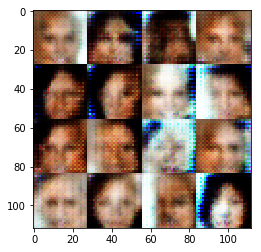

Epoch 1/2... Discriminator Loss: 1.5931... Generator Loss: 0.7604
Epoch 1/2... Discriminator Loss: 1.4537... Generator Loss: 0.6698
Epoch 1/2... Discriminator Loss: 1.5201... Generator Loss: 0.6936
Epoch 1/2... Discriminator Loss: 1.5688... Generator Loss: 0.7550
Epoch 1/2... Discriminator Loss: 1.1569... Generator Loss: 0.9013
Epoch 1/2... Discriminator Loss: 1.4506... Generator Loss: 0.5527
Epoch 1/2... Discriminator Loss: 1.4348... Generator Loss: 0.9927
Epoch 1/2... Discriminator Loss: 1.4547... Generator Loss: 0.5993
Epoch 1/2... Discriminator Loss: 1.3788... Generator Loss: 1.0860
Epoch 1/2... Discriminator Loss: 1.5286... Generator Loss: 0.5522


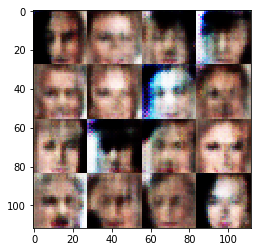

Epoch 1/2... Discriminator Loss: 1.1793... Generator Loss: 0.6889
Epoch 1/2... Discriminator Loss: 1.0319... Generator Loss: 1.0701
Epoch 1/2... Discriminator Loss: 1.3454... Generator Loss: 0.9401
Epoch 1/2... Discriminator Loss: 1.2949... Generator Loss: 1.6419
Epoch 1/2... Discriminator Loss: 1.4743... Generator Loss: 0.8071
Epoch 1/2... Discriminator Loss: 1.4370... Generator Loss: 1.3788
Epoch 1/2... Discriminator Loss: 1.3610... Generator Loss: 0.7119
Epoch 1/2... Discriminator Loss: 1.6114... Generator Loss: 1.5782
Epoch 1/2... Discriminator Loss: 1.5801... Generator Loss: 0.7973
Epoch 1/2... Discriminator Loss: 1.3670... Generator Loss: 0.5259


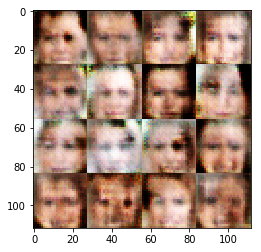

Epoch 1/2... Discriminator Loss: 1.2818... Generator Loss: 0.5838
Epoch 1/2... Discriminator Loss: 1.7269... Generator Loss: 0.7662
Epoch 1/2... Discriminator Loss: 1.3262... Generator Loss: 0.6610
Epoch 1/2... Discriminator Loss: 1.4133... Generator Loss: 0.6461
Epoch 1/2... Discriminator Loss: 1.4284... Generator Loss: 0.5123
Epoch 1/2... Discriminator Loss: 1.4586... Generator Loss: 0.7028
Epoch 1/2... Discriminator Loss: 1.3939... Generator Loss: 1.3144
Epoch 1/2... Discriminator Loss: 1.2436... Generator Loss: 0.9785
Epoch 1/2... Discriminator Loss: 1.2642... Generator Loss: 0.9559
Epoch 1/2... Discriminator Loss: 1.1164... Generator Loss: 1.2600


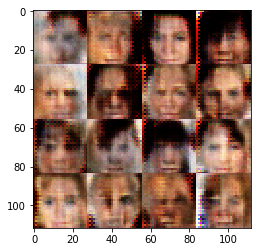

Epoch 1/2... Discriminator Loss: 1.3774... Generator Loss: 0.9616
Epoch 1/2... Discriminator Loss: 1.3989... Generator Loss: 0.7037
Epoch 1/2... Discriminator Loss: 1.1737... Generator Loss: 0.6201
Epoch 1/2... Discriminator Loss: 1.3224... Generator Loss: 1.1705
Epoch 1/2... Discriminator Loss: 1.4182... Generator Loss: 1.4305
Epoch 1/2... Discriminator Loss: 1.4879... Generator Loss: 0.6920
Epoch 1/2... Discriminator Loss: 1.3787... Generator Loss: 0.4832
Epoch 1/2... Discriminator Loss: 1.3522... Generator Loss: 0.6703
Epoch 1/2... Discriminator Loss: 1.3690... Generator Loss: 0.9433
Epoch 1/2... Discriminator Loss: 1.3746... Generator Loss: 0.7241


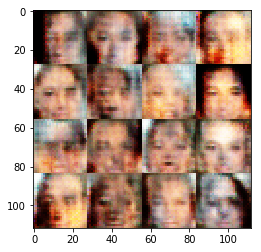

Epoch 1/2... Discriminator Loss: 1.3792... Generator Loss: 0.8301
Epoch 1/2... Discriminator Loss: 1.4481... Generator Loss: 0.7604
Epoch 1/2... Discriminator Loss: 1.4482... Generator Loss: 0.7274
Epoch 1/2... Discriminator Loss: 1.4084... Generator Loss: 0.5873
Epoch 1/2... Discriminator Loss: 1.1728... Generator Loss: 0.8538
Epoch 1/2... Discriminator Loss: 0.9287... Generator Loss: 1.7442
Epoch 1/2... Discriminator Loss: 1.1125... Generator Loss: 0.8542
Epoch 1/2... Discriminator Loss: 1.5204... Generator Loss: 0.8937
Epoch 1/2... Discriminator Loss: 1.2981... Generator Loss: 0.8008
Epoch 1/2... Discriminator Loss: 1.5301... Generator Loss: 0.6083


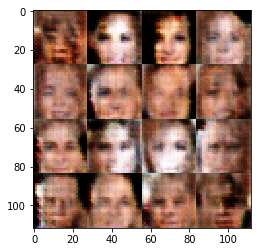

Epoch 1/2... Discriminator Loss: 1.4003... Generator Loss: 0.6683
Epoch 1/2... Discriminator Loss: 1.3284... Generator Loss: 0.8434
Epoch 1/2... Discriminator Loss: 1.5851... Generator Loss: 0.3949
Epoch 1/2... Discriminator Loss: 1.2549... Generator Loss: 1.1785
Epoch 1/2... Discriminator Loss: 1.1722... Generator Loss: 0.9555
Epoch 1/2... Discriminator Loss: 1.3532... Generator Loss: 0.9718
Epoch 1/2... Discriminator Loss: 1.4313... Generator Loss: 0.6084
Epoch 1/2... Discriminator Loss: 1.4426... Generator Loss: 0.6558
Epoch 1/2... Discriminator Loss: 1.1309... Generator Loss: 0.7201
Epoch 1/2... Discriminator Loss: 1.3340... Generator Loss: 0.9320


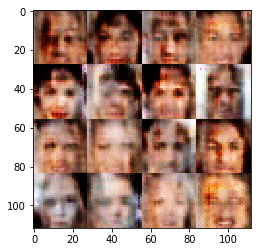

Epoch 1/2... Discriminator Loss: 1.6941... Generator Loss: 0.4563
Epoch 1/2... Discriminator Loss: 1.2866... Generator Loss: 0.8462
Epoch 1/2... Discriminator Loss: 1.2995... Generator Loss: 1.1832
Epoch 1/2... Discriminator Loss: 1.4670... Generator Loss: 0.8115
Epoch 1/2... Discriminator Loss: 1.1735... Generator Loss: 0.7298
Epoch 1/2... Discriminator Loss: 1.3099... Generator Loss: 0.7942
Epoch 1/2... Discriminator Loss: 1.3352... Generator Loss: 0.5880
Epoch 1/2... Discriminator Loss: 1.2521... Generator Loss: 0.5706
Epoch 1/2... Discriminator Loss: 1.3359... Generator Loss: 1.1997
Epoch 1/2... Discriminator Loss: 1.0796... Generator Loss: 0.7062


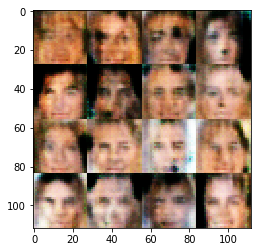

Epoch 1/2... Discriminator Loss: 1.2558... Generator Loss: 0.8470
Epoch 1/2... Discriminator Loss: 1.5096... Generator Loss: 0.4504
Epoch 1/2... Discriminator Loss: 1.2531... Generator Loss: 0.9614
Epoch 1/2... Discriminator Loss: 1.1658... Generator Loss: 1.2545
Epoch 1/2... Discriminator Loss: 0.8148... Generator Loss: 1.3954
Epoch 1/2... Discriminator Loss: 1.3077... Generator Loss: 0.7036
Epoch 1/2... Discriminator Loss: 1.2832... Generator Loss: 0.7624
Epoch 1/2... Discriminator Loss: 1.2275... Generator Loss: 0.9083
Epoch 1/2... Discriminator Loss: 1.6078... Generator Loss: 0.7246
Epoch 1/2... Discriminator Loss: 1.4616... Generator Loss: 0.6682


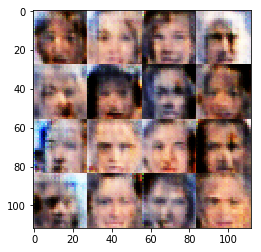

Epoch 1/2... Discriminator Loss: 1.2090... Generator Loss: 0.5823
Epoch 1/2... Discriminator Loss: 1.2760... Generator Loss: 1.0285
Epoch 1/2... Discriminator Loss: 1.4994... Generator Loss: 0.6329
Epoch 1/2... Discriminator Loss: 1.0831... Generator Loss: 1.0323
Epoch 1/2... Discriminator Loss: 1.3479... Generator Loss: 0.9353
Epoch 1/2... Discriminator Loss: 1.5975... Generator Loss: 0.6350
Epoch 1/2... Discriminator Loss: 1.5775... Generator Loss: 0.8433
Epoch 1/2... Discriminator Loss: 1.3683... Generator Loss: 0.6958
Epoch 1/2... Discriminator Loss: 1.5124... Generator Loss: 0.8901
Epoch 1/2... Discriminator Loss: 1.3536... Generator Loss: 0.6930


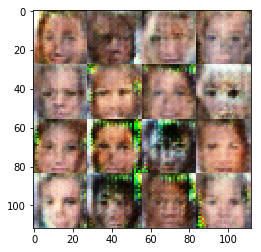

Epoch 1/2... Discriminator Loss: 1.2692... Generator Loss: 0.8089
Epoch 1/2... Discriminator Loss: 1.4206... Generator Loss: 0.5550
Epoch 1/2... Discriminator Loss: 1.5283... Generator Loss: 0.8345
Epoch 1/2... Discriminator Loss: 1.4299... Generator Loss: 0.5633
Epoch 1/2... Discriminator Loss: 1.2902... Generator Loss: 0.7266
Epoch 1/2... Discriminator Loss: 1.3702... Generator Loss: 0.6351
Epoch 1/2... Discriminator Loss: 1.4336... Generator Loss: 0.7859
Epoch 1/2... Discriminator Loss: 1.4148... Generator Loss: 0.7198
Epoch 1/2... Discriminator Loss: 0.9899... Generator Loss: 0.8797
Epoch 1/2... Discriminator Loss: 1.3900... Generator Loss: 0.6977


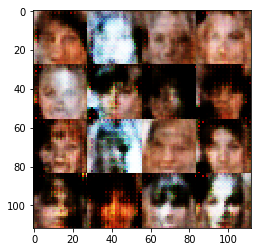

Epoch 1/2... Discriminator Loss: 1.3351... Generator Loss: 0.7519
Epoch 1/2... Discriminator Loss: 1.3314... Generator Loss: 0.7697
Epoch 1/2... Discriminator Loss: 1.4045... Generator Loss: 0.8332
Epoch 1/2... Discriminator Loss: 1.4218... Generator Loss: 0.6919
Epoch 1/2... Discriminator Loss: 1.4584... Generator Loss: 0.6817
Epoch 1/2... Discriminator Loss: 1.2711... Generator Loss: 0.8581
Epoch 1/2... Discriminator Loss: 1.4170... Generator Loss: 0.7400
Epoch 1/2... Discriminator Loss: 1.3692... Generator Loss: 0.7655
Epoch 1/2... Discriminator Loss: 1.3744... Generator Loss: 0.7761
Epoch 1/2... Discriminator Loss: 1.5173... Generator Loss: 0.5824


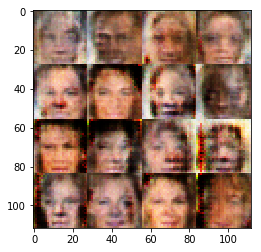

Epoch 1/2... Discriminator Loss: 1.4399... Generator Loss: 0.9100
Epoch 1/2... Discriminator Loss: 1.4395... Generator Loss: 0.7327
Epoch 1/2... Discriminator Loss: 1.4620... Generator Loss: 0.8145
Epoch 1/2... Discriminator Loss: 1.4830... Generator Loss: 0.7212
Epoch 1/2... Discriminator Loss: 1.5284... Generator Loss: 0.7176
Epoch 1/2... Discriminator Loss: 1.3471... Generator Loss: 0.7009
Epoch 1/2... Discriminator Loss: 1.3553... Generator Loss: 0.7274
Epoch 1/2... Discriminator Loss: 1.4013... Generator Loss: 0.7324
Epoch 1/2... Discriminator Loss: 1.4186... Generator Loss: 0.8405
Epoch 1/2... Discriminator Loss: 1.4153... Generator Loss: 0.6982


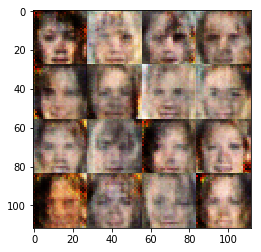

Epoch 1/2... Discriminator Loss: 1.3649... Generator Loss: 0.8633
Epoch 1/2... Discriminator Loss: 1.4010... Generator Loss: 0.8042
Epoch 1/2... Discriminator Loss: 1.4011... Generator Loss: 0.7405
Epoch 1/2... Discriminator Loss: 1.4318... Generator Loss: 0.7784
Epoch 1/2... Discriminator Loss: 1.4490... Generator Loss: 0.8176
Epoch 1/2... Discriminator Loss: 1.5043... Generator Loss: 0.7553
Epoch 1/2... Discriminator Loss: 1.4508... Generator Loss: 0.7518
Epoch 1/2... Discriminator Loss: 1.2305... Generator Loss: 0.6655
Epoch 1/2... Discriminator Loss: 1.4480... Generator Loss: 0.6471
Epoch 1/2... Discriminator Loss: 1.3901... Generator Loss: 0.8348


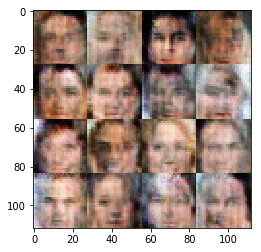

Epoch 1/2... Discriminator Loss: 1.5300... Generator Loss: 0.7841
Epoch 1/2... Discriminator Loss: 1.5299... Generator Loss: 0.7328
Epoch 1/2... Discriminator Loss: 1.3402... Generator Loss: 0.8199
Epoch 1/2... Discriminator Loss: 1.3886... Generator Loss: 0.6480
Epoch 1/2... Discriminator Loss: 1.3545... Generator Loss: 0.8422
Epoch 1/2... Discriminator Loss: 1.4334... Generator Loss: 0.8188
Epoch 1/2... Discriminator Loss: 1.3812... Generator Loss: 0.8390
Epoch 1/2... Discriminator Loss: 1.5212... Generator Loss: 0.7751
Epoch 1/2... Discriminator Loss: 1.4356... Generator Loss: 0.7414
Epoch 1/2... Discriminator Loss: 1.3154... Generator Loss: 0.7953


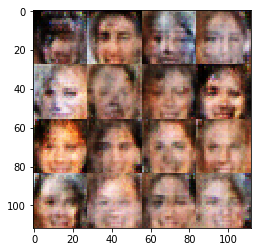

Epoch 1/2... Discriminator Loss: 1.5488... Generator Loss: 0.6004
Epoch 1/2... Discriminator Loss: 1.3412... Generator Loss: 0.8321
Epoch 1/2... Discriminator Loss: 1.5581... Generator Loss: 0.7421
Epoch 1/2... Discriminator Loss: 1.5622... Generator Loss: 0.6895
Epoch 1/2... Discriminator Loss: 1.3604... Generator Loss: 0.7972
Epoch 1/2... Discriminator Loss: 1.4106... Generator Loss: 0.8304
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.7718
Epoch 1/2... Discriminator Loss: 1.3298... Generator Loss: 0.7590
Epoch 1/2... Discriminator Loss: 1.3592... Generator Loss: 0.8382
Epoch 1/2... Discriminator Loss: 1.3371... Generator Loss: 0.7528


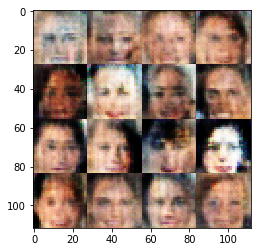

Epoch 1/2... Discriminator Loss: 1.3819... Generator Loss: 0.8099
Epoch 1/2... Discriminator Loss: 1.2894... Generator Loss: 0.8802
Epoch 1/2... Discriminator Loss: 1.4204... Generator Loss: 0.6068
Epoch 1/2... Discriminator Loss: 1.4517... Generator Loss: 0.7937
Epoch 1/2... Discriminator Loss: 1.4319... Generator Loss: 0.7347
Epoch 1/2... Discriminator Loss: 1.3531... Generator Loss: 0.9174
Epoch 1/2... Discriminator Loss: 1.3797... Generator Loss: 0.8052
Epoch 1/2... Discriminator Loss: 1.3324... Generator Loss: 0.7858
Epoch 1/2... Discriminator Loss: 1.3487... Generator Loss: 0.8701
Epoch 1/2... Discriminator Loss: 1.2859... Generator Loss: 0.7203


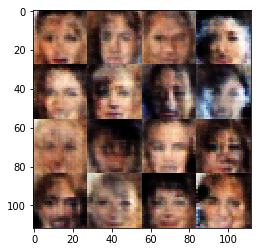

Epoch 1/2... Discriminator Loss: 1.3676... Generator Loss: 0.7948
Epoch 1/2... Discriminator Loss: 1.5316... Generator Loss: 0.7045
Epoch 1/2... Discriminator Loss: 1.3506... Generator Loss: 1.0453
Epoch 1/2... Discriminator Loss: 1.4217... Generator Loss: 0.7996
Epoch 1/2... Discriminator Loss: 1.3840... Generator Loss: 0.6583
Epoch 1/2... Discriminator Loss: 1.3400... Generator Loss: 0.6929
Epoch 1/2... Discriminator Loss: 1.3534... Generator Loss: 0.7599
Epoch 1/2... Discriminator Loss: 1.6106... Generator Loss: 0.5623
Epoch 1/2... Discriminator Loss: 1.5831... Generator Loss: 0.5664
Epoch 1/2... Discriminator Loss: 1.4147... Generator Loss: 0.7833


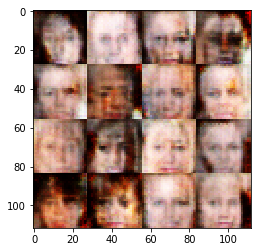

Epoch 1/2... Discriminator Loss: 1.3459... Generator Loss: 0.7470
Epoch 1/2... Discriminator Loss: 1.4748... Generator Loss: 0.7248
Epoch 1/2... Discriminator Loss: 1.4852... Generator Loss: 0.7811
Epoch 1/2... Discriminator Loss: 1.3725... Generator Loss: 0.8063
Epoch 1/2... Discriminator Loss: 1.4327... Generator Loss: 0.8495
Epoch 1/2... Discriminator Loss: 1.4186... Generator Loss: 0.7121
Epoch 1/2... Discriminator Loss: 1.3610... Generator Loss: 0.7430
Epoch 1/2... Discriminator Loss: 1.4747... Generator Loss: 0.6717
Epoch 1/2... Discriminator Loss: 1.4033... Generator Loss: 0.6648
Epoch 1/2... Discriminator Loss: 1.3428... Generator Loss: 0.9403


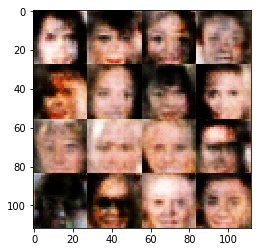

Epoch 1/2... Discriminator Loss: 1.3264... Generator Loss: 0.8406
Epoch 1/2... Discriminator Loss: 1.3803... Generator Loss: 0.6634
Epoch 1/2... Discriminator Loss: 1.2617... Generator Loss: 1.0505
Epoch 1/2... Discriminator Loss: 1.3623... Generator Loss: 0.7294
Epoch 1/2... Discriminator Loss: 1.2719... Generator Loss: 0.9194
Epoch 1/2... Discriminator Loss: 1.4887... Generator Loss: 0.7103
Epoch 1/2... Discriminator Loss: 1.4765... Generator Loss: 0.7520
Epoch 1/2... Discriminator Loss: 1.3884... Generator Loss: 0.7907
Epoch 1/2... Discriminator Loss: 1.2897... Generator Loss: 0.7930
Epoch 1/2... Discriminator Loss: 1.4037... Generator Loss: 0.6843


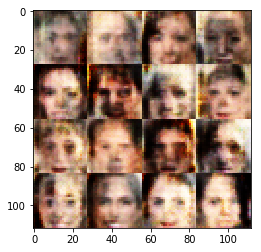

Epoch 1/2... Discriminator Loss: 1.5180... Generator Loss: 0.7602
Epoch 1/2... Discriminator Loss: 1.3909... Generator Loss: 0.7651
Epoch 1/2... Discriminator Loss: 1.3615... Generator Loss: 0.6582
Epoch 1/2... Discriminator Loss: 1.2720... Generator Loss: 0.8280
Epoch 1/2... Discriminator Loss: 1.3333... Generator Loss: 0.7433
Epoch 1/2... Discriminator Loss: 1.4224... Generator Loss: 0.6118
Epoch 1/2... Discriminator Loss: 1.2928... Generator Loss: 0.8423
Epoch 1/2... Discriminator Loss: 1.5466... Generator Loss: 0.6508
Epoch 1/2... Discriminator Loss: 1.4465... Generator Loss: 0.7972
Epoch 1/2... Discriminator Loss: 1.3837... Generator Loss: 0.7483


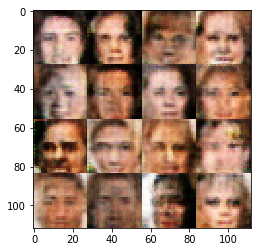

Epoch 1/2... Discriminator Loss: 1.3525... Generator Loss: 0.7699
Epoch 1/2... Discriminator Loss: 1.3826... Generator Loss: 0.6332
Epoch 1/2... Discriminator Loss: 1.5865... Generator Loss: 0.7097
Epoch 1/2... Discriminator Loss: 1.4731... Generator Loss: 0.8979
Epoch 1/2... Discriminator Loss: 1.4331... Generator Loss: 0.6557
Epoch 1/2... Discriminator Loss: 1.4757... Generator Loss: 0.9084
Epoch 1/2... Discriminator Loss: 1.4147... Generator Loss: 0.8158
Epoch 1/2... Discriminator Loss: 1.4696... Generator Loss: 0.5698
Epoch 1/2... Discriminator Loss: 1.4336... Generator Loss: 0.7271
Epoch 1/2... Discriminator Loss: 1.3292... Generator Loss: 0.8458


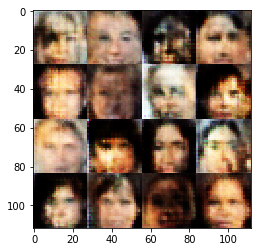

Epoch 1/2... Discriminator Loss: 1.4035... Generator Loss: 0.6809
Epoch 1/2... Discriminator Loss: 1.3737... Generator Loss: 0.7351
Epoch 1/2... Discriminator Loss: 1.4195... Generator Loss: 0.8485
Epoch 1/2... Discriminator Loss: 1.3254... Generator Loss: 0.7821
Epoch 1/2... Discriminator Loss: 1.3084... Generator Loss: 0.7975
Epoch 1/2... Discriminator Loss: 1.4027... Generator Loss: 0.7570
Epoch 1/2... Discriminator Loss: 1.3972... Generator Loss: 0.8541
Epoch 1/2... Discriminator Loss: 1.3547... Generator Loss: 0.9328
Epoch 1/2... Discriminator Loss: 1.3289... Generator Loss: 0.8923
Epoch 1/2... Discriminator Loss: 1.3917... Generator Loss: 0.7517


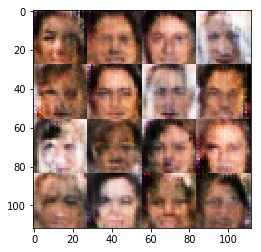

Epoch 1/2... Discriminator Loss: 1.3730... Generator Loss: 0.8559
Epoch 1/2... Discriminator Loss: 1.3692... Generator Loss: 0.6951
Epoch 1/2... Discriminator Loss: 1.4210... Generator Loss: 0.7643
Epoch 1/2... Discriminator Loss: 1.4183... Generator Loss: 0.5701
Epoch 1/2... Discriminator Loss: 1.4183... Generator Loss: 0.8721
Epoch 1/2... Discriminator Loss: 1.3920... Generator Loss: 0.6575
Epoch 1/2... Discriminator Loss: 1.2841... Generator Loss: 0.8749
Epoch 1/2... Discriminator Loss: 1.3463... Generator Loss: 0.8343
Epoch 1/2... Discriminator Loss: 1.4739... Generator Loss: 0.8716
Epoch 1/2... Discriminator Loss: 1.3602... Generator Loss: 0.7530


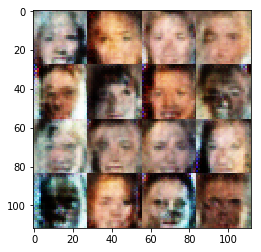

Epoch 1/2... Discriminator Loss: 1.3360... Generator Loss: 0.8333
Epoch 1/2... Discriminator Loss: 1.3742... Generator Loss: 0.7425
Epoch 1/2... Discriminator Loss: 1.3885... Generator Loss: 0.9033
Epoch 1/2... Discriminator Loss: 1.3442... Generator Loss: 0.7331
Epoch 1/2... Discriminator Loss: 1.4110... Generator Loss: 0.8015
Epoch 1/2... Discriminator Loss: 1.4185... Generator Loss: 0.8430
Epoch 1/2... Discriminator Loss: 1.3791... Generator Loss: 0.7599
Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.9223
Epoch 1/2... Discriminator Loss: 1.4205... Generator Loss: 0.7334
Epoch 1/2... Discriminator Loss: 1.3731... Generator Loss: 0.7558


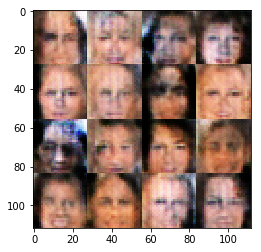

Epoch 1/2... Discriminator Loss: 1.4463... Generator Loss: 0.8496
Epoch 1/2... Discriminator Loss: 1.3752... Generator Loss: 0.7625
Epoch 1/2... Discriminator Loss: 1.3929... Generator Loss: 0.7131
Epoch 1/2... Discriminator Loss: 1.4055... Generator Loss: 0.6454
Epoch 1/2... Discriminator Loss: 1.3292... Generator Loss: 0.8205
Epoch 1/2... Discriminator Loss: 1.4994... Generator Loss: 0.7556
Epoch 1/2... Discriminator Loss: 1.3013... Generator Loss: 0.7574
Epoch 1/2... Discriminator Loss: 1.4079... Generator Loss: 0.6318
Epoch 1/2... Discriminator Loss: 1.4152... Generator Loss: 0.7832
Epoch 1/2... Discriminator Loss: 1.3881... Generator Loss: 0.7271


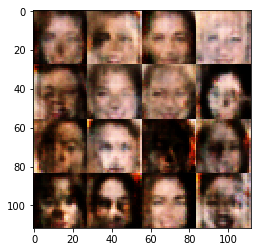

Epoch 1/2... Discriminator Loss: 1.2984... Generator Loss: 0.9091
Epoch 1/2... Discriminator Loss: 1.3429... Generator Loss: 0.8506
Epoch 1/2... Discriminator Loss: 1.3400... Generator Loss: 0.7965
Epoch 1/2... Discriminator Loss: 1.2481... Generator Loss: 0.7455
Epoch 1/2... Discriminator Loss: 1.3784... Generator Loss: 0.7772
Epoch 1/2... Discriminator Loss: 1.3572... Generator Loss: 0.8319
Epoch 1/2... Discriminator Loss: 1.4206... Generator Loss: 0.9480
Epoch 1/2... Discriminator Loss: 1.3833... Generator Loss: 0.8956
Epoch 1/2... Discriminator Loss: 1.4217... Generator Loss: 0.7518
Epoch 1/2... Discriminator Loss: 1.2876... Generator Loss: 0.6669


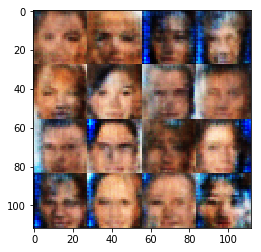

Epoch 1/2... Discriminator Loss: 1.6353... Generator Loss: 0.4525
Epoch 1/2... Discriminator Loss: 1.3512... Generator Loss: 0.7895
Epoch 1/2... Discriminator Loss: 1.3787... Generator Loss: 0.8000
Epoch 1/2... Discriminator Loss: 1.3295... Generator Loss: 0.6990
Epoch 1/2... Discriminator Loss: 1.3807... Generator Loss: 0.7767
Epoch 1/2... Discriminator Loss: 1.3392... Generator Loss: 0.7654
Epoch 1/2... Discriminator Loss: 1.3532... Generator Loss: 0.8611
Epoch 1/2... Discriminator Loss: 1.4512... Generator Loss: 0.7114
Epoch 1/2... Discriminator Loss: 1.3020... Generator Loss: 0.8376
Epoch 1/2... Discriminator Loss: 1.4606... Generator Loss: 0.8604


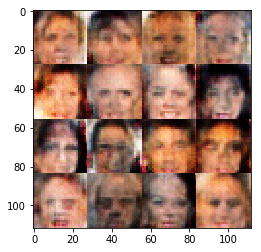

Epoch 1/2... Discriminator Loss: 1.4035... Generator Loss: 0.7784
Epoch 1/2... Discriminator Loss: 1.3904... Generator Loss: 0.7172
Epoch 1/2... Discriminator Loss: 1.3842... Generator Loss: 0.8053
Epoch 1/2... Discriminator Loss: 1.4337... Generator Loss: 0.7260
Epoch 1/2... Discriminator Loss: 1.3776... Generator Loss: 0.7919
Epoch 1/2... Discriminator Loss: 1.3650... Generator Loss: 0.7424
Epoch 1/2... Discriminator Loss: 1.4917... Generator Loss: 0.8024
Epoch 1/2... Discriminator Loss: 1.3948... Generator Loss: 0.8548
Epoch 1/2... Discriminator Loss: 1.3792... Generator Loss: 0.8622
Epoch 1/2... Discriminator Loss: 1.3958... Generator Loss: 0.7065


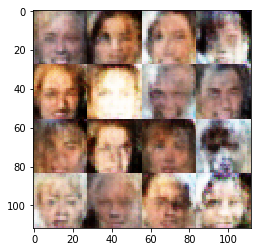

Epoch 1/2... Discriminator Loss: 1.4156... Generator Loss: 0.8140
Epoch 1/2... Discriminator Loss: 1.4582... Generator Loss: 0.7421
Epoch 1/2... Discriminator Loss: 1.3657... Generator Loss: 0.7015
Epoch 1/2... Discriminator Loss: 1.3286... Generator Loss: 0.7735
Epoch 1/2... Discriminator Loss: 1.3680... Generator Loss: 0.8713
Epoch 1/2... Discriminator Loss: 1.3546... Generator Loss: 0.7605
Epoch 1/2... Discriminator Loss: 1.4711... Generator Loss: 0.7570
Epoch 1/2... Discriminator Loss: 1.4137... Generator Loss: 0.7411
Epoch 1/2... Discriminator Loss: 1.3201... Generator Loss: 0.7777
Epoch 1/2... Discriminator Loss: 1.4645... Generator Loss: 0.7388


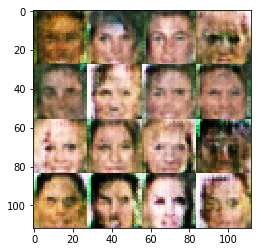

Epoch 1/2... Discriminator Loss: 1.3940... Generator Loss: 0.8147
Epoch 1/2... Discriminator Loss: 1.3715... Generator Loss: 0.7970
Epoch 1/2... Discriminator Loss: 1.3391... Generator Loss: 0.8726
Epoch 1/2... Discriminator Loss: 1.3391... Generator Loss: 0.8302
Epoch 1/2... Discriminator Loss: 1.3871... Generator Loss: 0.7212
Epoch 1/2... Discriminator Loss: 1.2772... Generator Loss: 0.6784
Epoch 1/2... Discriminator Loss: 1.3433... Generator Loss: 0.6457
Epoch 1/2... Discriminator Loss: 1.3752... Generator Loss: 0.7623
Epoch 1/2... Discriminator Loss: 1.3639... Generator Loss: 0.6510
Epoch 1/2... Discriminator Loss: 1.3885... Generator Loss: 0.8387


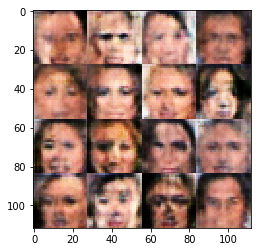

Epoch 1/2... Discriminator Loss: 1.3448... Generator Loss: 0.7820
Epoch 1/2... Discriminator Loss: 1.2428... Generator Loss: 0.8879
Epoch 1/2... Discriminator Loss: 1.4114... Generator Loss: 0.8010
Epoch 1/2... Discriminator Loss: 1.4108... Generator Loss: 0.7512
Epoch 1/2... Discriminator Loss: 1.4251... Generator Loss: 0.7050
Epoch 1/2... Discriminator Loss: 1.3055... Generator Loss: 0.8424
Epoch 1/2... Discriminator Loss: 1.4550... Generator Loss: 0.8646
Epoch 1/2... Discriminator Loss: 1.3986... Generator Loss: 0.7797
Epoch 1/2... Discriminator Loss: 1.4792... Generator Loss: 0.7345
Epoch 1/2... Discriminator Loss: 1.3658... Generator Loss: 0.6898


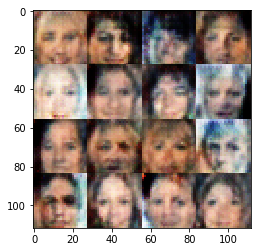

Epoch 1/2... Discriminator Loss: 1.3849... Generator Loss: 0.7997
Epoch 1/2... Discriminator Loss: 1.3465... Generator Loss: 1.0123
Epoch 1/2... Discriminator Loss: 1.3929... Generator Loss: 0.8053
Epoch 1/2... Discriminator Loss: 1.3493... Generator Loss: 0.7631
Epoch 1/2... Discriminator Loss: 1.4307... Generator Loss: 0.7904
Epoch 1/2... Discriminator Loss: 1.3693... Generator Loss: 0.7095
Epoch 1/2... Discriminator Loss: 1.3992... Generator Loss: 0.8705
Epoch 1/2... Discriminator Loss: 1.3495... Generator Loss: 0.7670
Epoch 1/2... Discriminator Loss: 1.4201... Generator Loss: 0.7884
Epoch 1/2... Discriminator Loss: 1.4538... Generator Loss: 0.8020


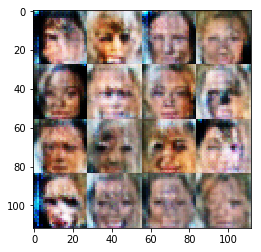

Epoch 1/2... Discriminator Loss: 1.3760... Generator Loss: 0.7771
Epoch 1/2... Discriminator Loss: 1.4578... Generator Loss: 0.8883
Epoch 1/2... Discriminator Loss: 1.4036... Generator Loss: 0.8275
Epoch 1/2... Discriminator Loss: 1.3923... Generator Loss: 0.8444
Epoch 1/2... Discriminator Loss: 1.3807... Generator Loss: 0.6705
Epoch 1/2... Discriminator Loss: 1.3651... Generator Loss: 0.7414
Epoch 1/2... Discriminator Loss: 1.2328... Generator Loss: 0.9754
Epoch 1/2... Discriminator Loss: 1.3935... Generator Loss: 0.7629
Epoch 1/2... Discriminator Loss: 1.4356... Generator Loss: 0.6764
Epoch 1/2... Discriminator Loss: 1.3401... Generator Loss: 0.6891


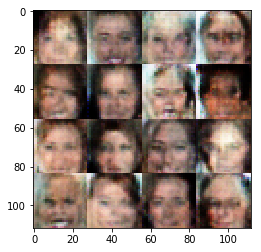

Epoch 1/2... Discriminator Loss: 1.3601... Generator Loss: 0.8278
Epoch 1/2... Discriminator Loss: 1.3676... Generator Loss: 0.8401
Epoch 1/2... Discriminator Loss: 1.3271... Generator Loss: 0.7389
Epoch 1/2... Discriminator Loss: 1.4368... Generator Loss: 0.7363
Epoch 1/2... Discriminator Loss: 1.5103... Generator Loss: 0.7047
Epoch 1/2... Discriminator Loss: 1.3715... Generator Loss: 0.8684
Epoch 1/2... Discriminator Loss: 1.3651... Generator Loss: 0.8691
Epoch 1/2... Discriminator Loss: 1.4627... Generator Loss: 0.8058
Epoch 1/2... Discriminator Loss: 1.3579... Generator Loss: 0.6667
Epoch 1/2... Discriminator Loss: 1.4477... Generator Loss: 0.8157


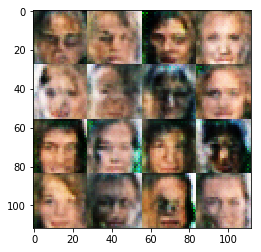

Epoch 1/2... Discriminator Loss: 1.3128... Generator Loss: 0.7159
Epoch 1/2... Discriminator Loss: 1.2940... Generator Loss: 0.5966
Epoch 1/2... Discriminator Loss: 1.4133... Generator Loss: 0.7496
Epoch 1/2... Discriminator Loss: 1.4117... Generator Loss: 0.7182
Epoch 1/2... Discriminator Loss: 1.3579... Generator Loss: 0.7558
Epoch 1/2... Discriminator Loss: 1.3562... Generator Loss: 0.7860
Epoch 1/2... Discriminator Loss: 1.2930... Generator Loss: 0.9816
Epoch 1/2... Discriminator Loss: 1.3981... Generator Loss: 0.7445
Epoch 1/2... Discriminator Loss: 1.3127... Generator Loss: 0.7097
Epoch 1/2... Discriminator Loss: 1.3724... Generator Loss: 0.6915


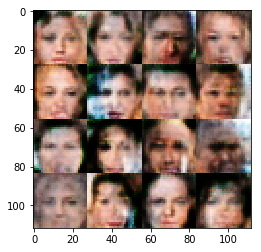

Epoch 1/2... Discriminator Loss: 1.3864... Generator Loss: 0.8346
Epoch 1/2... Discriminator Loss: 1.3237... Generator Loss: 0.7573
Epoch 1/2... Discriminator Loss: 1.3964... Generator Loss: 0.7392
Epoch 1/2... Discriminator Loss: 1.2531... Generator Loss: 0.7299
Epoch 1/2... Discriminator Loss: 1.4370... Generator Loss: 0.8904
Epoch 1/2... Discriminator Loss: 1.2485... Generator Loss: 0.8138
Epoch 1/2... Discriminator Loss: 1.2597... Generator Loss: 0.7474
Epoch 1/2... Discriminator Loss: 1.4918... Generator Loss: 0.5201
Epoch 1/2... Discriminator Loss: 1.2812... Generator Loss: 0.7599
Epoch 1/2... Discriminator Loss: 1.3536... Generator Loss: 0.8557


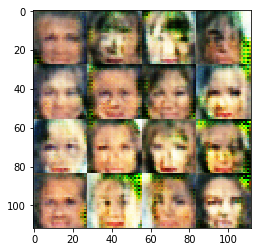

Epoch 1/2... Discriminator Loss: 1.4399... Generator Loss: 0.7145
Epoch 1/2... Discriminator Loss: 1.4140... Generator Loss: 0.8350
Epoch 1/2... Discriminator Loss: 1.2903... Generator Loss: 0.8442
Epoch 1/2... Discriminator Loss: 1.3837... Generator Loss: 0.8245
Epoch 1/2... Discriminator Loss: 1.2568... Generator Loss: 0.8704
Epoch 1/2... Discriminator Loss: 1.2715... Generator Loss: 0.6870
Epoch 1/2... Discriminator Loss: 1.3886... Generator Loss: 0.8171
Epoch 1/2... Discriminator Loss: 1.3026... Generator Loss: 0.8299
Epoch 1/2... Discriminator Loss: 1.3536... Generator Loss: 0.8184
Epoch 1/2... Discriminator Loss: 1.3276... Generator Loss: 0.7064


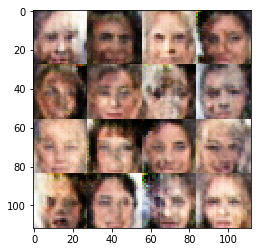

Epoch 1/2... Discriminator Loss: 1.3023... Generator Loss: 0.8646
Epoch 1/2... Discriminator Loss: 1.3767... Generator Loss: 0.7487
Epoch 1/2... Discriminator Loss: 1.3183... Generator Loss: 0.7535
Epoch 1/2... Discriminator Loss: 1.3698... Generator Loss: 0.7806
Epoch 1/2... Discriminator Loss: 1.5067... Generator Loss: 0.7838
Epoch 1/2... Discriminator Loss: 1.4852... Generator Loss: 0.7938
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 0.6898
Epoch 1/2... Discriminator Loss: 1.3662... Generator Loss: 0.7422
Epoch 1/2... Discriminator Loss: 1.4221... Generator Loss: 0.7001
Epoch 1/2... Discriminator Loss: 1.3144... Generator Loss: 0.7253


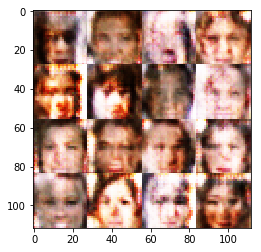

Epoch 1/2... Discriminator Loss: 1.2128... Generator Loss: 0.7547
Epoch 1/2... Discriminator Loss: 1.4062... Generator Loss: 0.8617
Epoch 1/2... Discriminator Loss: 1.2920... Generator Loss: 0.9020
Epoch 1/2... Discriminator Loss: 1.4787... Generator Loss: 0.7089
Epoch 1/2... Discriminator Loss: 1.3742... Generator Loss: 0.7434
Epoch 1/2... Discriminator Loss: 1.4308... Generator Loss: 0.7560
Epoch 1/2... Discriminator Loss: 1.4743... Generator Loss: 0.6429
Epoch 1/2... Discriminator Loss: 1.3496... Generator Loss: 0.8874
Epoch 1/2... Discriminator Loss: 1.4206... Generator Loss: 0.6937
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 0.7610


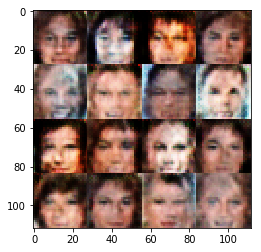

Epoch 1/2... Discriminator Loss: 1.3383... Generator Loss: 0.7291
Epoch 1/2... Discriminator Loss: 1.3082... Generator Loss: 0.8557
Epoch 1/2... Discriminator Loss: 1.3085... Generator Loss: 0.8077
Epoch 1/2... Discriminator Loss: 1.3554... Generator Loss: 0.7349
Epoch 1/2... Discriminator Loss: 1.2467... Generator Loss: 0.7495
Epoch 1/2... Discriminator Loss: 1.3972... Generator Loss: 0.7223
Epoch 1/2... Discriminator Loss: 1.4013... Generator Loss: 0.7053
Epoch 1/2... Discriminator Loss: 1.3380... Generator Loss: 0.6839
Epoch 1/2... Discriminator Loss: 1.1711... Generator Loss: 0.7703
Epoch 1/2... Discriminator Loss: 1.3949... Generator Loss: 0.7273


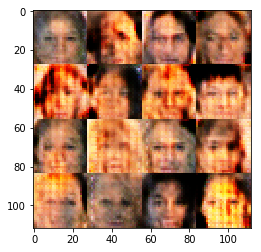

Epoch 1/2... Discriminator Loss: 1.4162... Generator Loss: 0.8497
Epoch 1/2... Discriminator Loss: 1.4207... Generator Loss: 0.7308
Epoch 1/2... Discriminator Loss: 1.3459... Generator Loss: 0.8476
Epoch 1/2... Discriminator Loss: 1.3506... Generator Loss: 0.9672
Epoch 1/2... Discriminator Loss: 1.4102... Generator Loss: 0.7415
Epoch 1/2... Discriminator Loss: 1.4324... Generator Loss: 0.7342
Epoch 1/2... Discriminator Loss: 1.3281... Generator Loss: 0.9165
Epoch 1/2... Discriminator Loss: 1.4525... Generator Loss: 0.8443
Epoch 1/2... Discriminator Loss: 1.3345... Generator Loss: 0.7318
Epoch 1/2... Discriminator Loss: 1.4336... Generator Loss: 0.9636


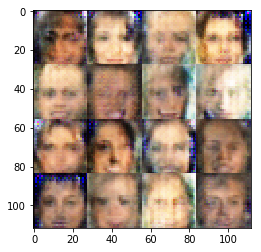

Epoch 1/2... Discriminator Loss: 1.3433... Generator Loss: 0.8030
Epoch 1/2... Discriminator Loss: 1.4000... Generator Loss: 0.7780
Epoch 1/2... Discriminator Loss: 1.5271... Generator Loss: 0.7321
Epoch 1/2... Discriminator Loss: 1.4248... Generator Loss: 0.8944
Epoch 1/2... Discriminator Loss: 1.4102... Generator Loss: 0.7758
Epoch 1/2... Discriminator Loss: 1.3513... Generator Loss: 0.7808
Epoch 1/2... Discriminator Loss: 1.3558... Generator Loss: 0.6308
Epoch 1/2... Discriminator Loss: 1.3356... Generator Loss: 0.7911
Epoch 1/2... Discriminator Loss: 1.3832... Generator Loss: 0.7692
Epoch 1/2... Discriminator Loss: 1.4638... Generator Loss: 0.7693


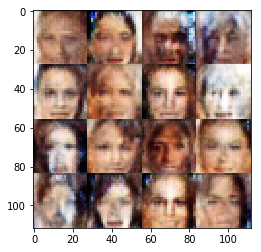

Epoch 1/2... Discriminator Loss: 1.3525... Generator Loss: 0.7763
Epoch 1/2... Discriminator Loss: 1.3830... Generator Loss: 0.7738
Epoch 1/2... Discriminator Loss: 1.4362... Generator Loss: 0.7830
Epoch 1/2... Discriminator Loss: 1.3066... Generator Loss: 0.8142
Epoch 1/2... Discriminator Loss: 1.4210... Generator Loss: 0.7638
Epoch 1/2... Discriminator Loss: 1.4230... Generator Loss: 0.7476
Epoch 1/2... Discriminator Loss: 1.3337... Generator Loss: 0.8574
Epoch 1/2... Discriminator Loss: 1.4518... Generator Loss: 0.7242
Epoch 1/2... Discriminator Loss: 1.3297... Generator Loss: 0.7850
Epoch 1/2... Discriminator Loss: 1.4403... Generator Loss: 0.6381


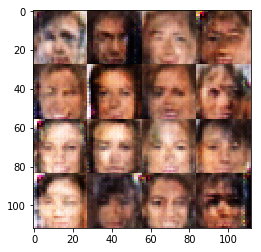

Epoch 1/2... Discriminator Loss: 1.3442... Generator Loss: 0.7788
Epoch 1/2... Discriminator Loss: 1.3588... Generator Loss: 0.8383
Epoch 1/2... Discriminator Loss: 1.3530... Generator Loss: 0.7877
Epoch 1/2... Discriminator Loss: 1.4034... Generator Loss: 0.8191
Epoch 1/2... Discriminator Loss: 1.3947... Generator Loss: 0.8311
Epoch 1/2... Discriminator Loss: 1.3895... Generator Loss: 0.7744
Epoch 1/2... Discriminator Loss: 1.4162... Generator Loss: 0.8079
Epoch 1/2... Discriminator Loss: 1.4240... Generator Loss: 0.7243
Epoch 1/2... Discriminator Loss: 1.3585... Generator Loss: 0.7388
Epoch 1/2... Discriminator Loss: 1.3790... Generator Loss: 0.8422


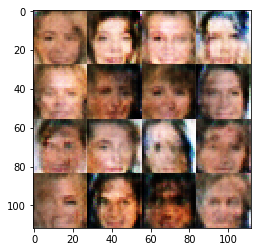

Epoch 1/2... Discriminator Loss: 1.4032... Generator Loss: 0.8047
Epoch 1/2... Discriminator Loss: 1.3888... Generator Loss: 0.8113
Epoch 1/2... Discriminator Loss: 1.3710... Generator Loss: 0.7414
Epoch 1/2... Discriminator Loss: 1.3499... Generator Loss: 0.8059
Epoch 1/2... Discriminator Loss: 1.4062... Generator Loss: 0.7729
Epoch 1/2... Discriminator Loss: 1.3985... Generator Loss: 0.8520
Epoch 1/2... Discriminator Loss: 1.2926... Generator Loss: 0.7481
Epoch 1/2... Discriminator Loss: 1.3953... Generator Loss: 0.7978
Epoch 1/2... Discriminator Loss: 1.3573... Generator Loss: 0.7626
Epoch 1/2... Discriminator Loss: 1.3557... Generator Loss: 0.6570


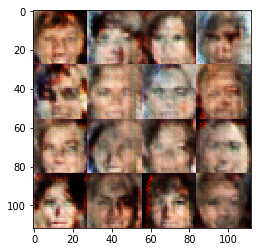

Epoch 1/2... Discriminator Loss: 1.4114... Generator Loss: 0.7763
Epoch 1/2... Discriminator Loss: 1.3447... Generator Loss: 0.6885
Epoch 1/2... Discriminator Loss: 1.3786... Generator Loss: 0.7621
Epoch 1/2... Discriminator Loss: 1.3443... Generator Loss: 0.7397
Epoch 1/2... Discriminator Loss: 1.3734... Generator Loss: 0.8255
Epoch 1/2... Discriminator Loss: 1.3667... Generator Loss: 0.7381
Epoch 1/2... Discriminator Loss: 1.3697... Generator Loss: 0.7205
Epoch 1/2... Discriminator Loss: 1.3898... Generator Loss: 0.7725
Epoch 1/2... Discriminator Loss: 1.3556... Generator Loss: 0.7457
Epoch 1/2... Discriminator Loss: 1.2539... Generator Loss: 0.8050


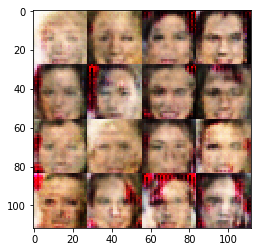

Epoch 1/2... Discriminator Loss: 1.3263... Generator Loss: 0.8377
Epoch 1/2... Discriminator Loss: 1.3948... Generator Loss: 0.8398
Epoch 1/2... Discriminator Loss: 1.3717... Generator Loss: 0.8120
Epoch 1/2... Discriminator Loss: 1.3803... Generator Loss: 0.8126
Epoch 1/2... Discriminator Loss: 1.4007... Generator Loss: 0.7412
Epoch 1/2... Discriminator Loss: 1.3589... Generator Loss: 0.7335
Epoch 1/2... Discriminator Loss: 1.4249... Generator Loss: 0.7295
Epoch 1/2... Discriminator Loss: 1.3523... Generator Loss: 0.8086
Epoch 1/2... Discriminator Loss: 1.4242... Generator Loss: 0.7084
Epoch 1/2... Discriminator Loss: 1.4460... Generator Loss: 0.8463


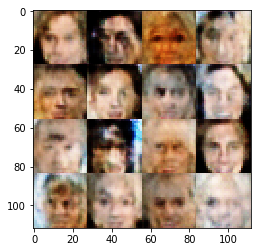

Epoch 1/2... Discriminator Loss: 1.3666... Generator Loss: 0.7497
Epoch 1/2... Discriminator Loss: 1.5777... Generator Loss: 0.6036
Epoch 1/2... Discriminator Loss: 1.4122... Generator Loss: 0.6820
Epoch 1/2... Discriminator Loss: 1.2960... Generator Loss: 0.7065
Epoch 1/2... Discriminator Loss: 1.4705... Generator Loss: 0.6681
Epoch 1/2... Discriminator Loss: 1.3751... Generator Loss: 0.7076
Epoch 1/2... Discriminator Loss: 1.3883... Generator Loss: 0.7706
Epoch 1/2... Discriminator Loss: 1.3766... Generator Loss: 0.7637
Epoch 1/2... Discriminator Loss: 1.3428... Generator Loss: 0.8276
Epoch 1/2... Discriminator Loss: 1.4086... Generator Loss: 0.6108


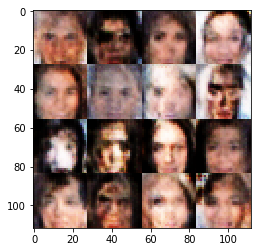

Epoch 1/2... Discriminator Loss: 1.4227... Generator Loss: 0.7929
Epoch 1/2... Discriminator Loss: 1.3897... Generator Loss: 0.8357
Epoch 1/2... Discriminator Loss: 1.4074... Generator Loss: 0.7964
Epoch 1/2... Discriminator Loss: 1.3691... Generator Loss: 0.7528
Epoch 1/2... Discriminator Loss: 1.3523... Generator Loss: 0.7438
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.8287
Epoch 1/2... Discriminator Loss: 1.4472... Generator Loss: 0.7800
Epoch 1/2... Discriminator Loss: 1.2987... Generator Loss: 0.7687
Epoch 1/2... Discriminator Loss: 1.3652... Generator Loss: 0.8214
Epoch 1/2... Discriminator Loss: 1.3757... Generator Loss: 0.8053


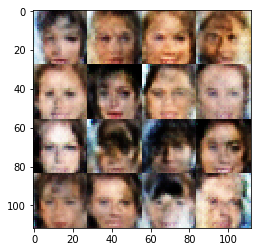

Epoch 1/2... Discriminator Loss: 1.3726... Generator Loss: 0.7594
Epoch 1/2... Discriminator Loss: 1.4454... Generator Loss: 0.7381
Epoch 1/2... Discriminator Loss: 1.3233... Generator Loss: 0.9500
Epoch 1/2... Discriminator Loss: 1.3647... Generator Loss: 0.7149
Epoch 1/2... Discriminator Loss: 1.3598... Generator Loss: 0.8339
Epoch 1/2... Discriminator Loss: 1.4194... Generator Loss: 0.7774
Epoch 1/2... Discriminator Loss: 1.3988... Generator Loss: 0.8451
Epoch 1/2... Discriminator Loss: 1.3438... Generator Loss: 0.8664
Epoch 1/2... Discriminator Loss: 1.3091... Generator Loss: 0.8383
Epoch 1/2... Discriminator Loss: 1.3326... Generator Loss: 0.7898


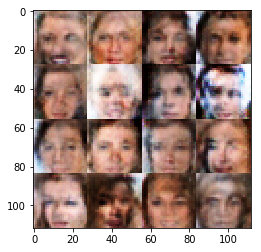

Epoch 1/2... Discriminator Loss: 1.2870... Generator Loss: 0.7784
Epoch 1/2... Discriminator Loss: 1.3824... Generator Loss: 0.7153
Epoch 1/2... Discriminator Loss: 1.3441... Generator Loss: 0.7716
Epoch 1/2... Discriminator Loss: 1.3827... Generator Loss: 0.7317
Epoch 1/2... Discriminator Loss: 1.3163... Generator Loss: 0.7845
Epoch 1/2... Discriminator Loss: 1.3544... Generator Loss: 0.7799
Epoch 1/2... Discriminator Loss: 1.3778... Generator Loss: 0.8257
Epoch 1/2... Discriminator Loss: 1.3170... Generator Loss: 0.8980
Epoch 1/2... Discriminator Loss: 1.2680... Generator Loss: 0.7588
Epoch 1/2... Discriminator Loss: 1.2843... Generator Loss: 0.8324


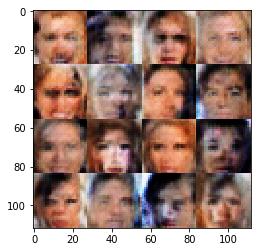

Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.7720
Epoch 1/2... Discriminator Loss: 1.4368... Generator Loss: 0.7776
Epoch 1/2... Discriminator Loss: 1.4350... Generator Loss: 0.6971
Epoch 1/2... Discriminator Loss: 1.3795... Generator Loss: 0.7186
Epoch 1/2... Discriminator Loss: 1.3687... Generator Loss: 0.8361
Epoch 1/2... Discriminator Loss: 1.3670... Generator Loss: 0.7831
Epoch 1/2... Discriminator Loss: 1.3875... Generator Loss: 0.8655
Epoch 1/2... Discriminator Loss: 1.3577... Generator Loss: 0.8013
Epoch 1/2... Discriminator Loss: 1.4111... Generator Loss: 0.7913
Epoch 1/2... Discriminator Loss: 1.3962... Generator Loss: 0.7008


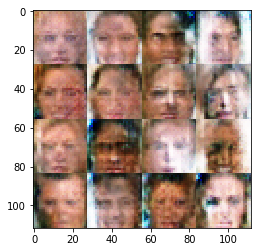

Epoch 1/2... Discriminator Loss: 1.3867... Generator Loss: 0.8329
Epoch 1/2... Discriminator Loss: 1.3912... Generator Loss: 0.6940
Epoch 1/2... Discriminator Loss: 1.3717... Generator Loss: 0.8268
Epoch 1/2... Discriminator Loss: 1.3876... Generator Loss: 0.8039
Epoch 1/2... Discriminator Loss: 1.3864... Generator Loss: 0.8127
Epoch 1/2... Discriminator Loss: 1.3819... Generator Loss: 0.7801
Epoch 1/2... Discriminator Loss: 1.4026... Generator Loss: 0.7697
Epoch 1/2... Discriminator Loss: 1.3627... Generator Loss: 0.8906
Epoch 1/2... Discriminator Loss: 1.3970... Generator Loss: 0.7899
Epoch 1/2... Discriminator Loss: 1.3556... Generator Loss: 0.7893


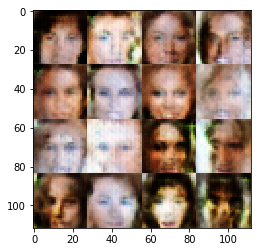

Epoch 1/2... Discriminator Loss: 1.3477... Generator Loss: 0.8017
Epoch 1/2... Discriminator Loss: 1.3468... Generator Loss: 0.8601
Epoch 1/2... Discriminator Loss: 1.4237... Generator Loss: 0.7942
Epoch 1/2... Discriminator Loss: 1.3405... Generator Loss: 0.7460
Epoch 1/2... Discriminator Loss: 1.3869... Generator Loss: 0.8022
Epoch 1/2... Discriminator Loss: 1.3757... Generator Loss: 0.8571
Epoch 1/2... Discriminator Loss: 1.3482... Generator Loss: 0.7138
Epoch 1/2... Discriminator Loss: 1.3981... Generator Loss: 0.7792
Epoch 1/2... Discriminator Loss: 1.3656... Generator Loss: 0.7701
Epoch 1/2... Discriminator Loss: 1.2792... Generator Loss: 0.7566


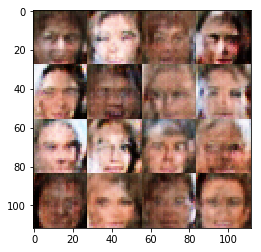

Epoch 1/2... Discriminator Loss: 1.5280... Generator Loss: 0.6941
Epoch 1/2... Discriminator Loss: 1.3866... Generator Loss: 0.8098
Epoch 1/2... Discriminator Loss: 1.4295... Generator Loss: 0.6774
Epoch 1/2... Discriminator Loss: 1.2569... Generator Loss: 0.7680
Epoch 1/2... Discriminator Loss: 1.3901... Generator Loss: 0.7902
Epoch 1/2... Discriminator Loss: 1.3361... Generator Loss: 0.8492
Epoch 1/2... Discriminator Loss: 1.3857... Generator Loss: 0.7942
Epoch 1/2... Discriminator Loss: 1.3389... Generator Loss: 0.7995
Epoch 1/2... Discriminator Loss: 1.3397... Generator Loss: 0.7997
Epoch 1/2... Discriminator Loss: 1.3385... Generator Loss: 0.7912


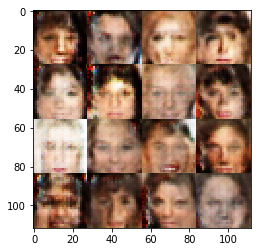

Epoch 1/2... Discriminator Loss: 1.4330... Generator Loss: 0.7502
Epoch 1/2... Discriminator Loss: 1.3955... Generator Loss: 0.8365
Epoch 1/2... Discriminator Loss: 1.4019... Generator Loss: 0.7835
Epoch 1/2... Discriminator Loss: 1.3362... Generator Loss: 0.8400
Epoch 1/2... Discriminator Loss: 1.3723... Generator Loss: 0.7449
Epoch 1/2... Discriminator Loss: 1.3811... Generator Loss: 0.8242
Epoch 1/2... Discriminator Loss: 1.3220... Generator Loss: 0.7836
Epoch 1/2... Discriminator Loss: 1.3828... Generator Loss: 0.7882
Epoch 1/2... Discriminator Loss: 1.3908... Generator Loss: 0.8290
Epoch 1/2... Discriminator Loss: 1.3899... Generator Loss: 0.7873


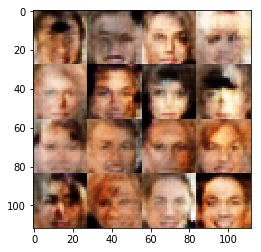

Epoch 1/2... Discriminator Loss: 1.3958... Generator Loss: 0.7444
Epoch 1/2... Discriminator Loss: 1.3790... Generator Loss: 0.8068
Epoch 1/2... Discriminator Loss: 1.3791... Generator Loss: 0.8261
Epoch 1/2... Discriminator Loss: 1.3964... Generator Loss: 0.7571
Epoch 1/2... Discriminator Loss: 1.3327... Generator Loss: 0.8076
Epoch 1/2... Discriminator Loss: 1.3245... Generator Loss: 0.7419
Epoch 1/2... Discriminator Loss: 1.3498... Generator Loss: 0.8720
Epoch 1/2... Discriminator Loss: 1.3506... Generator Loss: 0.7800
Epoch 1/2... Discriminator Loss: 1.3775... Generator Loss: 0.8401
Epoch 1/2... Discriminator Loss: 1.3584... Generator Loss: 0.7731


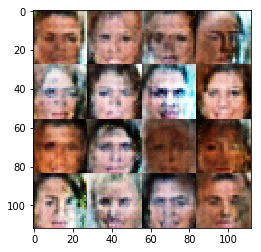

Epoch 1/2... Discriminator Loss: 1.3317... Generator Loss: 0.8226
Epoch 1/2... Discriminator Loss: 1.3267... Generator Loss: 0.8576
Epoch 1/2... Discriminator Loss: 1.3784... Generator Loss: 0.7119
Epoch 1/2... Discriminator Loss: 1.3761... Generator Loss: 0.8106
Epoch 1/2... Discriminator Loss: 1.4196... Generator Loss: 0.7513
Epoch 1/2... Discriminator Loss: 1.3782... Generator Loss: 0.7265
Epoch 1/2... Discriminator Loss: 1.3862... Generator Loss: 0.7452
Epoch 1/2... Discriminator Loss: 1.4051... Generator Loss: 0.7412
Epoch 1/2... Discriminator Loss: 1.3865... Generator Loss: 0.7455
Epoch 1/2... Discriminator Loss: 1.3267... Generator Loss: 0.7730


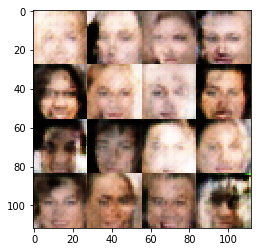

Epoch 1/2... Discriminator Loss: 1.3630... Generator Loss: 0.7569
Epoch 1/2... Discriminator Loss: 1.3672... Generator Loss: 0.8143
Epoch 1/2... Discriminator Loss: 1.3855... Generator Loss: 0.8256
Epoch 1/2... Discriminator Loss: 1.3229... Generator Loss: 0.7594
Epoch 1/2... Discriminator Loss: 1.3984... Generator Loss: 0.7828
Epoch 1/2... Discriminator Loss: 1.3868... Generator Loss: 0.8356
Epoch 1/2... Discriminator Loss: 1.4296... Generator Loss: 0.7404
Epoch 1/2... Discriminator Loss: 1.3155... Generator Loss: 0.8779
Epoch 1/2... Discriminator Loss: 1.4400... Generator Loss: 0.7085
Epoch 1/2... Discriminator Loss: 1.3330... Generator Loss: 0.8833


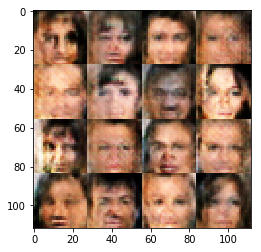

Epoch 1/2... Discriminator Loss: 1.4196... Generator Loss: 0.7576
Epoch 1/2... Discriminator Loss: 1.3630... Generator Loss: 0.7767
Epoch 1/2... Discriminator Loss: 1.3749... Generator Loss: 0.7524
Epoch 1/2... Discriminator Loss: 1.3591... Generator Loss: 0.7020
Epoch 1/2... Discriminator Loss: 1.3462... Generator Loss: 0.7753
Epoch 1/2... Discriminator Loss: 1.3783... Generator Loss: 0.7335
Epoch 1/2... Discriminator Loss: 1.4502... Generator Loss: 0.8275
Epoch 1/2... Discriminator Loss: 1.3757... Generator Loss: 0.7092
Epoch 1/2... Discriminator Loss: 1.3716... Generator Loss: 0.8984
Epoch 1/2... Discriminator Loss: 1.3303... Generator Loss: 0.7102


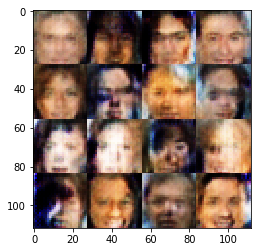

Epoch 1/2... Discriminator Loss: 1.3824... Generator Loss: 0.7950
Epoch 1/2... Discriminator Loss: 1.3491... Generator Loss: 0.7865
Epoch 1/2... Discriminator Loss: 1.3148... Generator Loss: 0.8454
Epoch 1/2... Discriminator Loss: 1.3762... Generator Loss: 0.7164
Epoch 1/2... Discriminator Loss: 1.3614... Generator Loss: 0.8324
Epoch 1/2... Discriminator Loss: 1.3829... Generator Loss: 0.8104
Epoch 1/2... Discriminator Loss: 1.3648... Generator Loss: 0.8581
Epoch 1/2... Discriminator Loss: 1.2413... Generator Loss: 0.7506
Epoch 1/2... Discriminator Loss: 1.3674... Generator Loss: 0.7491
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 0.8144


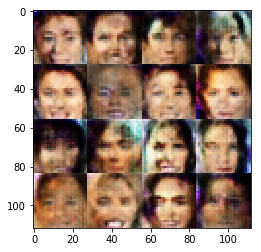

Epoch 1/2... Discriminator Loss: 1.4262... Generator Loss: 0.7496
Epoch 1/2... Discriminator Loss: 1.3879... Generator Loss: 0.7807
Epoch 1/2... Discriminator Loss: 1.3656... Generator Loss: 0.8515
Epoch 1/2... Discriminator Loss: 1.3484... Generator Loss: 0.8434
Epoch 1/2... Discriminator Loss: 1.3242... Generator Loss: 0.8006
Epoch 1/2... Discriminator Loss: 1.4073... Generator Loss: 0.7573
Epoch 1/2... Discriminator Loss: 1.3498... Generator Loss: 0.8875
Epoch 1/2... Discriminator Loss: 1.4543... Generator Loss: 0.7743
Epoch 1/2... Discriminator Loss: 1.3785... Generator Loss: 0.7946
Epoch 1/2... Discriminator Loss: 1.3719... Generator Loss: 0.7920


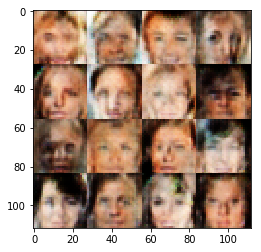

Epoch 1/2... Discriminator Loss: 1.3575... Generator Loss: 0.7030
Epoch 1/2... Discriminator Loss: 1.2729... Generator Loss: 0.6975
Epoch 1/2... Discriminator Loss: 1.3982... Generator Loss: 0.7907
Epoch 1/2... Discriminator Loss: 1.3864... Generator Loss: 0.7938
Epoch 1/2... Discriminator Loss: 1.3872... Generator Loss: 0.7680
Epoch 1/2... Discriminator Loss: 1.4036... Generator Loss: 0.7643
Epoch 1/2... Discriminator Loss: 1.3616... Generator Loss: 0.7648
Epoch 1/2... Discriminator Loss: 1.2816... Generator Loss: 0.7619
Epoch 1/2... Discriminator Loss: 1.4191... Generator Loss: 0.8567
Epoch 1/2... Discriminator Loss: 1.3360... Generator Loss: 0.7469


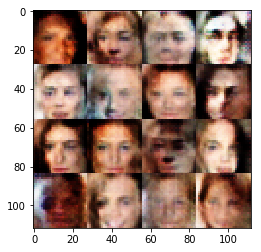

Epoch 1/2... Discriminator Loss: 1.3236... Generator Loss: 0.6382
Epoch 1/2... Discriminator Loss: 1.3661... Generator Loss: 0.7253
Epoch 1/2... Discriminator Loss: 1.4826... Generator Loss: 0.7887
Epoch 1/2... Discriminator Loss: 1.3001... Generator Loss: 0.7304
Epoch 1/2... Discriminator Loss: 1.3754... Generator Loss: 0.8789
Epoch 1/2... Discriminator Loss: 1.3832... Generator Loss: 0.7810
Epoch 1/2... Discriminator Loss: 1.3823... Generator Loss: 0.7907
Epoch 1/2... Discriminator Loss: 1.4063... Generator Loss: 0.7596
Epoch 1/2... Discriminator Loss: 1.3603... Generator Loss: 0.9213
Epoch 1/2... Discriminator Loss: 1.3935... Generator Loss: 0.7535


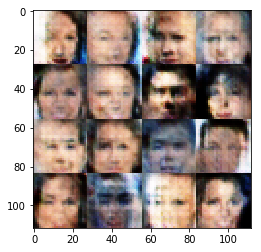

Epoch 1/2... Discriminator Loss: 1.3571... Generator Loss: 0.8363
Epoch 1/2... Discriminator Loss: 1.3269... Generator Loss: 0.8630
Epoch 1/2... Discriminator Loss: 1.3683... Generator Loss: 0.7941
Epoch 1/2... Discriminator Loss: 1.3307... Generator Loss: 0.7678
Epoch 1/2... Discriminator Loss: 1.3340... Generator Loss: 0.7906
Epoch 1/2... Discriminator Loss: 1.4155... Generator Loss: 0.7673
Epoch 1/2... Discriminator Loss: 1.3472... Generator Loss: 0.7673
Epoch 1/2... Discriminator Loss: 1.3457... Generator Loss: 0.7074
Epoch 1/2... Discriminator Loss: 1.4149... Generator Loss: 0.7299
Epoch 1/2... Discriminator Loss: 1.3139... Generator Loss: 0.7118


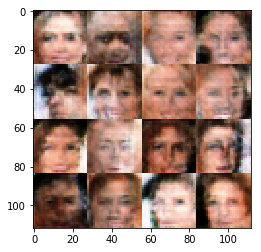

Epoch 1/2... Discriminator Loss: 1.3581... Generator Loss: 0.8106
Epoch 1/2... Discriminator Loss: 1.3432... Generator Loss: 0.7659
Epoch 1/2... Discriminator Loss: 1.3742... Generator Loss: 0.7777
Epoch 1/2... Discriminator Loss: 1.3135... Generator Loss: 0.7512
Epoch 1/2... Discriminator Loss: 1.4085... Generator Loss: 0.7686
Epoch 1/2... Discriminator Loss: 1.4243... Generator Loss: 0.7584
Epoch 1/2... Discriminator Loss: 1.3269... Generator Loss: 0.7527
Epoch 1/2... Discriminator Loss: 1.4330... Generator Loss: 0.7828
Epoch 1/2... Discriminator Loss: 1.3578... Generator Loss: 0.7079
Epoch 1/2... Discriminator Loss: 1.3919... Generator Loss: 0.7442


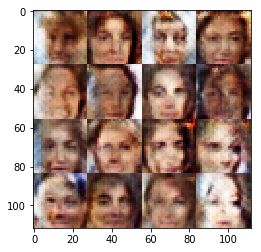

Epoch 1/2... Discriminator Loss: 1.4237... Generator Loss: 0.7678
Epoch 1/2... Discriminator Loss: 1.2550... Generator Loss: 0.7025
Epoch 1/2... Discriminator Loss: 1.3641... Generator Loss: 0.7499
Epoch 1/2... Discriminator Loss: 1.3521... Generator Loss: 0.7666
Epoch 1/2... Discriminator Loss: 1.3499... Generator Loss: 0.7475
Epoch 1/2... Discriminator Loss: 1.3629... Generator Loss: 0.8371
Epoch 1/2... Discriminator Loss: 1.4322... Generator Loss: 0.7737
Epoch 1/2... Discriminator Loss: 1.3811... Generator Loss: 0.7578
Epoch 1/2... Discriminator Loss: 1.3648... Generator Loss: 0.7445
Epoch 1/2... Discriminator Loss: 1.4086... Generator Loss: 0.7092


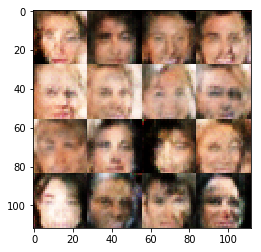

Epoch 1/2... Discriminator Loss: 1.3159... Generator Loss: 0.7522
Epoch 1/2... Discriminator Loss: 1.3808... Generator Loss: 0.8272
Epoch 1/2... Discriminator Loss: 1.3584... Generator Loss: 0.7627
Epoch 1/2... Discriminator Loss: 1.3788... Generator Loss: 0.7197
Epoch 1/2... Discriminator Loss: 1.3939... Generator Loss: 0.9070
Epoch 1/2... Discriminator Loss: 1.3331... Generator Loss: 0.7572
Epoch 1/2... Discriminator Loss: 1.3699... Generator Loss: 0.8158
Epoch 1/2... Discriminator Loss: 1.4176... Generator Loss: 0.7284
Epoch 1/2... Discriminator Loss: 1.4743... Generator Loss: 0.6432
Epoch 1/2... Discriminator Loss: 1.3842... Generator Loss: 0.7533


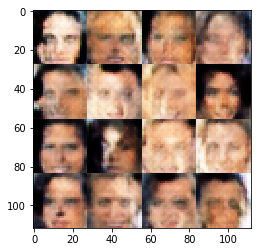

Epoch 1/2... Discriminator Loss: 1.4095... Generator Loss: 0.7710
Epoch 1/2... Discriminator Loss: 1.3372... Generator Loss: 0.7727
Epoch 1/2... Discriminator Loss: 1.3824... Generator Loss: 0.7495
Epoch 1/2... Discriminator Loss: 1.4114... Generator Loss: 0.8182
Epoch 1/2... Discriminator Loss: 1.3371... Generator Loss: 0.7655
Epoch 1/2... Discriminator Loss: 1.4058... Generator Loss: 0.7387
Epoch 1/2... Discriminator Loss: 1.3452... Generator Loss: 0.8145
Epoch 1/2... Discriminator Loss: 1.3946... Generator Loss: 0.7482
Epoch 1/2... Discriminator Loss: 1.3886... Generator Loss: 0.7054
Epoch 1/2... Discriminator Loss: 1.3705... Generator Loss: 0.9168


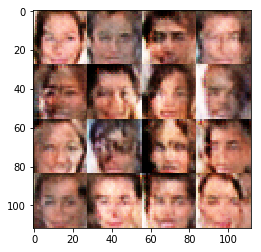

Epoch 1/2... Discriminator Loss: 1.3823... Generator Loss: 0.6998
Epoch 1/2... Discriminator Loss: 1.3372... Generator Loss: 0.7564
Epoch 1/2... Discriminator Loss: 1.3764... Generator Loss: 0.8082
Epoch 1/2... Discriminator Loss: 1.3924... Generator Loss: 0.7824
Epoch 1/2... Discriminator Loss: 1.3737... Generator Loss: 0.7549
Epoch 1/2... Discriminator Loss: 1.3748... Generator Loss: 0.6926
Epoch 1/2... Discriminator Loss: 1.3798... Generator Loss: 0.8545
Epoch 1/2... Discriminator Loss: 1.2564... Generator Loss: 0.9391
Epoch 1/2... Discriminator Loss: 1.4408... Generator Loss: 0.6997
Epoch 1/2... Discriminator Loss: 1.4455... Generator Loss: 0.7597


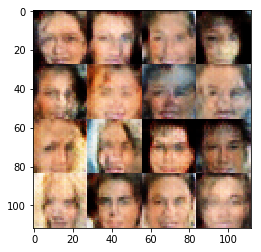

Epoch 1/2... Discriminator Loss: 1.4414... Generator Loss: 0.7191
Epoch 1/2... Discriminator Loss: 1.4424... Generator Loss: 0.7141
Epoch 1/2... Discriminator Loss: 1.4108... Generator Loss: 0.7516
Epoch 1/2... Discriminator Loss: 1.3918... Generator Loss: 0.7117
Epoch 1/2... Discriminator Loss: 1.3638... Generator Loss: 0.7865
Epoch 1/2... Discriminator Loss: 1.3586... Generator Loss: 0.8428
Epoch 1/2... Discriminator Loss: 1.3666... Generator Loss: 0.7719
Epoch 1/2... Discriminator Loss: 1.4221... Generator Loss: 0.7870
Epoch 1/2... Discriminator Loss: 1.3781... Generator Loss: 0.8046
Epoch 1/2... Discriminator Loss: 1.3816... Generator Loss: 0.8379


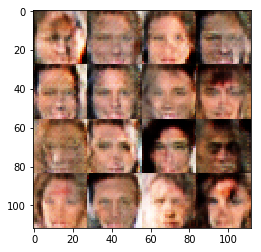

Epoch 1/2... Discriminator Loss: 1.3702... Generator Loss: 0.8242
Epoch 1/2... Discriminator Loss: 1.3573... Generator Loss: 0.7860
Epoch 1/2... Discriminator Loss: 1.3872... Generator Loss: 0.7329
Epoch 1/2... Discriminator Loss: 1.3936... Generator Loss: 0.8983
Epoch 1/2... Discriminator Loss: 1.3439... Generator Loss: 0.8319
Epoch 1/2... Discriminator Loss: 1.2574... Generator Loss: 0.7881
Epoch 1/2... Discriminator Loss: 1.4123... Generator Loss: 0.7676
Epoch 1/2... Discriminator Loss: 1.4012... Generator Loss: 0.8150
Epoch 1/2... Discriminator Loss: 1.3918... Generator Loss: 0.7655
Epoch 1/2... Discriminator Loss: 1.3566... Generator Loss: 0.7163


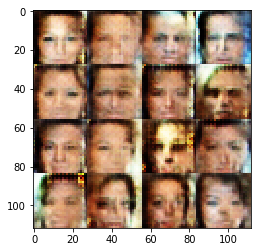

Epoch 1/2... Discriminator Loss: 1.4319... Generator Loss: 0.8396
Epoch 1/2... Discriminator Loss: 1.3876... Generator Loss: 0.7326
Epoch 1/2... Discriminator Loss: 1.3996... Generator Loss: 0.7662
Epoch 1/2... Discriminator Loss: 1.3708... Generator Loss: 0.7822
Epoch 1/2... Discriminator Loss: 1.2861... Generator Loss: 0.7827
Epoch 1/2... Discriminator Loss: 1.4383... Generator Loss: 0.7972
Epoch 1/2... Discriminator Loss: 1.3664... Generator Loss: 0.7699
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.7900
Epoch 1/2... Discriminator Loss: 1.3387... Generator Loss: 0.9064
Epoch 1/2... Discriminator Loss: 1.3729... Generator Loss: 0.7436


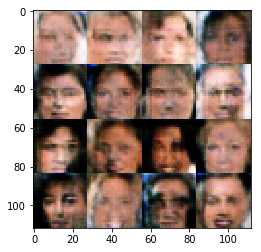

Epoch 1/2... Discriminator Loss: 1.4105... Generator Loss: 0.7475
Epoch 1/2... Discriminator Loss: 1.3919... Generator Loss: 0.7962
Epoch 1/2... Discriminator Loss: 1.3570... Generator Loss: 0.7854
Epoch 1/2... Discriminator Loss: 1.3344... Generator Loss: 0.7566
Epoch 1/2... Discriminator Loss: 1.3977... Generator Loss: 0.8000
Epoch 1/2... Discriminator Loss: 1.2947... Generator Loss: 0.7714
Epoch 1/2... Discriminator Loss: 1.3262... Generator Loss: 0.9009
Epoch 1/2... Discriminator Loss: 1.4392... Generator Loss: 0.8267
Epoch 1/2... Discriminator Loss: 1.3792... Generator Loss: 0.8278
Epoch 1/2... Discriminator Loss: 1.3591... Generator Loss: 0.8076


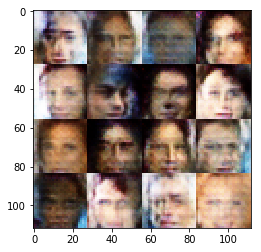

Epoch 1/2... Discriminator Loss: 1.4069... Generator Loss: 0.7816
Epoch 1/2... Discriminator Loss: 1.3477... Generator Loss: 0.7595
Epoch 1/2... Discriminator Loss: 1.4422... Generator Loss: 0.7545
Epoch 1/2... Discriminator Loss: 1.4089... Generator Loss: 0.7890
Epoch 1/2... Discriminator Loss: 1.3762... Generator Loss: 0.8240
Epoch 1/2... Discriminator Loss: 1.3050... Generator Loss: 0.7748
Epoch 1/2... Discriminator Loss: 1.3611... Generator Loss: 0.7347
Epoch 1/2... Discriminator Loss: 1.3520... Generator Loss: 0.8025
Epoch 1/2... Discriminator Loss: 1.3980... Generator Loss: 0.7816
Epoch 1/2... Discriminator Loss: 1.3146... Generator Loss: 0.7958


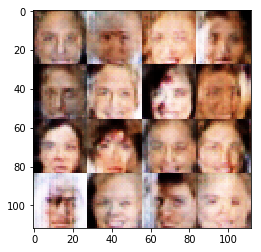

Epoch 1/2... Discriminator Loss: 1.3841... Generator Loss: 0.8137
Epoch 1/2... Discriminator Loss: 1.3377... Generator Loss: 0.8429
Epoch 1/2... Discriminator Loss: 1.3426... Generator Loss: 0.8039
Epoch 1/2... Discriminator Loss: 1.4051... Generator Loss: 0.7897
Epoch 1/2... Discriminator Loss: 1.3426... Generator Loss: 0.8381
Epoch 1/2... Discriminator Loss: 1.3413... Generator Loss: 0.8076
Epoch 1/2... Discriminator Loss: 1.3791... Generator Loss: 0.7733
Epoch 1/2... Discriminator Loss: 1.3936... Generator Loss: 0.7268
Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.7987
Epoch 1/2... Discriminator Loss: 1.3994... Generator Loss: 0.7669


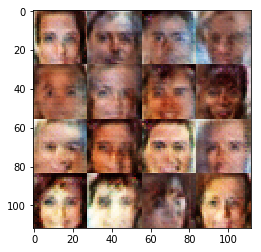

Epoch 1/2... Discriminator Loss: 1.3756... Generator Loss: 0.7961
Epoch 1/2... Discriminator Loss: 1.4274... Generator Loss: 0.7437
Epoch 1/2... Discriminator Loss: 1.3984... Generator Loss: 0.7584
Epoch 1/2... Discriminator Loss: 1.4143... Generator Loss: 0.7869
Epoch 1/2... Discriminator Loss: 1.4127... Generator Loss: 0.7248
Epoch 1/2... Discriminator Loss: 1.3559... Generator Loss: 0.7595
Epoch 1/2... Discriminator Loss: 1.4170... Generator Loss: 0.7650
Epoch 1/2... Discriminator Loss: 1.3930... Generator Loss: 0.7955
Epoch 1/2... Discriminator Loss: 1.4299... Generator Loss: 0.7476
Epoch 1/2... Discriminator Loss: 1.3839... Generator Loss: 0.7396


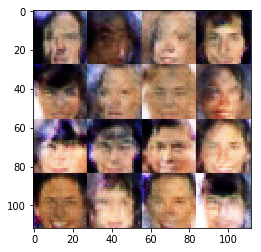

Epoch 1/2... Discriminator Loss: 1.3997... Generator Loss: 0.7874
Epoch 1/2... Discriminator Loss: 1.3763... Generator Loss: 0.8597
Epoch 1/2... Discriminator Loss: 1.3880... Generator Loss: 0.7404
Epoch 1/2... Discriminator Loss: 1.3301... Generator Loss: 0.7773


KeyboardInterrupt: 

In [17]:
batch_size = 16
z_dim = 100
learning_rate = 0.001
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Epoch 1/2... Discriminator Loss: 0.5439... Generator Loss: 25.7220
Epoch 1/2... Discriminator Loss: 0.7656... Generator Loss: 1.9670
Epoch 1/2... Discriminator Loss: 1.8957... Generator Loss: 4.6058
Epoch 1/2... Discriminator Loss: 1.1702... Generator Loss: 1.8811
Epoch 1/2... Discriminator Loss: 0.9678... Generator Loss: 1.6144
Epoch 1/2... Discriminator Loss: 1.0525... Generator Loss: 1.1923
Epoch 1/2... Discriminator Loss: 1.2298... Generator Loss: 4.0794
Epoch 1/2... Discriminator Loss: 2.6647... Generator Loss: 0.1314
Epoch 1/2... Discriminator Loss: 1.2150... Generator Loss: 0.6334
Epoch 1/2... Discriminator Loss: 0.9618... Generator Loss: 1.7295


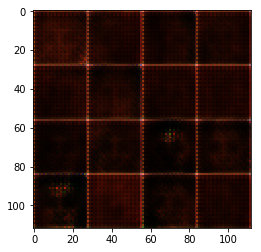

Epoch 1/2... Discriminator Loss: 0.8432... Generator Loss: 1.7344
Epoch 1/2... Discriminator Loss: 0.8117... Generator Loss: 1.3771
Epoch 1/2... Discriminator Loss: 1.2850... Generator Loss: 0.7463
Epoch 1/2... Discriminator Loss: 2.1356... Generator Loss: 0.2995
Epoch 1/2... Discriminator Loss: 1.2889... Generator Loss: 0.9628
Epoch 1/2... Discriminator Loss: 1.4516... Generator Loss: 1.0139
Epoch 1/2... Discriminator Loss: 1.6263... Generator Loss: 0.4897
Epoch 1/2... Discriminator Loss: 2.4224... Generator Loss: 2.6550
Epoch 1/2... Discriminator Loss: 1.4500... Generator Loss: 0.7272
Epoch 1/2... Discriminator Loss: 1.3284... Generator Loss: 0.8443


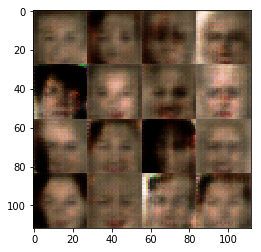

Epoch 1/2... Discriminator Loss: 1.4235... Generator Loss: 0.6116
Epoch 1/2... Discriminator Loss: 1.2477... Generator Loss: 1.2486
Epoch 1/2... Discriminator Loss: 1.4899... Generator Loss: 1.0452
Epoch 1/2... Discriminator Loss: 1.2501... Generator Loss: 0.9216
Epoch 1/2... Discriminator Loss: 3.6151... Generator Loss: 3.2790
Epoch 1/2... Discriminator Loss: 1.5153... Generator Loss: 0.8039
Epoch 1/2... Discriminator Loss: 1.4930... Generator Loss: 0.7968
Epoch 1/2... Discriminator Loss: 1.4394... Generator Loss: 0.7107
Epoch 1/2... Discriminator Loss: 1.3997... Generator Loss: 0.8662
Epoch 1/2... Discriminator Loss: 1.4496... Generator Loss: 0.5930


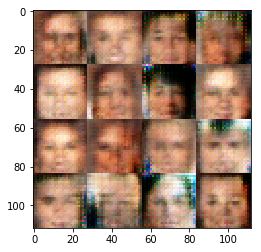

Epoch 1/2... Discriminator Loss: 1.2800... Generator Loss: 1.1714
Epoch 1/2... Discriminator Loss: 1.3432... Generator Loss: 0.9992
Epoch 1/2... Discriminator Loss: 1.2461... Generator Loss: 0.9732
Epoch 1/2... Discriminator Loss: 1.3892... Generator Loss: 0.7043
Epoch 1/2... Discriminator Loss: 1.2769... Generator Loss: 0.8955
Epoch 1/2... Discriminator Loss: 1.2158... Generator Loss: 0.7548
Epoch 1/2... Discriminator Loss: 1.4067... Generator Loss: 0.9350
Epoch 1/2... Discriminator Loss: 1.2916... Generator Loss: 0.8608
Epoch 1/2... Discriminator Loss: 1.4519... Generator Loss: 0.9774
Epoch 1/2... Discriminator Loss: 1.9347... Generator Loss: 0.2677


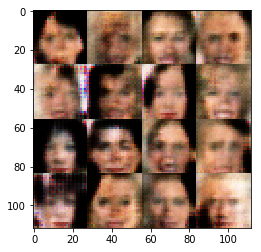

Epoch 1/2... Discriminator Loss: 1.3470... Generator Loss: 0.9458
Epoch 1/2... Discriminator Loss: 1.4457... Generator Loss: 0.7673
Epoch 1/2... Discriminator Loss: 1.4282... Generator Loss: 0.8004
Epoch 1/2... Discriminator Loss: 1.2651... Generator Loss: 0.9636
Epoch 1/2... Discriminator Loss: 1.4517... Generator Loss: 1.0940
Epoch 1/2... Discriminator Loss: 1.7676... Generator Loss: 1.8097
Epoch 1/2... Discriminator Loss: 1.4626... Generator Loss: 0.6496
Epoch 1/2... Discriminator Loss: 1.3309... Generator Loss: 0.6405
Epoch 1/2... Discriminator Loss: 1.4274... Generator Loss: 0.5556
Epoch 1/2... Discriminator Loss: 1.4895... Generator Loss: 0.7058


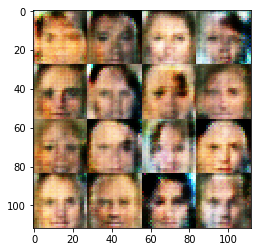

Epoch 1/2... Discriminator Loss: 1.3400... Generator Loss: 1.1656
Epoch 1/2... Discriminator Loss: 1.3887... Generator Loss: 0.6961
Epoch 1/2... Discriminator Loss: 1.2782... Generator Loss: 1.5053
Epoch 1/2... Discriminator Loss: 1.3870... Generator Loss: 0.8585
Epoch 1/2... Discriminator Loss: 1.4282... Generator Loss: 0.7382
Epoch 1/2... Discriminator Loss: 1.4689... Generator Loss: 0.8708
Epoch 1/2... Discriminator Loss: 1.1695... Generator Loss: 1.0266
Epoch 1/2... Discriminator Loss: 1.1962... Generator Loss: 1.2475
Epoch 1/2... Discriminator Loss: 1.2788... Generator Loss: 0.7688
Epoch 1/2... Discriminator Loss: 1.4464... Generator Loss: 0.4889


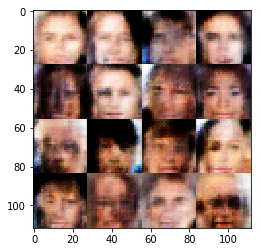

Epoch 1/2... Discriminator Loss: 1.3478... Generator Loss: 0.8385
Epoch 1/2... Discriminator Loss: 1.3692... Generator Loss: 0.6411
Epoch 1/2... Discriminator Loss: 1.4459... Generator Loss: 0.5092
Epoch 1/2... Discriminator Loss: 1.2021... Generator Loss: 0.9861
Epoch 1/2... Discriminator Loss: 1.2916... Generator Loss: 1.0627
Epoch 1/2... Discriminator Loss: 1.4255... Generator Loss: 0.7107
Epoch 1/2... Discriminator Loss: 1.6251... Generator Loss: 0.3502
Epoch 1/2... Discriminator Loss: 1.3805... Generator Loss: 0.5084
Epoch 1/2... Discriminator Loss: 1.5947... Generator Loss: 1.5417
Epoch 1/2... Discriminator Loss: 1.5021... Generator Loss: 0.8226


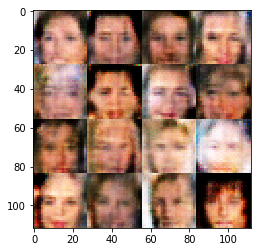

Epoch 1/2... Discriminator Loss: 1.4212... Generator Loss: 0.5085
Epoch 1/2... Discriminator Loss: 1.4596... Generator Loss: 0.5163
Epoch 1/2... Discriminator Loss: 1.0016... Generator Loss: 1.2501
Epoch 1/2... Discriminator Loss: 1.5512... Generator Loss: 0.9097
Epoch 1/2... Discriminator Loss: 1.5068... Generator Loss: 0.9199
Epoch 1/2... Discriminator Loss: 1.5302... Generator Loss: 0.7051
Epoch 1/2... Discriminator Loss: 1.3830... Generator Loss: 0.6475
Epoch 1/2... Discriminator Loss: 1.4186... Generator Loss: 0.7031
Epoch 1/2... Discriminator Loss: 1.4293... Generator Loss: 0.8144
Epoch 1/2... Discriminator Loss: 1.3962... Generator Loss: 0.9153


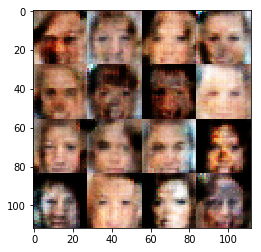

Epoch 1/2... Discriminator Loss: 1.4341... Generator Loss: 0.6941
Epoch 1/2... Discriminator Loss: 1.4198... Generator Loss: 0.8501
Epoch 1/2... Discriminator Loss: 1.4548... Generator Loss: 0.8949
Epoch 1/2... Discriminator Loss: 1.3904... Generator Loss: 0.6376
Epoch 1/2... Discriminator Loss: 1.5006... Generator Loss: 0.6742
Epoch 1/2... Discriminator Loss: 1.3502... Generator Loss: 0.7797
Epoch 1/2... Discriminator Loss: 1.4867... Generator Loss: 0.5660
Epoch 1/2... Discriminator Loss: 1.4211... Generator Loss: 0.8188
Epoch 1/2... Discriminator Loss: 1.3994... Generator Loss: 0.7476
Epoch 1/2... Discriminator Loss: 1.4162... Generator Loss: 0.7489


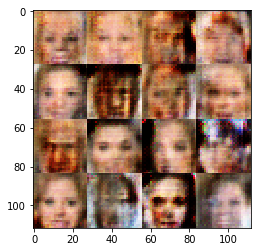

Epoch 1/2... Discriminator Loss: 1.4075... Generator Loss: 0.6389
Epoch 1/2... Discriminator Loss: 1.3805... Generator Loss: 0.6967
Epoch 1/2... Discriminator Loss: 1.4734... Generator Loss: 0.8085
Epoch 1/2... Discriminator Loss: 1.4297... Generator Loss: 0.7913
Epoch 1/2... Discriminator Loss: 1.3931... Generator Loss: 0.7066
Epoch 1/2... Discriminator Loss: 1.3818... Generator Loss: 0.7484
Epoch 1/2... Discriminator Loss: 1.3920... Generator Loss: 1.0200
Epoch 1/2... Discriminator Loss: 1.3832... Generator Loss: 0.7032
Epoch 1/2... Discriminator Loss: 1.3844... Generator Loss: 0.8797
Epoch 1/2... Discriminator Loss: 1.3530... Generator Loss: 0.8946


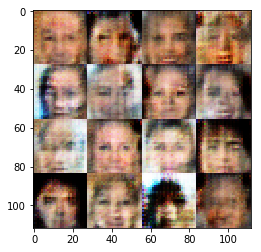

Epoch 1/2... Discriminator Loss: 1.4016... Generator Loss: 0.8612
Epoch 1/2... Discriminator Loss: 1.3865... Generator Loss: 0.8419
Epoch 1/2... Discriminator Loss: 1.3488... Generator Loss: 0.7727
Epoch 1/2... Discriminator Loss: 1.3887... Generator Loss: 0.8871
Epoch 1/2... Discriminator Loss: 1.4053... Generator Loss: 0.9136
Epoch 1/2... Discriminator Loss: 1.3771... Generator Loss: 0.7823
Epoch 1/2... Discriminator Loss: 1.4271... Generator Loss: 0.8523
Epoch 1/2... Discriminator Loss: 1.4012... Generator Loss: 0.8811
Epoch 1/2... Discriminator Loss: 1.3739... Generator Loss: 0.7412
Epoch 1/2... Discriminator Loss: 1.3922... Generator Loss: 0.8177


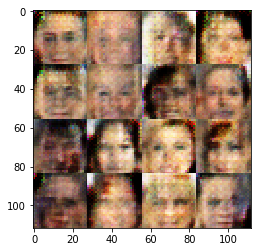

Epoch 1/2... Discriminator Loss: 1.4259... Generator Loss: 0.7490
Epoch 1/2... Discriminator Loss: 1.3837... Generator Loss: 0.8762
Epoch 1/2... Discriminator Loss: 1.4322... Generator Loss: 0.6848
Epoch 1/2... Discriminator Loss: 1.4114... Generator Loss: 0.7725
Epoch 1/2... Discriminator Loss: 1.3825... Generator Loss: 0.8788
Epoch 1/2... Discriminator Loss: 1.4181... Generator Loss: 0.8381
Epoch 1/2... Discriminator Loss: 1.4246... Generator Loss: 0.7217
Epoch 1/2... Discriminator Loss: 1.3978... Generator Loss: 0.7623
Epoch 1/2... Discriminator Loss: 1.3921... Generator Loss: 0.7739
Epoch 1/2... Discriminator Loss: 1.4167... Generator Loss: 0.7321


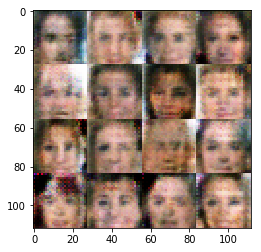

Epoch 1/2... Discriminator Loss: 1.3584... Generator Loss: 0.9914
Epoch 1/2... Discriminator Loss: 1.3666... Generator Loss: 0.8016
Epoch 1/2... Discriminator Loss: 1.4316... Generator Loss: 0.7312
Epoch 1/2... Discriminator Loss: 1.3894... Generator Loss: 0.8685
Epoch 1/2... Discriminator Loss: 1.3931... Generator Loss: 0.7399
Epoch 1/2... Discriminator Loss: 1.4614... Generator Loss: 0.8468
Epoch 1/2... Discriminator Loss: 1.3876... Generator Loss: 0.8111
Epoch 1/2... Discriminator Loss: 1.4004... Generator Loss: 0.7674
Epoch 1/2... Discriminator Loss: 1.3741... Generator Loss: 0.7769
Epoch 1/2... Discriminator Loss: 1.4059... Generator Loss: 0.7801


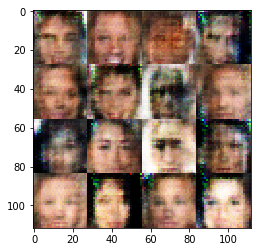

Epoch 1/2... Discriminator Loss: 1.4431... Generator Loss: 0.8095
Epoch 1/2... Discriminator Loss: 1.3766... Generator Loss: 0.8000
Epoch 1/2... Discriminator Loss: 1.3811... Generator Loss: 0.8271
Epoch 1/2... Discriminator Loss: 1.4020... Generator Loss: 0.7180
Epoch 1/2... Discriminator Loss: 1.3744... Generator Loss: 0.7829
Epoch 1/2... Discriminator Loss: 1.4127... Generator Loss: 0.7223
Epoch 1/2... Discriminator Loss: 1.3706... Generator Loss: 0.8788
Epoch 1/2... Discriminator Loss: 1.4256... Generator Loss: 0.9043
Epoch 1/2... Discriminator Loss: 1.4122... Generator Loss: 0.8638
Epoch 1/2... Discriminator Loss: 1.4002... Generator Loss: 0.7501


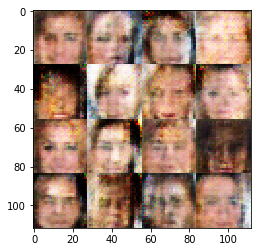

Epoch 1/2... Discriminator Loss: 1.4266... Generator Loss: 0.8242
Epoch 1/2... Discriminator Loss: 1.4223... Generator Loss: 0.7830
Epoch 1/2... Discriminator Loss: 1.3840... Generator Loss: 0.7192
Epoch 1/2... Discriminator Loss: 1.3825... Generator Loss: 0.8949
Epoch 1/2... Discriminator Loss: 1.4027... Generator Loss: 0.6485
Epoch 1/2... Discriminator Loss: 1.3998... Generator Loss: 0.7456
Epoch 1/2... Discriminator Loss: 1.3788... Generator Loss: 0.9308
Epoch 1/2... Discriminator Loss: 1.4125... Generator Loss: 0.8124
Epoch 1/2... Discriminator Loss: 1.4111... Generator Loss: 0.8656
Epoch 1/2... Discriminator Loss: 1.3854... Generator Loss: 0.8137


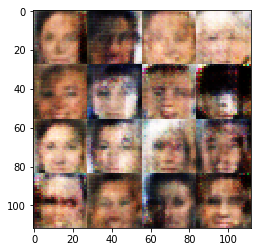

Epoch 1/2... Discriminator Loss: 1.4084... Generator Loss: 0.7156
Epoch 1/2... Discriminator Loss: 1.4177... Generator Loss: 0.7672
Epoch 1/2... Discriminator Loss: 1.3604... Generator Loss: 0.8693
Epoch 1/2... Discriminator Loss: 1.4082... Generator Loss: 0.8537
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.8405
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.8184
Epoch 1/2... Discriminator Loss: 1.3818... Generator Loss: 0.8020
Epoch 1/2... Discriminator Loss: 1.3932... Generator Loss: 0.7817
Epoch 1/2... Discriminator Loss: 1.3969... Generator Loss: 0.7613
Epoch 1/2... Discriminator Loss: 1.4298... Generator Loss: 0.6493


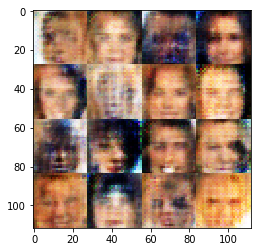

Epoch 1/2... Discriminator Loss: 1.4472... Generator Loss: 0.6930
Epoch 1/2... Discriminator Loss: 1.3631... Generator Loss: 0.8412
Epoch 1/2... Discriminator Loss: 1.3965... Generator Loss: 0.8393
Epoch 1/2... Discriminator Loss: 1.3585... Generator Loss: 0.7795
Epoch 1/2... Discriminator Loss: 1.3780... Generator Loss: 0.7394
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.9099
Epoch 1/2... Discriminator Loss: 1.3698... Generator Loss: 0.8093
Epoch 1/2... Discriminator Loss: 1.4363... Generator Loss: 0.7291
Epoch 1/2... Discriminator Loss: 1.3617... Generator Loss: 0.7191
Epoch 1/2... Discriminator Loss: 1.4372... Generator Loss: 0.7081


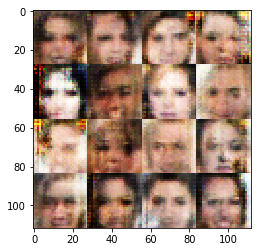

Epoch 1/2... Discriminator Loss: 1.3781... Generator Loss: 0.7490
Epoch 1/2... Discriminator Loss: 1.3900... Generator Loss: 0.7061
Epoch 1/2... Discriminator Loss: 1.3805... Generator Loss: 0.7660
Epoch 1/2... Discriminator Loss: 1.3903... Generator Loss: 0.7354
Epoch 1/2... Discriminator Loss: 1.3640... Generator Loss: 0.7859
Epoch 1/2... Discriminator Loss: 1.3504... Generator Loss: 0.8914
Epoch 1/2... Discriminator Loss: 1.4227... Generator Loss: 0.7992
Epoch 1/2... Discriminator Loss: 1.3812... Generator Loss: 0.8389
Epoch 1/2... Discriminator Loss: 1.3775... Generator Loss: 0.8719
Epoch 1/2... Discriminator Loss: 1.3791... Generator Loss: 0.7616


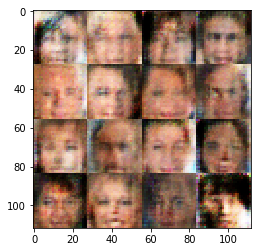

Epoch 1/2... Discriminator Loss: 1.4066... Generator Loss: 0.9828
Epoch 1/2... Discriminator Loss: 1.4003... Generator Loss: 0.6802
Epoch 1/2... Discriminator Loss: 1.3853... Generator Loss: 0.9045
Epoch 1/2... Discriminator Loss: 1.4044... Generator Loss: 0.7989
Epoch 1/2... Discriminator Loss: 1.3495... Generator Loss: 0.8189
Epoch 1/2... Discriminator Loss: 1.3798... Generator Loss: 0.8099
Epoch 1/2... Discriminator Loss: 1.3872... Generator Loss: 0.8152
Epoch 1/2... Discriminator Loss: 1.3882... Generator Loss: 0.7689
Epoch 1/2... Discriminator Loss: 1.4059... Generator Loss: 0.7631
Epoch 1/2... Discriminator Loss: 1.3909... Generator Loss: 0.7223


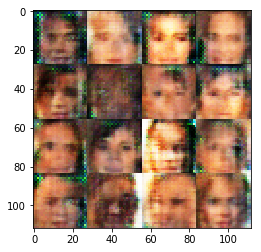

Epoch 1/2... Discriminator Loss: 1.3965... Generator Loss: 0.8558
Epoch 1/2... Discriminator Loss: 1.3654... Generator Loss: 0.7627
Epoch 1/2... Discriminator Loss: 1.3964... Generator Loss: 0.7930
Epoch 1/2... Discriminator Loss: 1.4054... Generator Loss: 0.7059
Epoch 1/2... Discriminator Loss: 1.3717... Generator Loss: 0.8218
Epoch 1/2... Discriminator Loss: 1.4147... Generator Loss: 0.8300
Epoch 1/2... Discriminator Loss: 1.3603... Generator Loss: 0.9089
Epoch 1/2... Discriminator Loss: 1.3669... Generator Loss: 0.7348
Epoch 1/2... Discriminator Loss: 1.3845... Generator Loss: 0.8753
Epoch 1/2... Discriminator Loss: 1.3644... Generator Loss: 1.0891


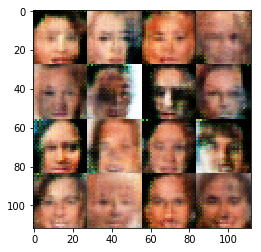

Epoch 1/2... Discriminator Loss: 1.4025... Generator Loss: 0.8335
Epoch 1/2... Discriminator Loss: 1.3824... Generator Loss: 0.9003
Epoch 1/2... Discriminator Loss: 1.4169... Generator Loss: 1.0448
Epoch 1/2... Discriminator Loss: 1.3707... Generator Loss: 0.7607
Epoch 1/2... Discriminator Loss: 1.3594... Generator Loss: 0.7082
Epoch 1/2... Discriminator Loss: 1.4111... Generator Loss: 0.7036
Epoch 1/2... Discriminator Loss: 1.4254... Generator Loss: 0.8386
Epoch 1/2... Discriminator Loss: 1.4079... Generator Loss: 0.9148
Epoch 1/2... Discriminator Loss: 1.3978... Generator Loss: 0.8059
Epoch 1/2... Discriminator Loss: 1.4081... Generator Loss: 0.8899


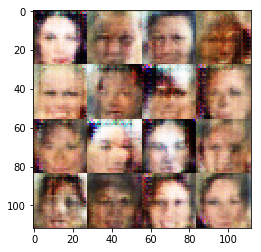

Epoch 1/2... Discriminator Loss: 1.4019... Generator Loss: 0.8481
Epoch 1/2... Discriminator Loss: 1.2934... Generator Loss: 0.8453
Epoch 1/2... Discriminator Loss: 1.4246... Generator Loss: 0.7535
Epoch 1/2... Discriminator Loss: 1.2945... Generator Loss: 0.8832
Epoch 1/2... Discriminator Loss: 1.4420... Generator Loss: 0.6692
Epoch 1/2... Discriminator Loss: 1.3962... Generator Loss: 0.7911


In [ ]:
batch_size = 64
z_dim = 100
learning_rate = 0.001
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.